<a href="https://colab.research.google.com/github/lopesmatheus/COA19-PythonSimu/blob/main/Main_PIE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PIE - DDPG Continuous

## Prerequisites

In [ ]:
!pip install gym[box2d]

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 KB 27.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 35.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 44.8 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for box2d-py
  Running setup.py clean for box2d-py
Failed to build box2d-py
  Running setup.py install for box2d-py ... done
  DEPRECATION: box2d-py was installed using the legacy 'setup.py install' method, because a wheel could not be built for it. A possible replacement is to fix the wheel build issue reported above. Discussion can be found at https:

In [ ]:
!pip install torch

In [ ]:
!pip install gym

In [ ]:
!pip install fmpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.3/10.3 MB 35.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.0/108.0 KB 14.3 MB/s eta 0:00:00


In [ ]:
import gym
import numpy as np
import time
import pandas as pd

### Environnement Plant

In [ ]:
from fmpy import read_model_description, extract
from fmpy.fmi2 import FMU2Slave
import shutil
import sys
sys.path.append('../')
from Tests.testcases.A_T01a import A_T01a ##selectionner ici le cas test à utiliser.

In [ ]:
# define the model name and simulation parameters

class PlantEnv:
    def __init__(self,CaseTest,Hysteresis,step_size_action, step_size_simu):
        self.step_simu = step_size_simu
        self.n_simu = int(step_size_action/self.step_simu)
        
        self.Hysteresis = Hysteresis
        
        self.CaseTest = CaseTest
        
        fmu_plant_filename = '../fmus/PLANT_v3_linux.fmu'
        self.step_size_action = step_size_action
        
        self.Tend = 2000#self.CaseTest.getTsimu() - self.CaseTest.getTend()

        self.action_space = gym.spaces.Box(0,200,(1,),np.float64)

        self.observation_space=gym.spaces.Box(np.array([-100.0 for i in range(8)]),
                                              np.array([300.0 for i in range(8)]),(8,),np.float64)


        # read the model description
        plant_description = read_model_description(fmu_plant_filename)

        # collect the value references
        self.plant_vrs = {}
        for variable in plant_description.modelVariables:
            self.plant_vrs[variable.name] = variable.valueReference

        self.inputs_plant = [v for v in plant_description.modelVariables if v.causality == 'input']
        self.outputs_plant = [v for v in plant_description.modelVariables if v.causality == 'output']

        input_plant_order = []
        
        for v in self.inputs_plant:
            input_plant_order.append(v.valueReference)

        self.CaseTest.setInputOrder(input_plant_order)

        # extract the FMU
        self.unzipdir_plant = extract(fmu_plant_filename)

        self.fmu_plant = FMU2Slave(guid=plant_description.guid,
                             unzipDirectory=self.unzipdir_plant,
                             modelIdentifier=plant_description.coSimulation.modelIdentifier,
                             instanceName='instance1')

        # initialize
        self.fmu_plant.instantiate()
        self.fmu_plant.setupExperiment(startTime=0)
        self.fmu_plant.enterInitializationMode()
        self.fmu_plant.exitInitializationMode()
        
        self.fmu_plant.setReal([self.inputs_plant[1].valueReference], [self.Hysteresis])       # HYSTERESIS 
        
        for cst in self.CaseTest.getConstantsInputs():
            vr = self.inputs_plant[cst].valueReference
            self.fmu_plant.setReal([vr], [self.CaseTest.getAll(vr,0)])
            
        self.counter = 0
        self.time = 0

        self.state = np.zeros((5,))
        self.tvbas_ret = np.zeros((3,))
        
    def reset(self):
        self.fmu_plant.reset()
        self.fmu_plant.setupExperiment(startTime=0)
        self.fmu_plant.enterInitializationMode()
        self.fmu_plant.exitInitializationMode()
        
        self.fmu_plant.setReal([self.inputs_plant[1].valueReference], [self.Hysteresis])       # HYSTERESIS 
        
        for cst in self.CaseTest.getConstantsInputs():
            vr = self.inputs_plant[cst].valueReference
            self.fmu_plant.setReal([vr], [self.CaseTest.getAll(vr,0)])
            
        self.counter = 0
        self.time = 0

        #init_state=np.zeros((self.observation_space.shape[0],))

        self.state = np.zeros((5,))
        self.tvbas_ret = np.zeros((3,))

        for i in range(int(500/self.step_size_action)):
          state, reward, done, _ = self.step(0)

        return(state)
        
    def step(self, action):
            
        self.fmu_plant.setReal([self.inputs_plant[0].valueReference], [action])    # Passe l'action qui sera faite à la plante
        
        
        # Cette boucle permet la distinction du pas de temps de l'action et le pas de temps de la simulation 
        for k in range(0,self.n_simu):
        
            for var in self.CaseTest.getVariablesInputs():             # Define tous les variables qui change à chaque pas de temps
                vr = self.inputs_plant[var].valueReference             # en fonction de ce qui est code dans le cas test
                tprv_ret = self.CaseTest.getAll(vr,self.counter)
                self.fmu_plant.setReal([vr], [tprv_ret])
                self.counter += 1
        
            self.fmu_plant.doStep(currentCommunicationPoint=self.time, communicationStepSize=self.step_simu) # Simule 1 pas de temps
                                                                                                         # de la plante
        
        self.time += self.step_size_action
        
        if self.time < self.Tend:
            done = False
        else:
            done = True
        
        TBAS_SENSOR = self.fmu_plant.getReal([self.outputs_plant[4].valueReference])[0]
        FAV_POSITION_DEG = self.fmu_plant.getReal([self.outputs_plant[0].valueReference])[0]
        
        T_target = self.CaseTest.getT_tgt_C()
        
        error = abs(TBAS_SENSOR - T_target[0])
        
        #reward = - error**2 #- 100 * max(self.time-60,0) * max(error-10,0) - 100 * max(self.time-120,0) * max(error-5,0)    
        reward = - error / T_target[0]

        self.state[0:len(self.state)-1] = self.state[1:len(self.state)]   # Actualise les états d'avant qui l'on garde
        self.state[len(self.state)-1] = TBAS_SENSOR

        self.tvbas_ret[0:len(self.tvbas_ret)-1] = self.tvbas_ret[1:len(self.tvbas_ret)]   # Actualise les états d'avant qui l'on garde
        self.tvbas_ret[len(self.tvbas_ret)-1] = tprv_ret

        return np.concatenate([self.state,self.tvbas_ret]), reward, done, _
    
    def kill_plant(self):
        self.fmu_plant.terminate()
        self.fmu_plant.freeInstance()

        # clean up
        shutil.rmtree(self.unzipdir_plant, ignore_errors=True)

### Agent

To simplify the global code of this notebook, we will use a mother class for each of our agents. This will allow us to build a simulation function that take in argument an environment and an agent, and work with any agents and any environments. Then all you will have to do is to describe what the agent should do at each step of the learning.

In [ ]:
import random
import torch
from torch import nn
from statistics import mean
import matplotlib.pyplot as plt
import copy

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(DEVICE)
class ReplayBuffer:
    def __init__(self, capacity, device=DEVICE):
        self.capacity = capacity # capacity of the buffer
        self.device = device
        self.data = []
        self.index = 0 # index of the next cell to be filled

    def append(self, s, a, r, s_, d):
        if len(self.data) < self.capacity:
            self.data.append(None)
        self.data[self.index] = (s, a, r, s_, d)
        self.index = (self.index + 1) % self.capacity

    def sample(self, batch_size):
        batch = random.sample(self.data, batch_size)
        return list(map(lambda x:torch.Tensor(x).to(self.device), list(zip(*batch))))

    def __len__(self):
        return len(self.data)

class Agent:
    """
    An global agent class that describe the interactions between our agent and it's environment
    """
    def __init__(self, state_space, action_space, device=DEVICE, name="base_agent"):

        self.name = name  # The name is used inside plot legend, outputs directory path, and outputs file names

        self.state_space = state_space
        self.state_shape = state_space.shape
        self.state_size = state_space.shape[0]  # Assume state space is continuous

        self.continuous = isinstance(action_space, gym.spaces.Box)
        self.action_space = action_space
        self.nb_actions = self.action_space.shape[0] if self.continuous else self.action_space.n
        print(self.nb_actions)
        self.last_state = None  # Useful to store interaction when we recieve (new_stare, reward, done) tuple
        self.device = device
        self.episode_id = 0
        self.episode_time_step_id = 0
        self.time_step_id = 0
    
    def on_simulation_start(self):
        """
        Called when an episode is started. will be used by child class.
        """
        pass
    
    def on_episode_start(self, state):
        self.last_state = state
        self.episode_time_step_id = 0
        self.episode_id = 0

    def action(self, state):
        res = self.action_space.sample()
        return res

    def on_action_stop(self, action, new_state, reward, done):
        self.episode_time_step_id += 1
        self.time_step_id += 1
        self.last_state = new_state

    def on_episode_stop(self):
        self.episode_id += 1

    def on_simulation_stop(self):
        pass


cuda


Now let's build a function that run a simulation where a given agent interact with a givent environment. 

## Actor-critic

<div id="actor_critic"></div>
To understand in detail how it work, we are going to implement two of the most known off-policy actor critic architectures, Deep-Deterministic Policy Gradient (DDPG) and Soft Actor-Critic (SAC). 

### Deep-Deterministic Policy Gradient (DDPG)

<div id="ddpg"></div>

DDPG is considered as an off-policy algorithm, because the policy used to train the critic is different than the one used to generate samples.

For the general idea, when we select an interaction (s, a, r, s', a') to train our critic network, the way a' will be chosen will define the reward propagation (generally called credit assignment) speed. If a' is the optimal action from s', like in DQN, there is a high probability to get an action that lead in interestig and highly valuated states s''. In that case, the high values and the rewards will be propagated to (s, a) value, more frequently than s'' with low value.

If you didn't got it, you can also check this course from Olivier SIGAUD on youtube : https://youtu.be/hlhzvQnXdAA

Note that the default DDPG algorithm don't use epsilon-greedy, but add a noise on the action to make it explore. The original paper use a OU-noise, but for simplicity, we will generate a gaussian noise N(mean, std) to noise our action.


In [ ]:
from torch import optim

def init_weights(layer, bound=None):
    if bound is None:
        bound = 1. / np.sqrt(layer.weight.data.size()[0])
    torch.nn.init.uniform_(layer.weight.data, -bound, bound)
    torch.nn.init.uniform_(layer.bias.data, -bound, bound)


class DefaultNNActor(nn.Module):
    def __init__(self, learning_rate, input_dims, layer_1_dims, layer_2_dims, output_dims, device,
                 last_activation=None):
        super().__init__()
        self.last_activation = last_activation
        self.layer_1 = nn.Linear(input_dims, layer_1_dims)
        init_weights(self.layer_1)
        self.layer_norm_1 = nn.LayerNorm(layer_1_dims)

        self.layer_2 = nn.Linear(layer_1_dims, layer_2_dims)
        init_weights(self.layer_2)
        self.layer_norm_2 = nn.LayerNorm(layer_2_dims)

        self.layer_3 = nn.Linear(layer_2_dims, output_dims)
        init_weights(self.layer_3, bound=0.003)

        self.optimizer = optim.Adam(self.parameters(), lr=learning_rate)
        self.device = device
        self.to(self.device)

    def forward(self, inputs):
        running_output = self.layer_1(inputs)
        running_output = self.layer_norm_1(running_output)
        running_output = torch.nn.functional.relu(running_output)
        running_output = self.layer_2(running_output)
        running_output = self.layer_norm_2(running_output)
        running_output = torch.nn.functional.relu(running_output)
        running_output = self.layer_3(running_output)
        running_output = torch.tanh(running_output)

        running_output = 152.5 + 27.5 * running_output

        return running_output

    def converge_to(self, other_model, tau=0.01):
        """
        Make the value of parameters of this model converge to one from the given model.
        The parameter tau indicate how close our weights should be from the one of the other model.
        self.converge_to(other_model, tau=1) is equivalent to self = copy.deepcopy(other_model).

        other_model should have the same shape, dimensions, than self.
        """
        for self_param, other_param in zip(self.parameters(), other_model.parameters()):
            self_param.data.copy_(
                self_param.data * (1.0 - tau) + other_param.data * tau
            )

class DefaultNNCritic(nn.Module):
    def __init__(self, learning_rate, input_dims, layer_1_dims, layer_2_dims, output_dims, device,
                 last_activation=None):
        super().__init__()
        self.last_activation = last_activation
        self.layer_1 = nn.Linear(input_dims, layer_1_dims)
        init_weights(self.layer_1)
        self.layer_norm_1 = nn.LayerNorm(layer_1_dims)

        self.layer_2 = nn.Linear(layer_1_dims, layer_2_dims)
        init_weights(self.layer_2)
        self.layer_norm_2 = nn.LayerNorm(layer_2_dims)

        self.layer_3 = nn.Linear(layer_2_dims, output_dims)
        init_weights(self.layer_3, bound=0.003)

        self.optimizer = optim.Adam(self.parameters(), lr=learning_rate)
        self.device = device
        self.to(self.device)


    def forward(self, inputs):
        running_output = self.layer_1(inputs)
        running_output = self.layer_norm_1(running_output)
        running_output = torch.nn.functional.relu(running_output)
        running_output = self.layer_2(running_output)
        running_output = self.layer_norm_2(running_output)
        running_output = torch.nn.functional.relu(running_output)
        running_output = self.layer_3(running_output)

        if self.last_activation is not None:
            running_output = self.last_activation(running_output)
        return running_output

    def converge_to(self, other_model, tau=0.01):
        """
        Make the value of parameters of this model converge to one from the given model.
        The parameter tau indicate how close our weights should be from the one of the other model.
        self.converge_to(other_model, tau=1) is equivalent to self = copy.deepcopy(other_model).

        other_model should have the same shape, dimensions, than self.
        """
        for self_param, other_param in zip(self.parameters(), other_model.parameters()):
            self_param.data.copy_(
                self_param.data * (1.0 - tau) + other_param.data * tau
            )

In [ ]:
def simulation(environment, agent, nb_episodes=200, verbose=True):
    episodes_rewards_sum = []
    agent.on_simulation_start()
    for episode_id in range(nb_episodes):
        state = environment.reset()
        agent.on_episode_start(state)

        episode_rewards = []
        done = False
        prev=np.zeros((1,))

        x=[]
        actions=[]
        while not done:
            action = agent.action(state)
            actions.append(action)
            x.append(state[3])
            state, reward, done ,_= environment.step(action)
            
            # Ending time step process ...
            agent.on_action_stop(action, state, reward, done)

            # Store reward
            episode_rewards.append(reward)

        agent.on_episode_stop()
        rewards_sum = sum(episode_rewards)
        episodes_rewards_sum.append(rewards_sum)
        #environment.close()
        if len(episodes_rewards_sum) > 20:
            last_20_average = mean(episodes_rewards_sum[-20:])
        else:
            last_20_average = mean(episodes_rewards_sum)

        if verbose:
            print("Episode ", '{:3d}'.format(episode_id),
                  ", episode return ", '{:4.1f}'.format(rewards_sum),
                  ", last 20 avg ", '{:4.1f}'.format(last_20_average),
                  sep='')
            t=range(int(1.0/float(step_size)*1500))
            plt.figure()
            plt.plot(t,x)
            plt.plot(t,[CaseTest.getT_tgt_C() for i in range(1500)])
            plt.xlabel('t (step)')
            plt.ylabel('x')

            plt.figure()
            plt.plot(t,actions)

            plt.show()
    return episodes_rewards_sum

1
DefaultNNActor(
  (layer_1): Linear(in_features=8, out_features=300, bias=True)
  (layer_norm_1): LayerNorm((300,), eps=1e-05, elementwise_affine=True)
  (layer_2): Linear(in_features=300, out_features=200, bias=True)
  (layer_norm_2): LayerNorm((200,), eps=1e-05, elementwise_affine=True)
  (layer_3): Linear(in_features=200, out_features=1, bias=True)
)
Episode   0, episode return -1001.1, last 20 avg -1001.1


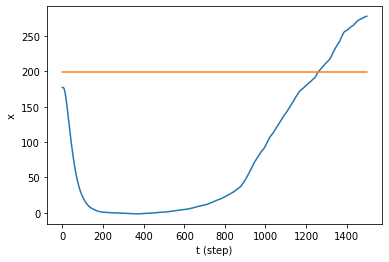

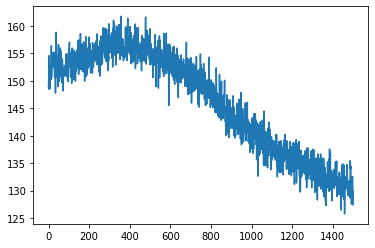

Episode   1, episode return -440.7, last 20 avg -720.9


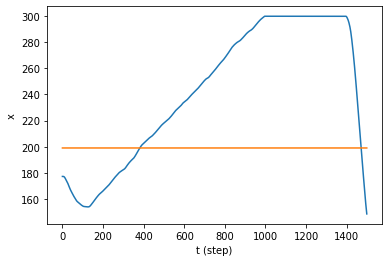

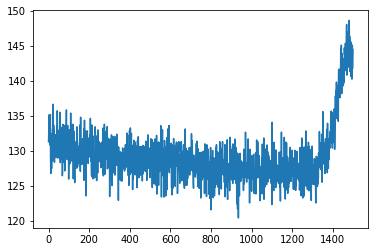

Episode   2, episode return -279.6, last 20 avg -573.8


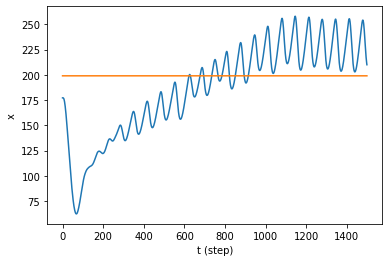

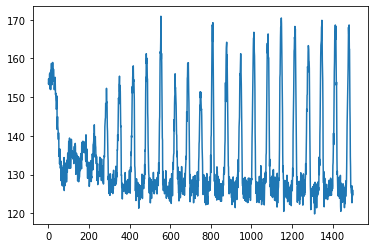

Episode   3, episode return -264.7, last 20 avg -496.5


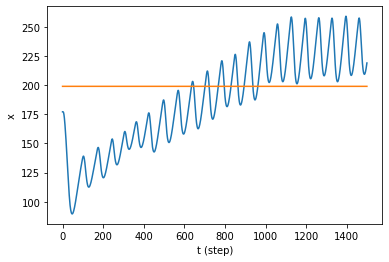

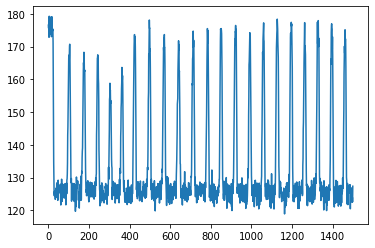

Episode   4, episode return -268.8, last 20 avg -451.0


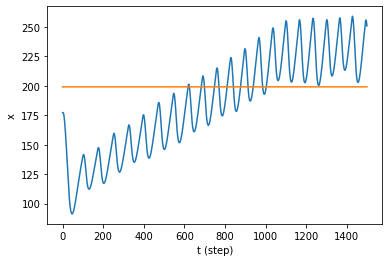

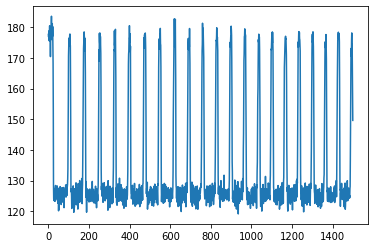

Episode   5, episode return -266.6, last 20 avg -420.2


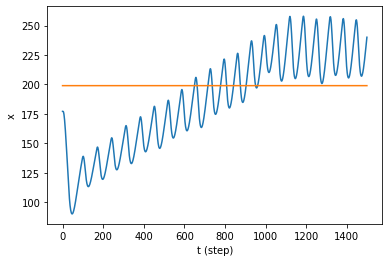

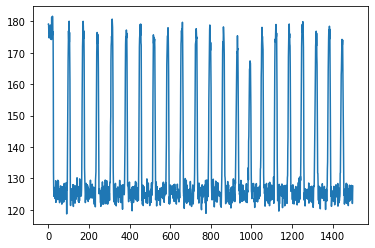

Episode   6, episode return -262.6, last 20 avg -397.7


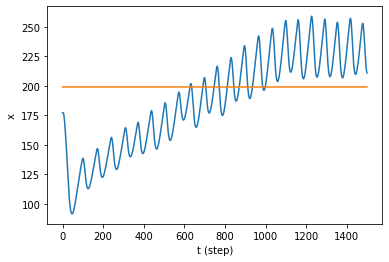

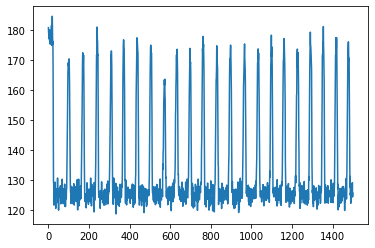

Episode   7, episode return -262.4, last 20 avg -380.8


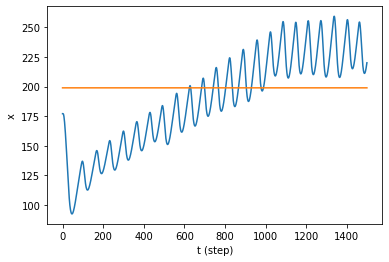

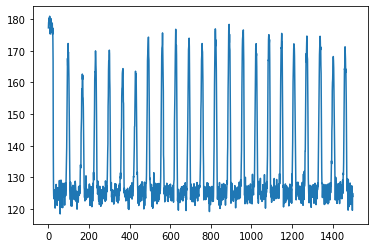

Episode   8, episode return -260.1, last 20 avg -367.4


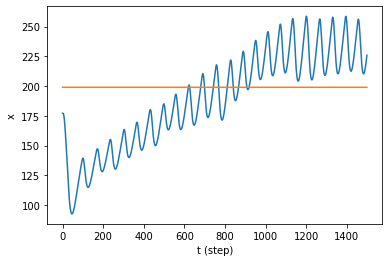

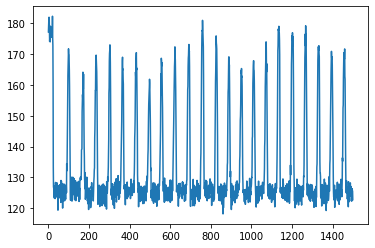

Episode   9, episode return -266.6, last 20 avg -357.3


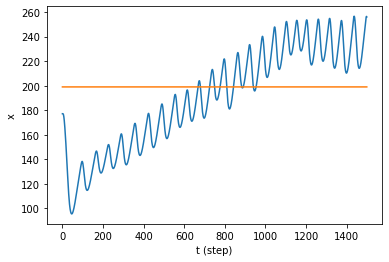

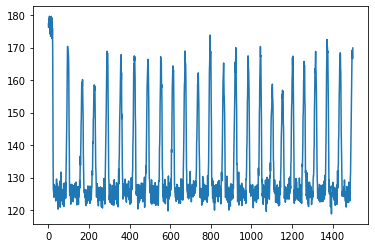

Episode  10, episode return -266.9, last 20 avg -349.1


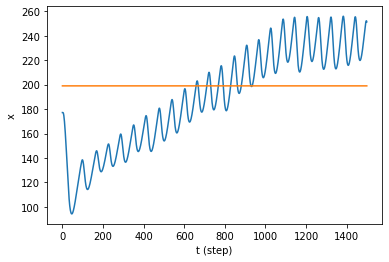

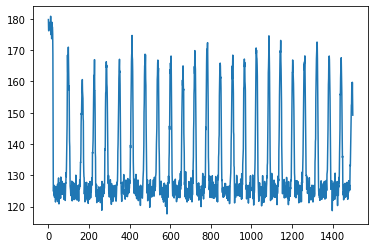

Episode  11, episode return -276.3, last 20 avg -343.0


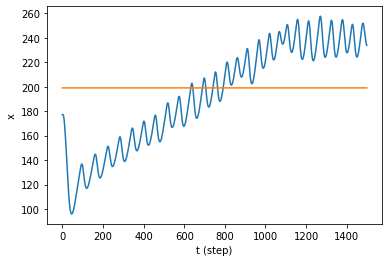

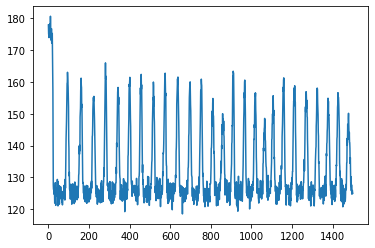

Episode  12, episode return -274.1, last 20 avg -337.7


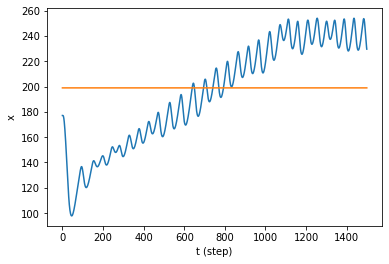

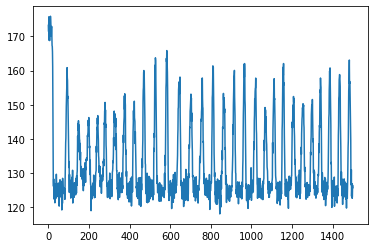

Episode  13, episode return -264.9, last 20 avg -332.5


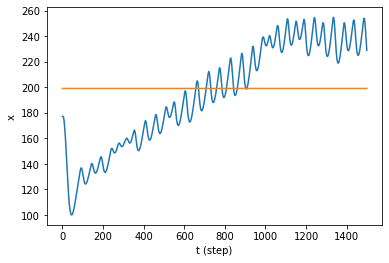

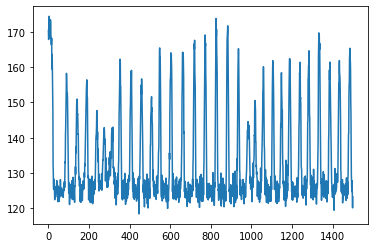

Episode  14, episode return -258.5, last 20 avg -327.6


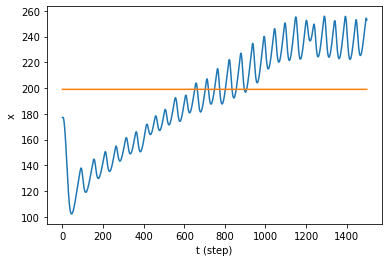

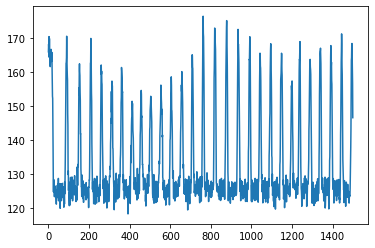

Episode  15, episode return -271.7, last 20 avg -324.1


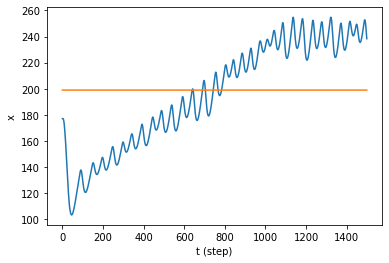

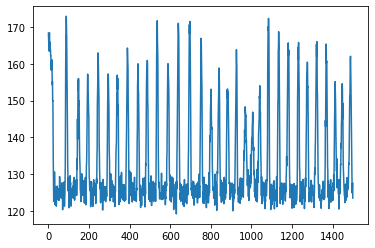

Episode  16, episode return -261.7, last 20 avg -320.4


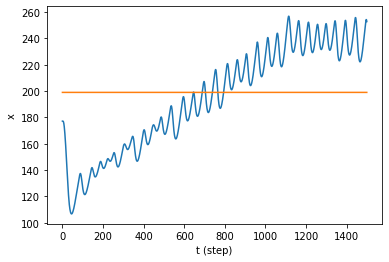

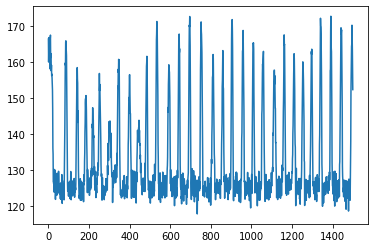

Episode  17, episode return -262.9, last 20 avg -317.2


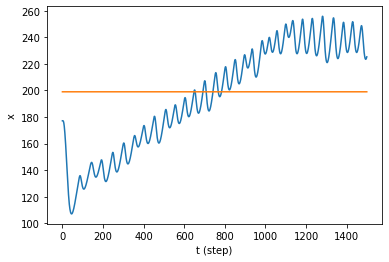

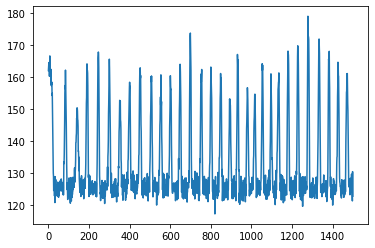

Episode  18, episode return -260.4, last 20 avg -314.2


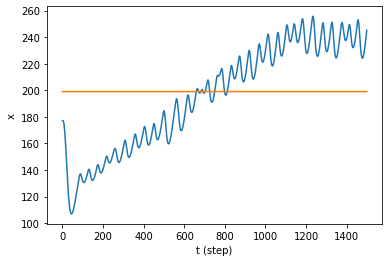

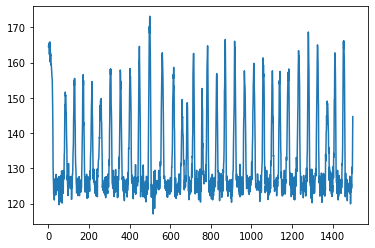

Episode  19, episode return -258.5, last 20 avg -311.4


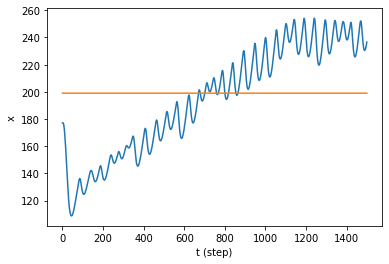

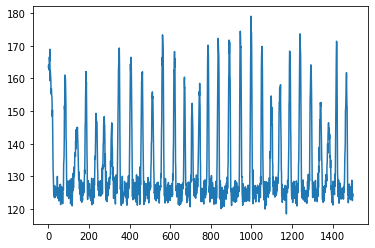

Episode  20, episode return -272.2, last 20 avg -275.0


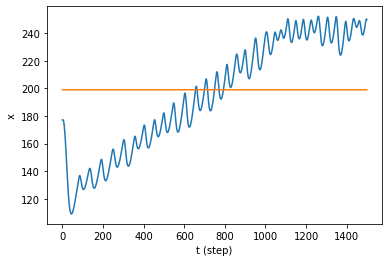

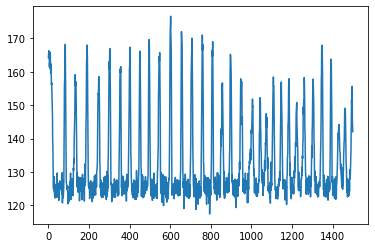

Episode  21, episode return -267.8, last 20 avg -266.4


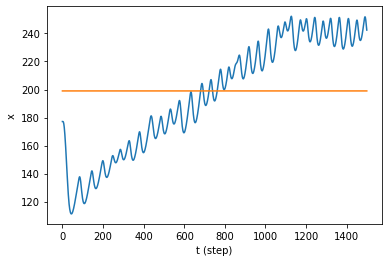

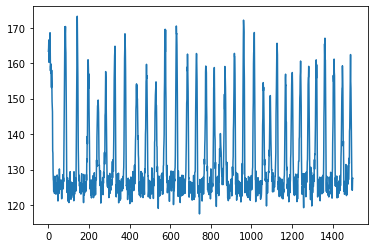

Episode  22, episode return -253.0, last 20 avg -265.0


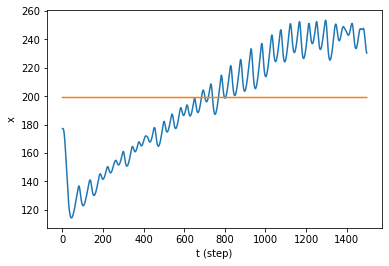

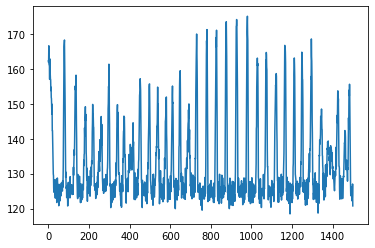

Episode  23, episode return -258.4, last 20 avg -264.7


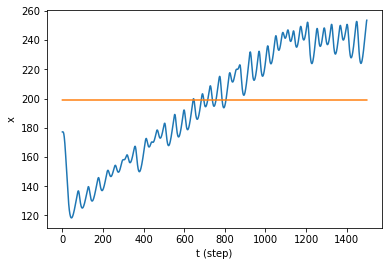

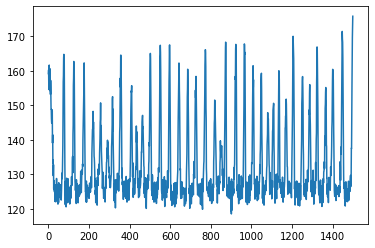

Episode  24, episode return -260.6, last 20 avg -264.3


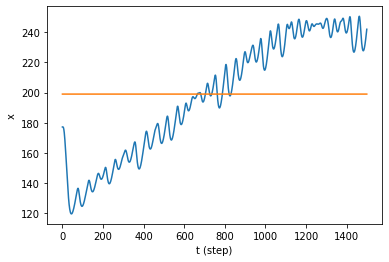

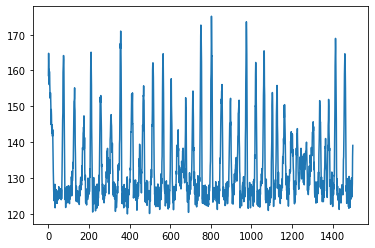

Episode  25, episode return -256.7, last 20 avg -263.8


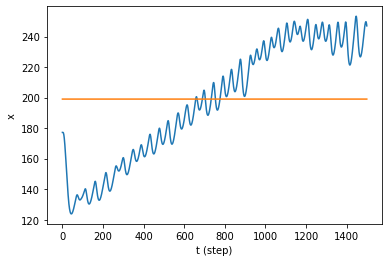

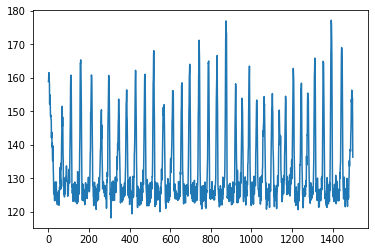

Episode  26, episode return -250.8, last 20 avg -263.2


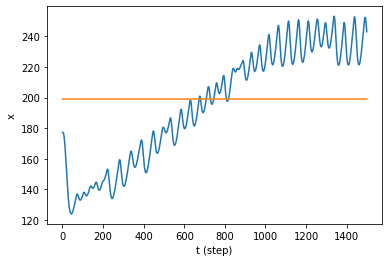

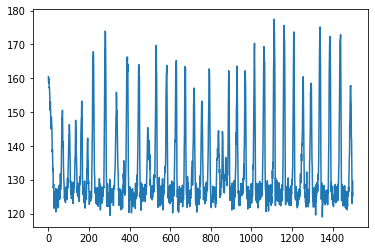

Episode  27, episode return -254.6, last 20 avg -262.8


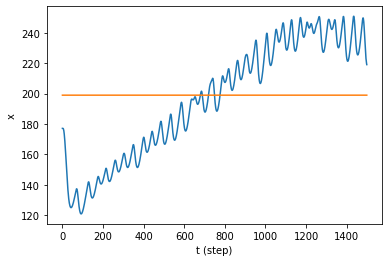

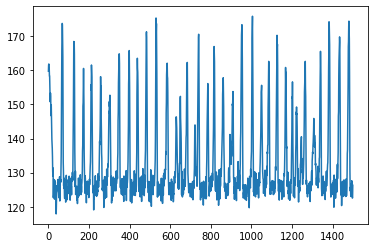

Episode  28, episode return -249.9, last 20 avg -262.3


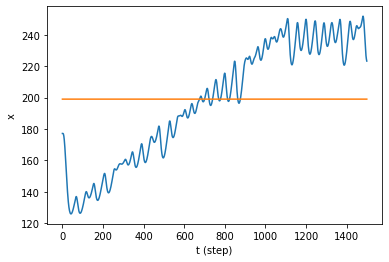

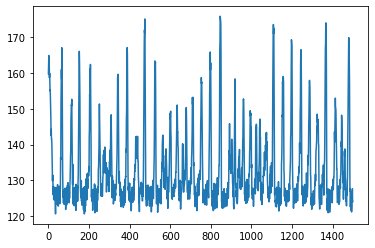

Episode  29, episode return -249.7, last 20 avg -261.5


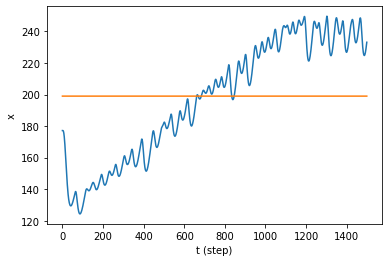

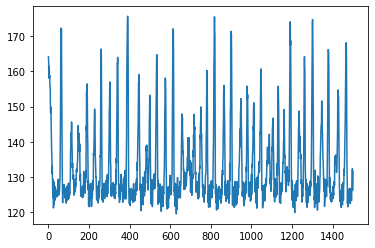

Episode  30, episode return -253.8, last 20 avg -260.8


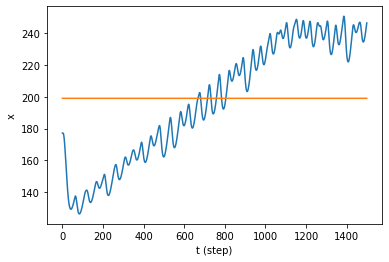

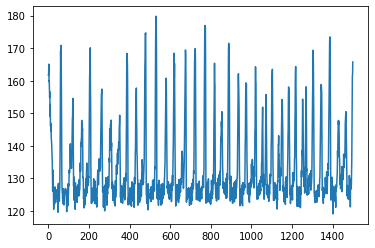

Episode  31, episode return -244.8, last 20 avg -259.2


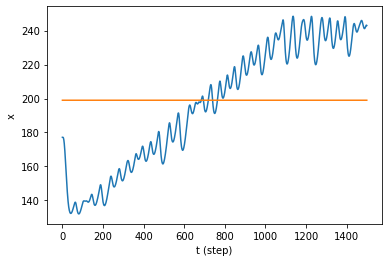

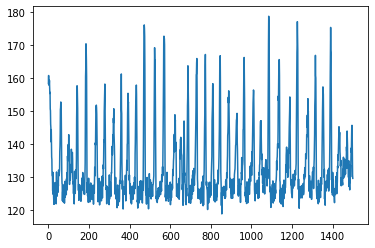

Episode  32, episode return -250.6, last 20 avg -258.1


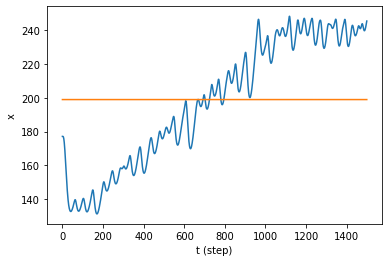

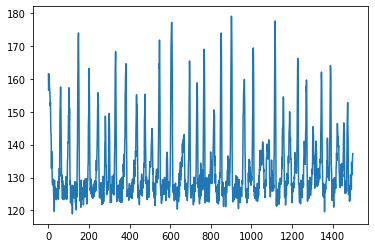

Episode  33, episode return -247.7, last 20 avg -257.2


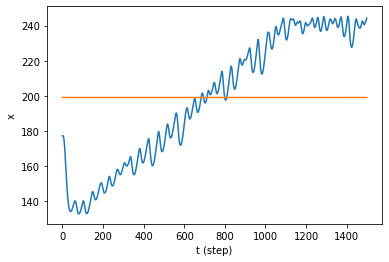

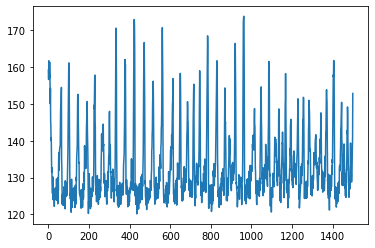

Episode  34, episode return -244.6, last 20 avg -256.5


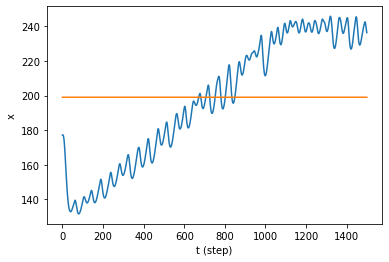

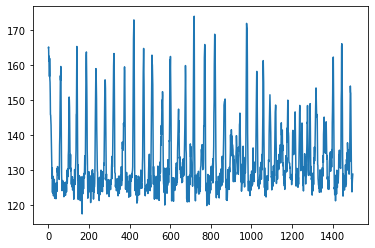

Episode  35, episode return -240.5, last 20 avg -255.0


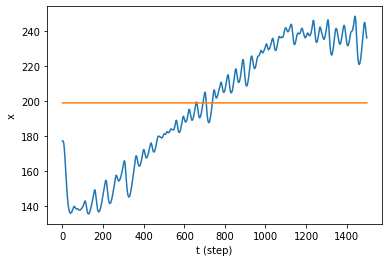

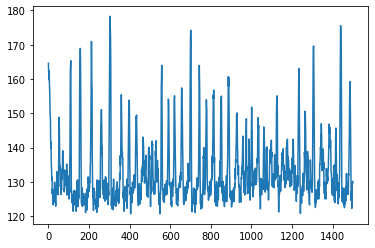

Episode  36, episode return -229.2, last 20 avg -253.3


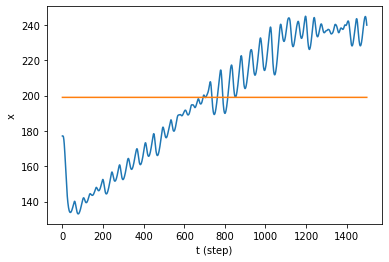

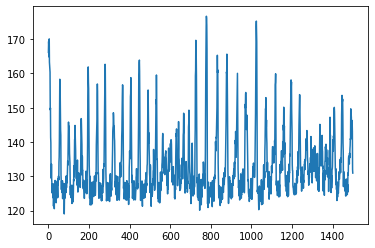

Episode  37, episode return -233.0, last 20 avg -251.8


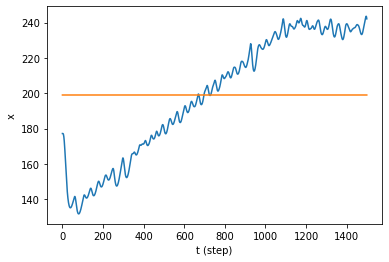

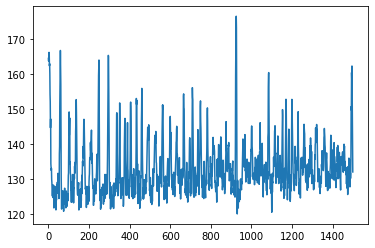

Episode  38, episode return -231.0, last 20 avg -250.4


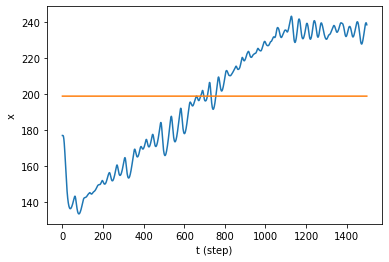

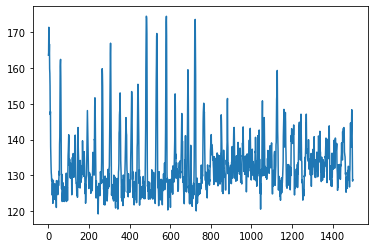

Episode  39, episode return -227.7, last 20 avg -248.8


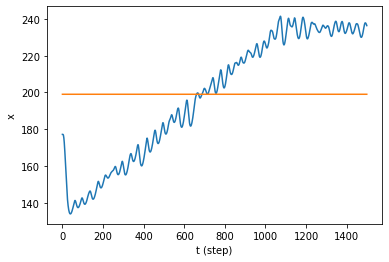

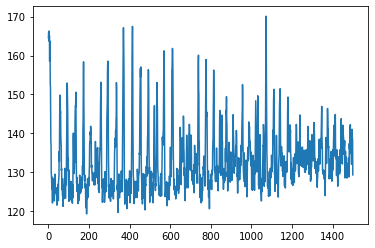

Episode  40, episode return -224.2, last 20 avg -246.4


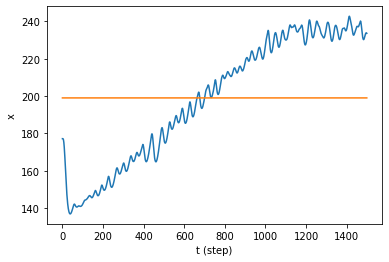

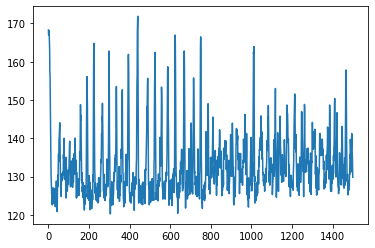

Episode  41, episode return -215.8, last 20 avg -243.8


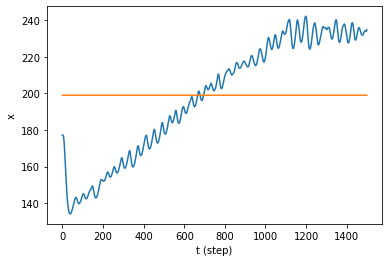

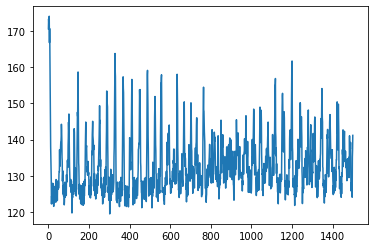

Episode  42, episode return -212.4, last 20 avg -241.8


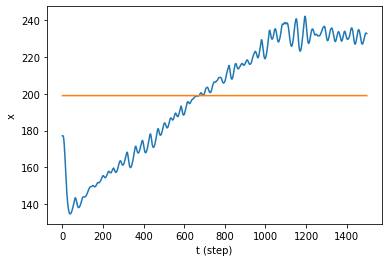

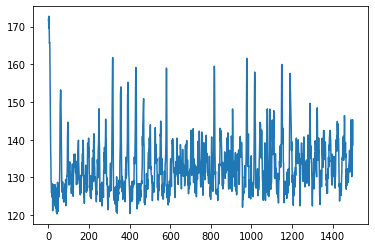

Episode  43, episode return -205.0, last 20 avg -239.1


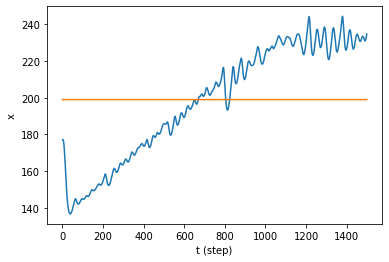

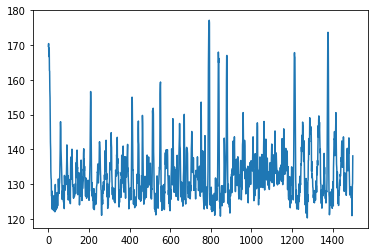

Episode  44, episode return -206.2, last 20 avg -236.4


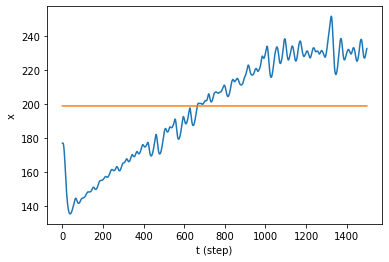

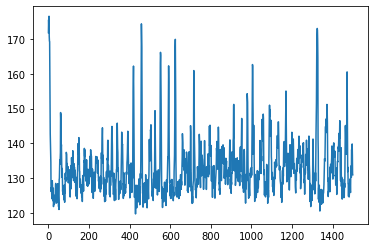

Episode  45, episode return -198.9, last 20 avg -233.5


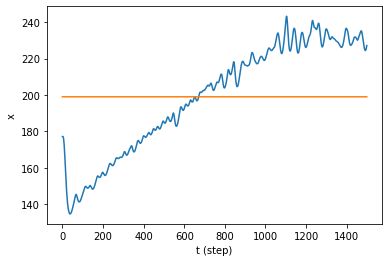

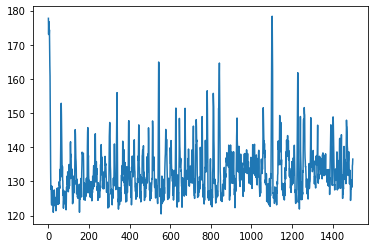

Episode  46, episode return -191.6, last 20 avg -230.6


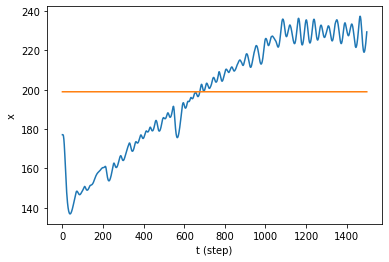

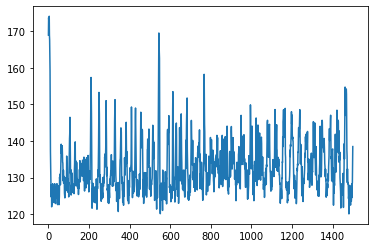

Episode  47, episode return -187.2, last 20 avg -227.2


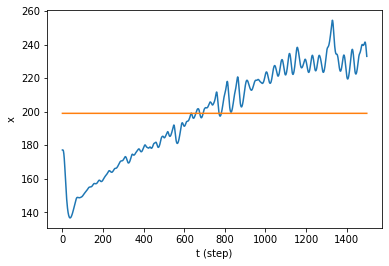

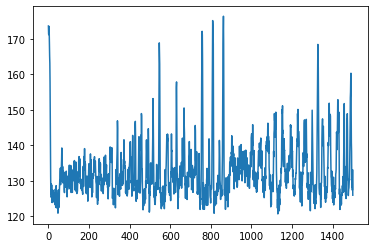

Episode  48, episode return -182.7, last 20 avg -223.8


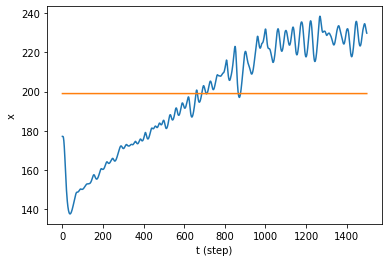

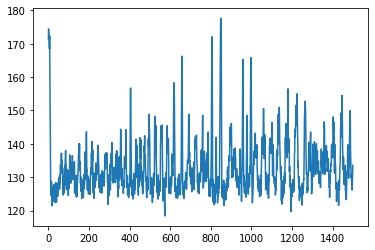

Episode  49, episode return -181.5, last 20 avg -220.4


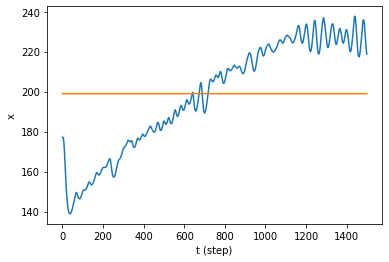

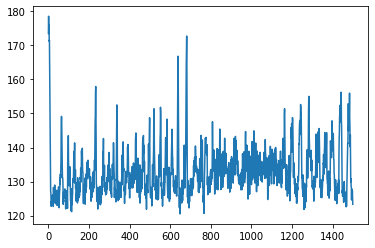

Episode  50, episode return -381.5, last 20 avg -226.8


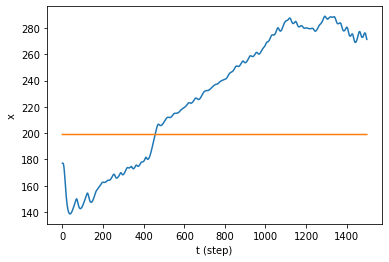

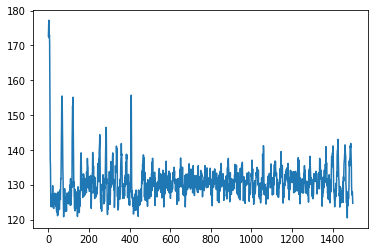

Episode  51, episode return -170.6, last 20 avg -223.1


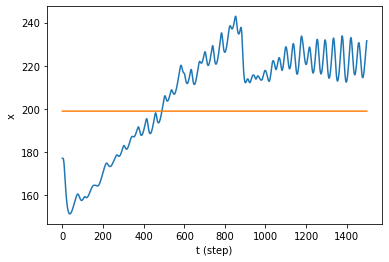

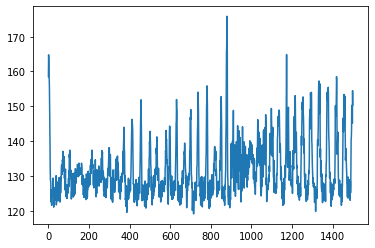

Episode  52, episode return -132.5, last 20 avg -217.2


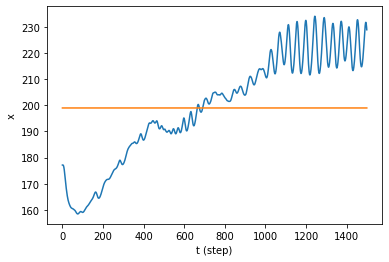

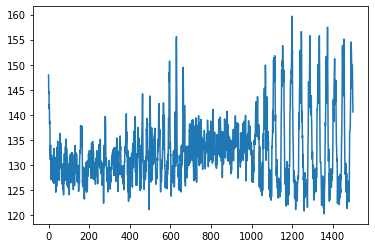

Episode  53, episode return -136.4, last 20 avg -211.6


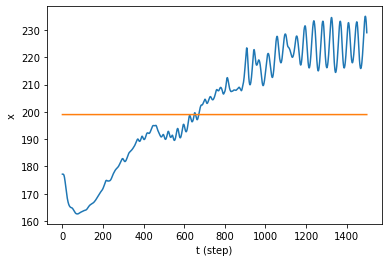

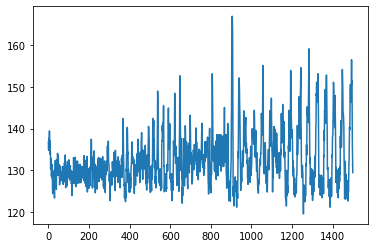

Episode  54, episode return -132.7, last 20 avg -206.0


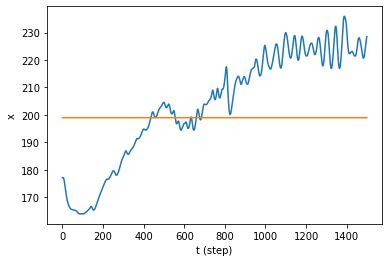

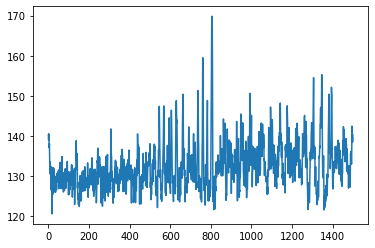

Episode  55, episode return -260.2, last 20 avg -207.0


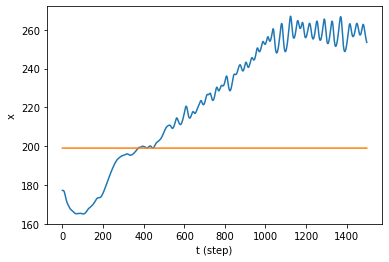

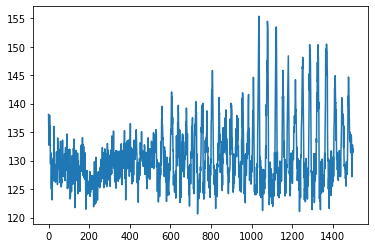

Episode  56, episode return -107.8, last 20 avg -200.9


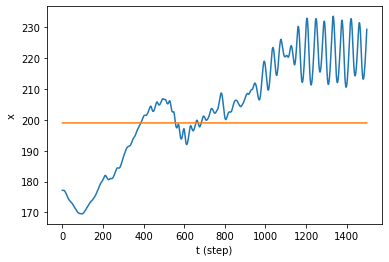

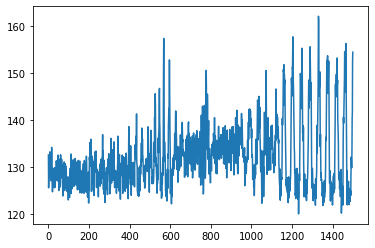

Episode  57, episode return -119.0, last 20 avg -195.2


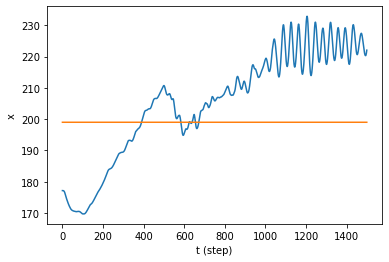

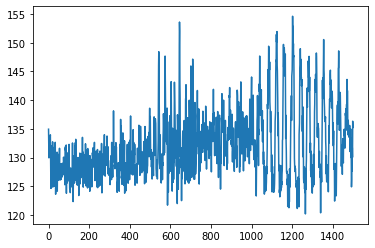

Episode  58, episode return -120.1, last 20 avg -189.7


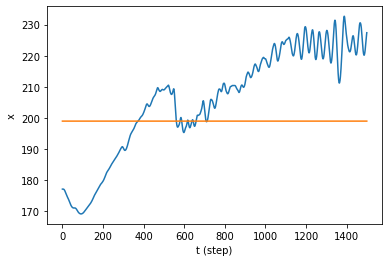

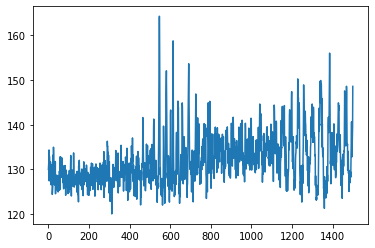

Episode  59, episode return -177.6, last 20 avg -187.2


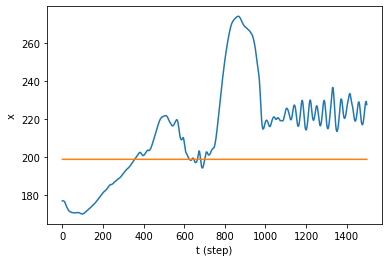

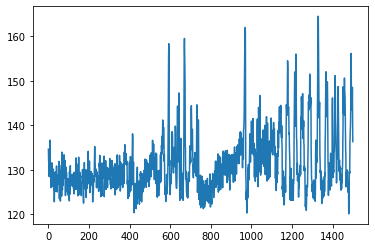

Episode  60, episode return -121.7, last 20 avg -182.1


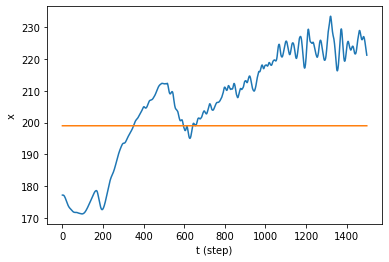

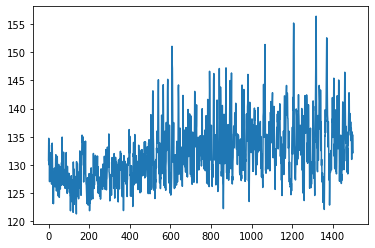

Episode  61, episode return -124.4, last 20 avg -177.5


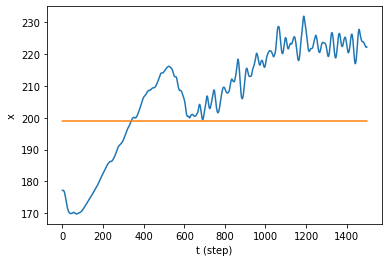

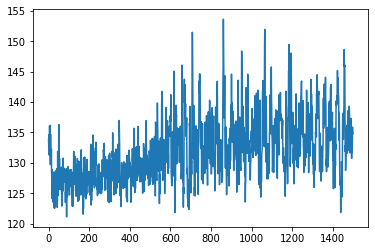

Episode  62, episode return -123.2, last 20 avg -173.0


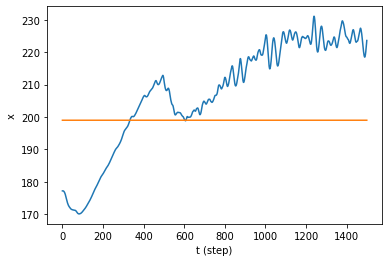

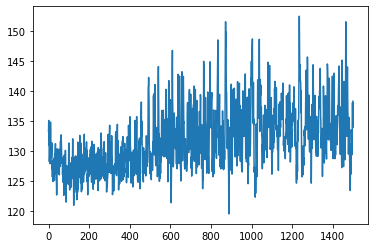

Episode  63, episode return -121.9, last 20 avg -168.9


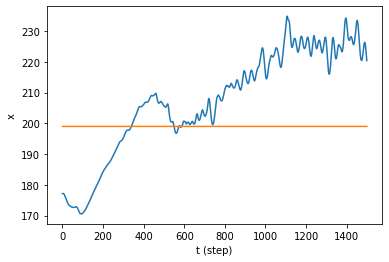

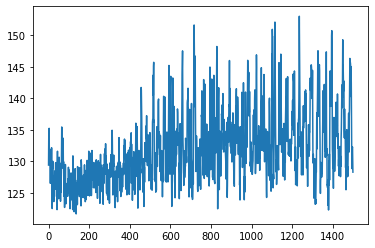

Episode  64, episode return -129.0, last 20 avg -165.0


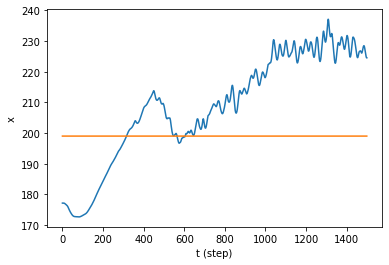

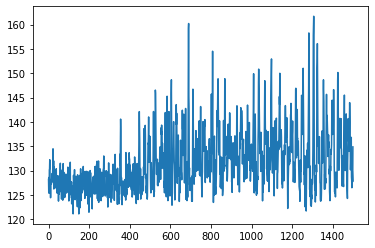

Episode  65, episode return -126.0, last 20 avg -161.4


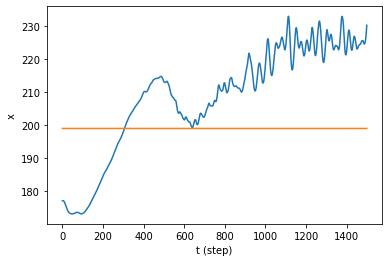

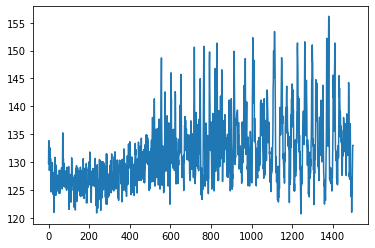

Episode  66, episode return -116.4, last 20 avg -157.6


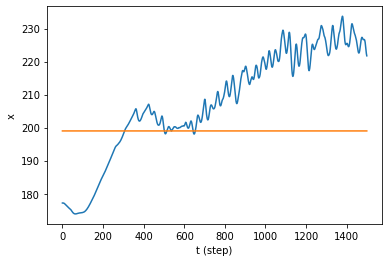

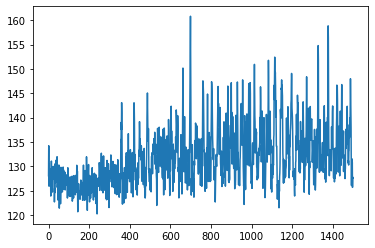

Episode  67, episode return -124.1, last 20 avg -154.5


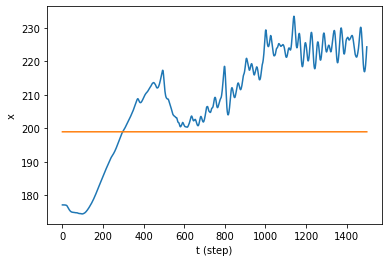

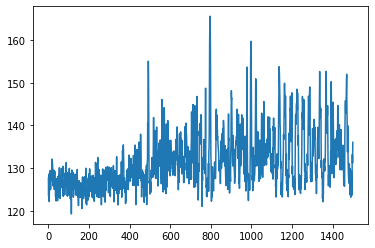

Episode  68, episode return -125.2, last 20 avg -151.6


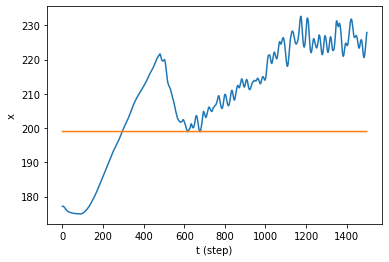

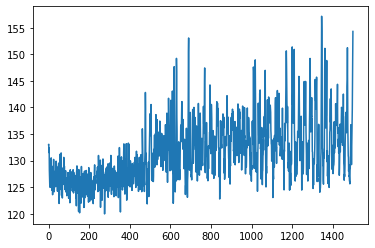

Episode  69, episode return -128.4, last 20 avg -148.9


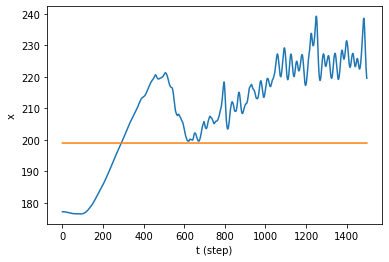

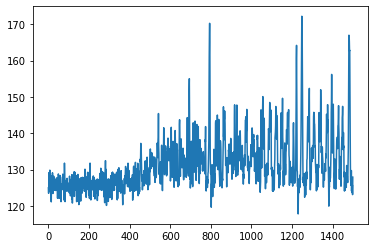

Episode  70, episode return -178.0, last 20 avg -138.8


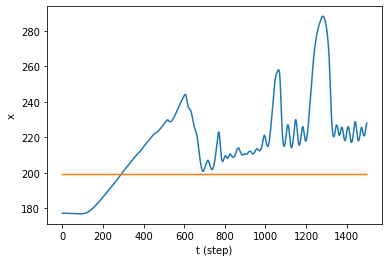

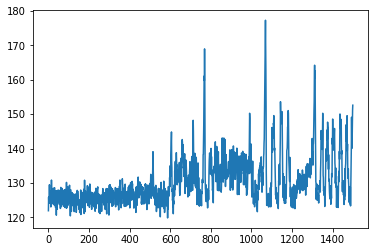

Episode  71, episode return -116.8, last 20 avg -136.1


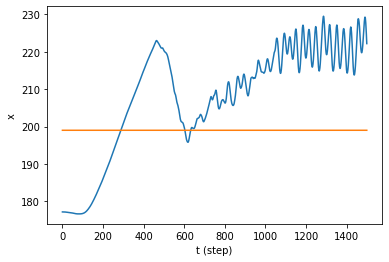

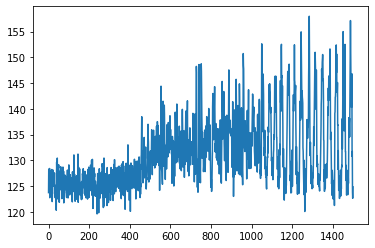

Episode  72, episode return -114.6, last 20 avg -135.2


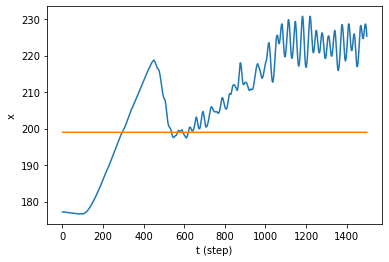

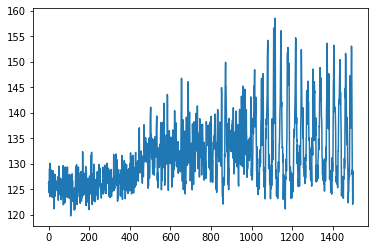

Episode  73, episode return -103.8, last 20 avg -133.5


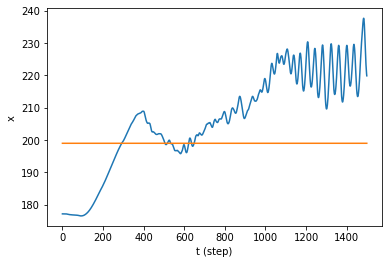

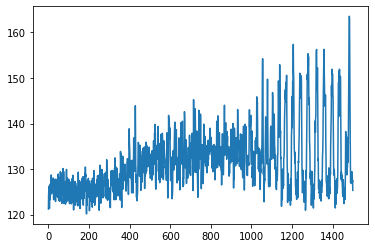

Episode  74, episode return -110.1, last 20 avg -132.4


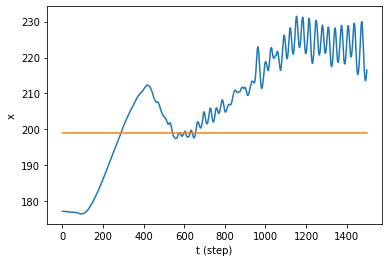

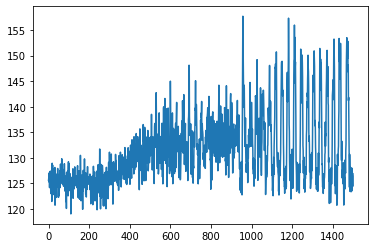

Episode  75, episode return -114.1, last 20 avg -125.1


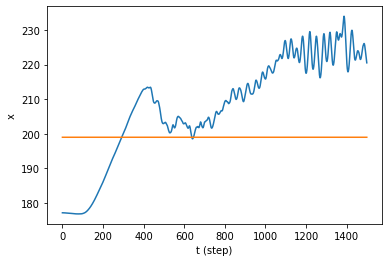

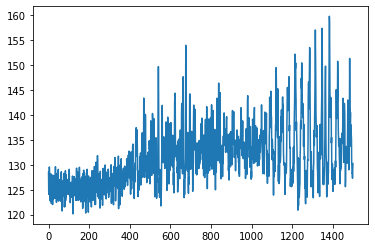

Episode  76, episode return -110.5, last 20 avg -125.2


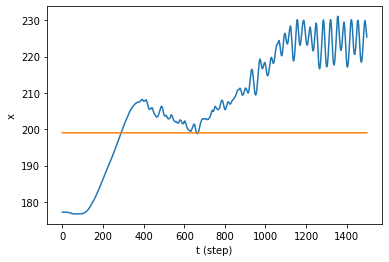

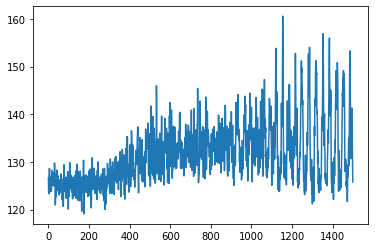

Episode  77, episode return -116.1, last 20 avg -125.1


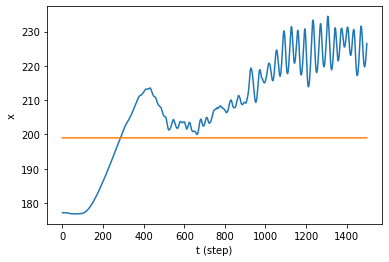

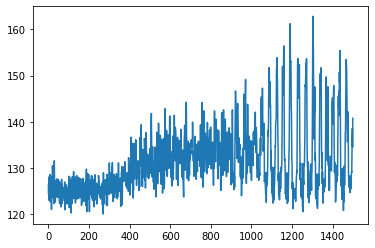

Episode  78, episode return -114.0, last 20 avg -124.8


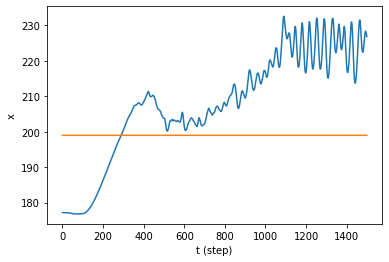

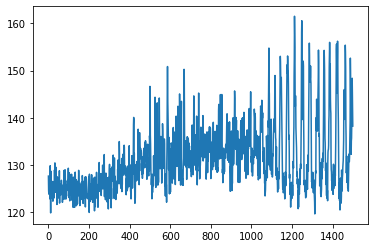

Episode  79, episode return -118.8, last 20 avg -121.9


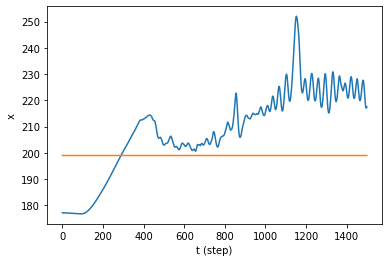

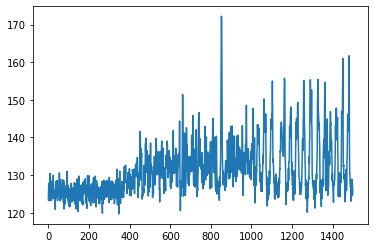

Episode  80, episode return -114.0, last 20 avg -121.5


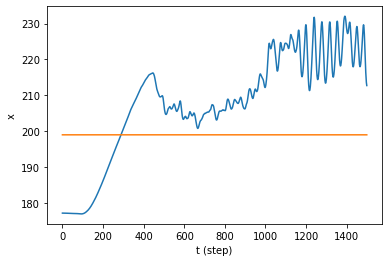

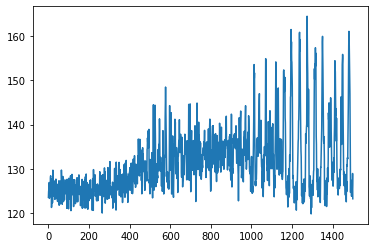

Episode  81, episode return -109.9, last 20 avg -120.7


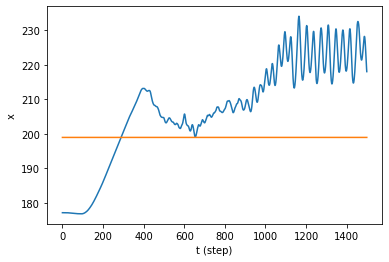

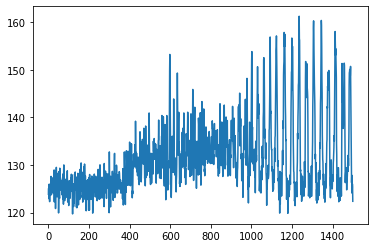

Episode  82, episode return -111.8, last 20 avg -120.2


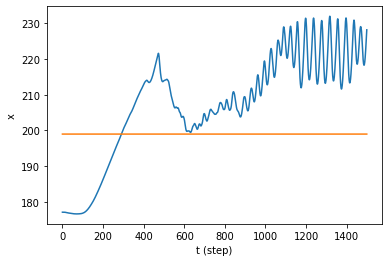

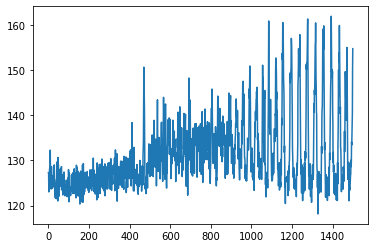

Episode  83, episode return -109.0, last 20 avg -119.5


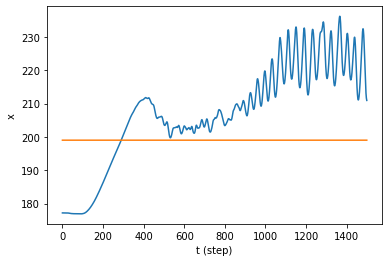

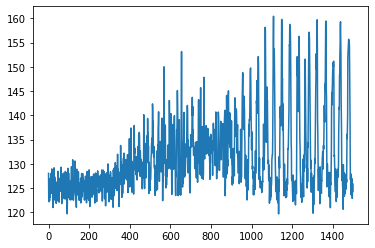

Episode  84, episode return -111.8, last 20 avg -118.7


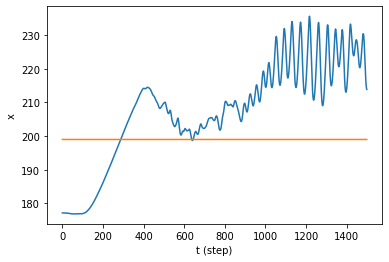

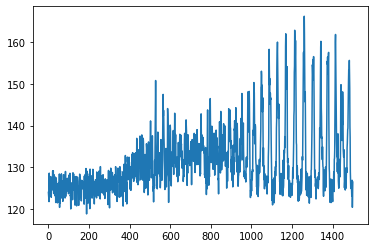

Episode  85, episode return -109.7, last 20 avg -117.8


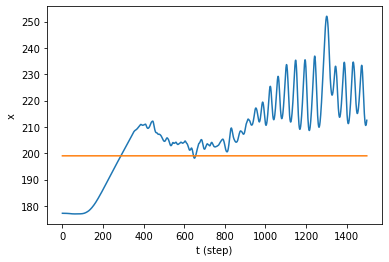

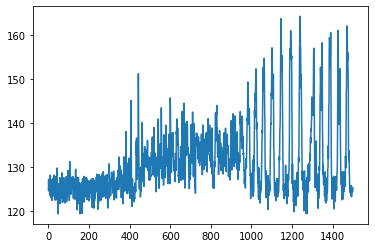

Episode  86, episode return -110.5, last 20 avg -117.6


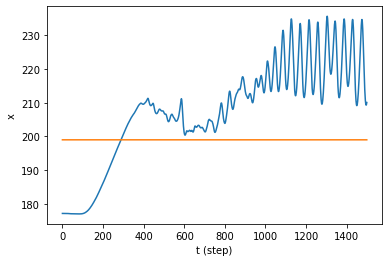

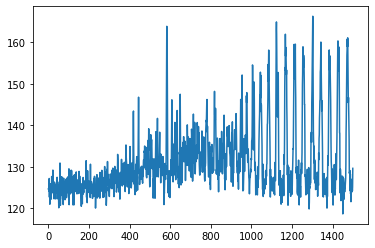

Episode  87, episode return -122.3, last 20 avg -117.5


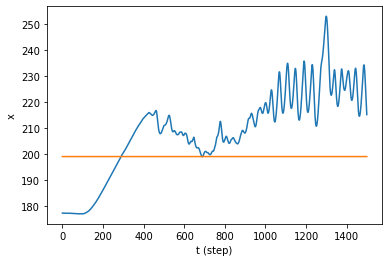

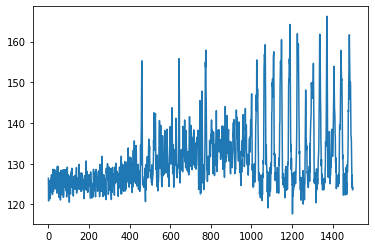

Episode  88, episode return -115.8, last 20 avg -117.0


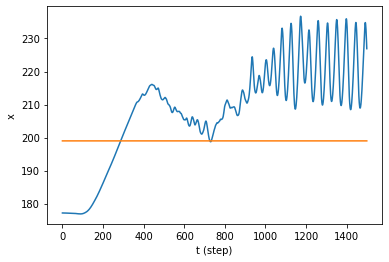

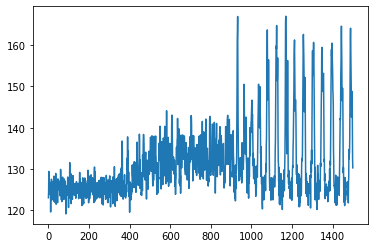

Episode  89, episode return -116.8, last 20 avg -116.4


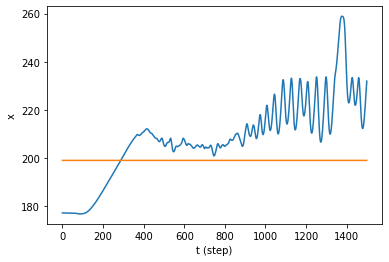

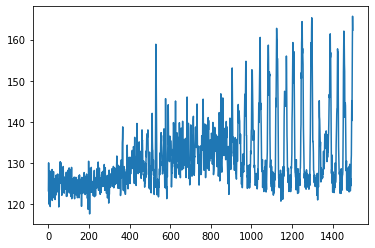

Episode  90, episode return -455.6, last 20 avg -130.3


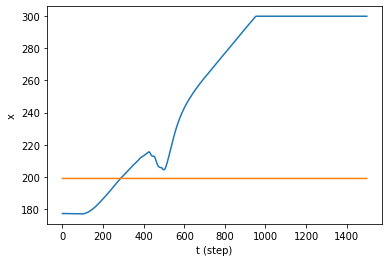

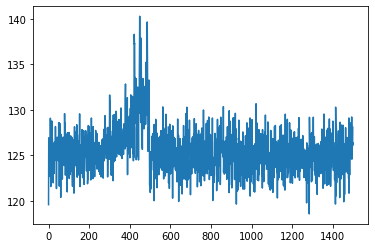

Episode  91, episode return -471.0, last 20 avg -148.0


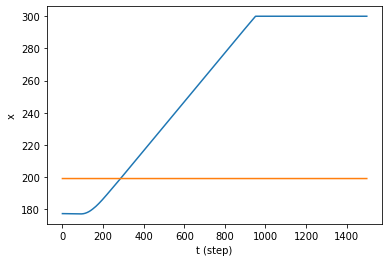

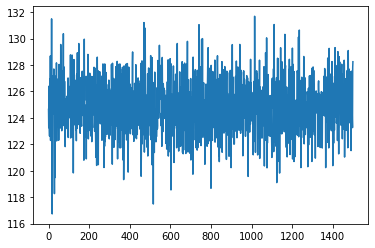

Episode  92, episode return -96.0, last 20 avg -147.1


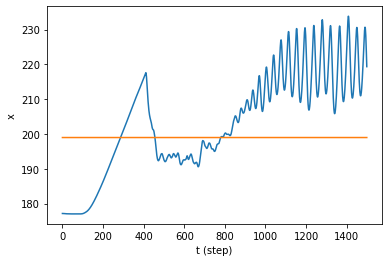

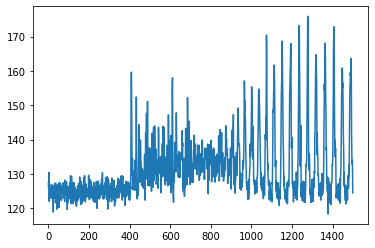

Episode  93, episode return -91.0, last 20 avg -146.4


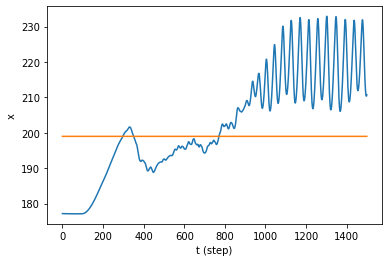

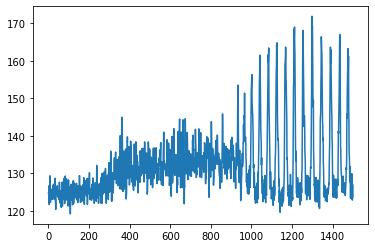

Episode  94, episode return -98.7, last 20 avg -145.9


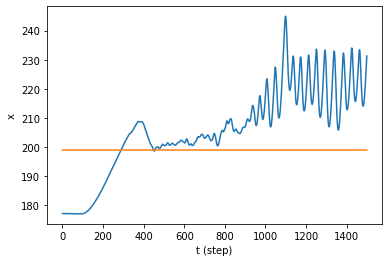

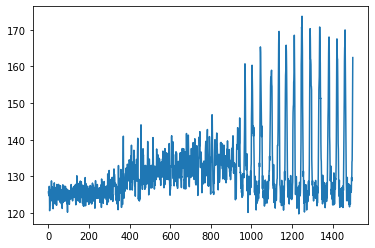

Episode  95, episode return -103.5, last 20 avg -145.3


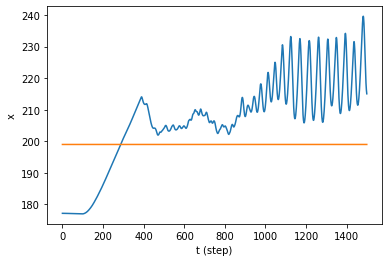

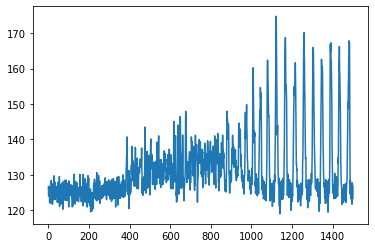

Episode  96, episode return -105.3, last 20 avg -145.1


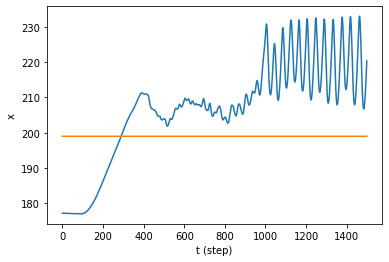

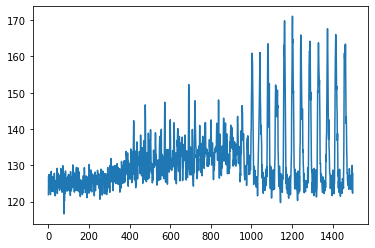

Episode  97, episode return -104.1, last 20 avg -144.5


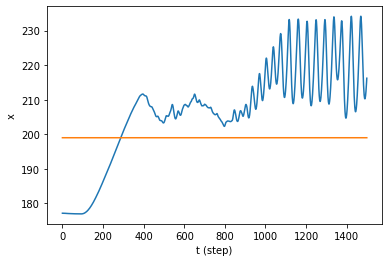

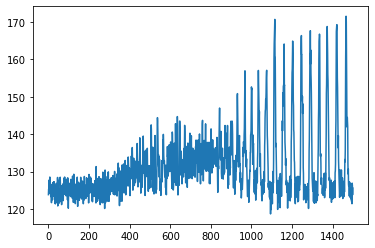

Episode  98, episode return -111.1, last 20 avg -144.3


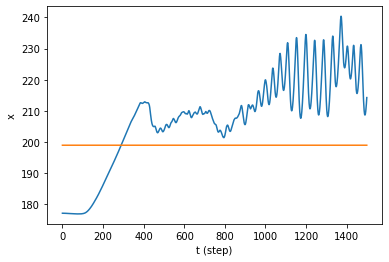

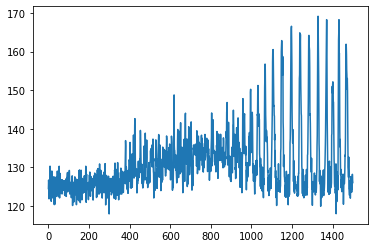

Episode  99, episode return -346.7, last 20 avg -155.7


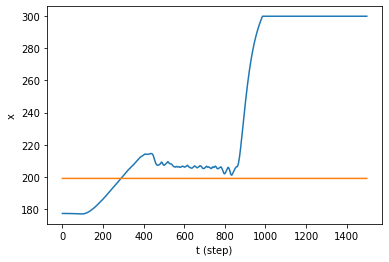

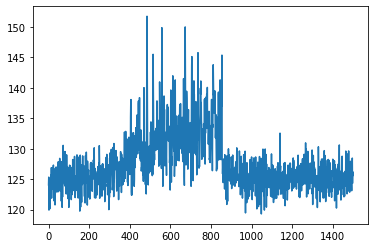

Episode 100, episode return -86.3, last 20 avg -154.3


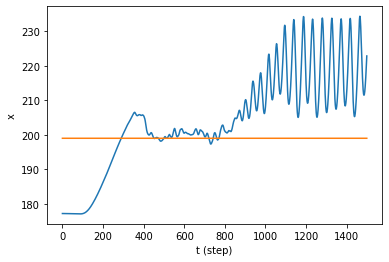

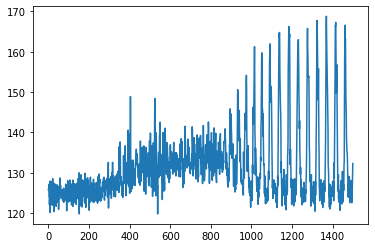

Episode 101, episode return -99.3, last 20 avg -153.8


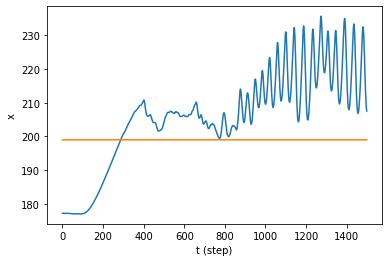

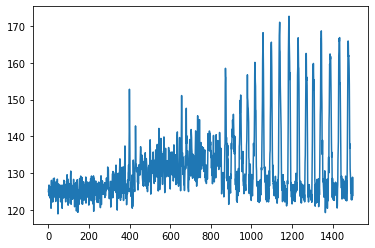

Episode 102, episode return -101.8, last 20 avg -153.3


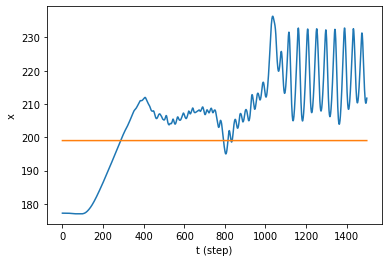

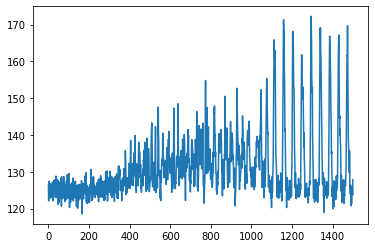

Episode 103, episode return -470.6, last 20 avg -171.4


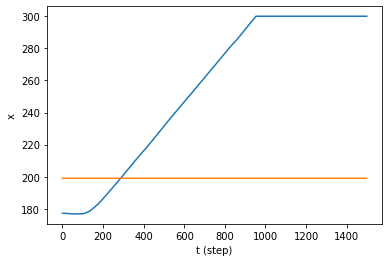

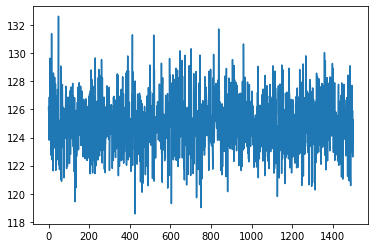

Episode 104, episode return -470.7, last 20 avg -189.3


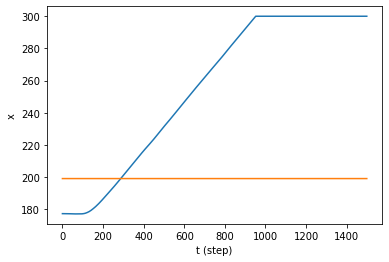

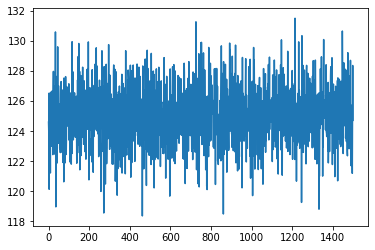

Episode 105, episode return -470.8, last 20 avg -207.4


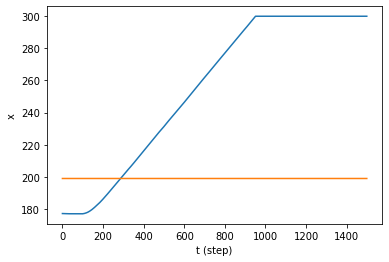

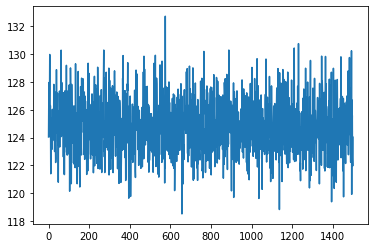

Episode 106, episode return -470.6, last 20 avg -225.4


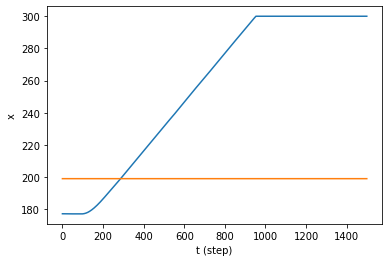

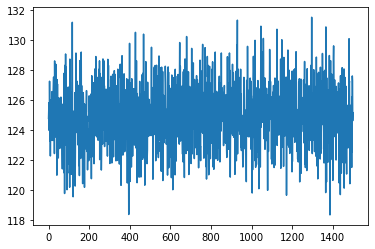

Episode 107, episode return -121.1, last 20 avg -225.3


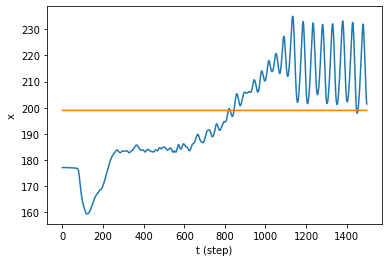

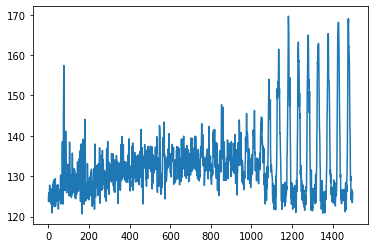

Episode 108, episode return -83.5, last 20 avg -223.7


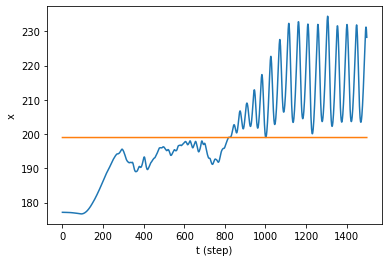

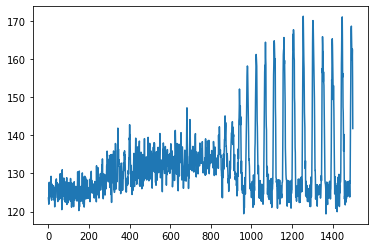

Episode 109, episode return -122.6, last 20 avg -224.0


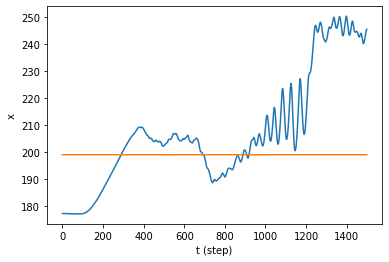

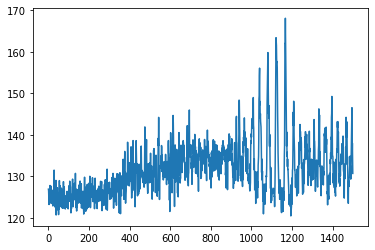

Episode 110, episode return -143.7, last 20 avg -208.4


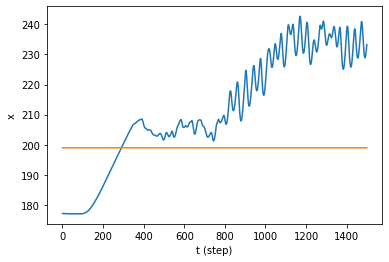

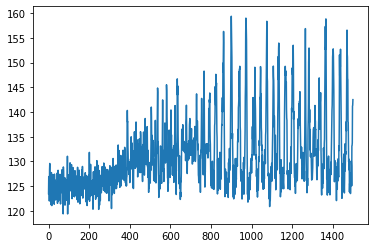

Episode 111, episode return -68.4, last 20 avg -188.3


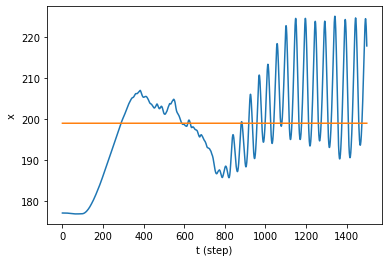

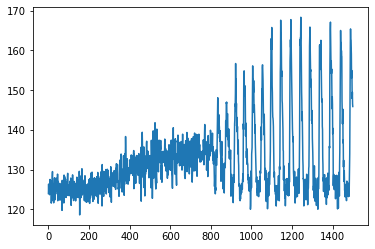

Episode 112, episode return -75.0, last 20 avg -187.2


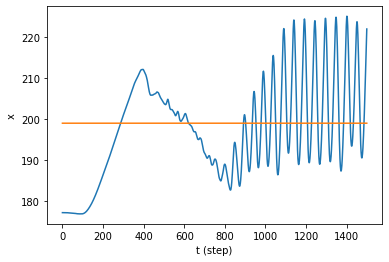

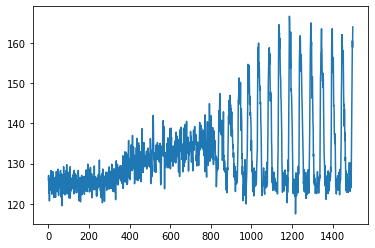

Episode 113, episode return -76.6, last 20 avg -186.5


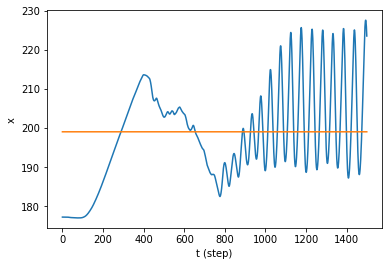

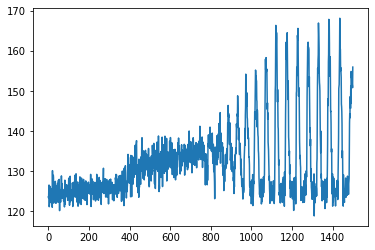

Episode 114, episode return -72.2, last 20 avg -185.2


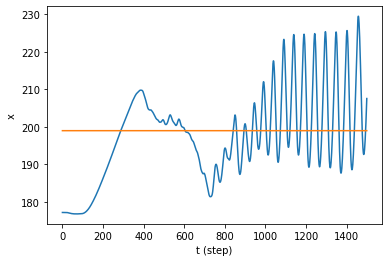

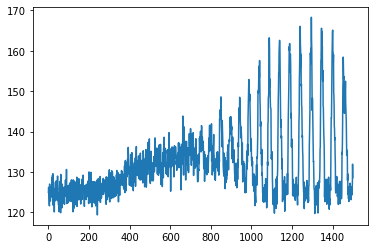

Episode 115, episode return -75.6, last 20 avg -183.8


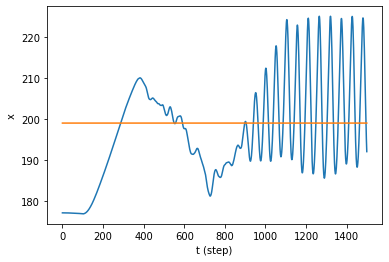

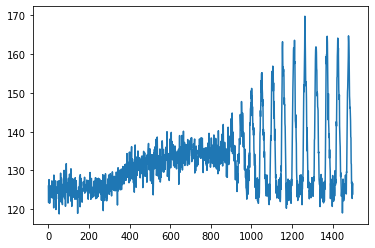

Episode 116, episode return -70.5, last 20 avg -182.1


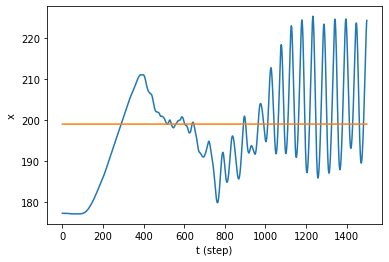

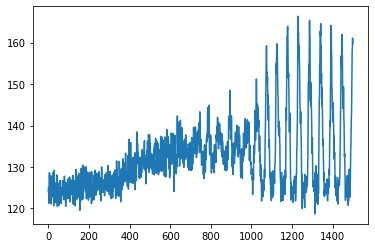

Episode 117, episode return -69.0, last 20 avg -180.3


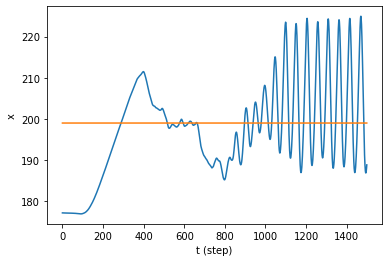

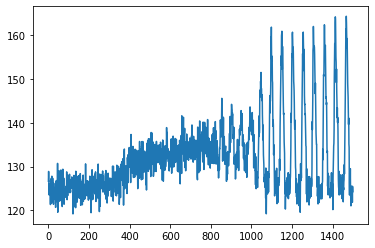

Episode 118, episode return -68.6, last 20 avg -178.2


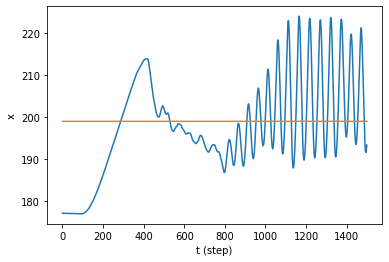

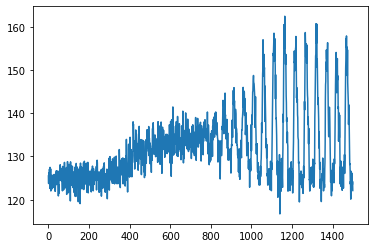

Episode 119, episode return -64.0, last 20 avg -164.1


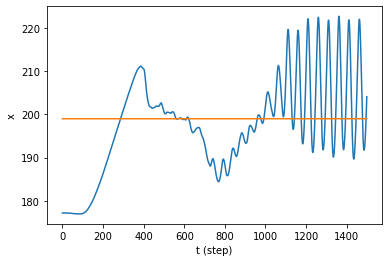

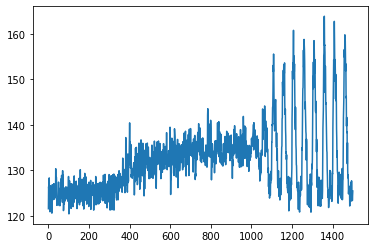

Episode 120, episode return -60.9, last 20 avg -162.8


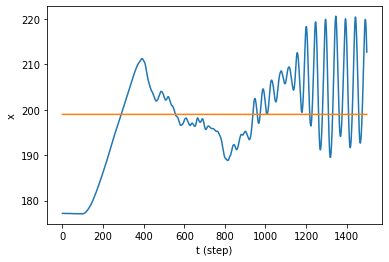

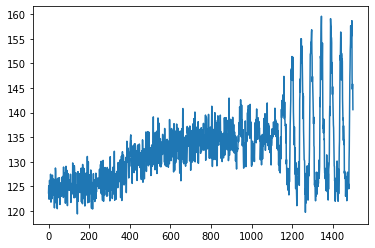

Episode 121, episode return -58.9, last 20 avg -160.8


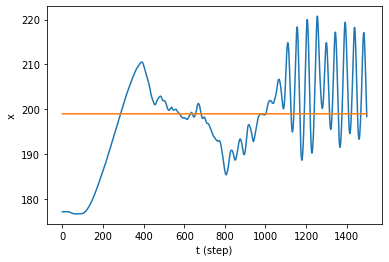

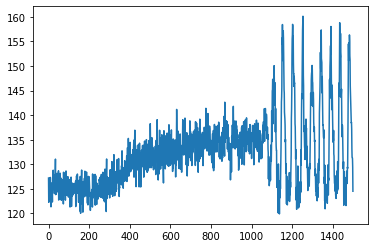

Episode 122, episode return -64.0, last 20 avg -158.9


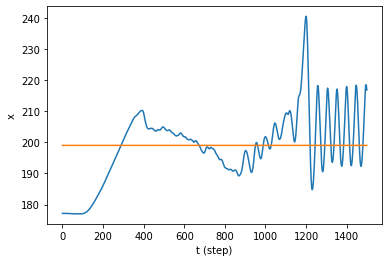

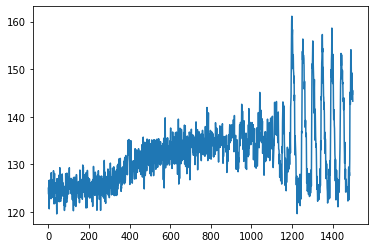

Episode 123, episode return -55.8, last 20 avg -138.1


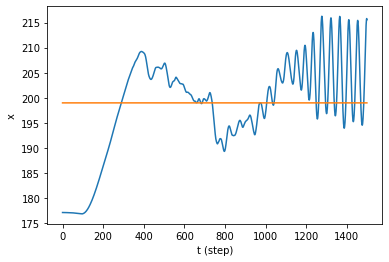

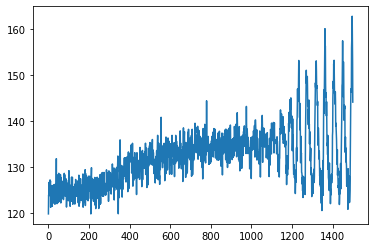

Episode 124, episode return -52.9, last 20 avg -117.2


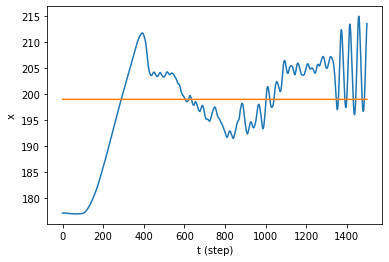

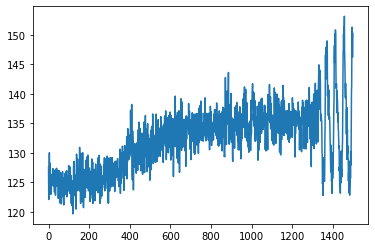

Episode 125, episode return -53.9, last 20 avg -96.4


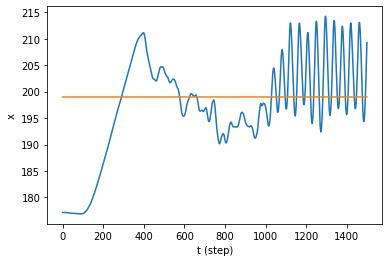

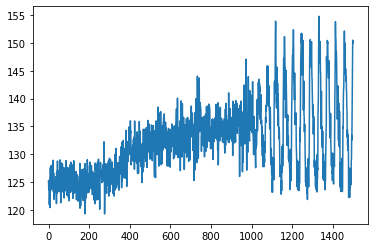

Episode 126, episode return -54.0, last 20 avg -75.6


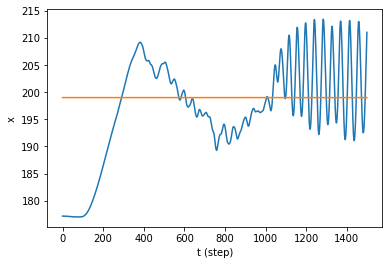

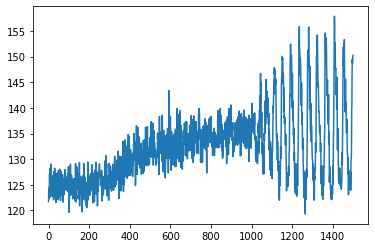

Episode 127, episode return -53.0, last 20 avg -72.2


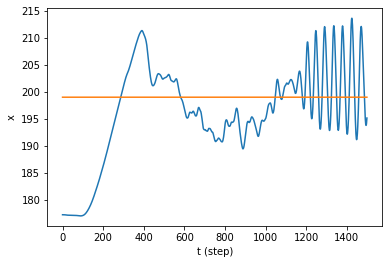

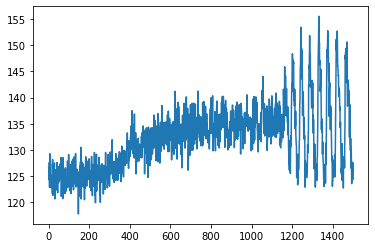

Episode 128, episode return -52.4, last 20 avg -70.6


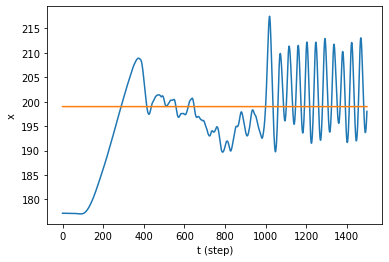

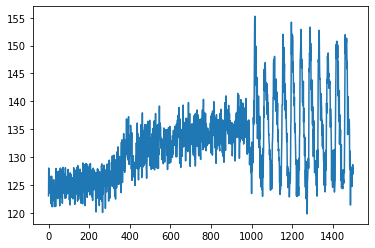

Episode 129, episode return -50.0, last 20 avg -67.0


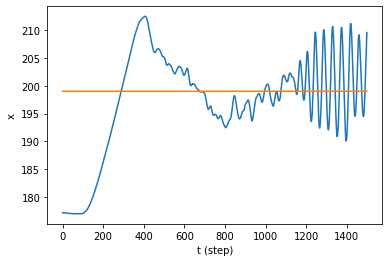

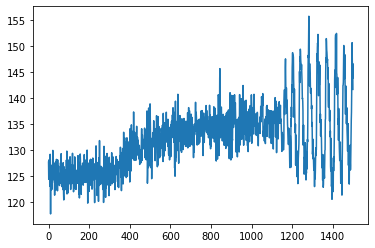

Episode 130, episode return -47.5, last 20 avg -62.2


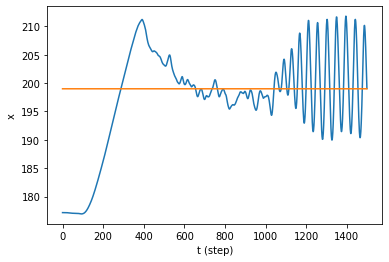

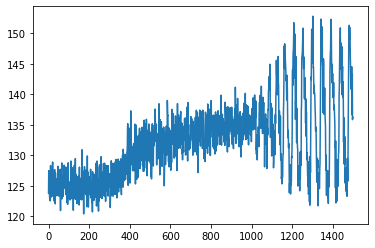

Episode 131, episode return -50.2, last 20 avg -61.3


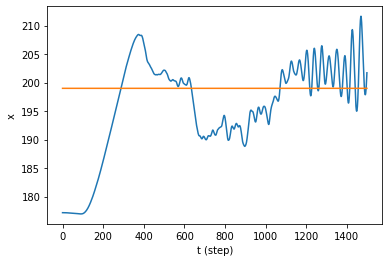

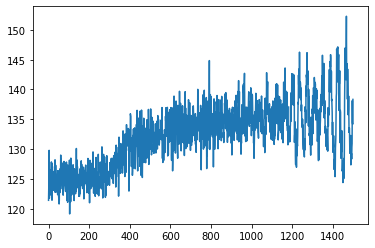

Episode 132, episode return -54.1, last 20 avg -60.2


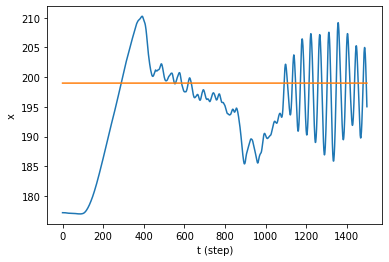

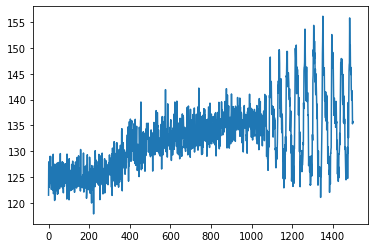

Episode 133, episode return -58.6, last 20 avg -59.3


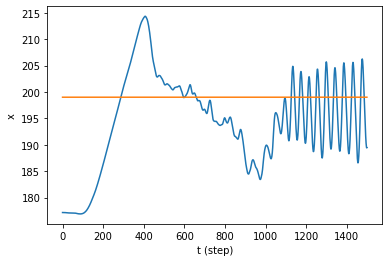

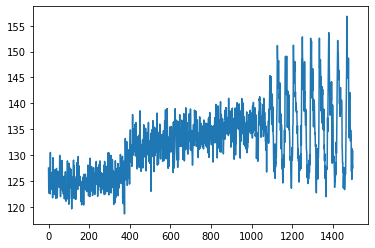

Episode 134, episode return -57.1, last 20 avg -58.6


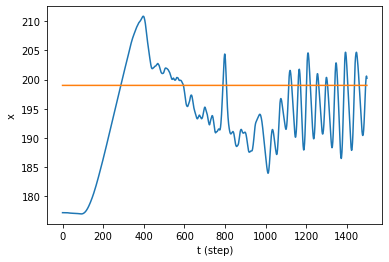

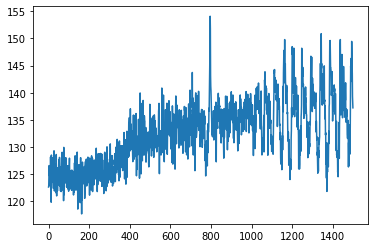

Episode 135, episode return -44.3, last 20 avg -57.0


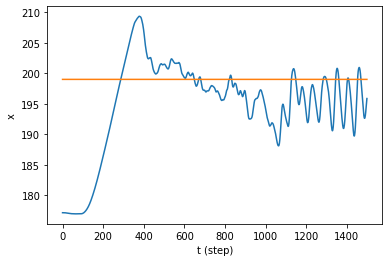

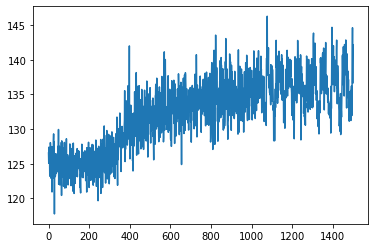

Episode 136, episode return -46.3, last 20 avg -55.8


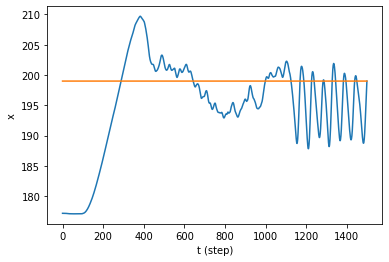

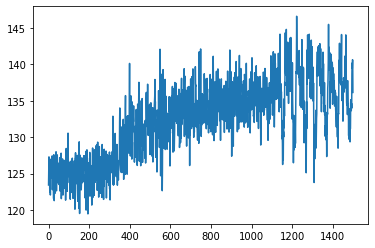

Episode 137, episode return -48.2, last 20 avg -54.7


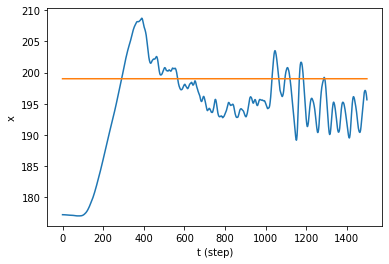

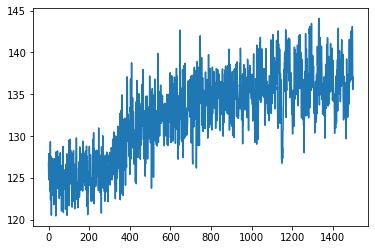

Episode 138, episode return -48.1, last 20 avg -53.7


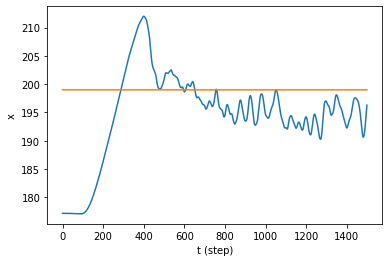

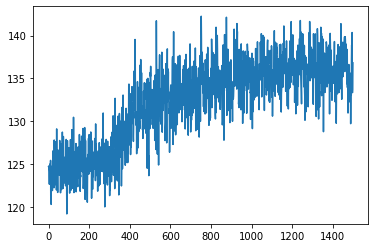

Episode 139, episode return -51.1, last 20 avg -53.1


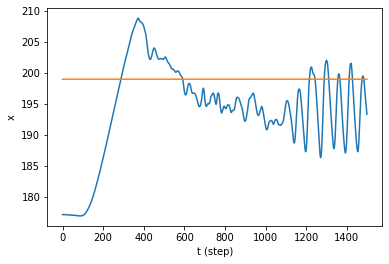

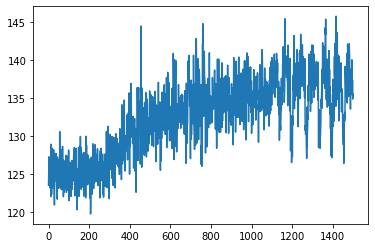

Episode 140, episode return -48.9, last 20 avg -52.5


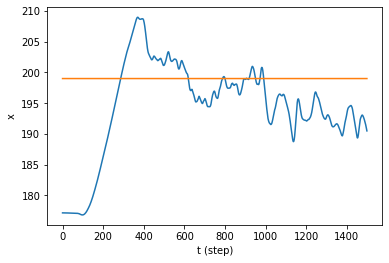

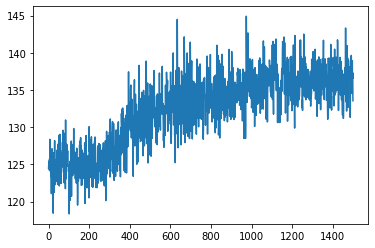

Episode 141, episode return -53.0, last 20 avg -52.2


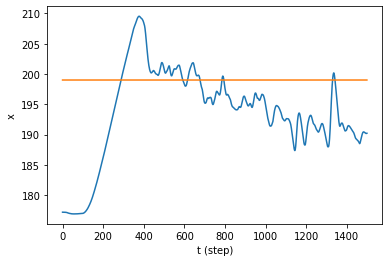

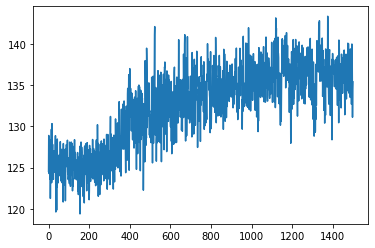

Episode 142, episode return -54.2, last 20 avg -51.7


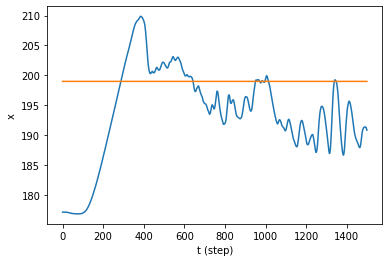

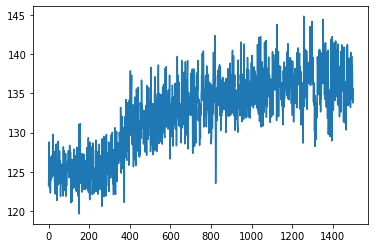

Episode 143, episode return -50.0, last 20 avg -51.4


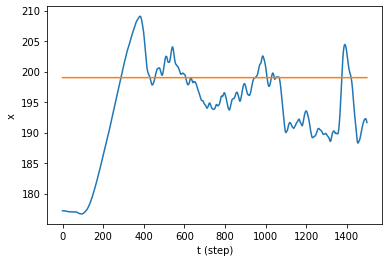

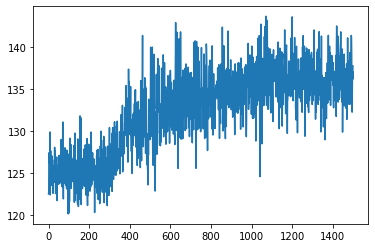

Episode 144, episode return -42.5, last 20 avg -50.9


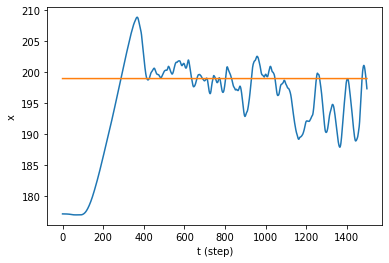

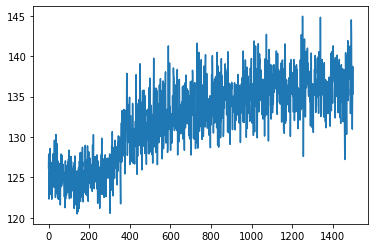

Episode 145, episode return -53.7, last 20 avg -50.9


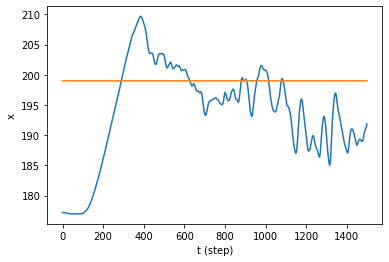

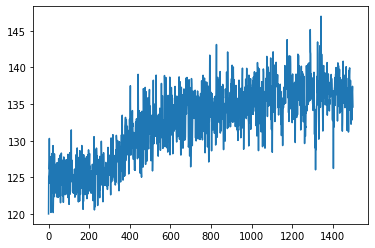

Episode 146, episode return -48.4, last 20 avg -50.6


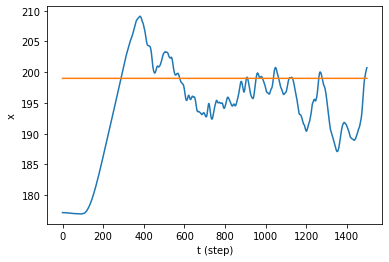

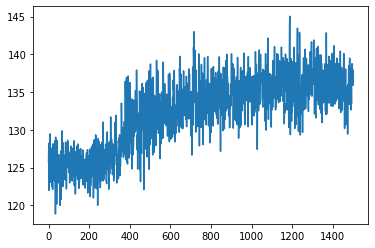

Episode 147, episode return -41.0, last 20 avg -50.0


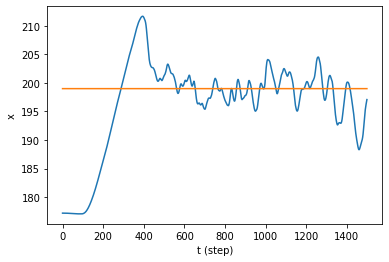

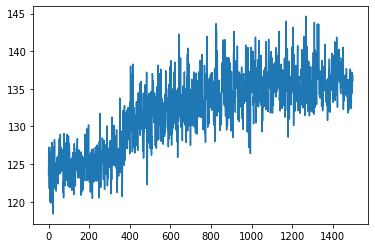

Episode 148, episode return -41.4, last 20 avg -49.4


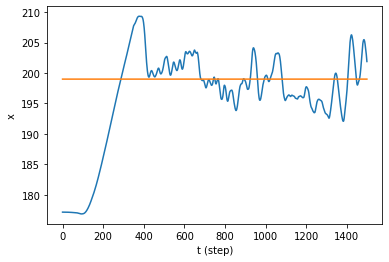

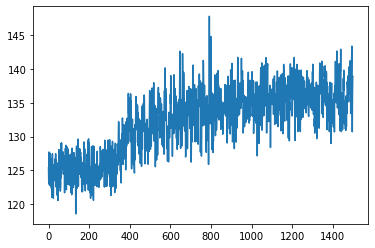

Episode 149, episode return -47.1, last 20 avg -49.3


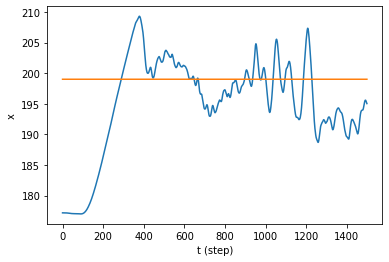

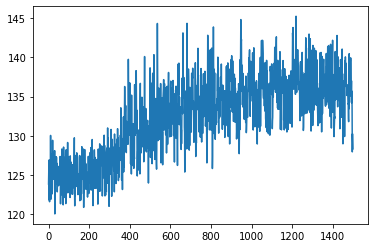

Episode 150, episode return -43.5, last 20 avg -49.1


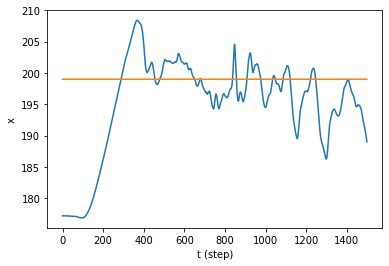

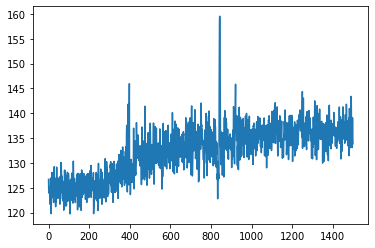

Episode 151, episode return -40.0, last 20 avg -48.6


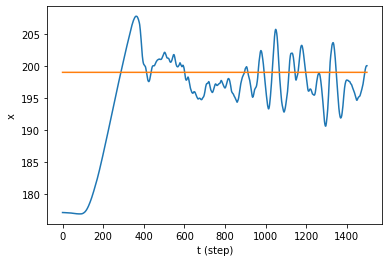

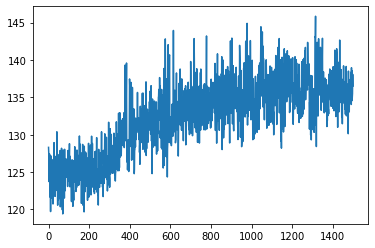

Episode 152, episode return -41.1, last 20 avg -47.9


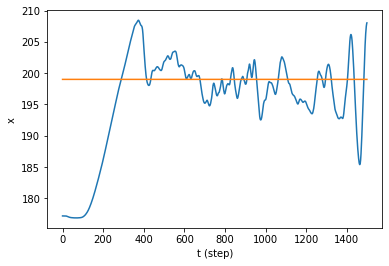

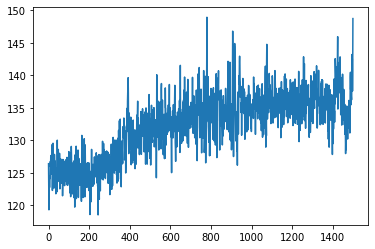

Episode 153, episode return -51.5, last 20 avg -47.6


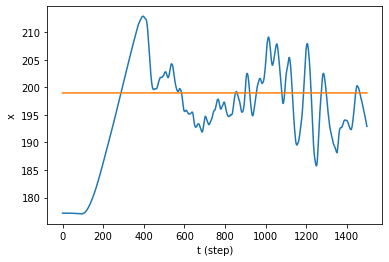

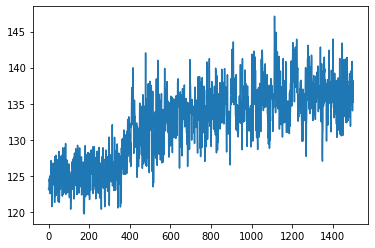

Episode 154, episode return -46.2, last 20 avg -47.0


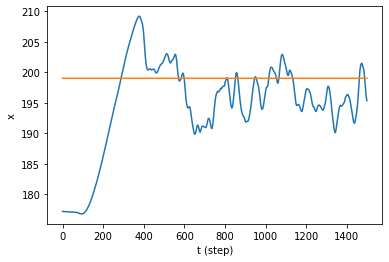

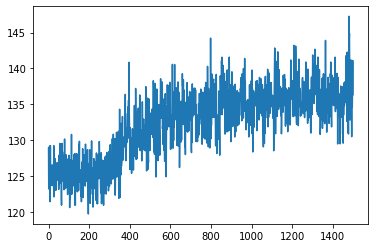

Episode 155, episode return -46.4, last 20 avg -47.1


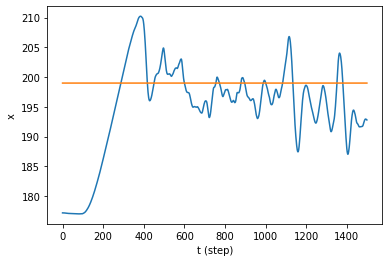

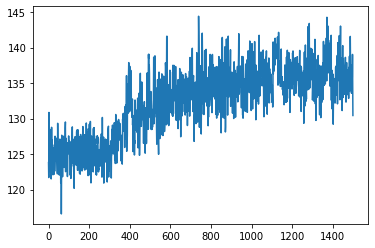

Episode 156, episode return -40.3, last 20 avg -46.8


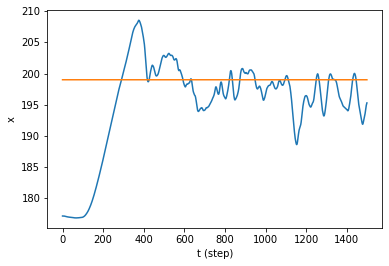

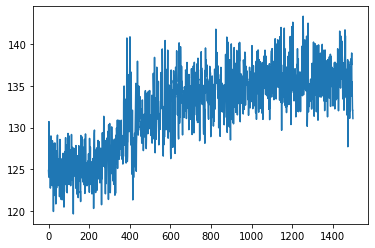

Episode 157, episode return -43.3, last 20 avg -46.6


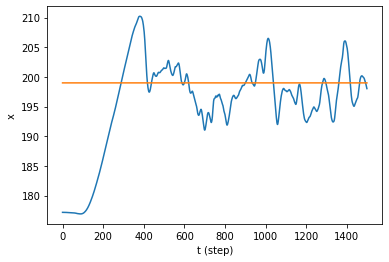

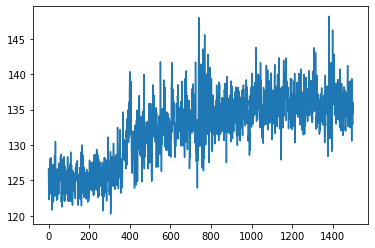

Episode 158, episode return -42.3, last 20 avg -46.3


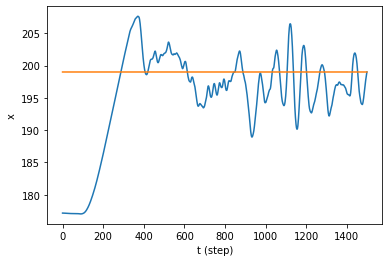

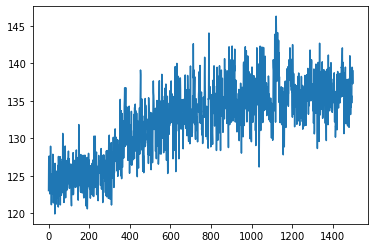

Episode 159, episode return -47.9, last 20 avg -46.1


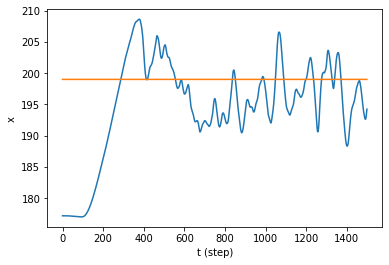

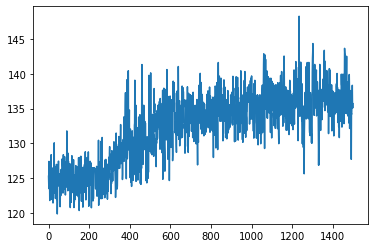

Episode 160, episode return -49.2, last 20 avg -46.2


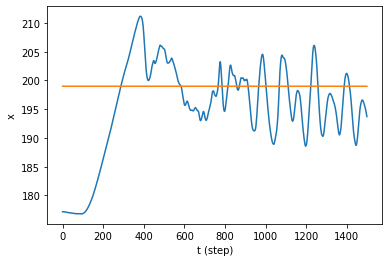

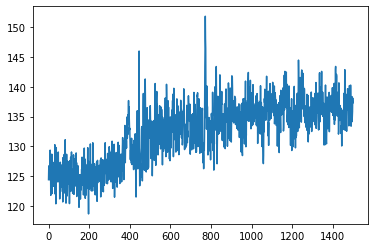

Episode 161, episode return -47.3, last 20 avg -45.9


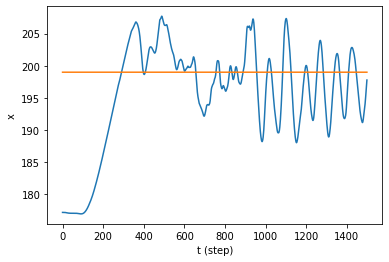

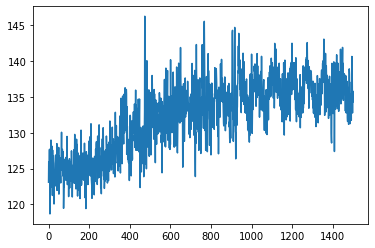

Episode 162, episode return -45.8, last 20 avg -45.5


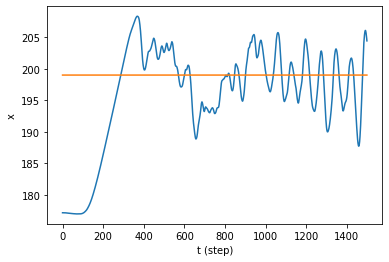

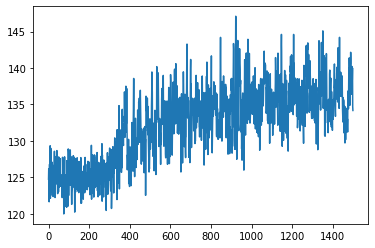

Episode 163, episode return -48.8, last 20 avg -45.4


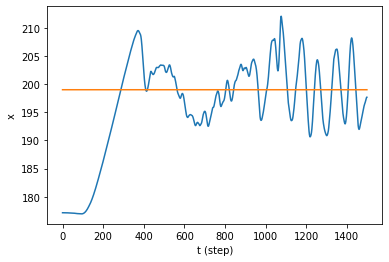

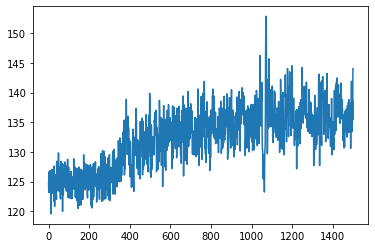

Episode 164, episode return -45.4, last 20 avg -45.5


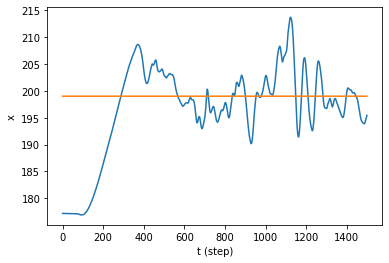

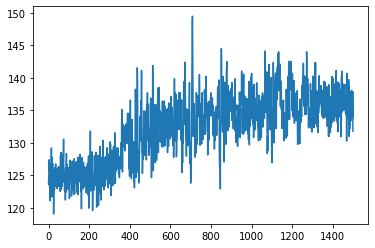

Episode 165, episode return -43.2, last 20 avg -45.0


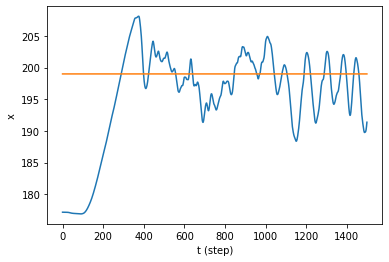

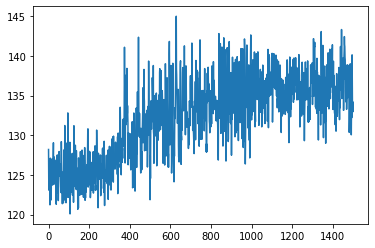

Episode 166, episode return -47.0, last 20 avg -44.9


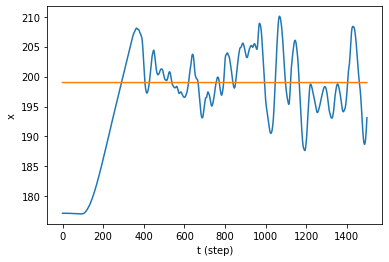

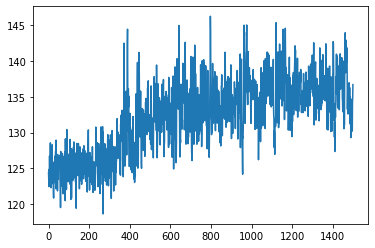

Episode 167, episode return -41.3, last 20 avg -45.0


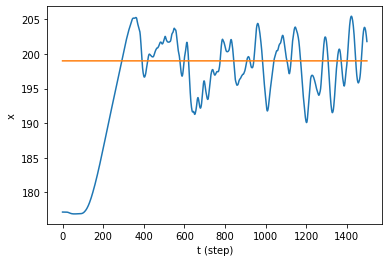

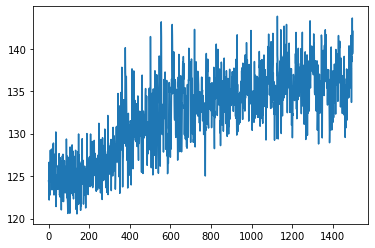

Episode 168, episode return -49.3, last 20 avg -45.3


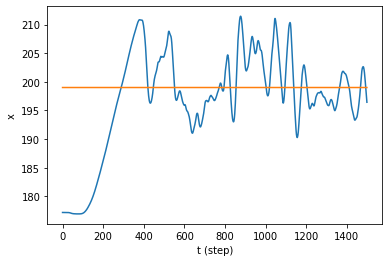

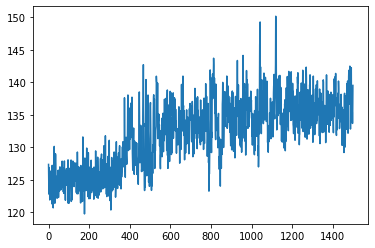

Episode 169, episode return -44.6, last 20 avg -45.2


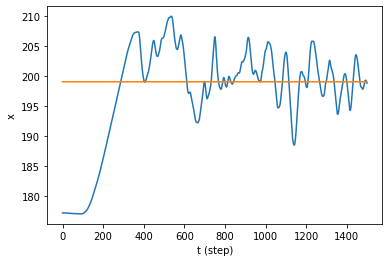

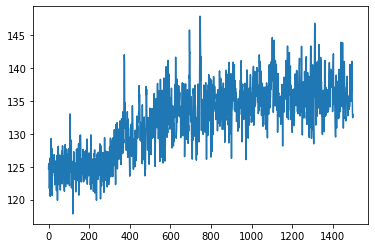

Episode 170, episode return -49.4, last 20 avg -45.5


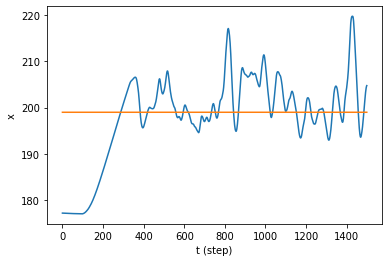

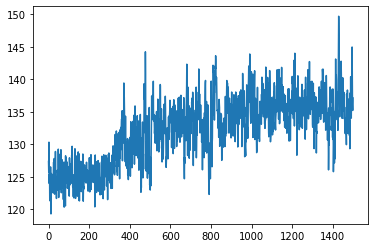

Episode 171, episode return -45.5, last 20 avg -45.8


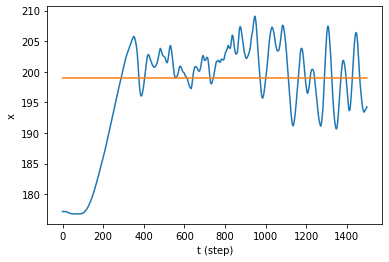

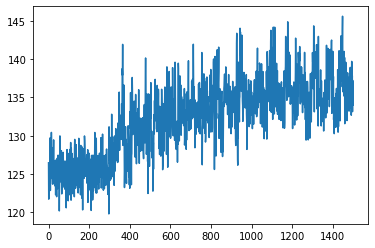

Episode 172, episode return -43.1, last 20 avg -45.9


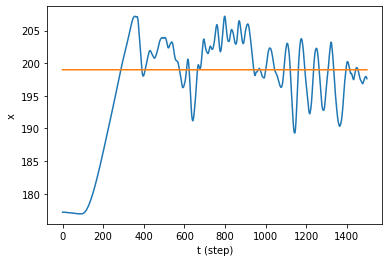

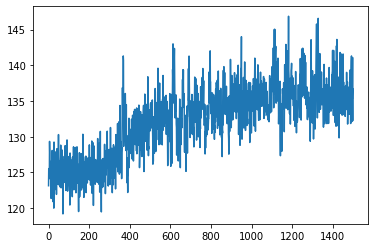

Episode 173, episode return -53.8, last 20 avg -46.0


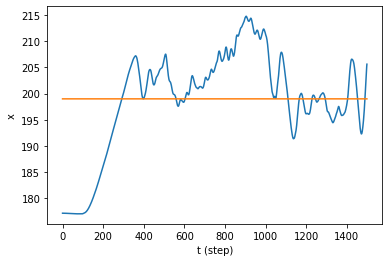

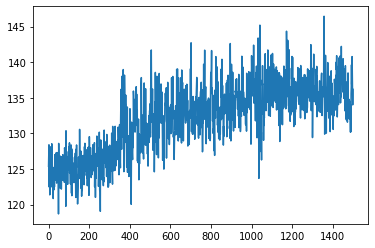

Episode 174, episode return -51.0, last 20 avg -46.2


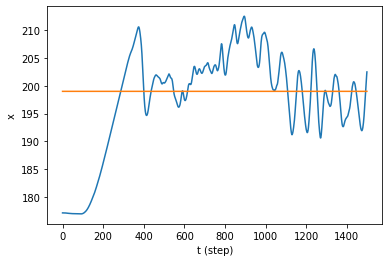

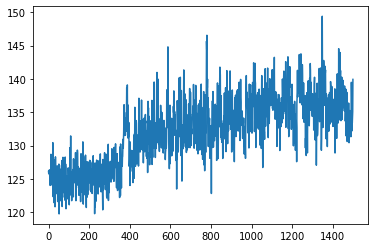

Episode 175, episode return -44.8, last 20 avg -46.2


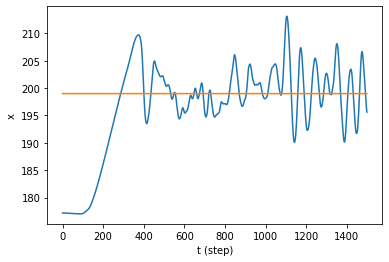

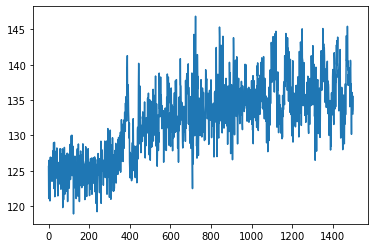

Episode 176, episode return -47.7, last 20 avg -46.5


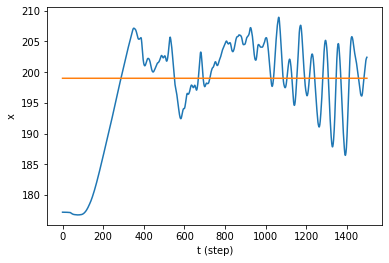

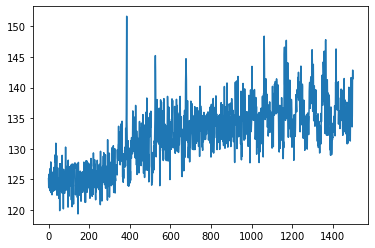

Episode 177, episode return -46.0, last 20 avg -46.7


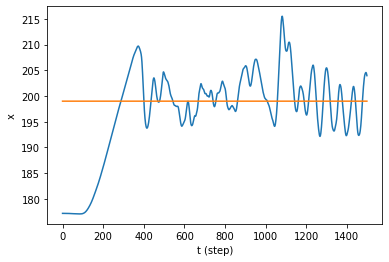

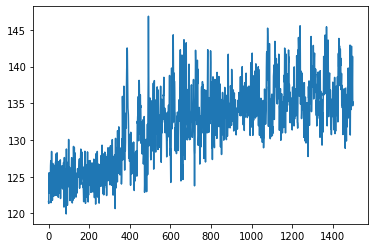

Episode 178, episode return -50.0, last 20 avg -47.1


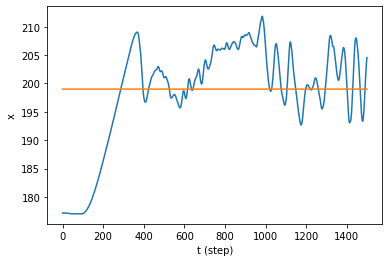

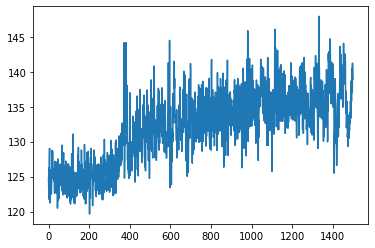

Episode 179, episode return -55.9, last 20 avg -47.5


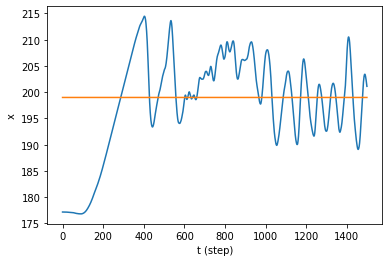

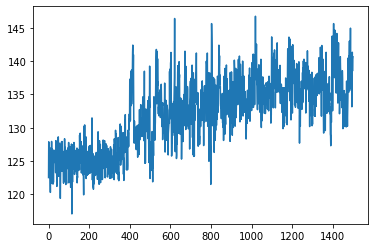

Episode 180, episode return -169.0, last 20 avg -53.4


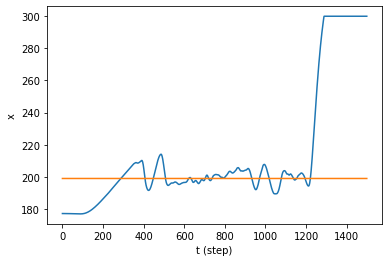

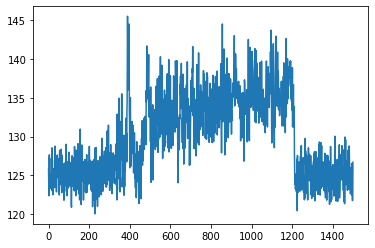

Episode 181, episode return -200.6, last 20 avg -61.1


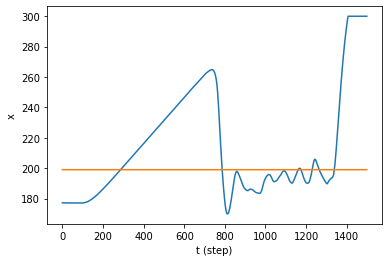

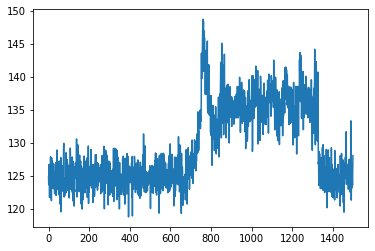

Episode 182, episode return -153.6, last 20 avg -66.5


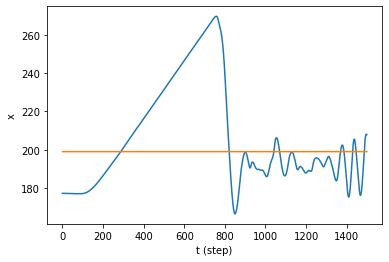

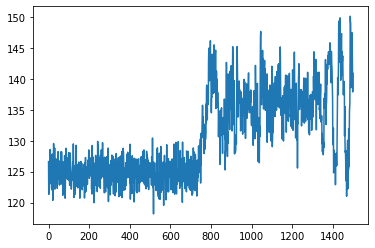

Episode 183, episode return -54.1, last 20 avg -66.8


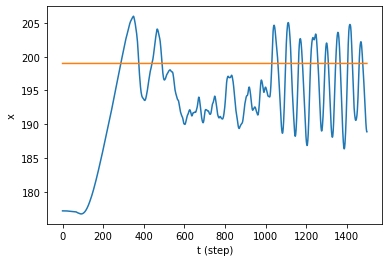

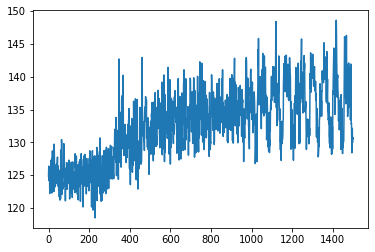

Episode 184, episode return -48.4, last 20 avg -66.9


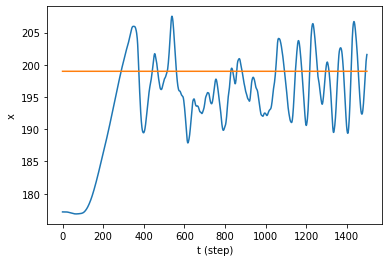

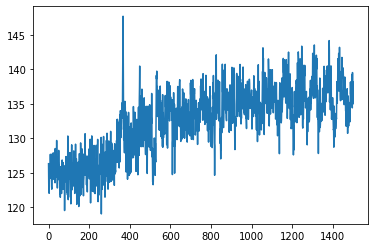

Episode 185, episode return -52.6, last 20 avg -67.4


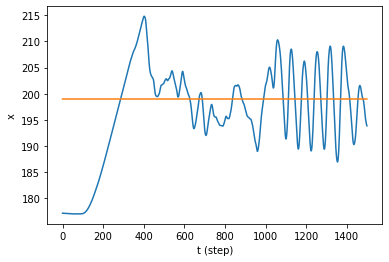

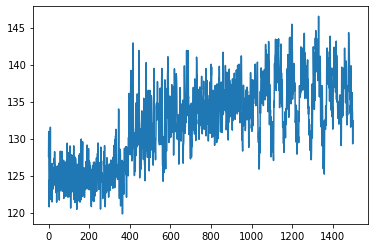

Episode 186, episode return -48.8, last 20 avg -67.5


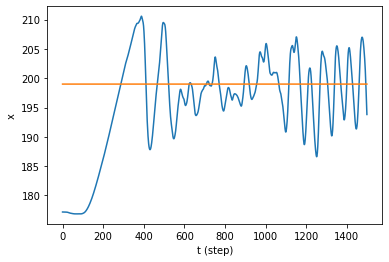

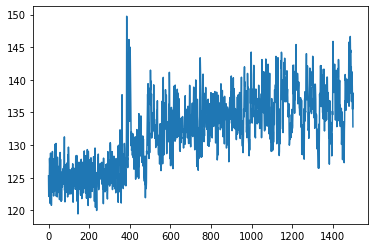

Episode 187, episode return -50.9, last 20 avg -68.0


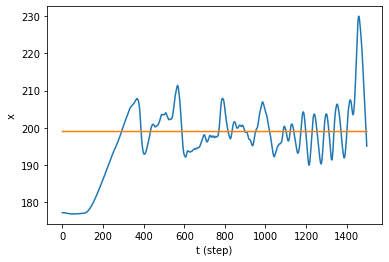

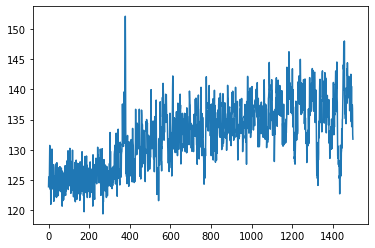

Episode 188, episode return -52.7, last 20 avg -68.1


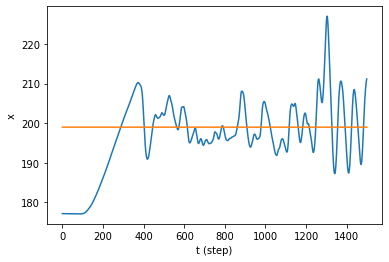

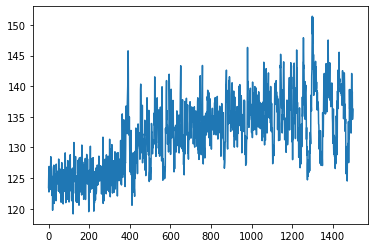

Episode 189, episode return -48.5, last 20 avg -68.3


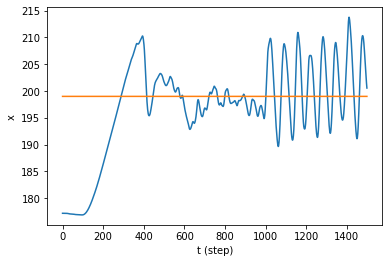

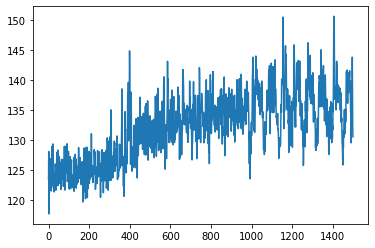

Episode 190, episode return -103.4, last 20 avg -71.0


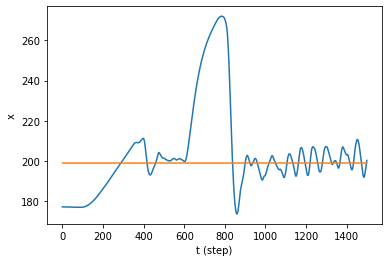

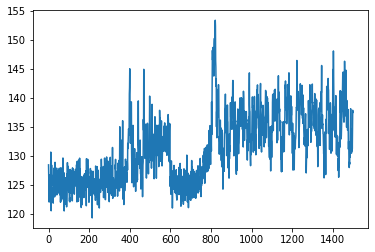

Episode 191, episode return -50.7, last 20 avg -71.3


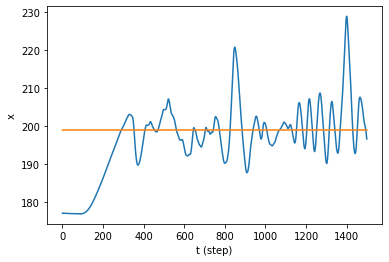

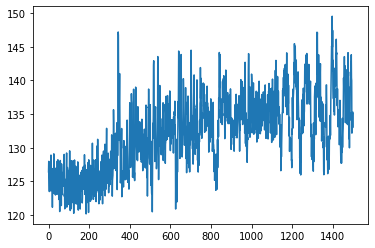

Episode 192, episode return -49.3, last 20 avg -71.6


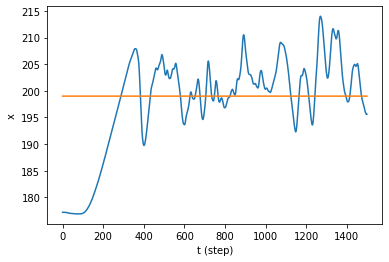

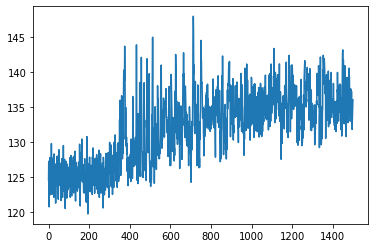

Episode 193, episode return -48.3, last 20 avg -71.3


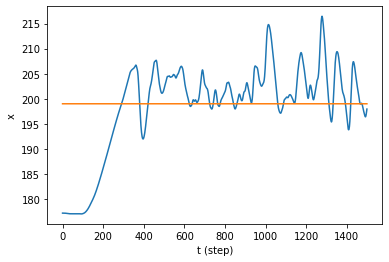

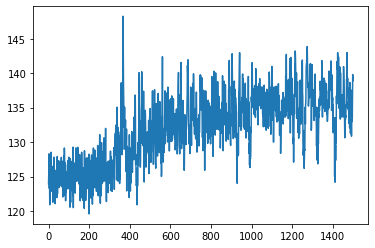

Episode 194, episode return -48.1, last 20 avg -71.2


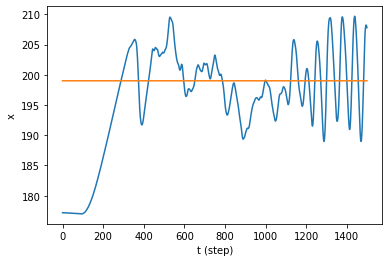

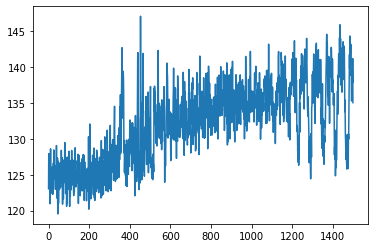

Episode 195, episode return -48.2, last 20 avg -71.3


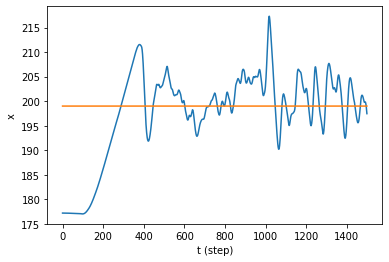

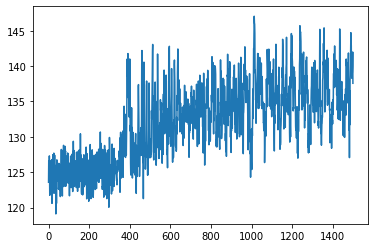

Episode 196, episode return -43.0, last 20 avg -71.1


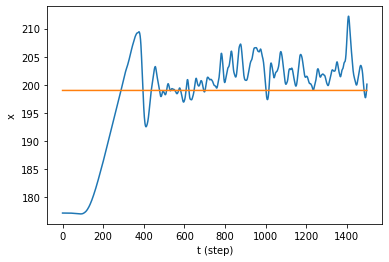

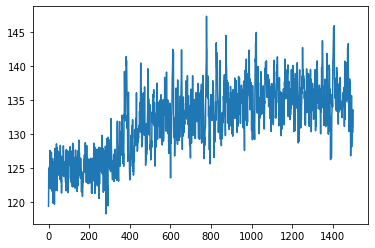

Episode 197, episode return -52.7, last 20 avg -71.4


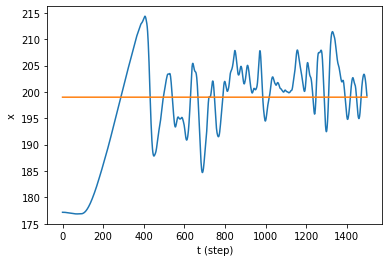

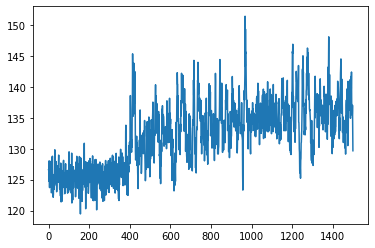

Episode 198, episode return -52.4, last 20 avg -71.6


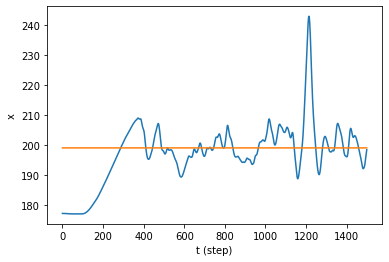

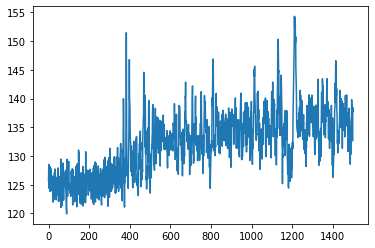

Episode 199, episode return -54.1, last 20 avg -71.5


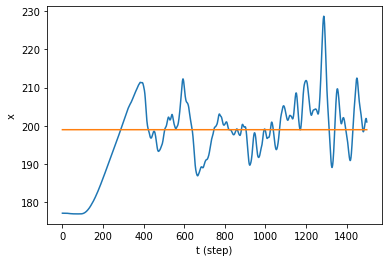

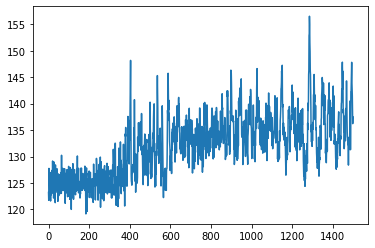

Episode 200, episode return -54.1, last 20 avg -65.7


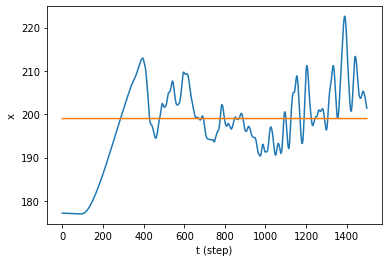

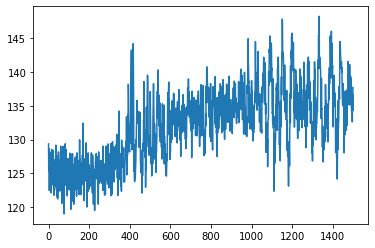

Episode 201, episode return -123.8, last 20 avg -61.9


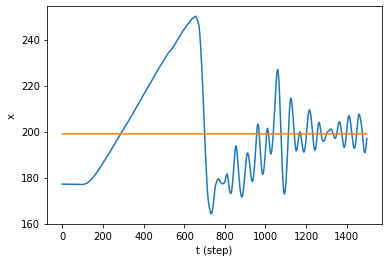

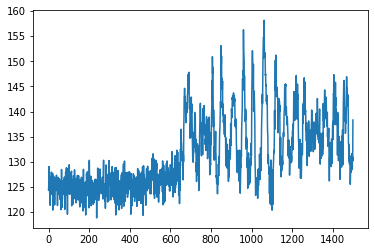

Episode 202, episode return -77.9, last 20 avg -58.1


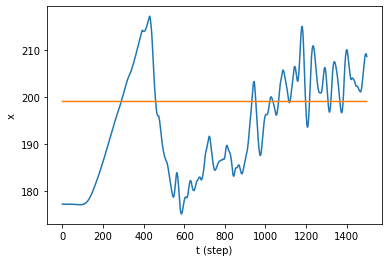

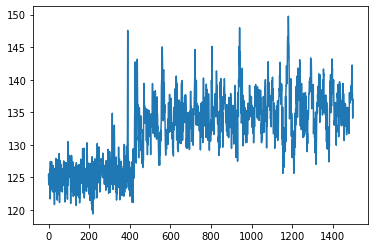

Episode 203, episode return -49.9, last 20 avg -57.9


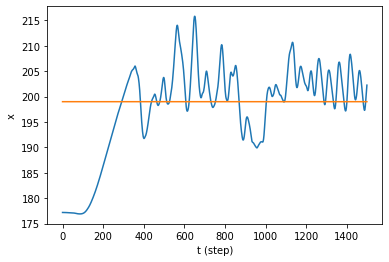

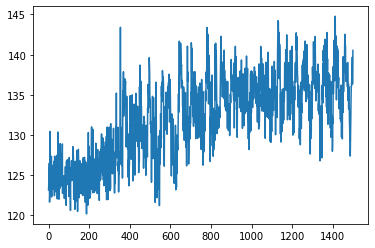

Episode 204, episode return -47.7, last 20 avg -57.9


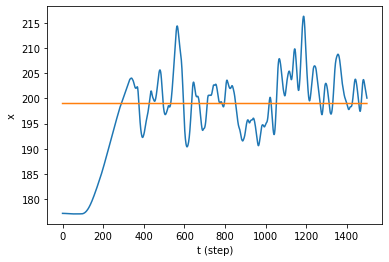

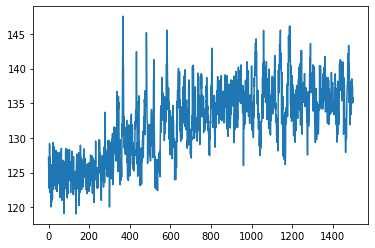

Episode 205, episode return -61.5, last 20 avg -58.3


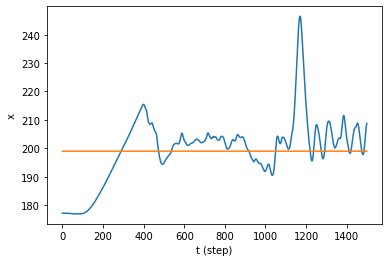

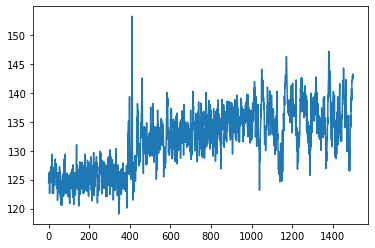

Episode 206, episode return -43.4, last 20 avg -58.0


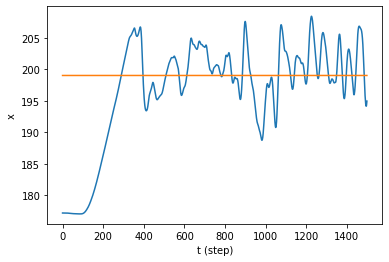

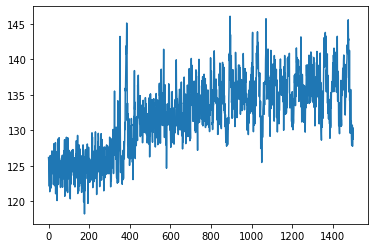

Episode 207, episode return -46.0, last 20 avg -57.8


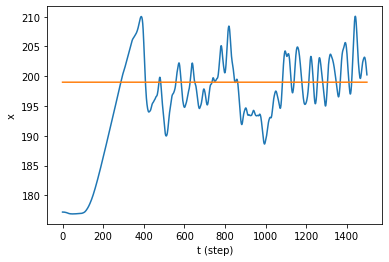

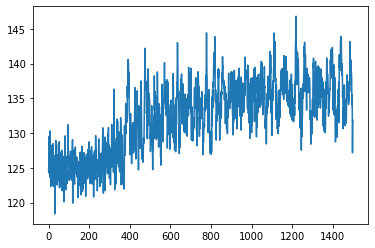

Episode 208, episode return -50.8, last 20 avg -57.7


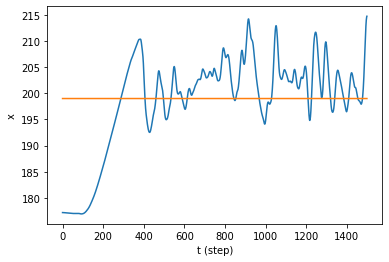

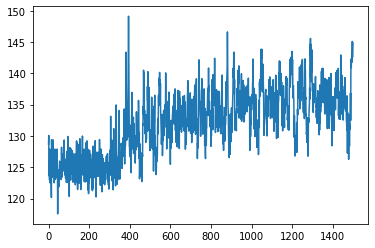

Episode 209, episode return -49.7, last 20 avg -57.8


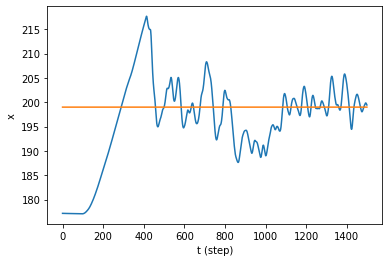

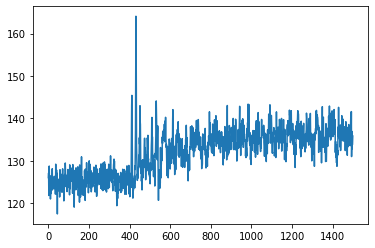

Episode 210, episode return -45.1, last 20 avg -54.8


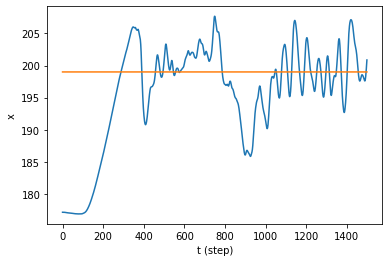

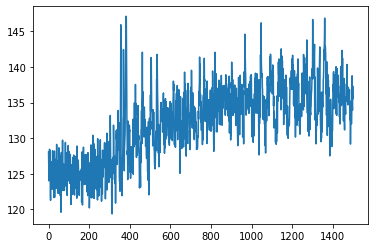

Episode 211, episode return -46.0, last 20 avg -54.6


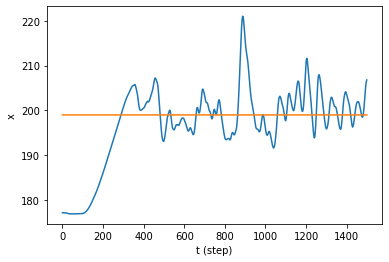

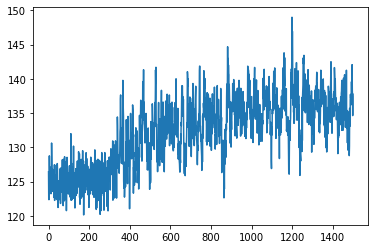

Episode 212, episode return -44.6, last 20 avg -54.4


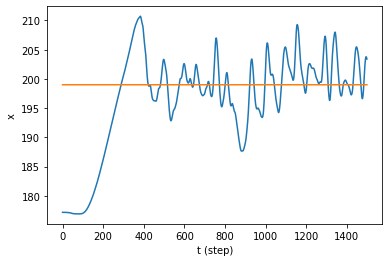

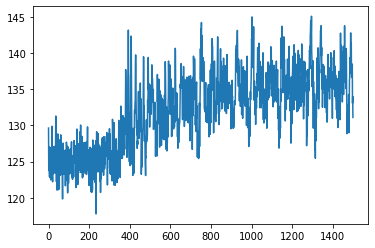

Episode 213, episode return -44.7, last 20 avg -54.2


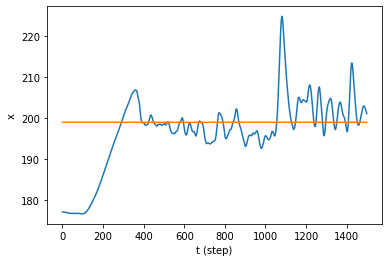

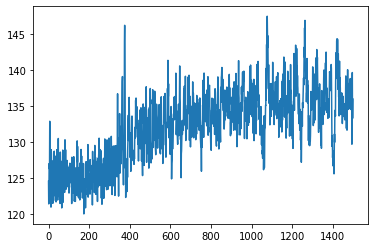

Episode 214, episode return -43.4, last 20 avg -53.9


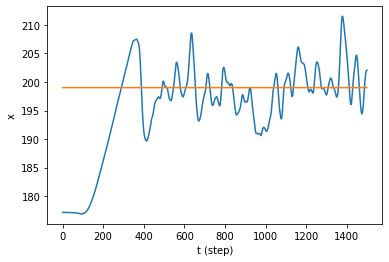

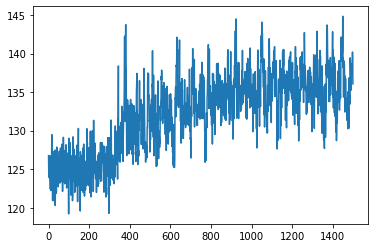

Episode 215, episode return -44.5, last 20 avg -53.8


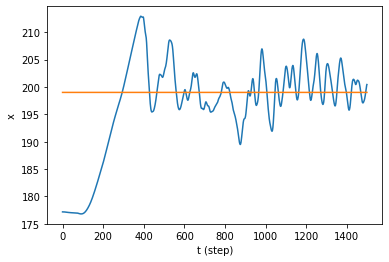

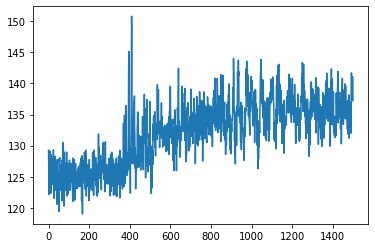

Episode 216, episode return -43.6, last 20 avg -53.8


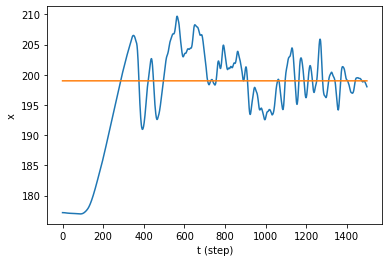

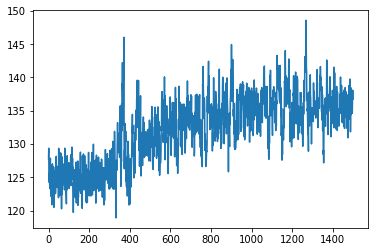

Episode 217, episode return -47.8, last 20 avg -53.6


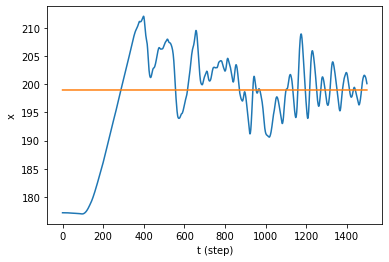

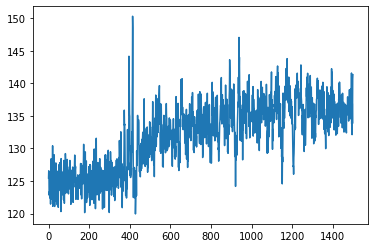

Episode 218, episode return -48.1, last 20 avg -53.3


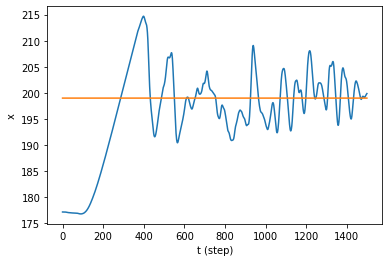

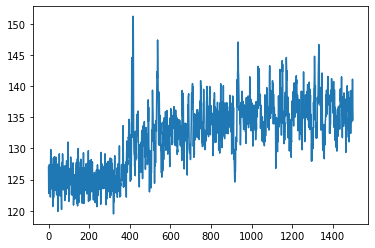

Episode 219, episode return -48.1, last 20 avg -53.0


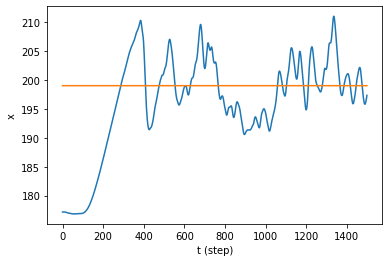

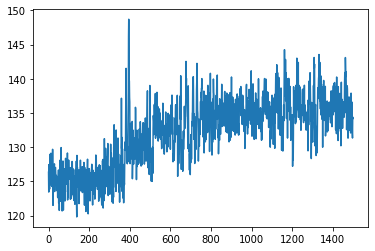

Episode 220, episode return -43.6, last 20 avg -52.5


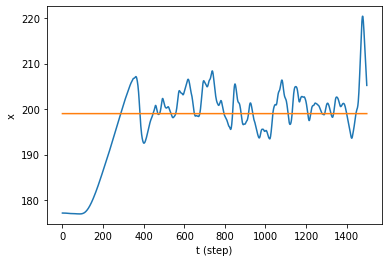

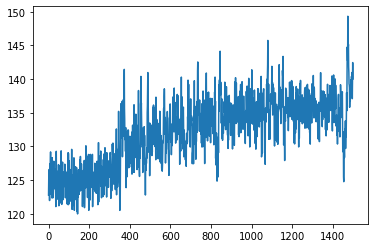

Episode 221, episode return -51.8, last 20 avg -48.9


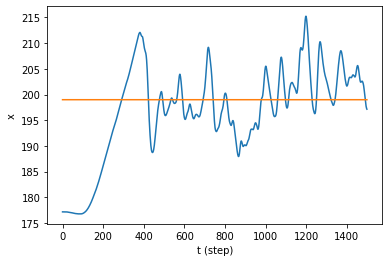

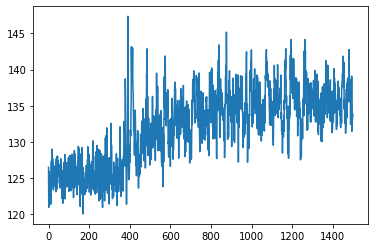

Episode 222, episode return -43.2, last 20 avg -47.2


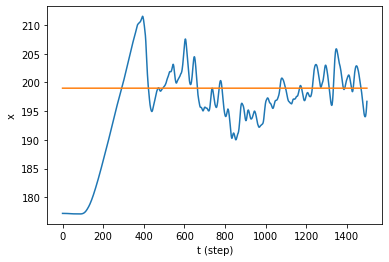

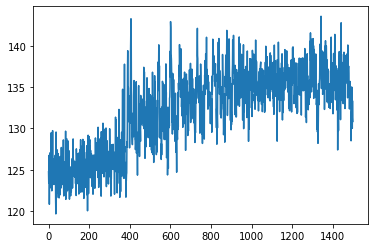

Episode 223, episode return -48.6, last 20 avg -47.1


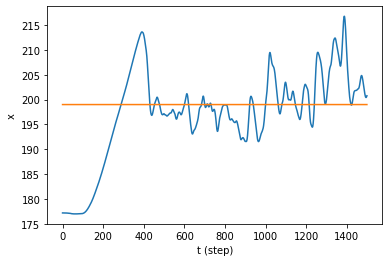

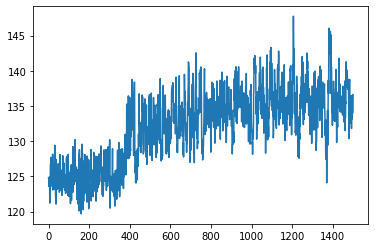

Episode 224, episode return -53.5, last 20 avg -47.4


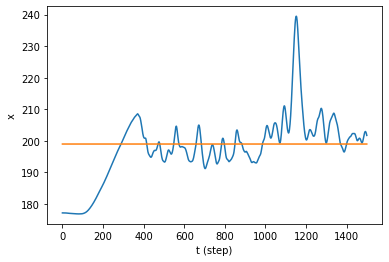

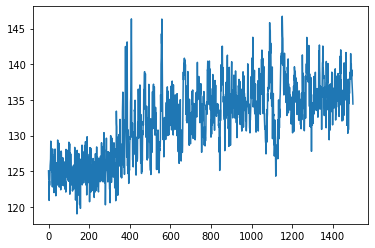

Episode 225, episode return -50.4, last 20 avg -46.8


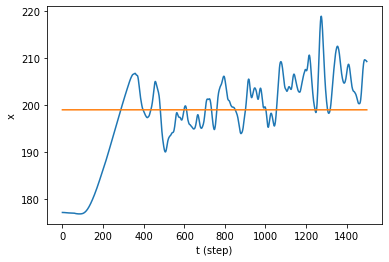

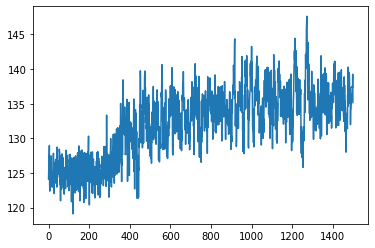

Episode 226, episode return -50.9, last 20 avg -47.2


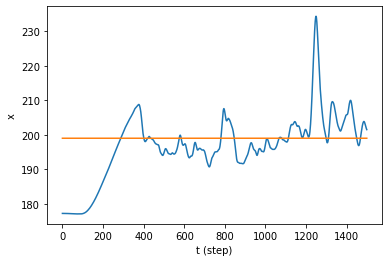

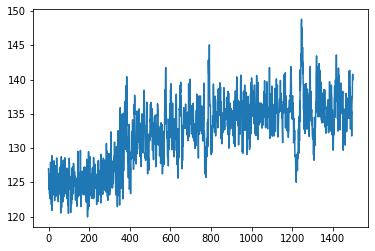

Episode 227, episode return -44.7, last 20 avg -47.2


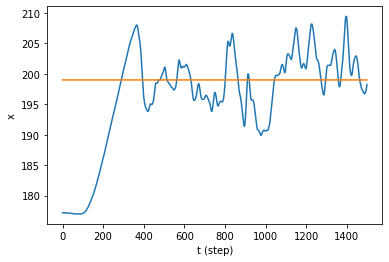

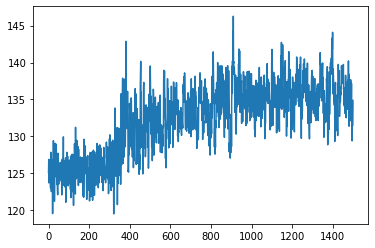

Episode 228, episode return -62.4, last 20 avg -47.7


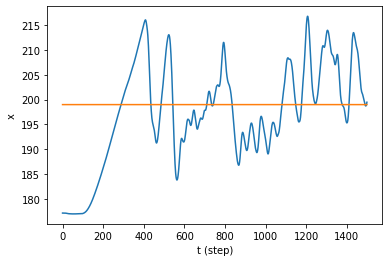

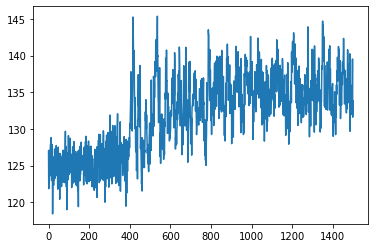

Episode 229, episode return -55.7, last 20 avg -48.0


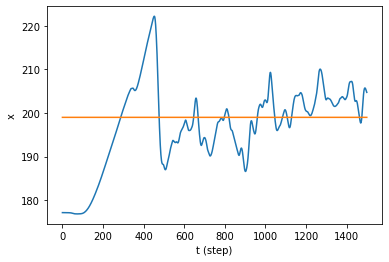

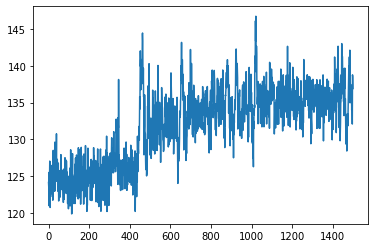

Episode 230, episode return -45.9, last 20 avg -48.1


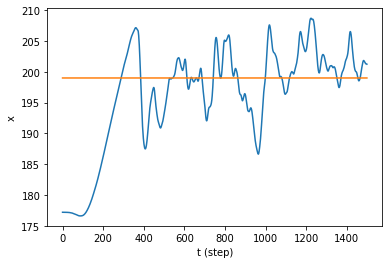

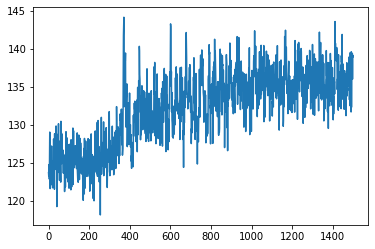

Episode 231, episode return -45.1, last 20 avg -48.0


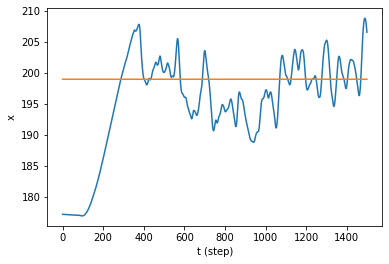

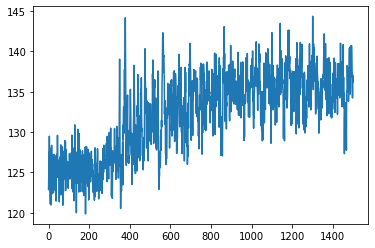

Episode 232, episode return -56.1, last 20 avg -48.6


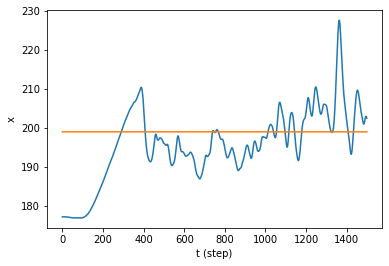

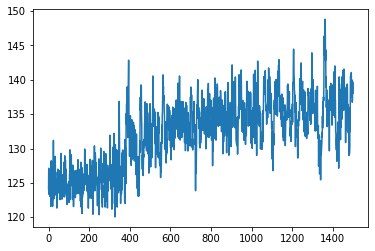

Episode 233, episode return -50.6, last 20 avg -48.9


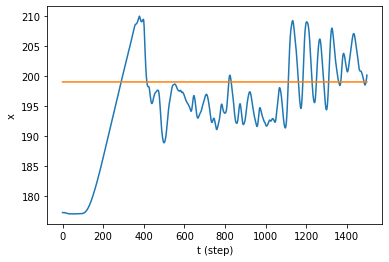

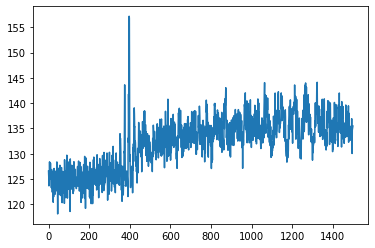

Episode 234, episode return -46.1, last 20 avg -49.0


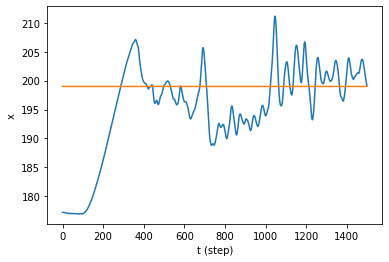

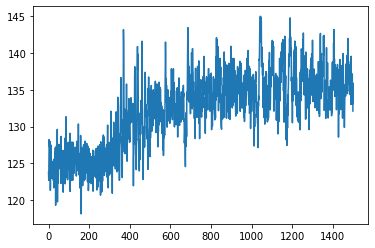

Episode 235, episode return -52.6, last 20 avg -49.4


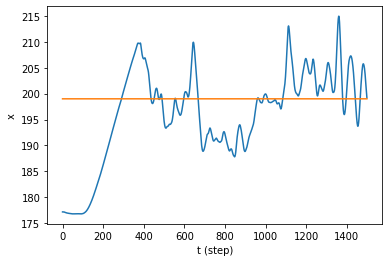

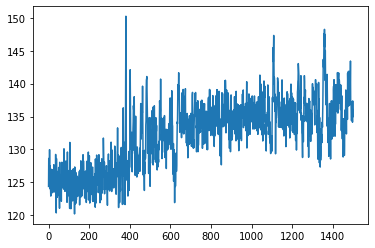

Episode 236, episode return -52.8, last 20 avg -49.9


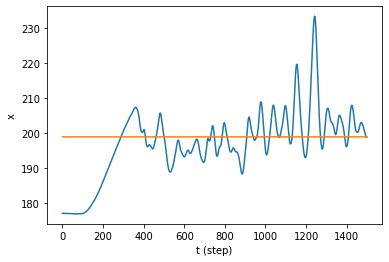

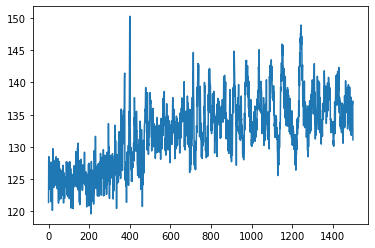

Episode 237, episode return -53.3, last 20 avg -50.2


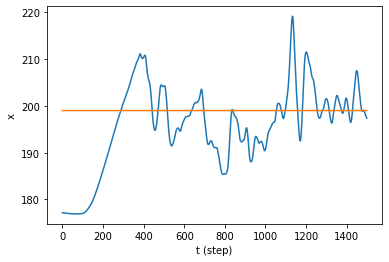

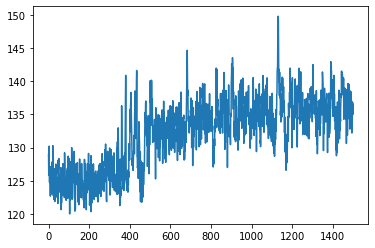

Episode 238, episode return -45.1, last 20 avg -50.0


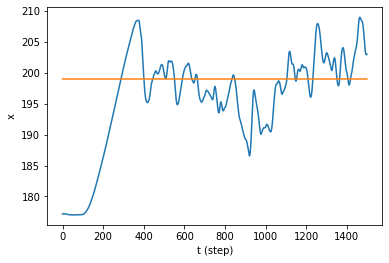

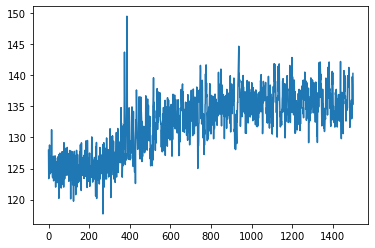

Episode 239, episode return -46.3, last 20 avg -49.9


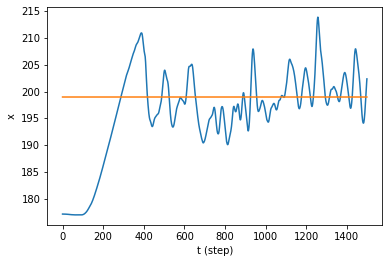

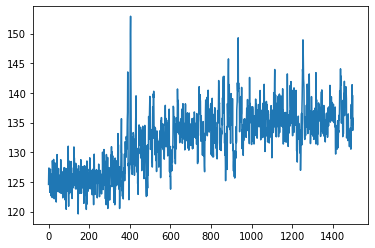

Episode 240, episode return -47.2, last 20 avg -50.1


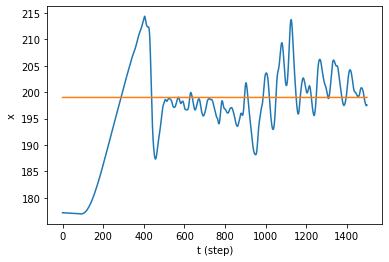

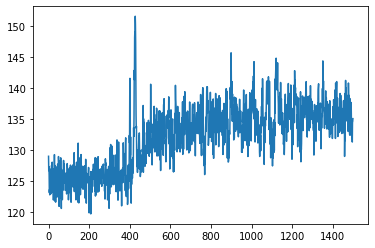

Episode 241, episode return -55.0, last 20 avg -50.3


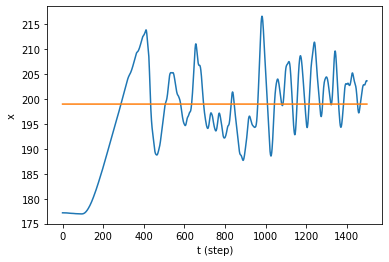

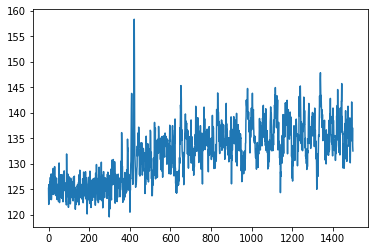

Episode 242, episode return -44.3, last 20 avg -50.3


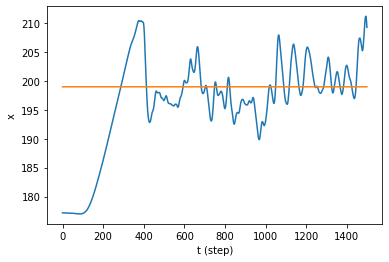

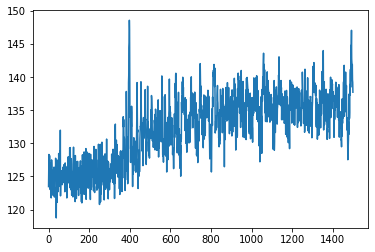

Episode 243, episode return -47.7, last 20 avg -50.3


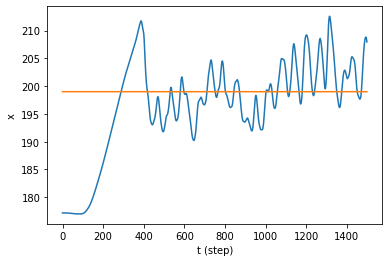

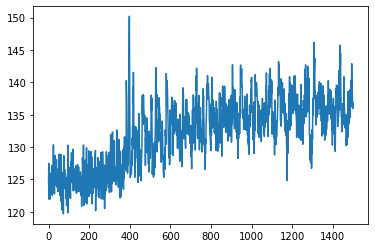

Episode 244, episode return -48.9, last 20 avg -50.0


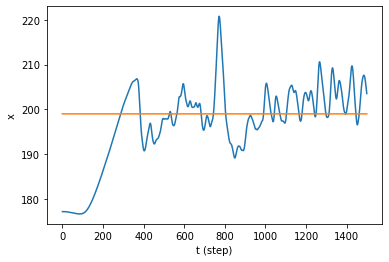

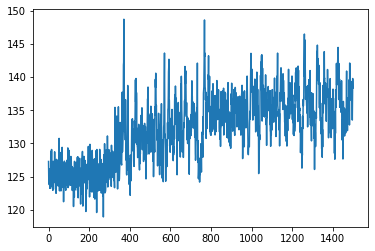

Episode 245, episode return -46.4, last 20 avg -49.9


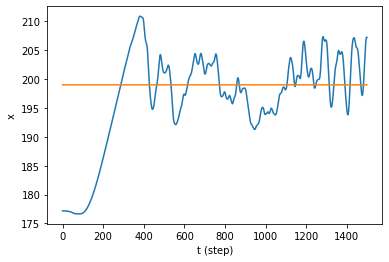

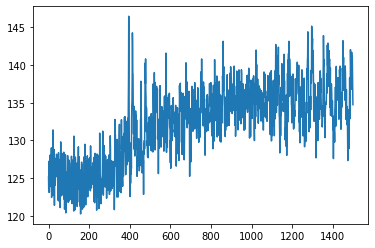

Episode 246, episode return -41.7, last 20 avg -49.4


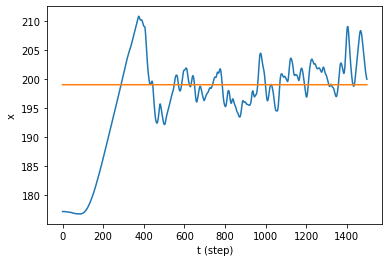

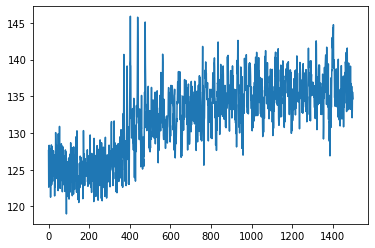

Episode 247, episode return -49.8, last 20 avg -49.7


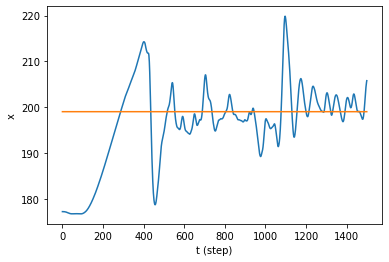

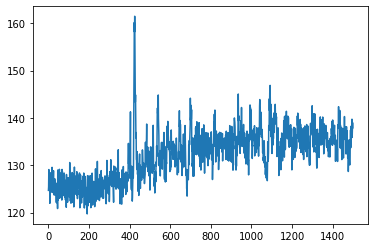

Episode 248, episode return -53.0, last 20 avg -49.2


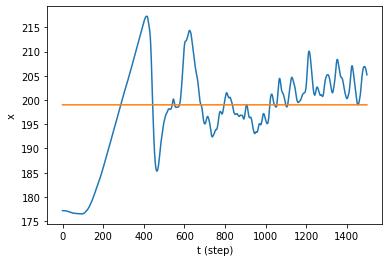

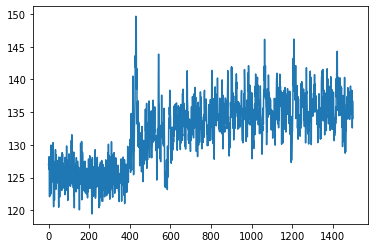

Episode 249, episode return -46.3, last 20 avg -48.7


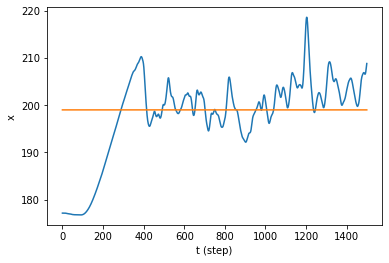

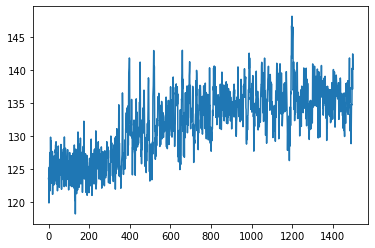

Episode 250, episode return -45.3, last 20 avg -48.7


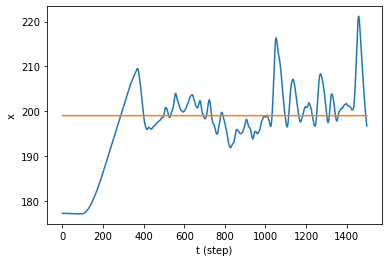

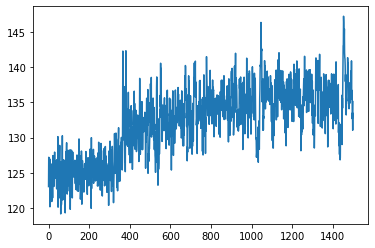

Episode 251, episode return -44.7, last 20 avg -48.7


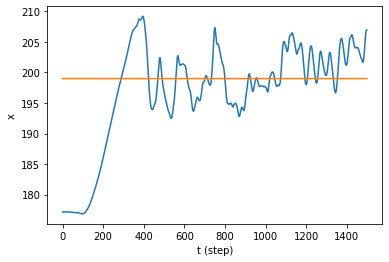

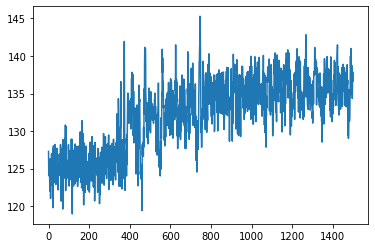

Episode 252, episode return -44.3, last 20 avg -48.1


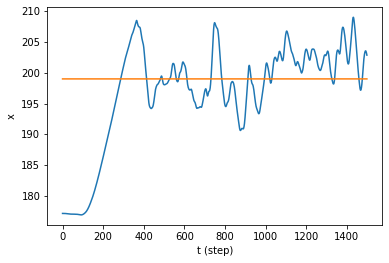

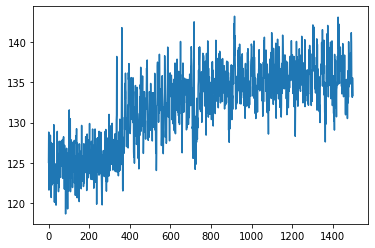

Episode 253, episode return -70.5, last 20 avg -49.1


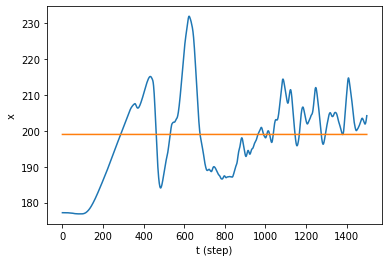

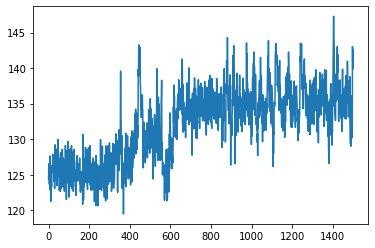

Episode 254, episode return -49.7, last 20 avg -49.2


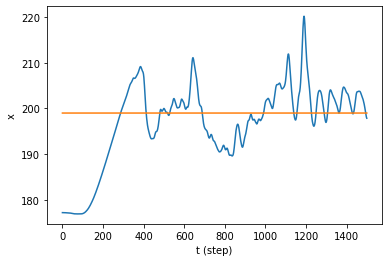

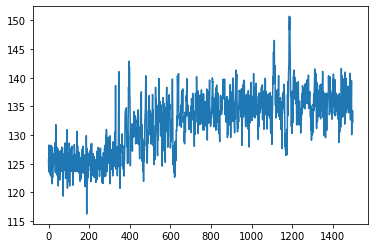

Episode 255, episode return -56.6, last 20 avg -49.4


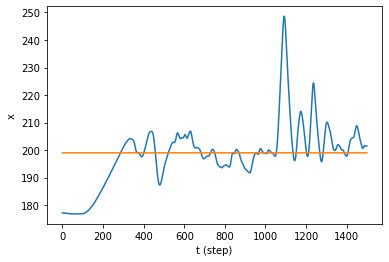

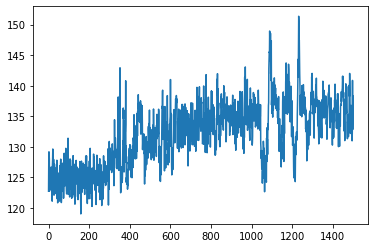

Episode 256, episode return -48.7, last 20 avg -49.2


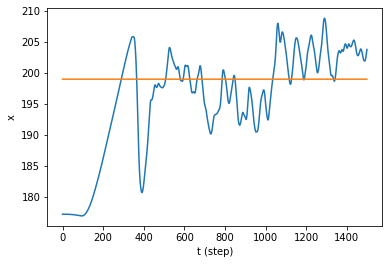

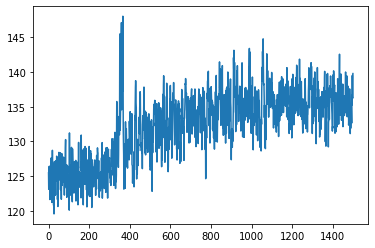

Episode 257, episode return -47.8, last 20 avg -49.0


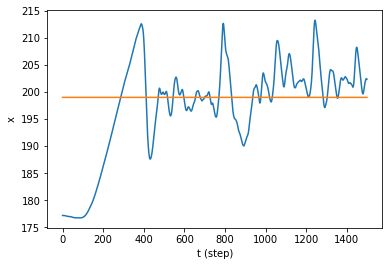

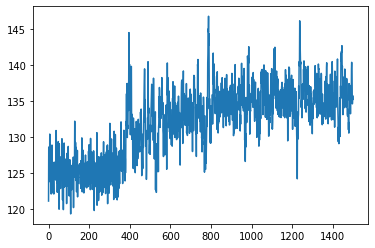

Episode 258, episode return -45.2, last 20 avg -49.0


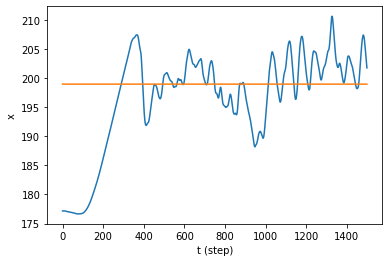

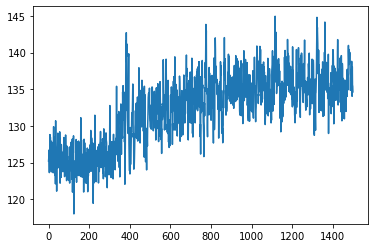

Episode 259, episode return -49.1, last 20 avg -49.1


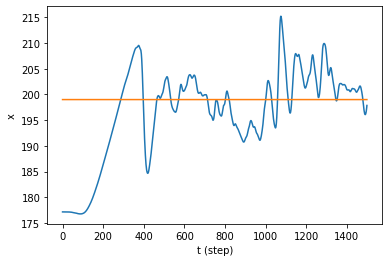

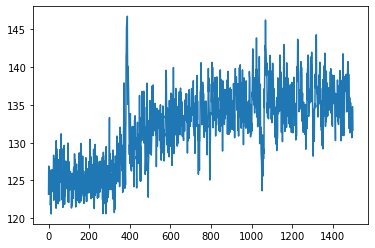

Episode 260, episode return -43.0, last 20 avg -48.9


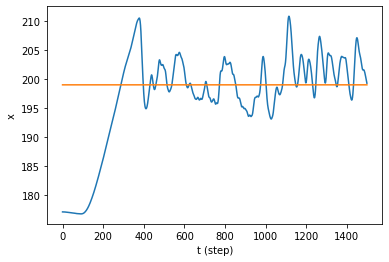

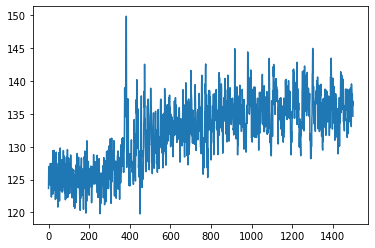

Episode 261, episode return -50.1, last 20 avg -48.7


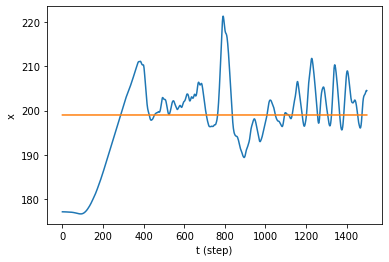

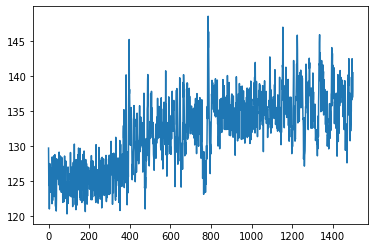

Episode 262, episode return -50.7, last 20 avg -49.0


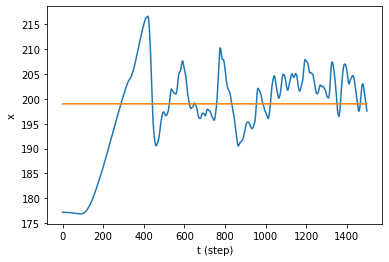

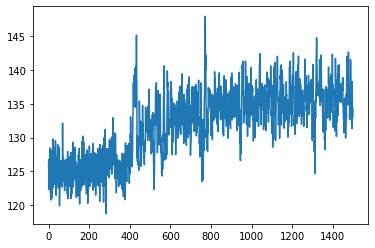

Episode 263, episode return -46.7, last 20 avg -48.9


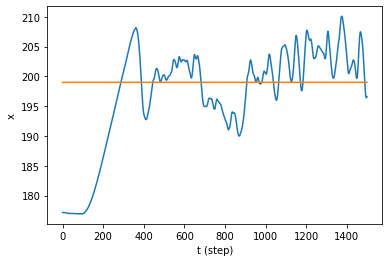

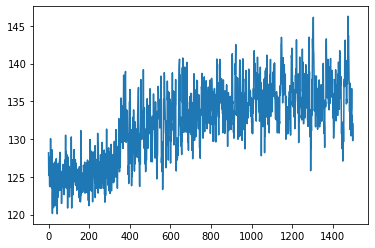

Episode 264, episode return -46.0, last 20 avg -48.8


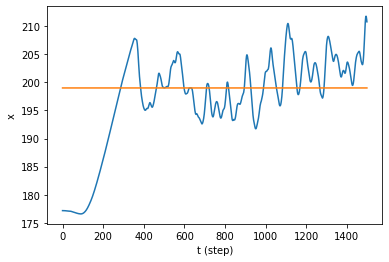

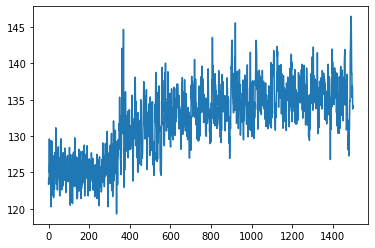

Episode 265, episode return -51.7, last 20 avg -49.1


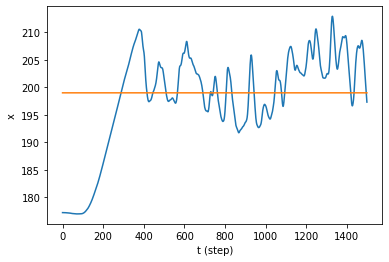

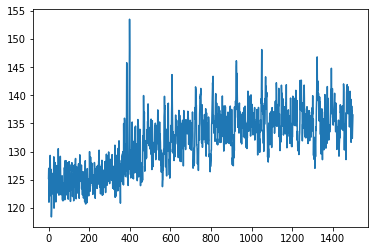

Episode 266, episode return -51.4, last 20 avg -49.5


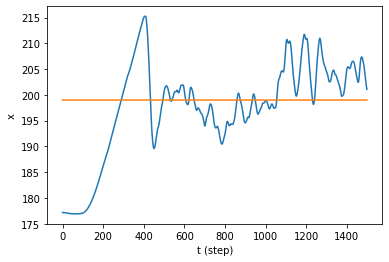

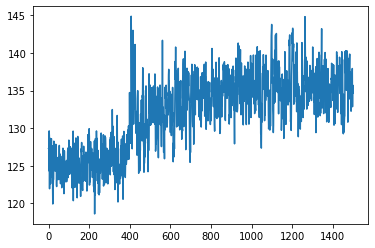

Episode 267, episode return -53.1, last 20 avg -49.7


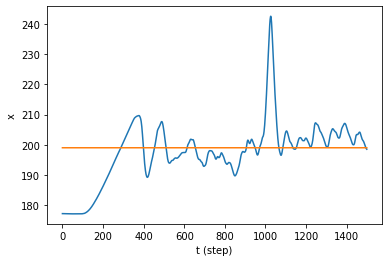

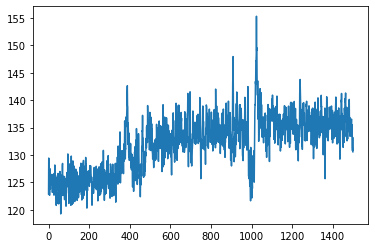

Episode 268, episode return -47.0, last 20 avg -49.4


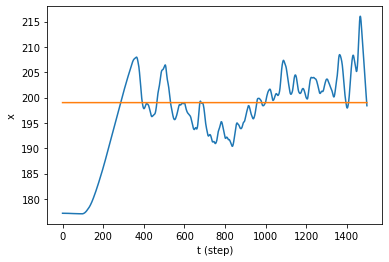

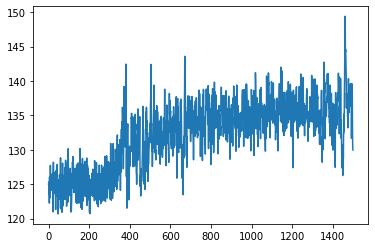

Episode 269, episode return -52.8, last 20 avg -49.7


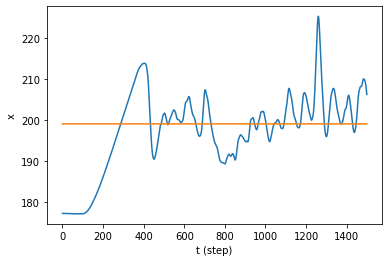

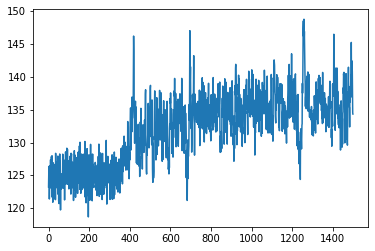

Episode 270, episode return -51.2, last 20 avg -50.0


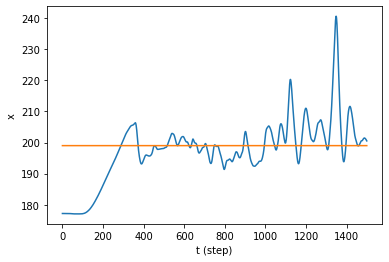

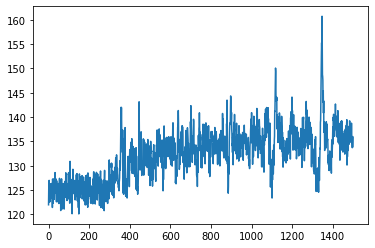

Episode 271, episode return -58.8, last 20 avg -50.7


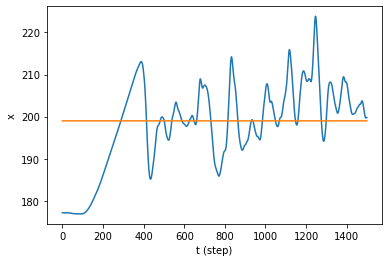

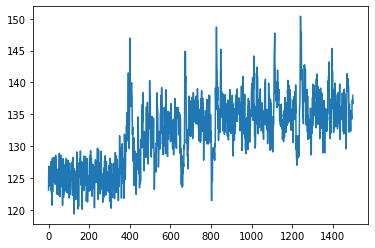

Episode 272, episode return -55.5, last 20 avg -51.3


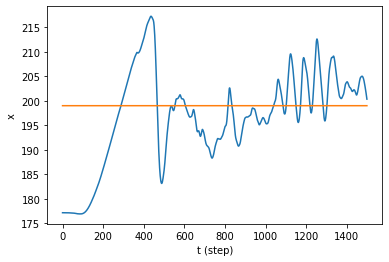

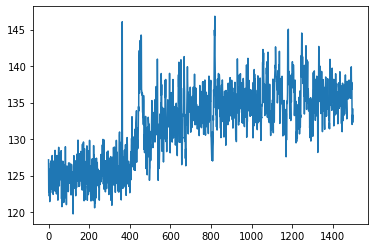

Episode 273, episode return -61.8, last 20 avg -50.8


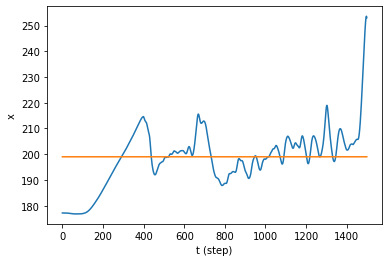

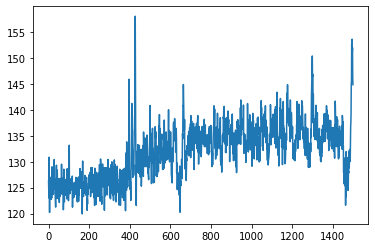

Episode 274, episode return -54.4, last 20 avg -51.1


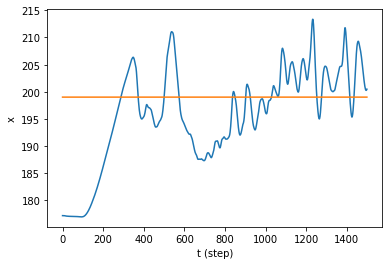

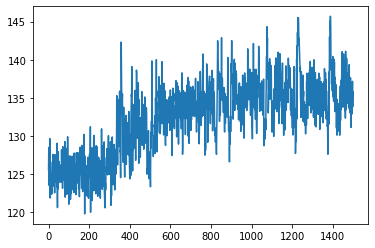

Episode 275, episode return -50.7, last 20 avg -50.8


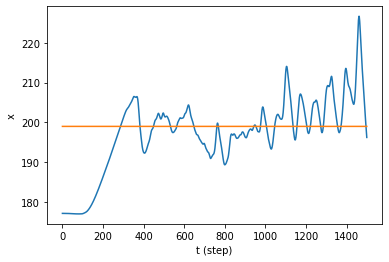

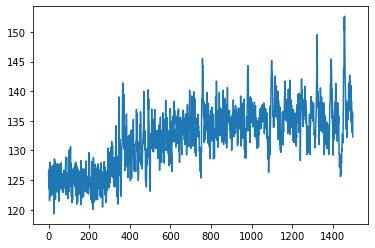

Episode 276, episode return -48.4, last 20 avg -50.8


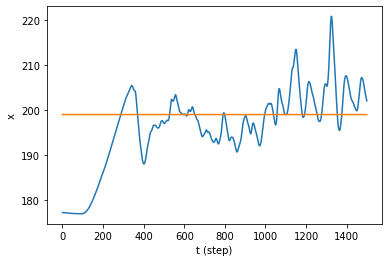

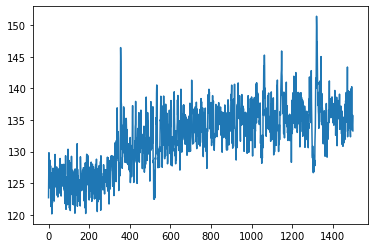

Episode 277, episode return -48.3, last 20 avg -50.8


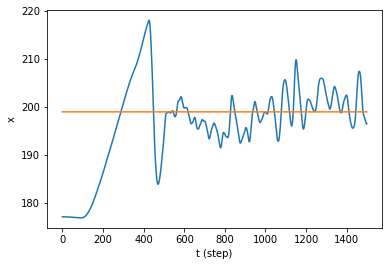

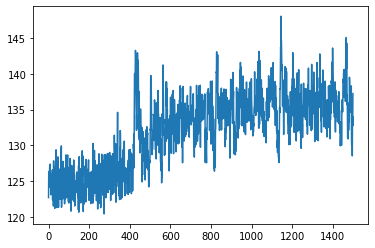

Episode 278, episode return -60.4, last 20 avg -51.6


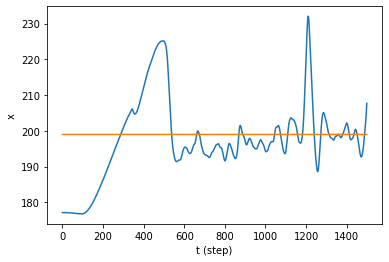

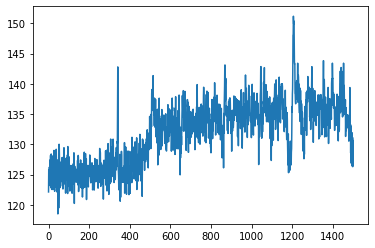

Episode 279, episode return -42.6, last 20 avg -51.2


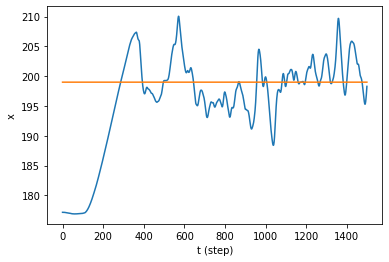

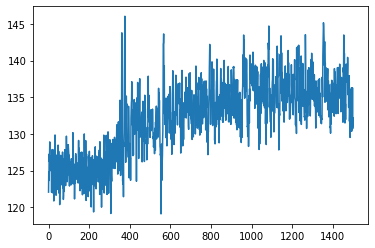

Episode 280, episode return -46.4, last 20 avg -51.4


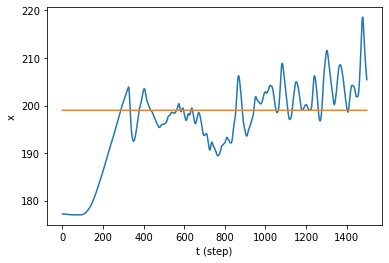

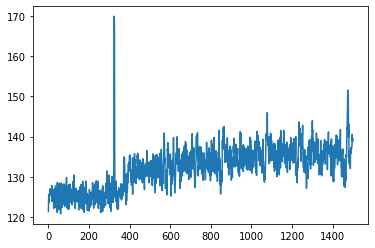

Episode 281, episode return -52.5, last 20 avg -51.5


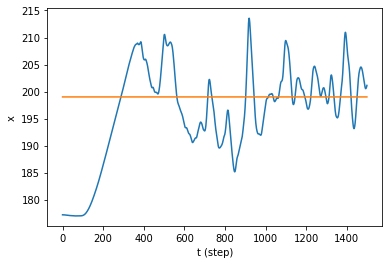

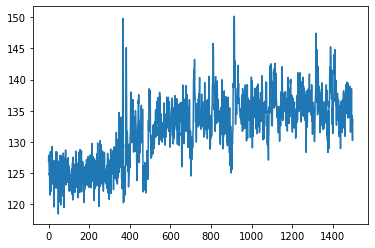

Episode 282, episode return -48.8, last 20 avg -51.4


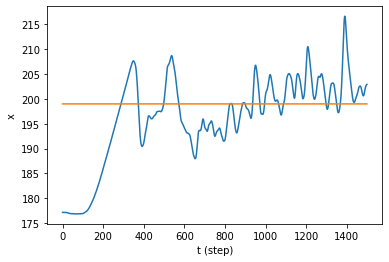

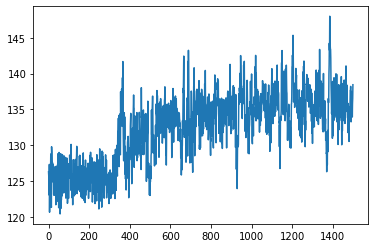

Episode 283, episode return -45.6, last 20 avg -51.4


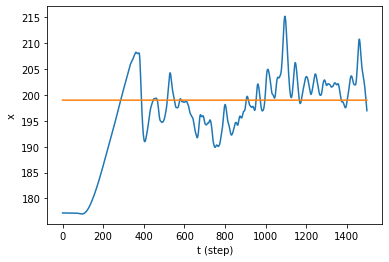

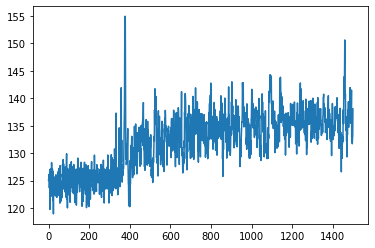

Episode 284, episode return -44.4, last 20 avg -51.3


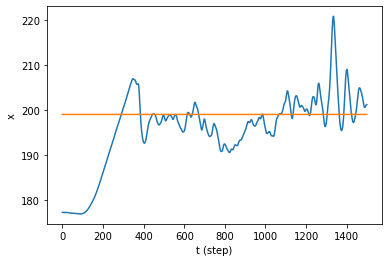

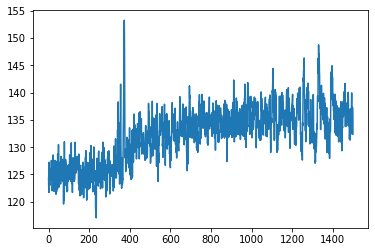

Episode 285, episode return -44.8, last 20 avg -50.9


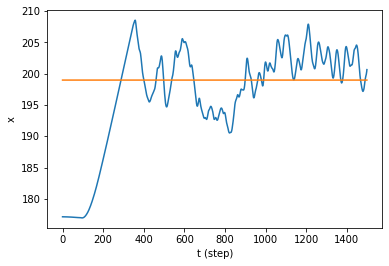

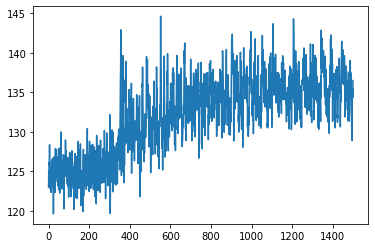

Episode 286, episode return -44.4, last 20 avg -50.6


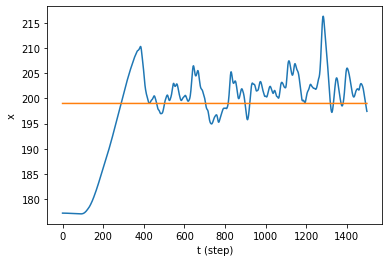

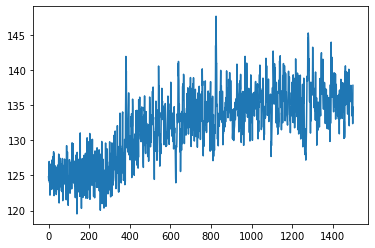

Episode 287, episode return -47.2, last 20 avg -50.3


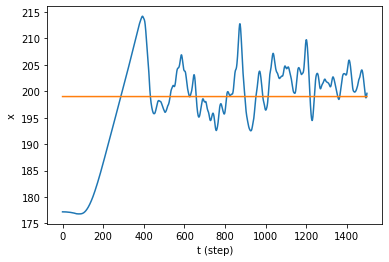

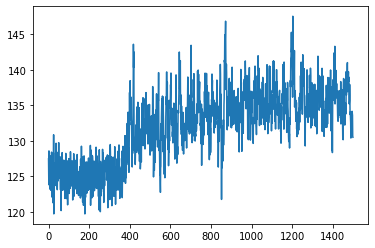

Episode 288, episode return -42.5, last 20 avg -50.1


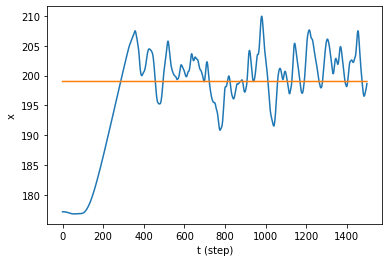

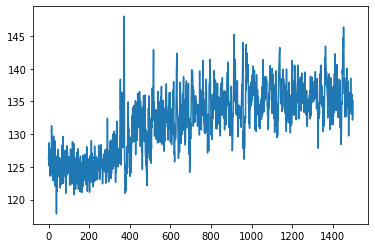

Episode 289, episode return -47.8, last 20 avg -49.8


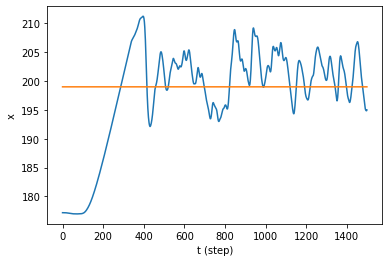

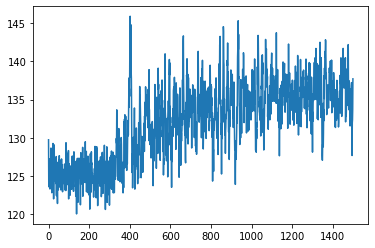

Episode 290, episode return -45.0, last 20 avg -49.5


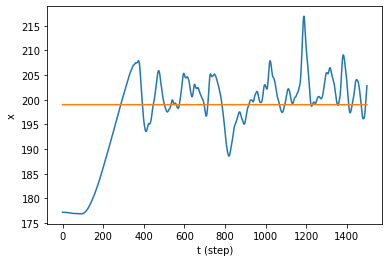

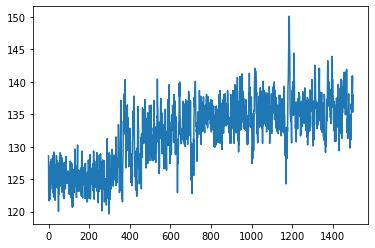

Episode 291, episode return -70.6, last 20 avg -50.1


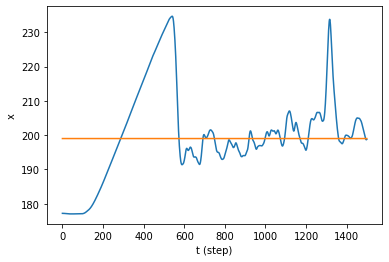

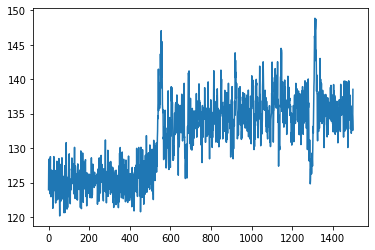

Episode 292, episode return -43.6, last 20 avg -49.5


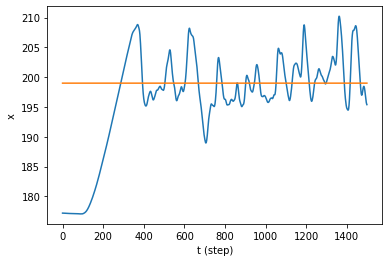

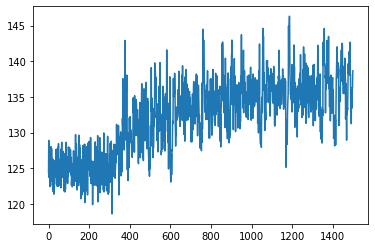

Episode 293, episode return -41.8, last 20 avg -48.5


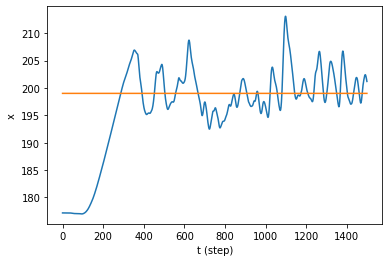

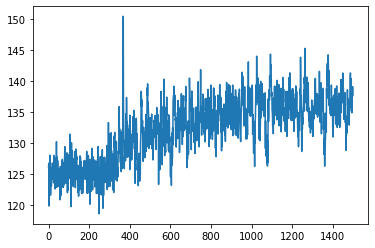

Episode 294, episode return -58.7, last 20 avg -48.7


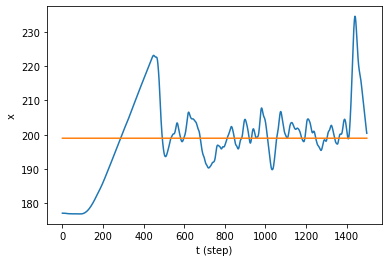

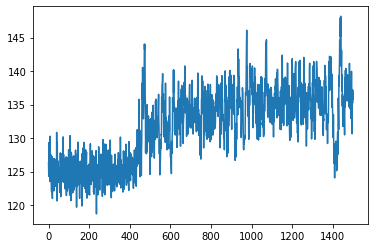

Episode 295, episode return -40.1, last 20 avg -48.2


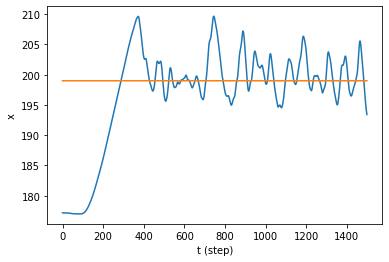

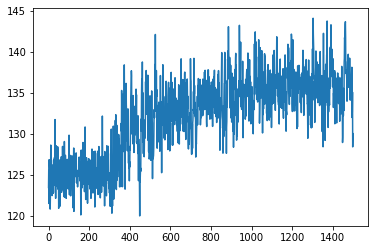

Episode 296, episode return -49.0, last 20 avg -48.2


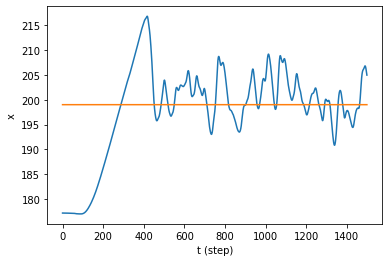

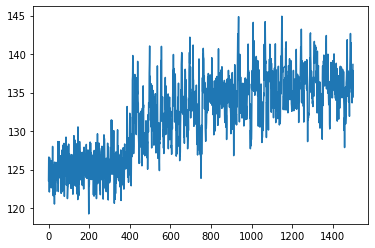

Episode 297, episode return -45.7, last 20 avg -48.1


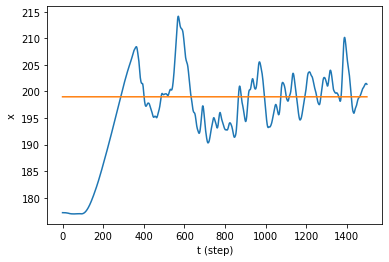

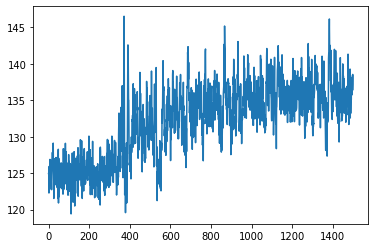

Episode 298, episode return -49.0, last 20 avg -47.5


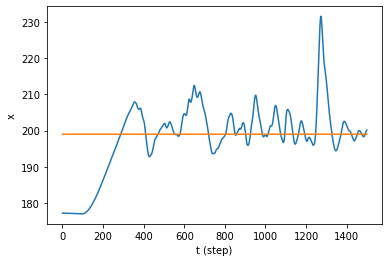

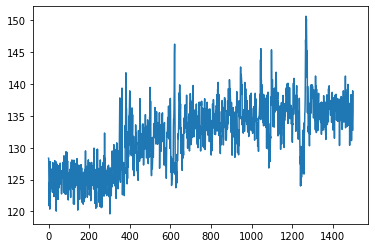

Episode 299, episode return -40.4, last 20 avg -47.4


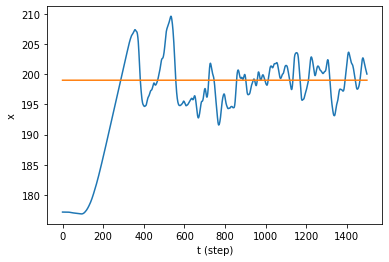

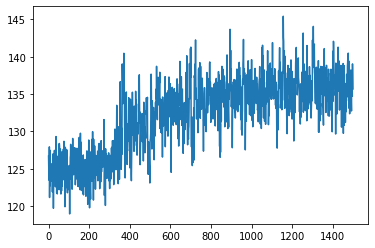

Episode 300, episode return -41.8, last 20 avg -47.2


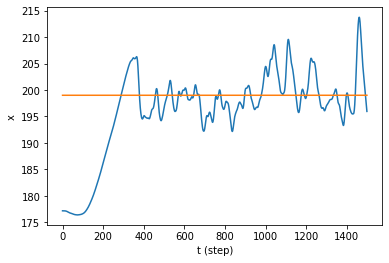

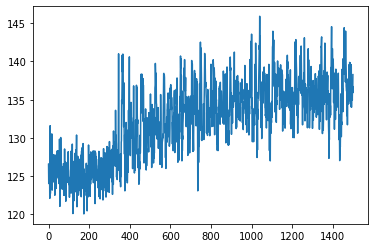

Episode 301, episode return -43.1, last 20 avg -46.7


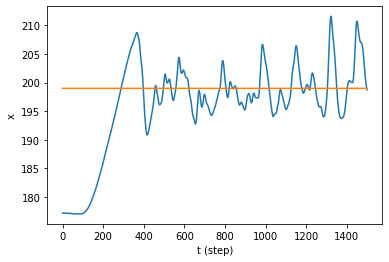

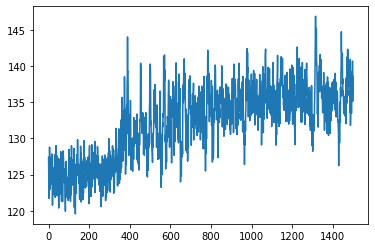

Episode 302, episode return -56.6, last 20 avg -47.1


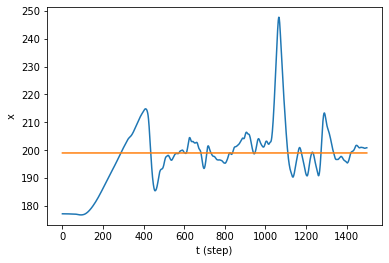

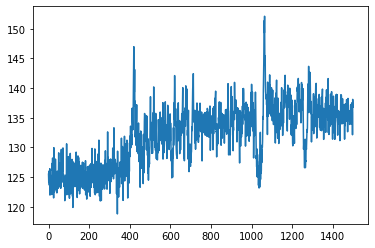

Episode 303, episode return -50.0, last 20 avg -47.3


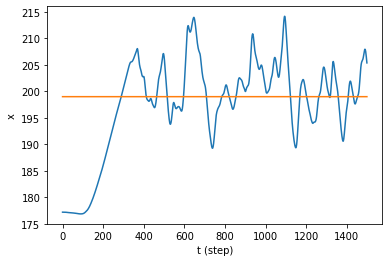

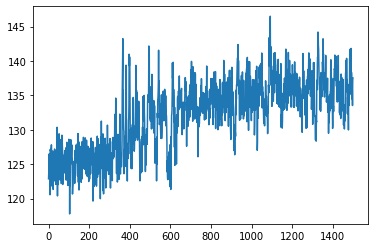

Episode 304, episode return -47.3, last 20 avg -47.5


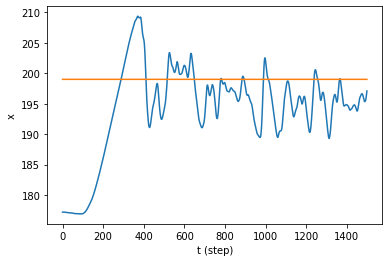

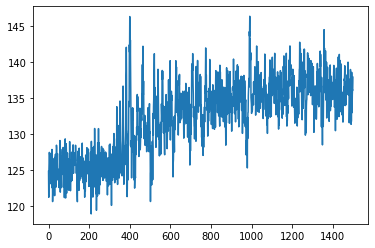

Episode 305, episode return -51.6, last 20 avg -47.8


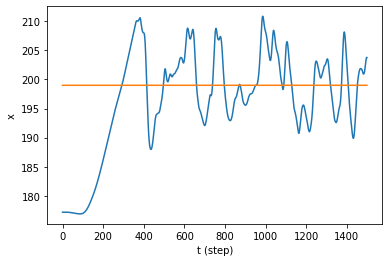

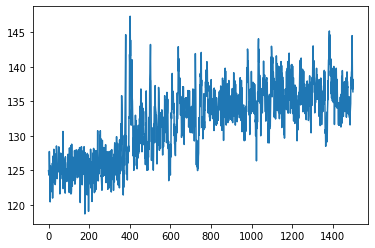

Episode 306, episode return -47.1, last 20 avg -47.9


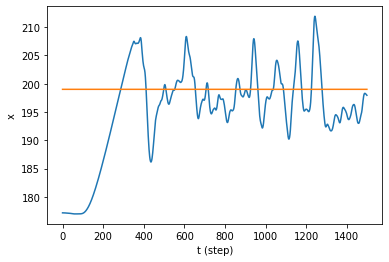

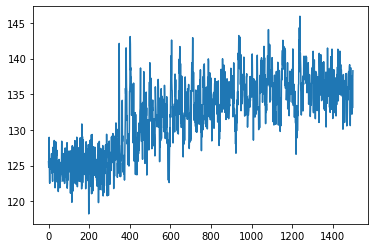

Episode 307, episode return -46.9, last 20 avg -47.9


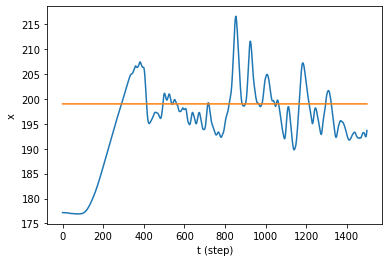

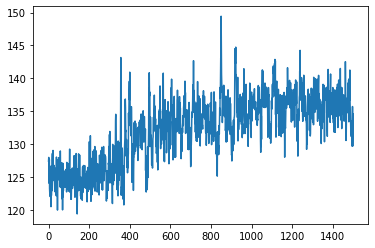

Episode 308, episode return -72.3, last 20 avg -49.4


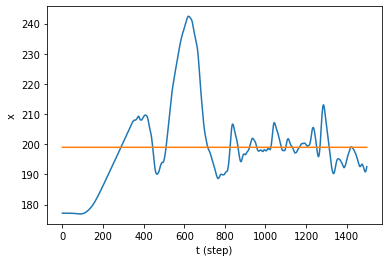

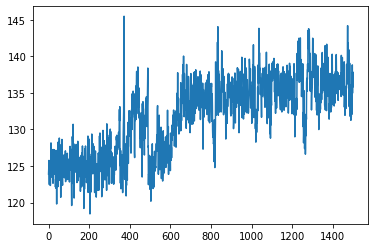

Episode 309, episode return -48.3, last 20 avg -49.4


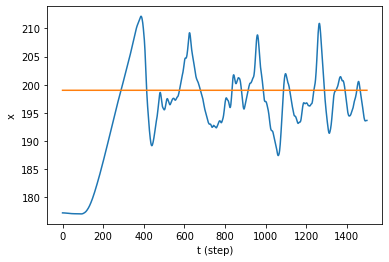

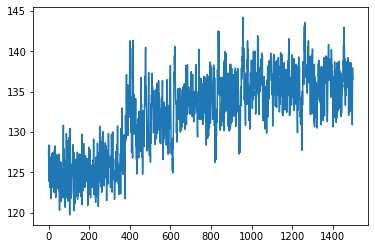

Episode 310, episode return -55.4, last 20 avg -50.0


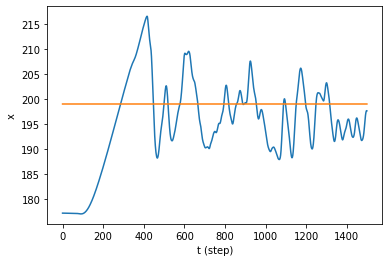

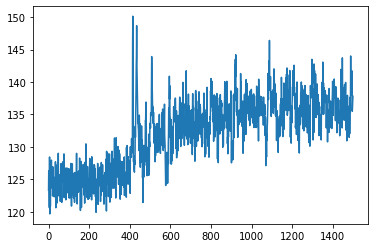

Episode 311, episode return -59.4, last 20 avg -49.4


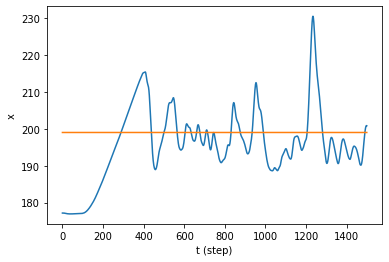

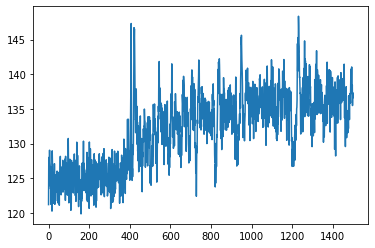

Episode 312, episode return -48.4, last 20 avg -49.6


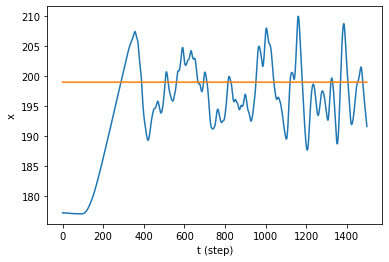

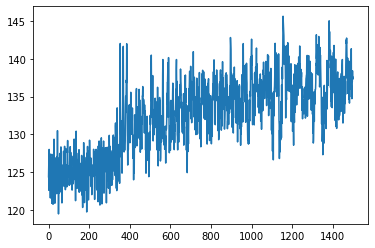

Episode 313, episode return -77.5, last 20 avg -51.4


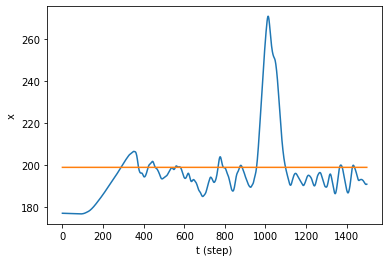

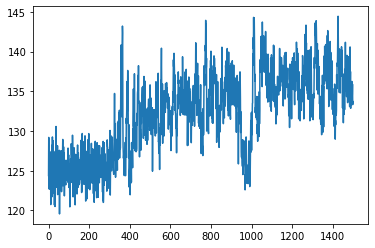

Episode 314, episode return -59.1, last 20 avg -51.5


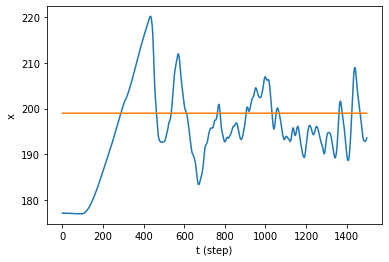

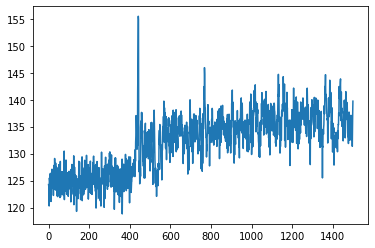

Episode 315, episode return -56.1, last 20 avg -52.3


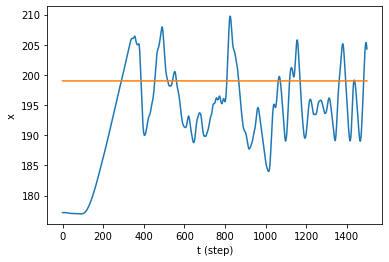

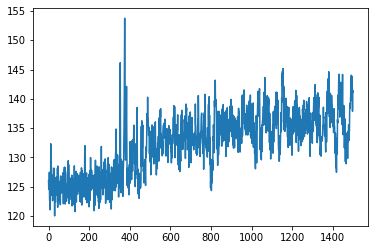

Episode 316, episode return -47.4, last 20 avg -52.2


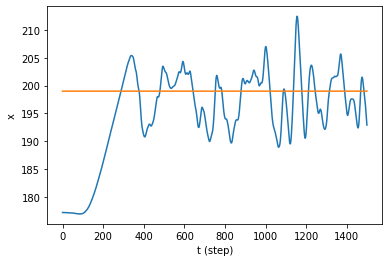

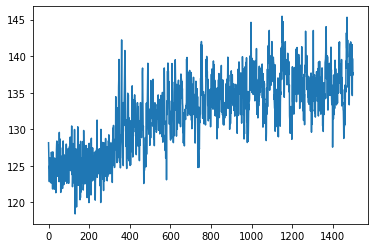

Episode 317, episode return -46.0, last 20 avg -52.2


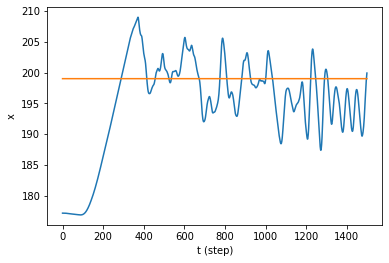

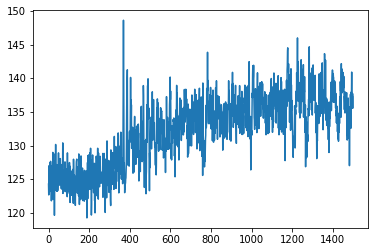

Episode 318, episode return -47.7, last 20 avg -52.1


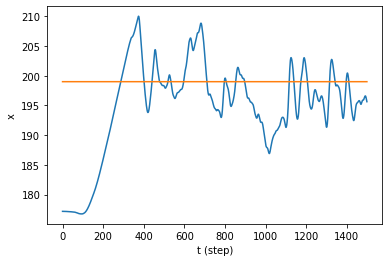

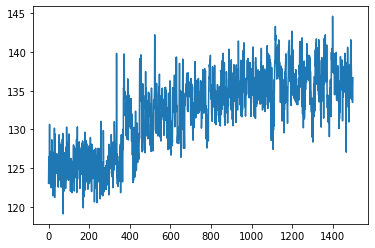

Episode 319, episode return -46.5, last 20 avg -52.4


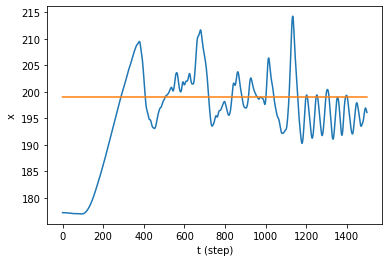

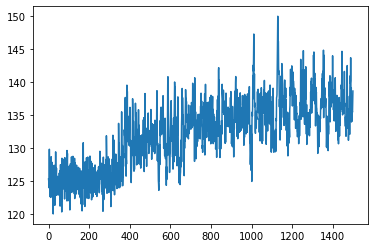

Episode 320, episode return -52.4, last 20 avg -53.0


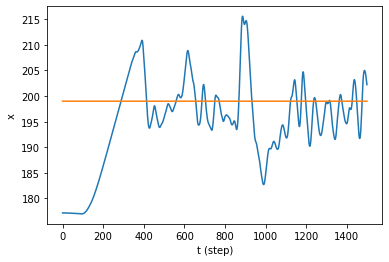

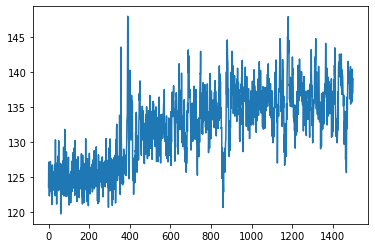

Episode 321, episode return -45.7, last 20 avg -53.1


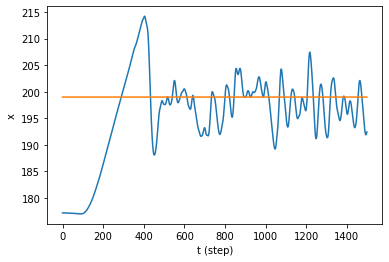

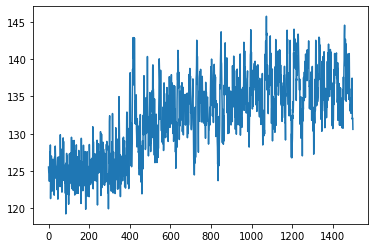

Episode 322, episode return -44.5, last 20 avg -52.5


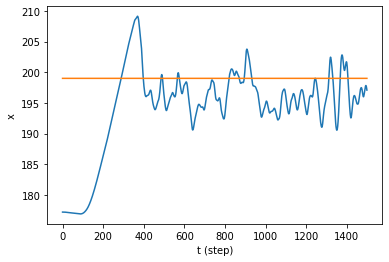

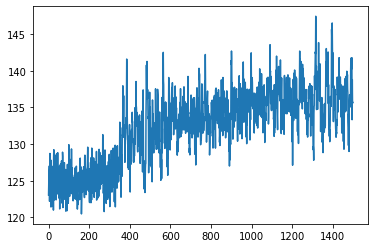

Episode 323, episode return -46.6, last 20 avg -52.3


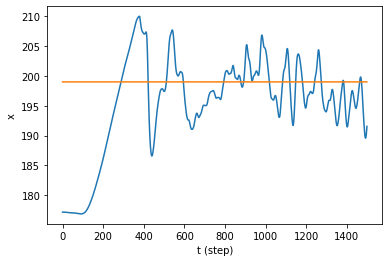

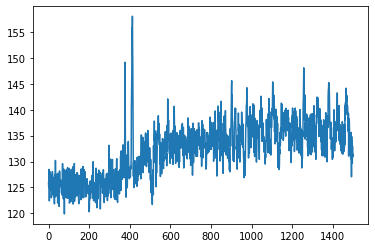

Episode 324, episode return -41.6, last 20 avg -52.0


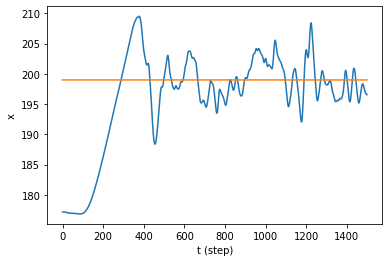

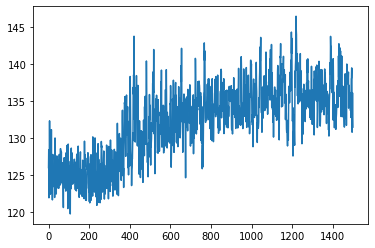

Episode 325, episode return -46.1, last 20 avg -51.7


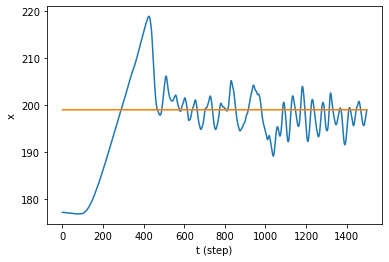

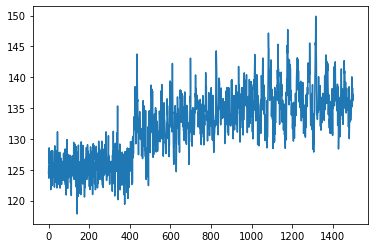

Episode 326, episode return -46.4, last 20 avg -51.7


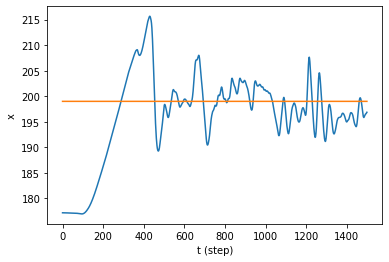

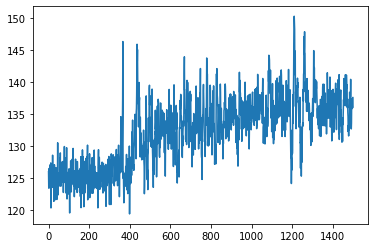

Episode 327, episode return -45.2, last 20 avg -51.6


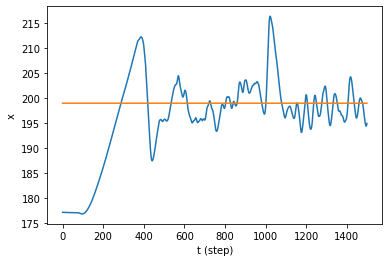

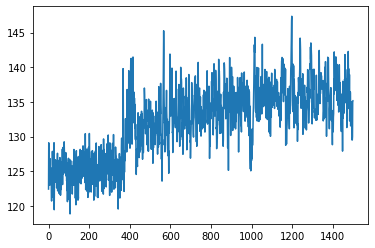

Episode 328, episode return -41.5, last 20 avg -50.1


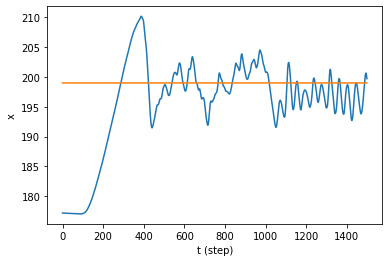

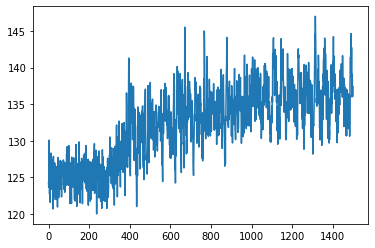

Episode 329, episode return -47.8, last 20 avg -50.1


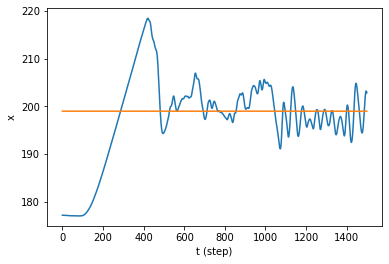

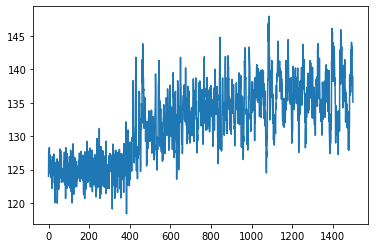

Episode 330, episode return -46.1, last 20 avg -49.6


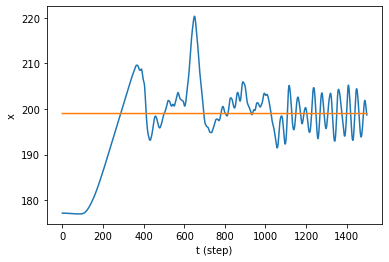

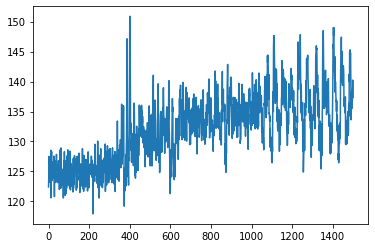

Episode 331, episode return -45.3, last 20 avg -48.9


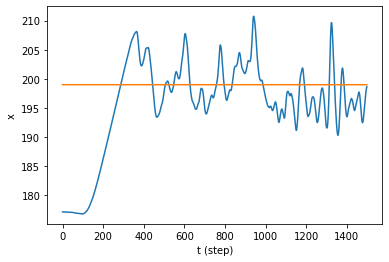

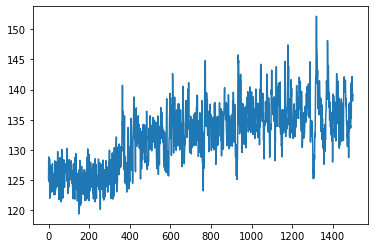

Episode 332, episode return -52.0, last 20 avg -49.1


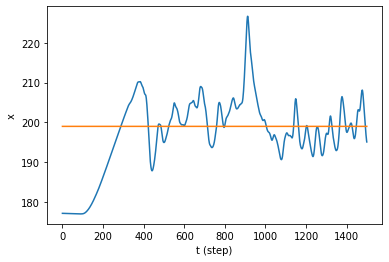

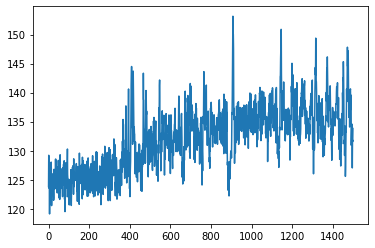

Episode 333, episode return -44.1, last 20 avg -47.4


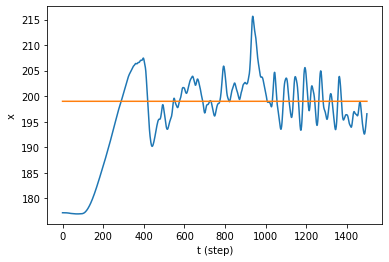

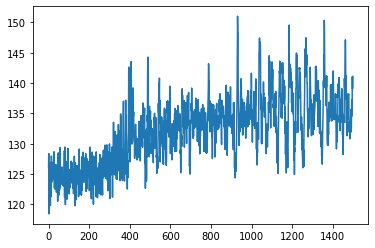

Episode 334, episode return -44.5, last 20 avg -46.7


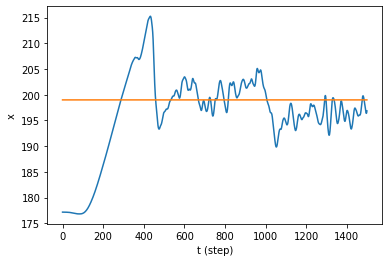

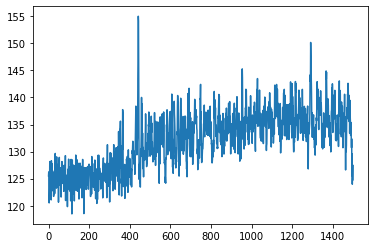

Episode 335, episode return -43.8, last 20 avg -46.1


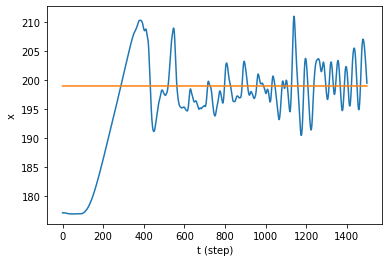

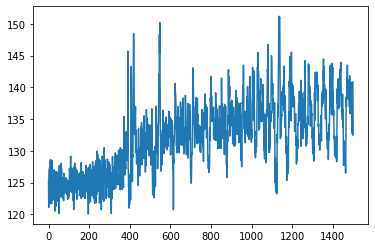

Episode 336, episode return -42.4, last 20 avg -45.8


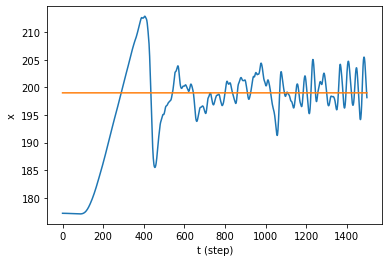

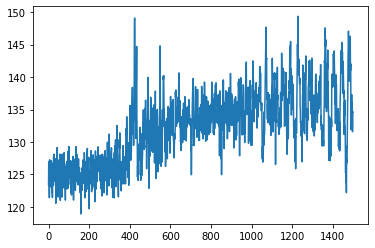

Episode 337, episode return -74.1, last 20 avg -47.2


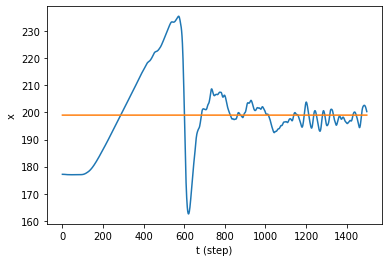

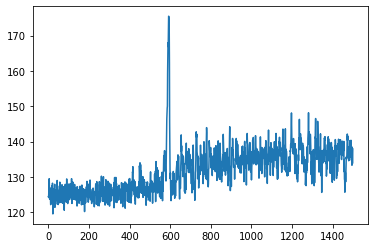

Episode 338, episode return -65.7, last 20 avg -48.1


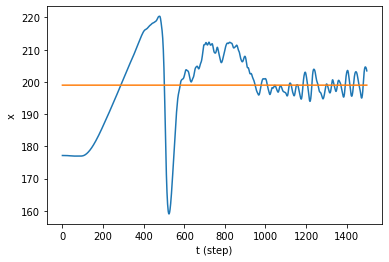

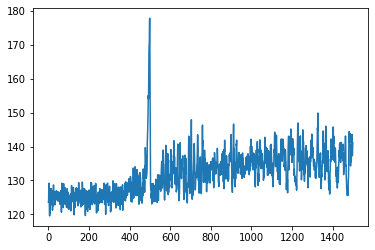

Episode 339, episode return -43.4, last 20 avg -48.0


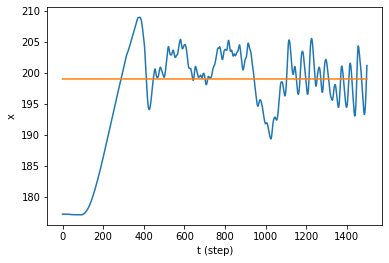

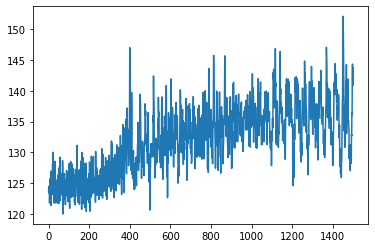

Episode 340, episode return -45.9, last 20 avg -47.6


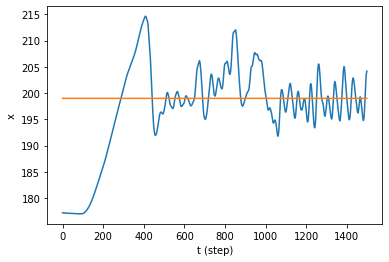

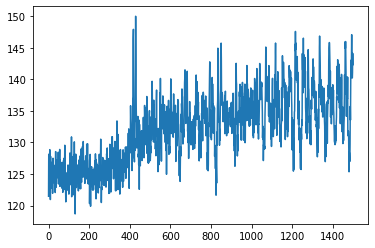

Episode 341, episode return -44.7, last 20 avg -47.6


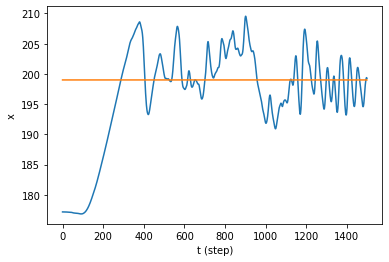

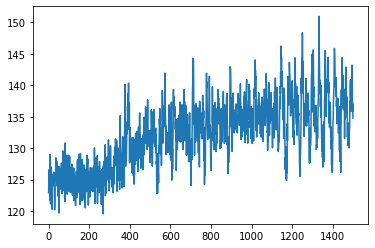

Episode 342, episode return -43.5, last 20 avg -47.5


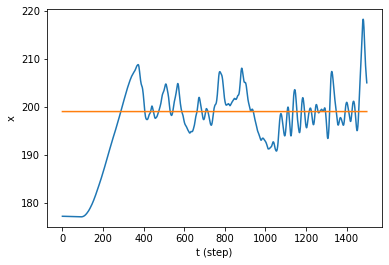

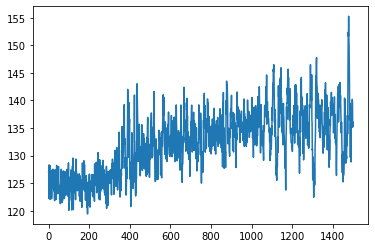

Episode 343, episode return -70.2, last 20 avg -48.7


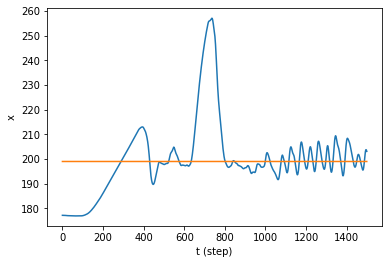

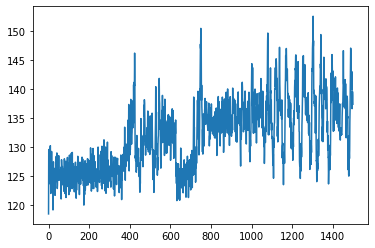

Episode 344, episode return -44.9, last 20 avg -48.9


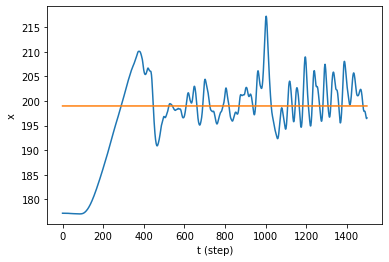

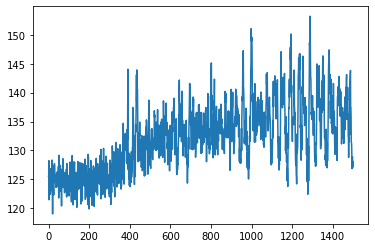

Episode 345, episode return -41.5, last 20 avg -48.7


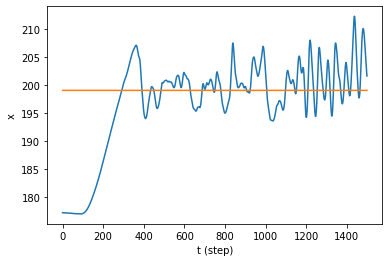

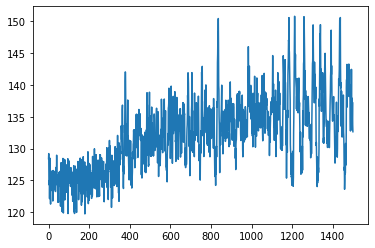

Episode 346, episode return -97.0, last 20 avg -51.2


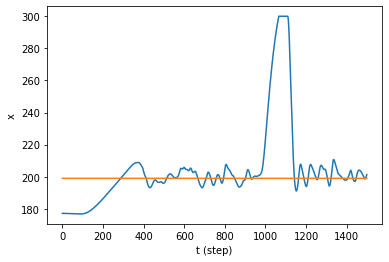

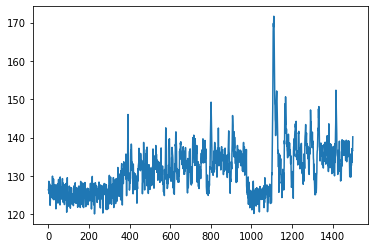

Episode 347, episode return -45.0, last 20 avg -51.2


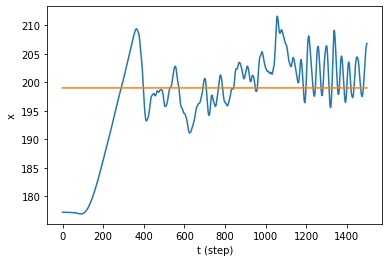

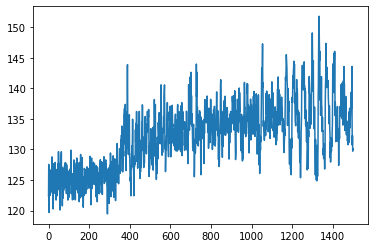

Episode 348, episode return -43.5, last 20 avg -51.3


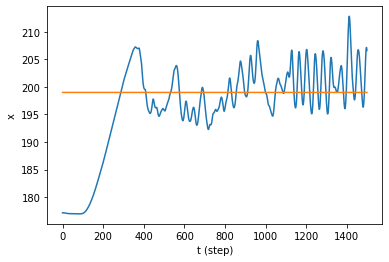

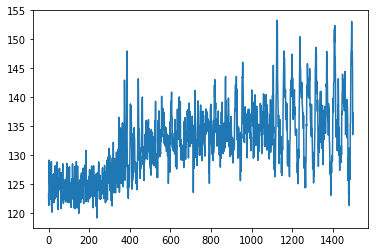

Episode 349, episode return -46.5, last 20 avg -51.2


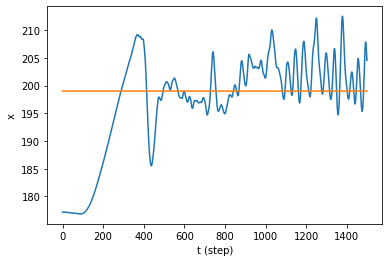

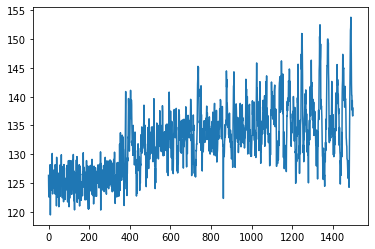

Episode 350, episode return -46.7, last 20 avg -51.2


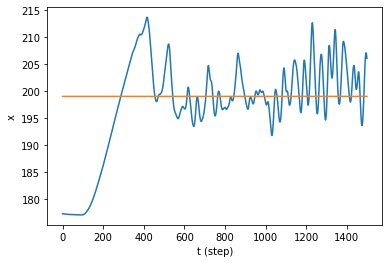

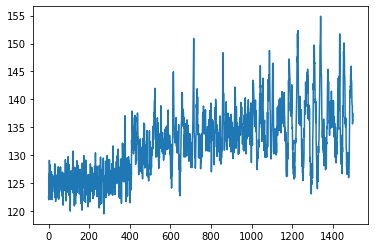

Episode 351, episode return -45.8, last 20 avg -51.3


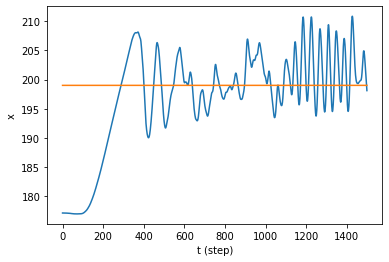

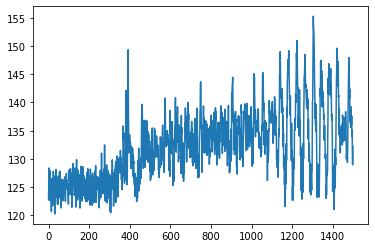

Episode 352, episode return -49.9, last 20 avg -51.2


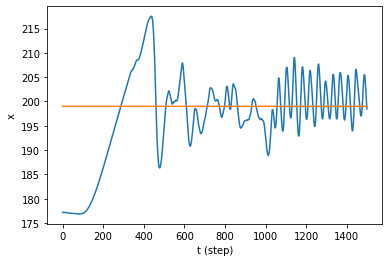

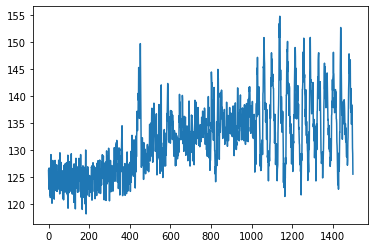

Episode 353, episode return -43.8, last 20 avg -51.1


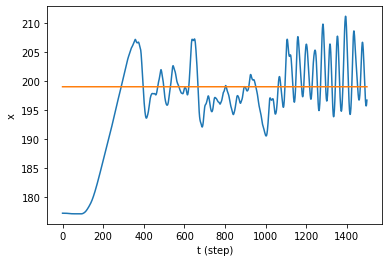

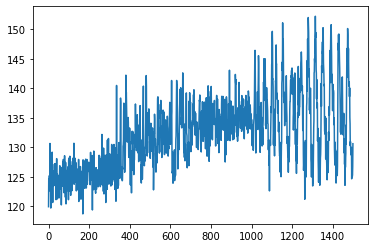

Episode 354, episode return -51.3, last 20 avg -51.5


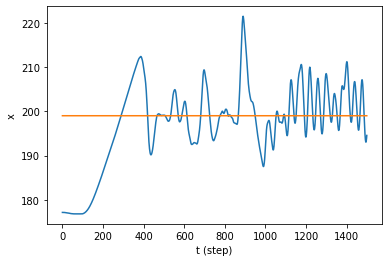

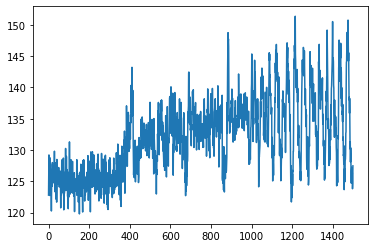

Episode 355, episode return -47.1, last 20 avg -51.6


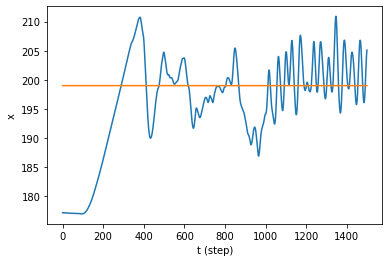

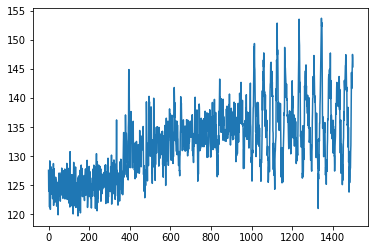

Episode 356, episode return -49.2, last 20 avg -52.0


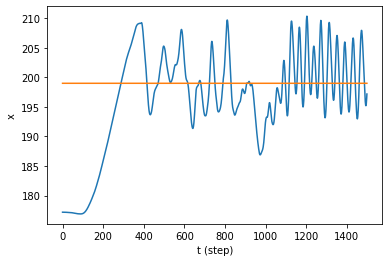

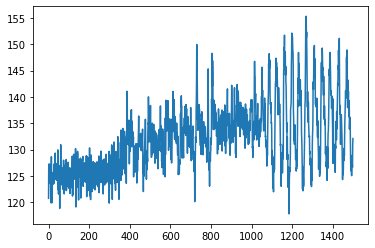

Episode 357, episode return -49.5, last 20 avg -50.8


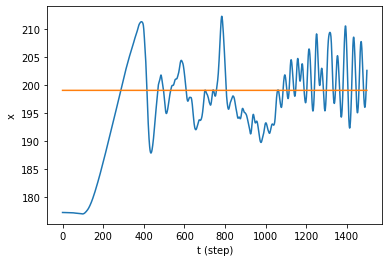

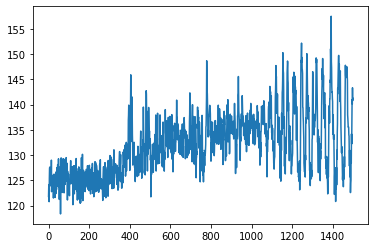

Episode 358, episode return -48.4, last 20 avg -49.9


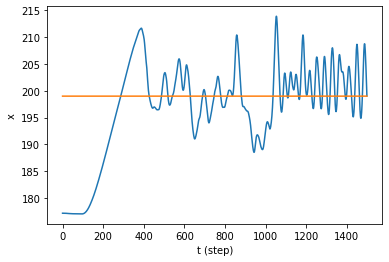

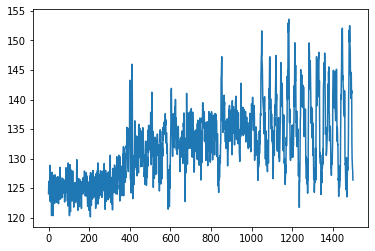

Episode 359, episode return -68.9, last 20 avg -51.2


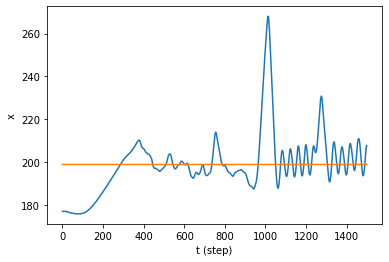

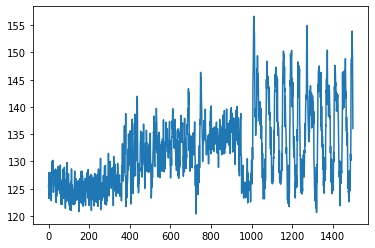

Episode 360, episode return -58.8, last 20 avg -51.8


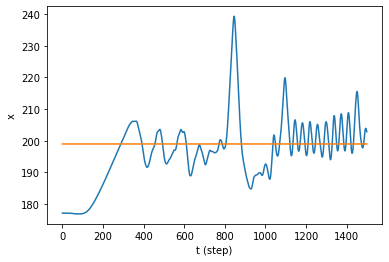

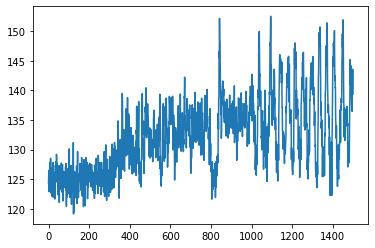

Episode 361, episode return -45.5, last 20 avg -51.8


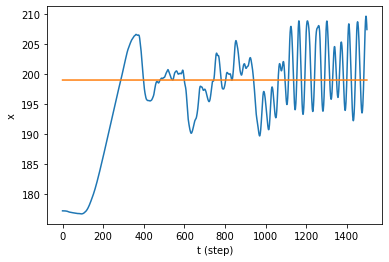

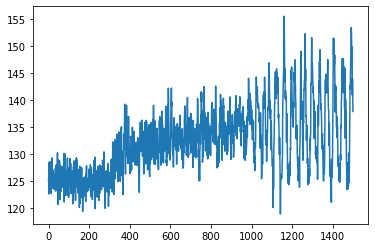

Episode 362, episode return -50.8, last 20 avg -52.2


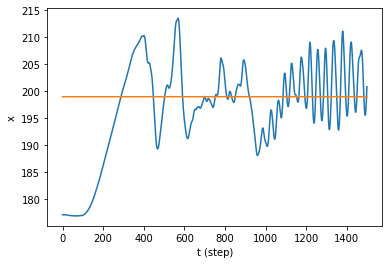

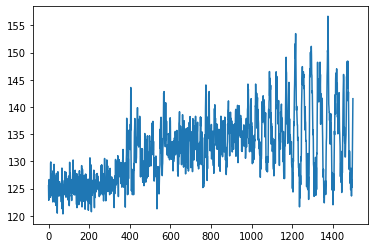

Episode 363, episode return -47.4, last 20 avg -51.1


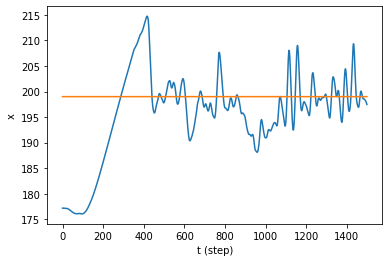

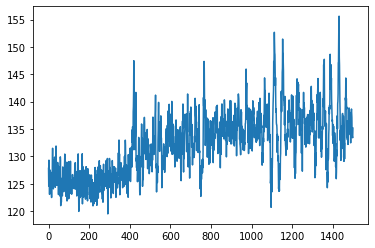

Episode 364, episode return -53.4, last 20 avg -51.5


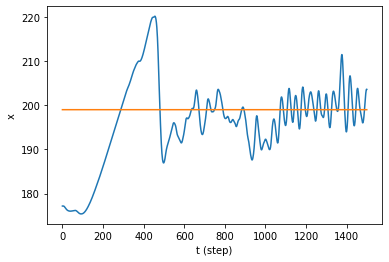

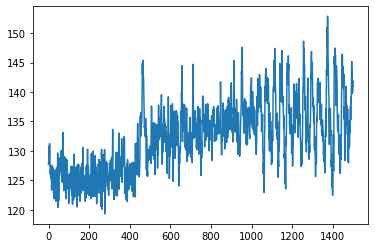

Episode 365, episode return -51.0, last 20 avg -52.0


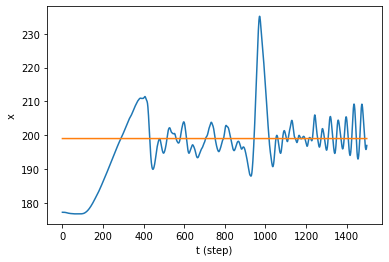

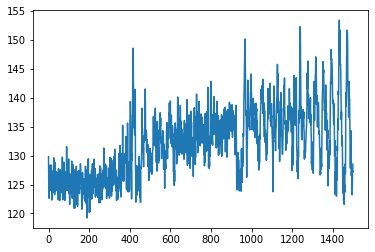

Episode 366, episode return -46.4, last 20 avg -49.4


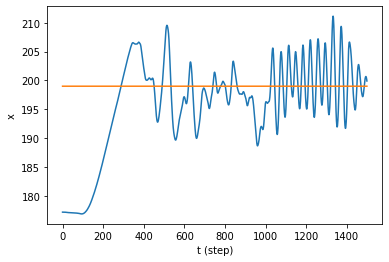

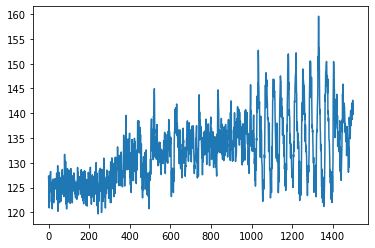

Episode 367, episode return -46.7, last 20 avg -49.5


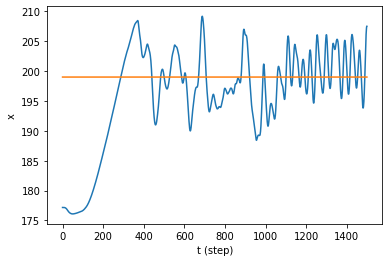

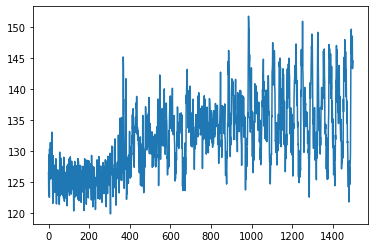

Episode 368, episode return -59.5, last 20 avg -50.3


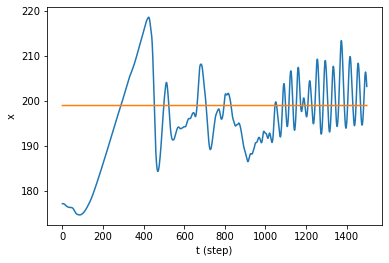

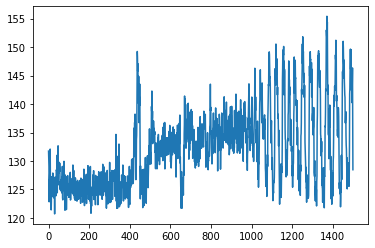

Episode 369, episode return -51.1, last 20 avg -50.6


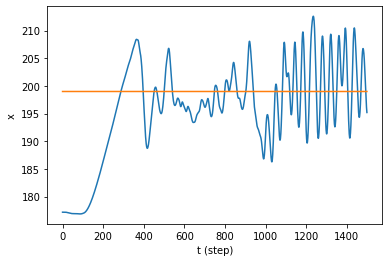

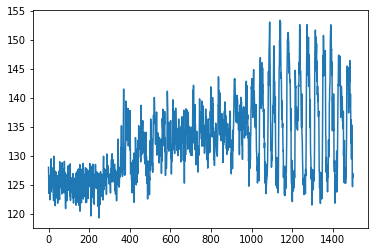

Episode 370, episode return -61.7, last 20 avg -51.3


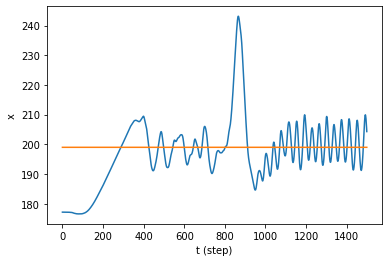

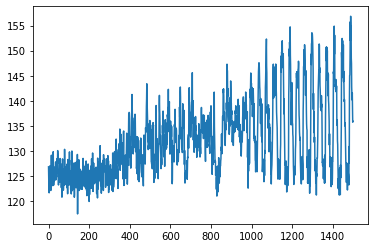

Episode 371, episode return -54.7, last 20 avg -51.8


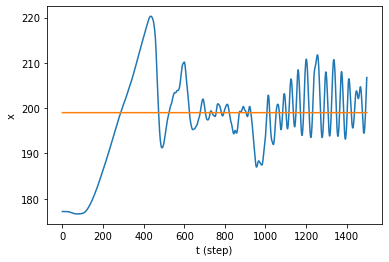

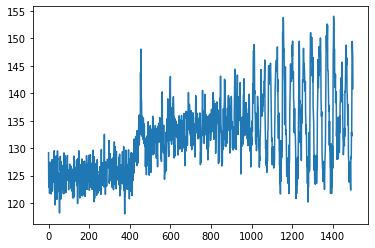

Episode 372, episode return -53.8, last 20 avg -52.0


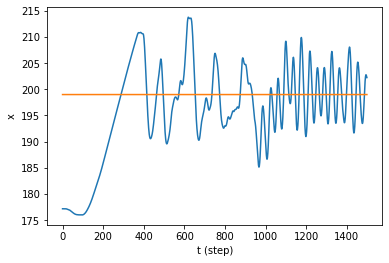

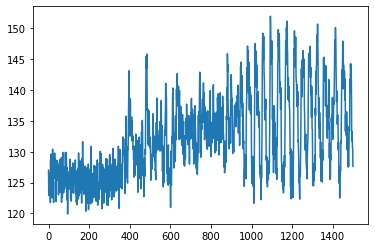

Episode 373, episode return -49.6, last 20 avg -52.2


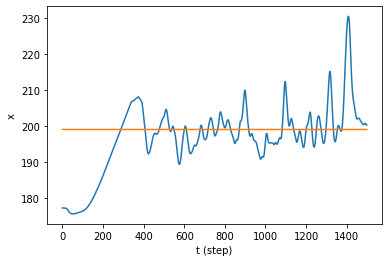

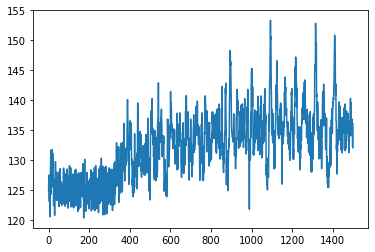

Episode 374, episode return -44.5, last 20 avg -51.9


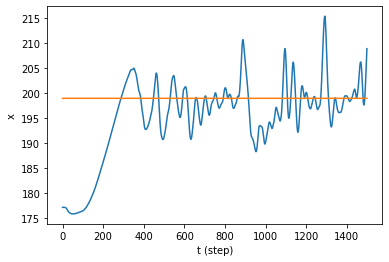

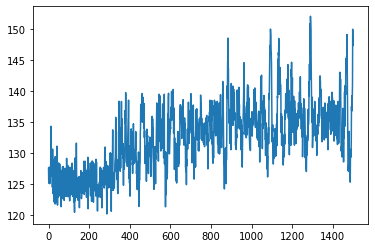

Episode 375, episode return -56.4, last 20 avg -52.4


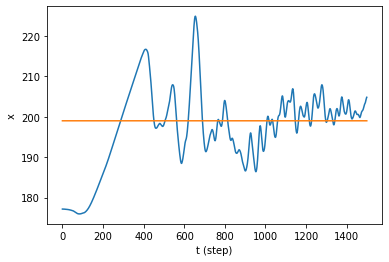

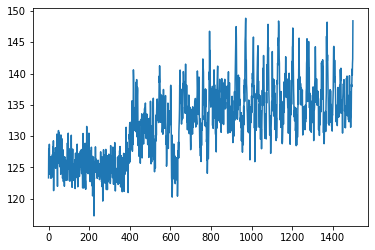

Episode 376, episode return -51.3, last 20 avg -52.5


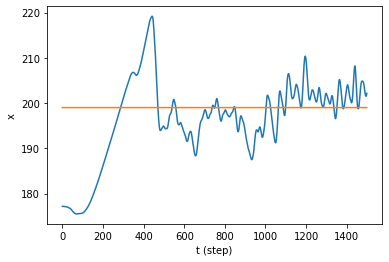

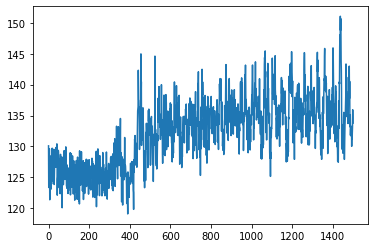

Episode 377, episode return -53.7, last 20 avg -52.7


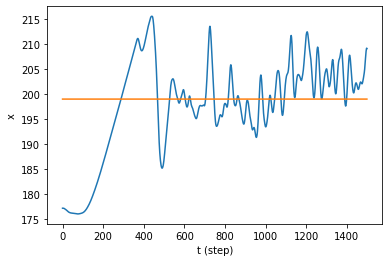

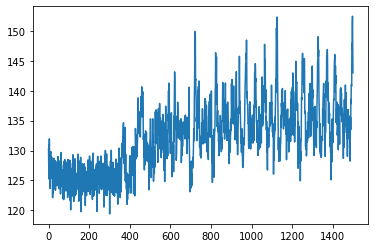

Episode 378, episode return -48.3, last 20 avg -52.7


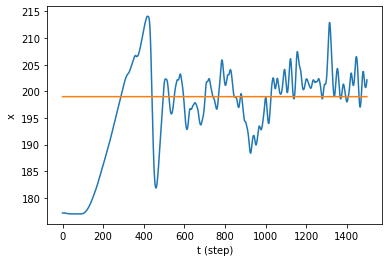

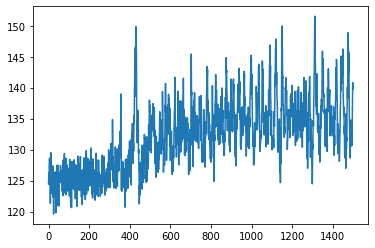

Episode 379, episode return -47.0, last 20 avg -51.6


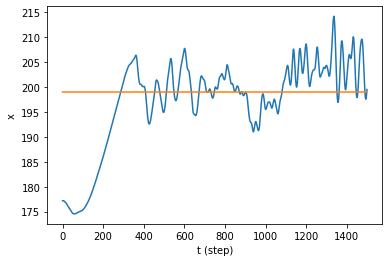

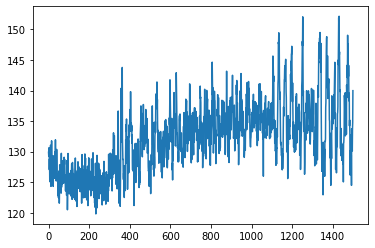

Episode 380, episode return -50.3, last 20 avg -51.2


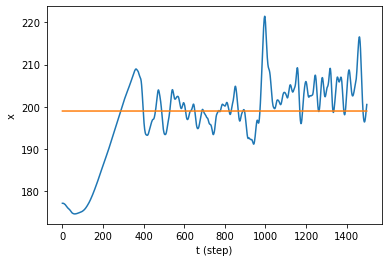

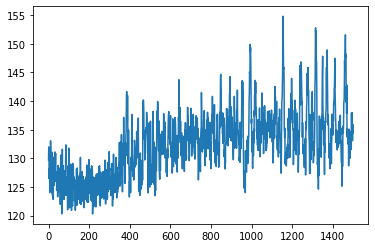

Episode 381, episode return -65.5, last 20 avg -52.2


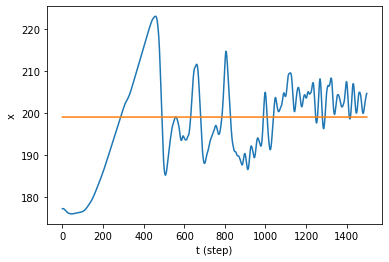

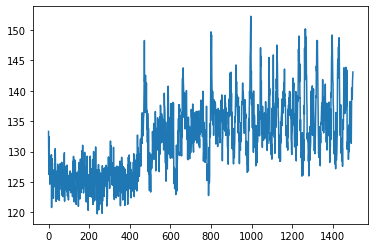

Episode 382, episode return -46.2, last 20 avg -51.9


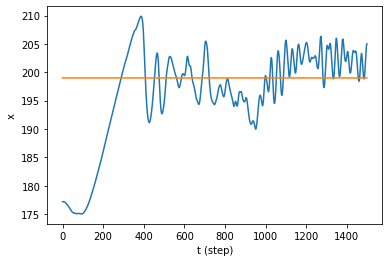

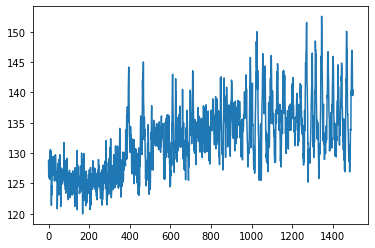

Episode 383, episode return -54.6, last 20 avg -52.3


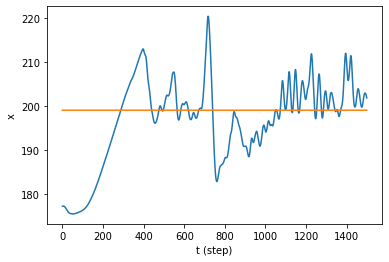

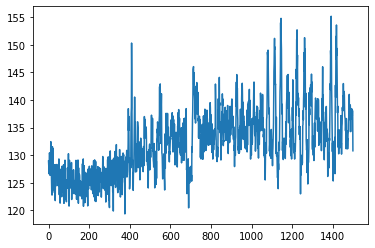

Episode 384, episode return -47.4, last 20 avg -52.0


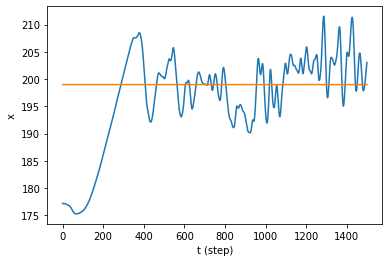

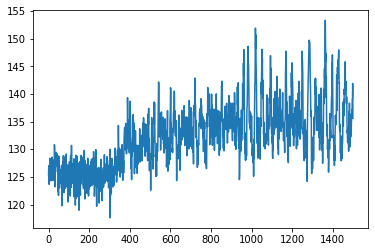

Episode 385, episode return -48.5, last 20 avg -51.9


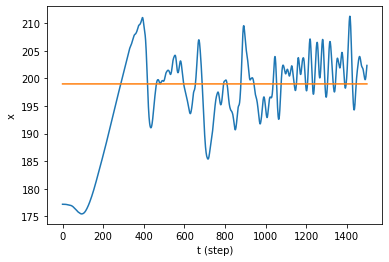

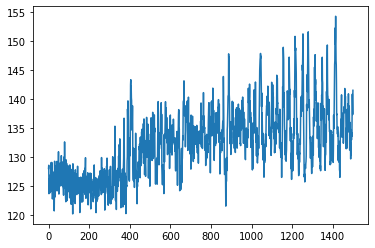

Episode 386, episode return -51.3, last 20 avg -52.1


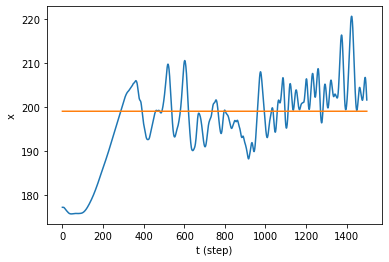

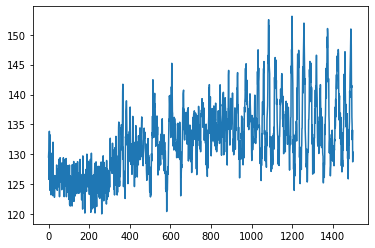

Episode 387, episode return -45.3, last 20 avg -52.0


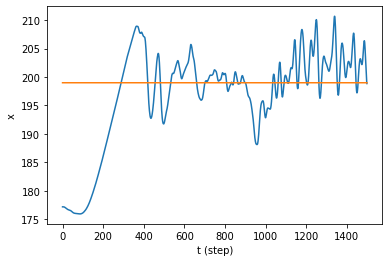

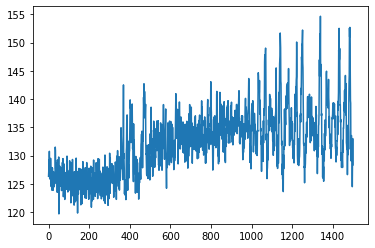

Episode 388, episode return -48.8, last 20 avg -51.5


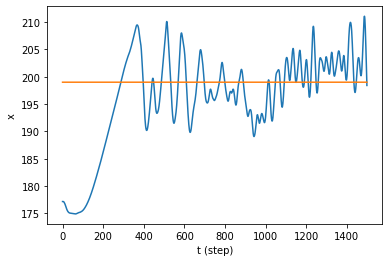

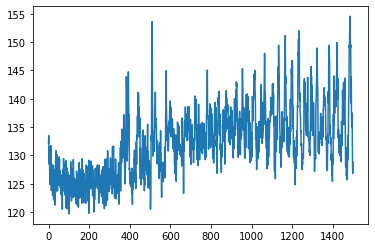

Episode 389, episode return -43.9, last 20 avg -51.1


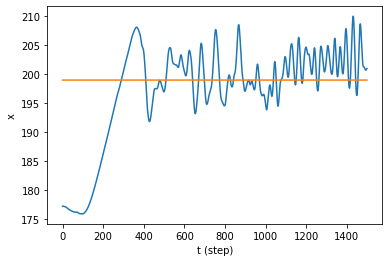

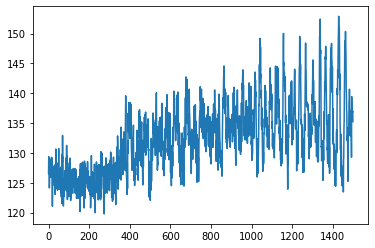

Episode 390, episode return -48.3, last 20 avg -50.5


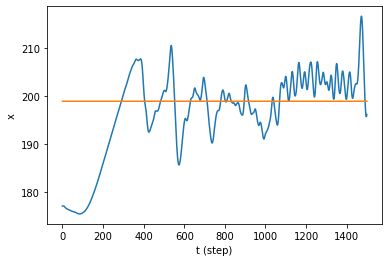

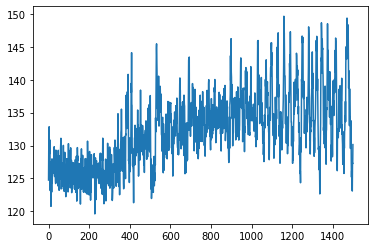

Episode 391, episode return -64.7, last 20 avg -51.0


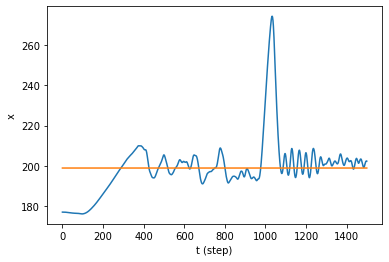

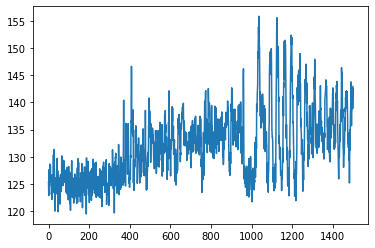

Episode 392, episode return -69.1, last 20 avg -51.7


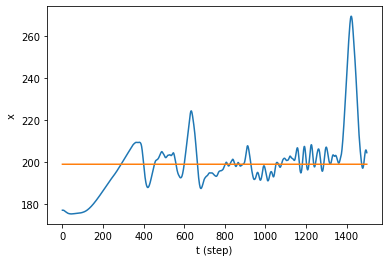

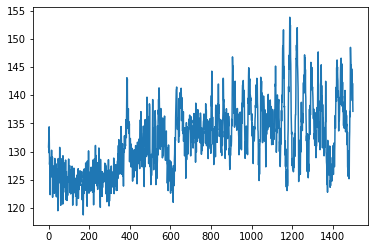

Episode 393, episode return -54.4, last 20 avg -52.0


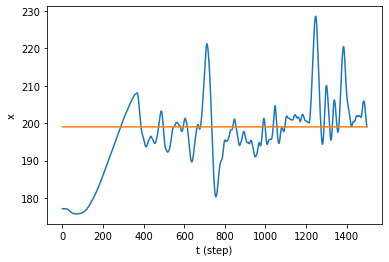

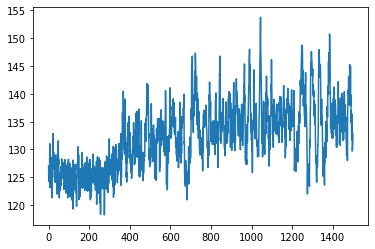

Episode 394, episode return -392.0, last 20 avg -69.3


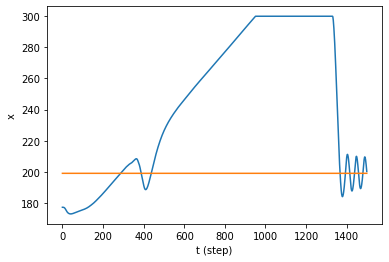

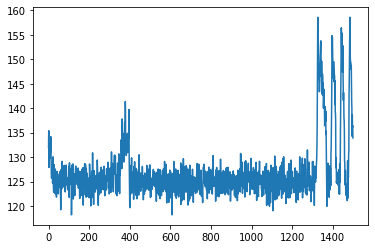

Episode 395, episode return -73.1, last 20 avg -70.2


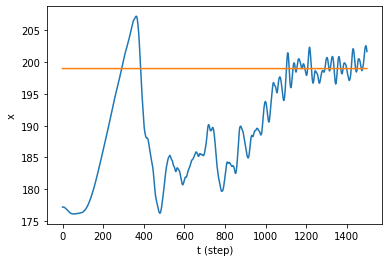

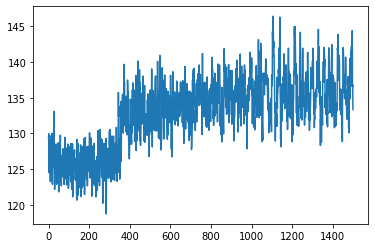

Episode 396, episode return -50.4, last 20 avg -70.1


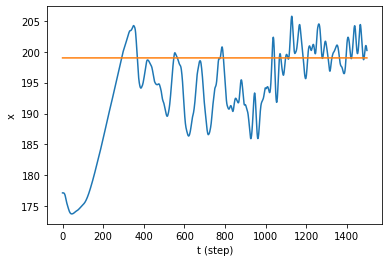

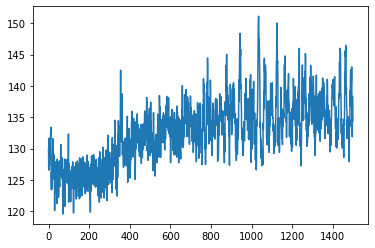

Episode 397, episode return -42.7, last 20 avg -69.6


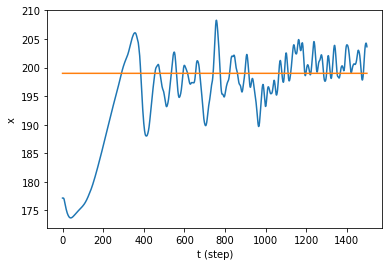

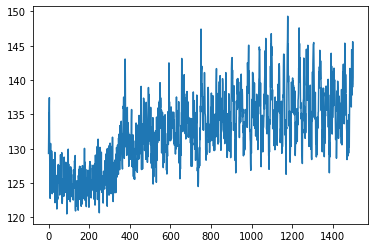

Episode 398, episode return -43.2, last 20 avg -69.3


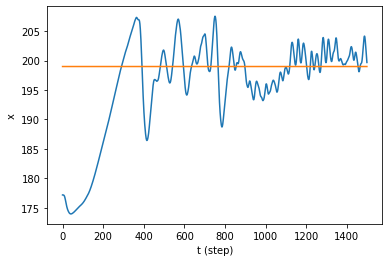

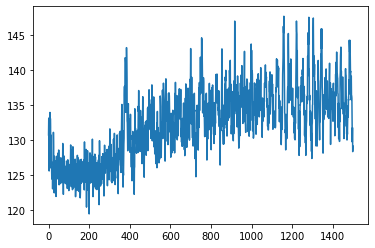

Episode 399, episode return -42.6, last 20 avg -69.1


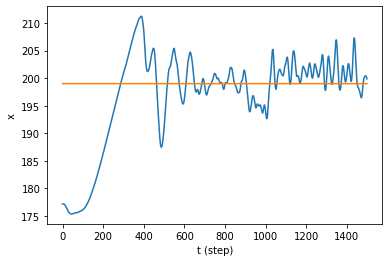

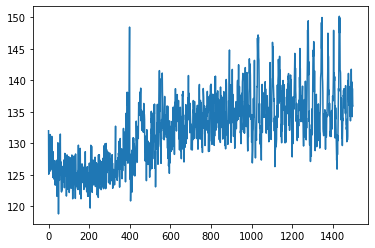

Episode 400, episode return -42.2, last 20 avg -68.7


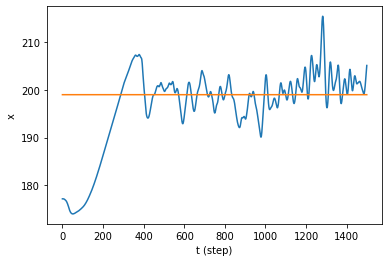

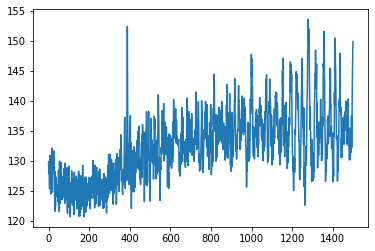

Episode 401, episode return -46.0, last 20 avg -67.7


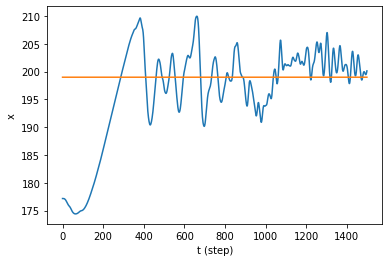

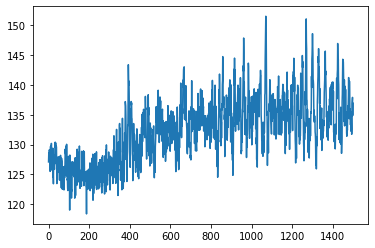

Episode 402, episode return -50.7, last 20 avg -68.0


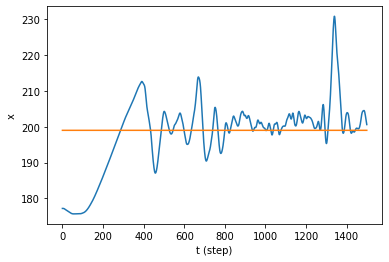

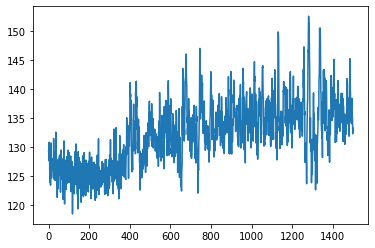

Episode 403, episode return -44.2, last 20 avg -67.4


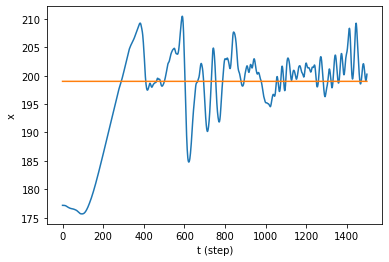

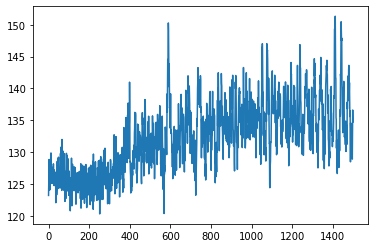

Episode 404, episode return -47.0, last 20 avg -67.4


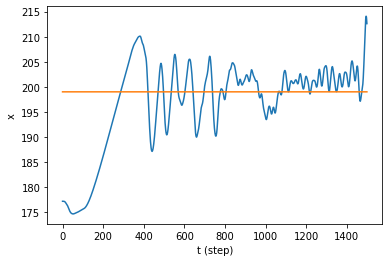

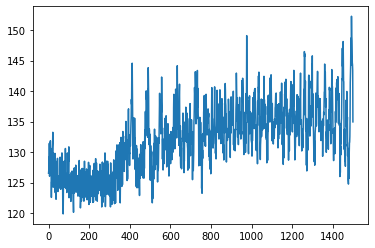

Episode 405, episode return -42.5, last 20 avg -67.1


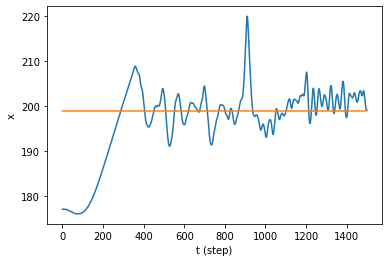

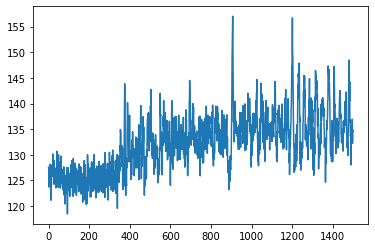

Episode 406, episode return -52.6, last 20 avg -67.2


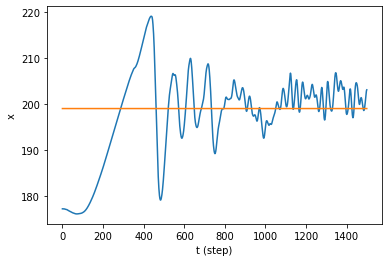

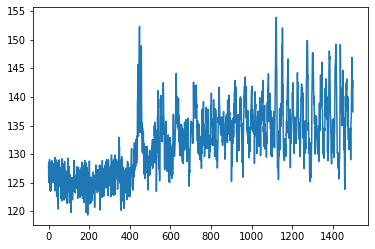

Episode 407, episode return -47.8, last 20 avg -67.3


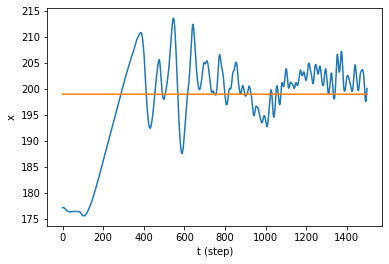

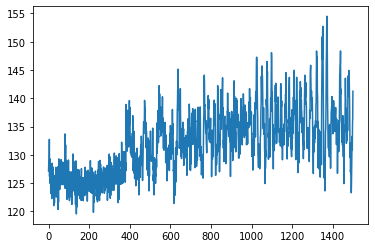

Episode 408, episode return -50.7, last 20 avg -67.4


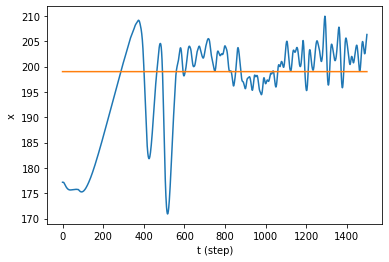

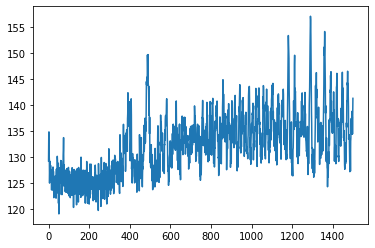

Episode 409, episode return -52.2, last 20 avg -67.8


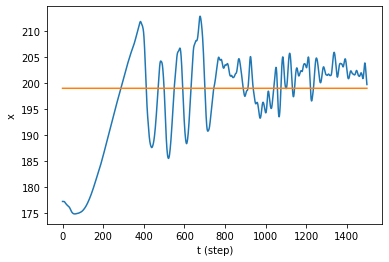

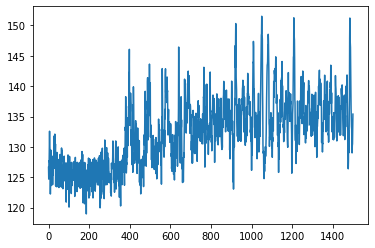

Episode 410, episode return -50.2, last 20 avg -67.9


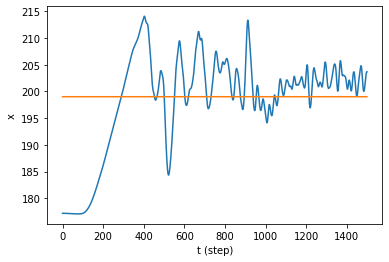

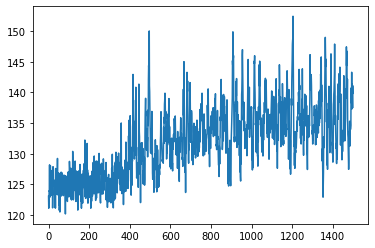

Episode 411, episode return -53.4, last 20 avg -67.3


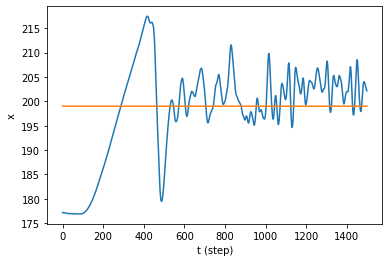

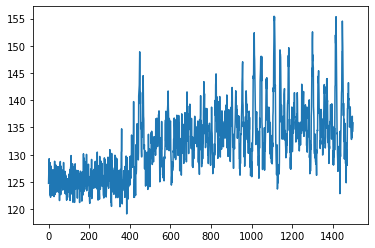

Episode 412, episode return -49.7, last 20 avg -66.4


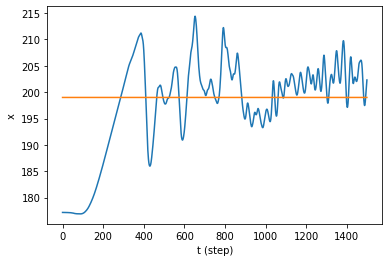

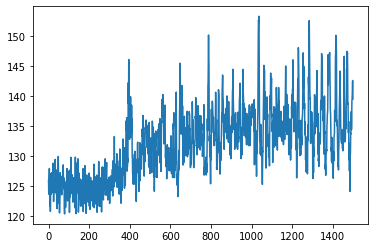

Episode 413, episode return -47.1, last 20 avg -66.0


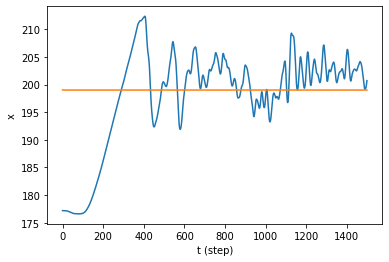

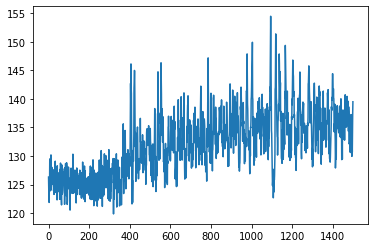

Episode 414, episode return -60.9, last 20 avg -49.5


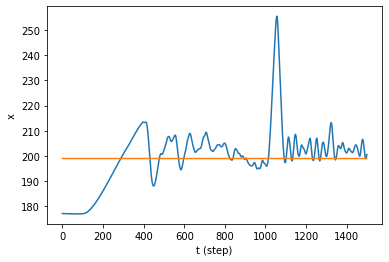

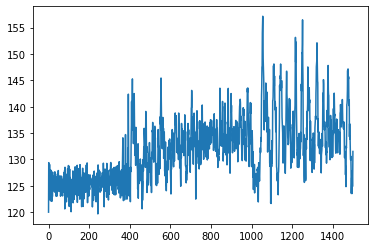

Episode 415, episode return -46.7, last 20 avg -48.1


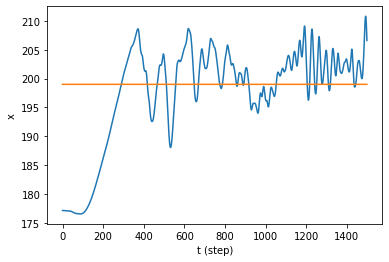

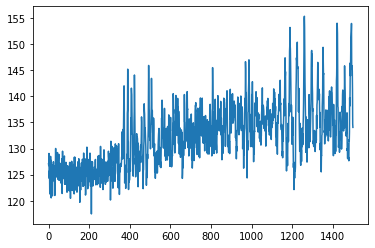

Episode 416, episode return -47.1, last 20 avg -48.0


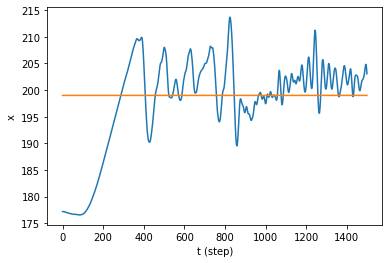

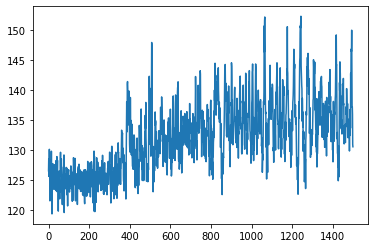

Episode 417, episode return -125.2, last 20 avg -52.1


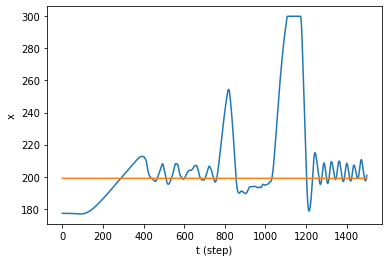

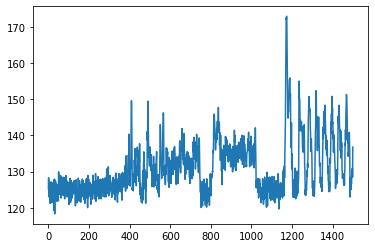

Episode 418, episode return -46.5, last 20 avg -52.3


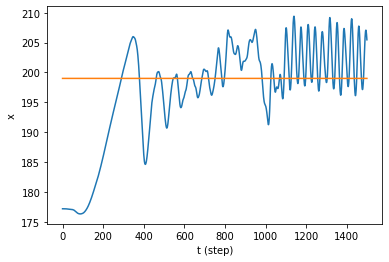

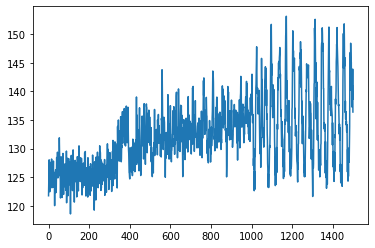

Episode 419, episode return -48.4, last 20 avg -52.6


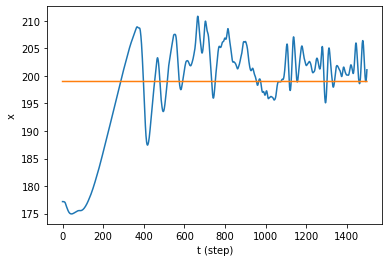

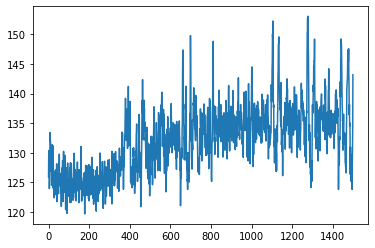

Episode 420, episode return -48.8, last 20 avg -52.9


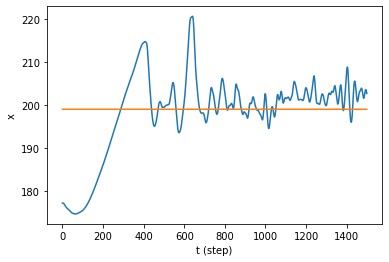

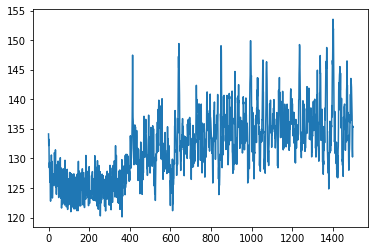

Episode 421, episode return -46.1, last 20 avg -52.9


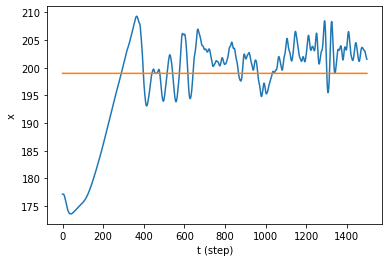

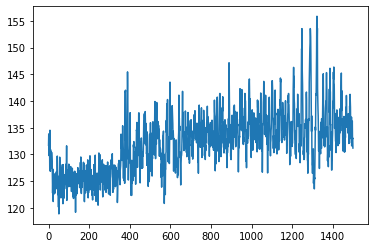

Episode 422, episode return -44.7, last 20 avg -52.6


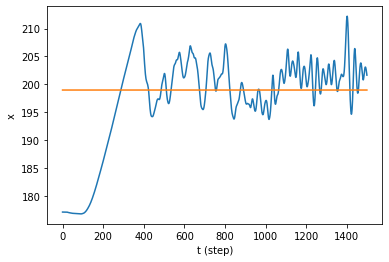

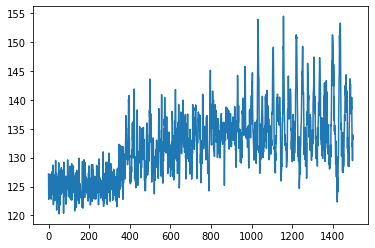

Episode 423, episode return -65.7, last 20 avg -53.7


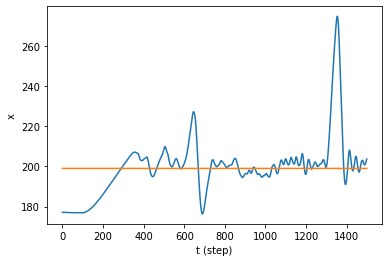

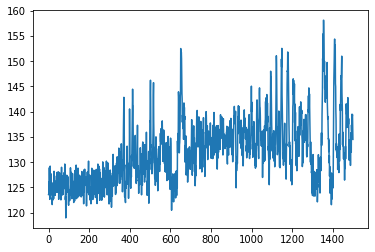

Episode 424, episode return -57.3, last 20 avg -54.2


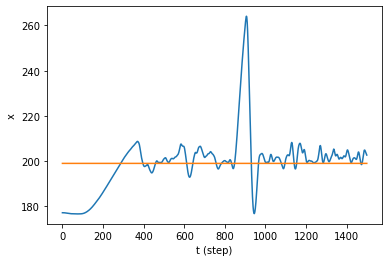

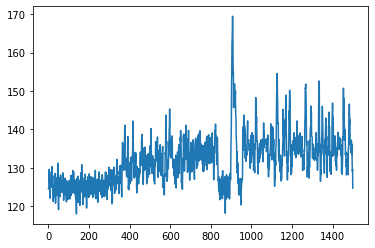

Episode 425, episode return -44.7, last 20 avg -54.3


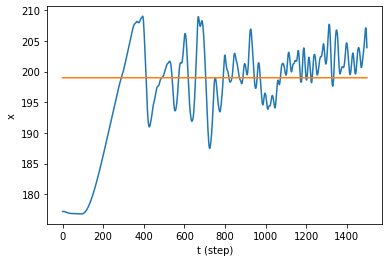

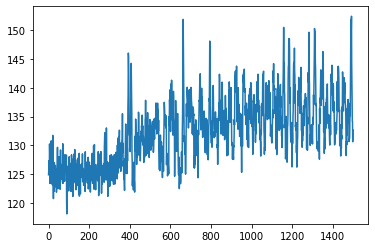

Episode 426, episode return -44.1, last 20 avg -53.9


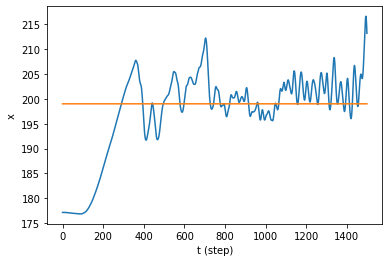

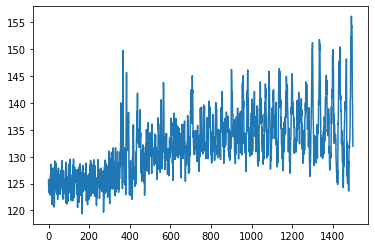

Episode 427, episode return -86.4, last 20 avg -55.8


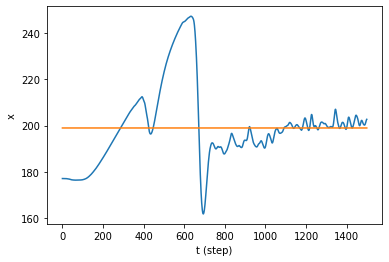

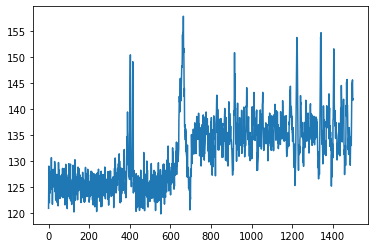

Episode 428, episode return -42.2, last 20 avg -55.4


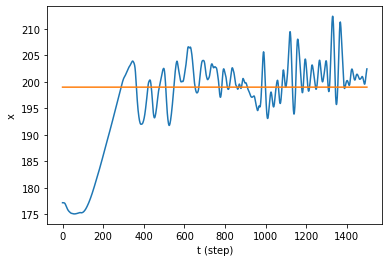

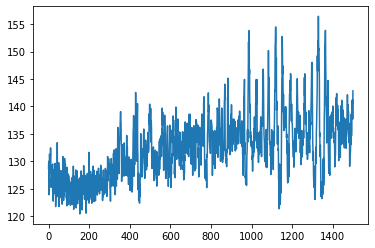

Episode 429, episode return -47.5, last 20 avg -55.1


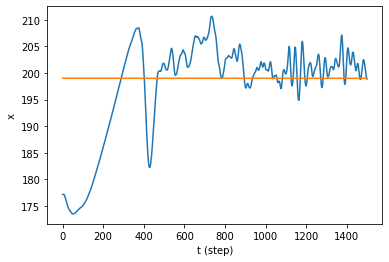

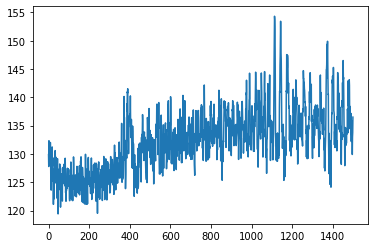

Episode 430, episode return -46.8, last 20 avg -55.0


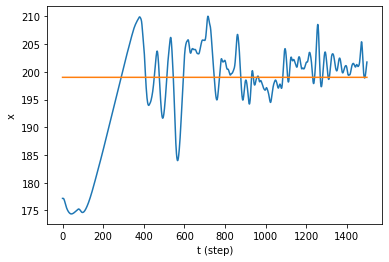

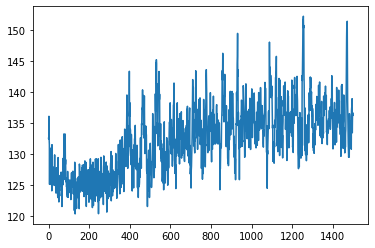

Episode 431, episode return -50.6, last 20 avg -54.8


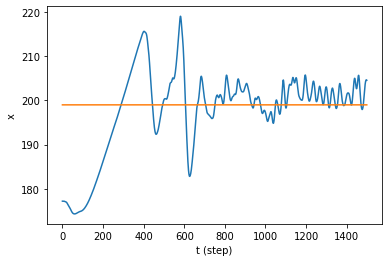

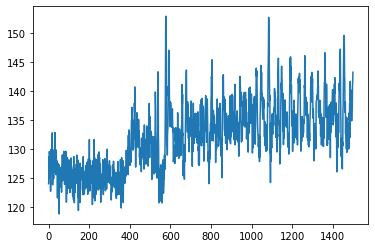

Episode 432, episode return -48.6, last 20 avg -54.8


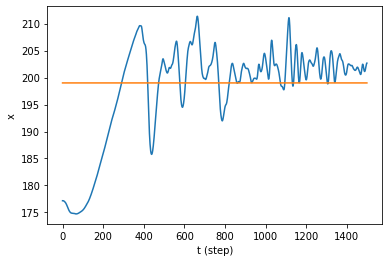

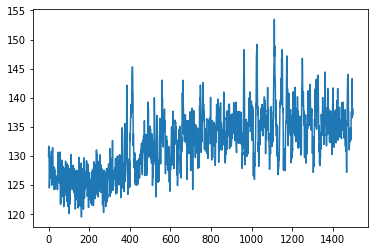

Episode 433, episode return -55.5, last 20 avg -55.2


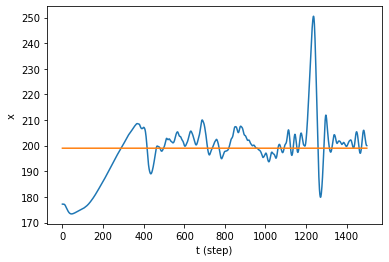

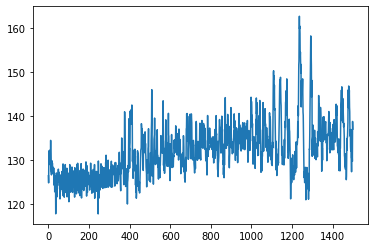

Episode 434, episode return -45.6, last 20 avg -54.4


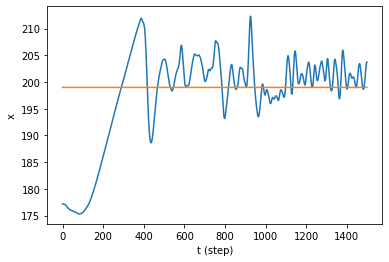

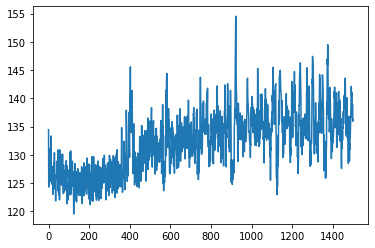

Episode 435, episode return -48.2, last 20 avg -54.5


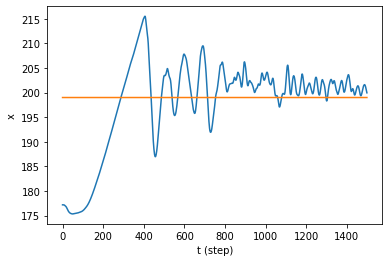

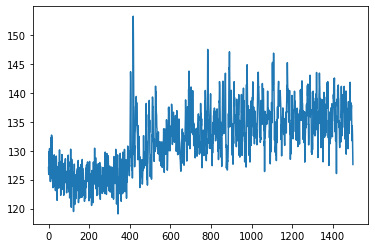

Episode 436, episode return -51.1, last 20 avg -54.7


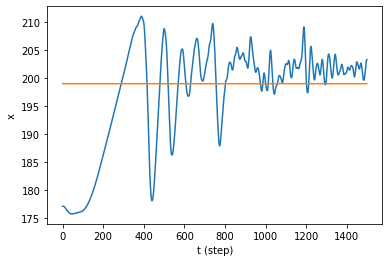

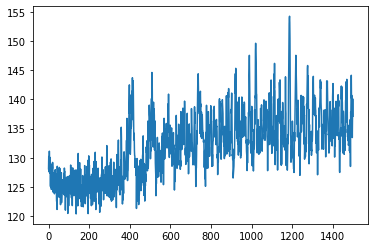

Episode 437, episode return -47.4, last 20 avg -50.8


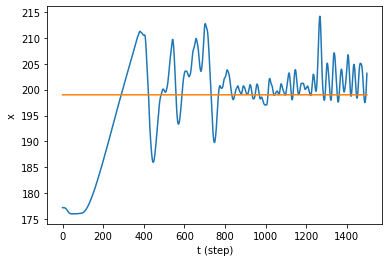

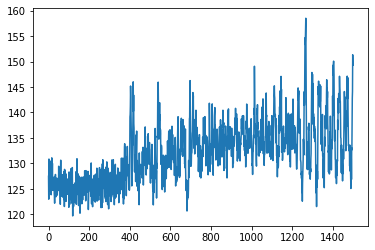

Episode 438, episode return -51.1, last 20 avg -51.0


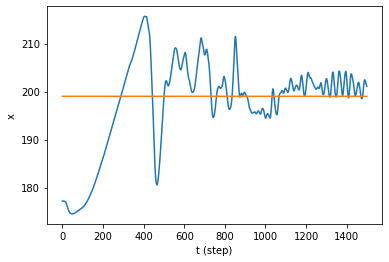

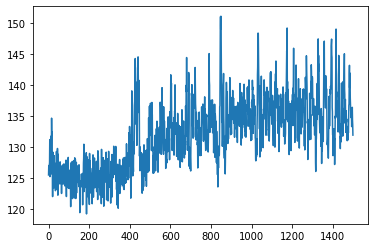

Episode 439, episode return -44.1, last 20 avg -50.8


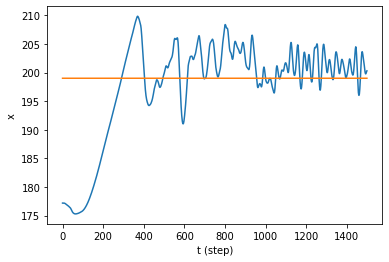

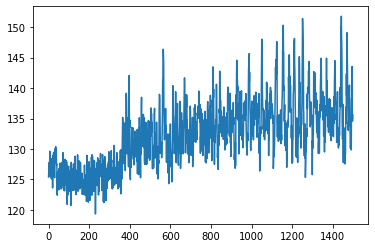

Episode 440, episode return -163.3, last 20 avg -56.6


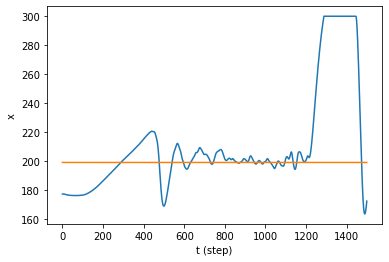

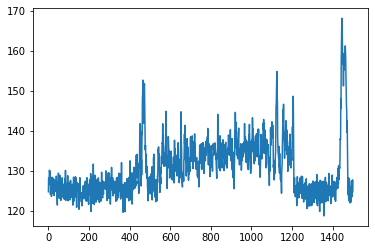

Episode 441, episode return -48.4, last 20 avg -56.7


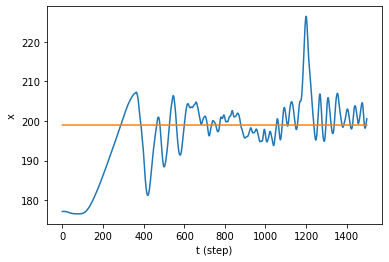

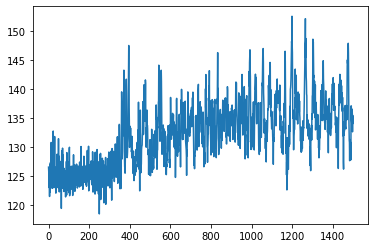

Episode 442, episode return -44.2, last 20 avg -56.6


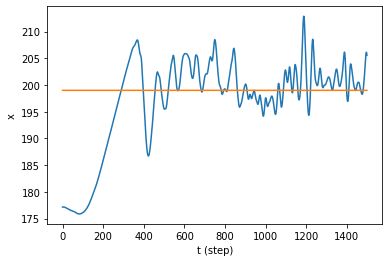

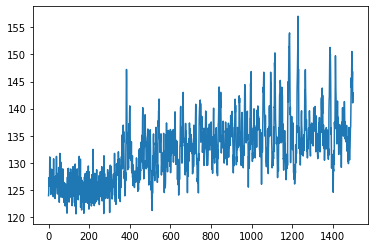

Episode 443, episode return -43.6, last 20 avg -55.5


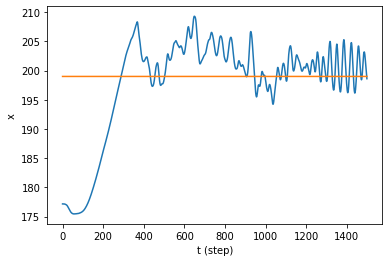

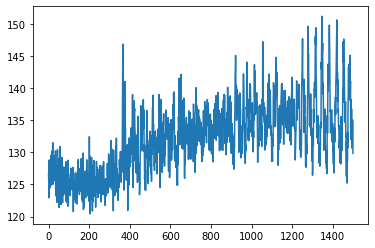

Episode 444, episode return -44.0, last 20 avg -54.9


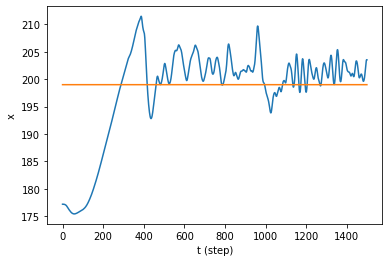

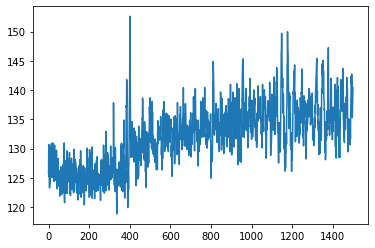

Episode 445, episode return -47.2, last 20 avg -55.0


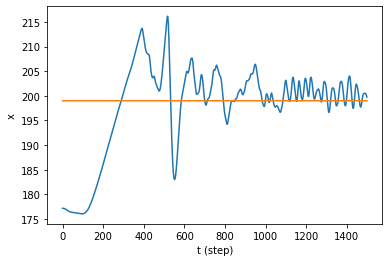

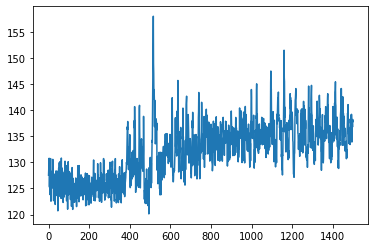

Episode 446, episode return -46.1, last 20 avg -55.1


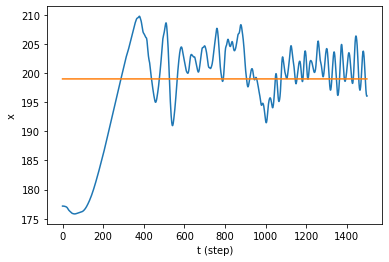

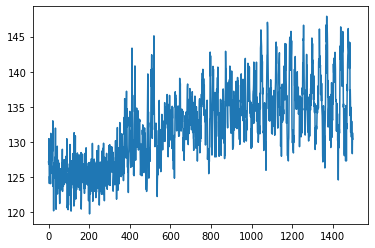

Episode 447, episode return -48.8, last 20 avg -53.2


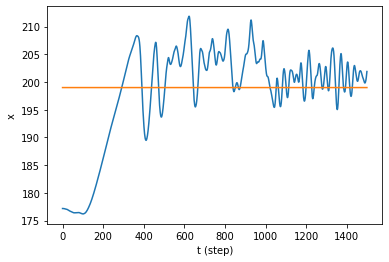

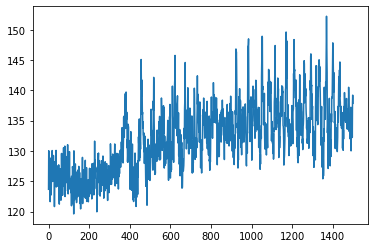

Episode 448, episode return -45.1, last 20 avg -53.4


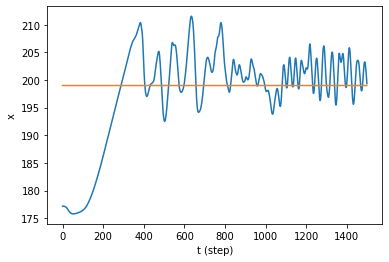

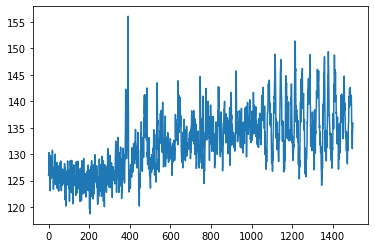

Episode 449, episode return -47.0, last 20 avg -53.3


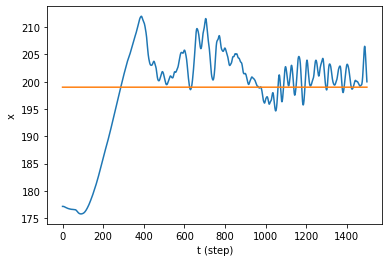

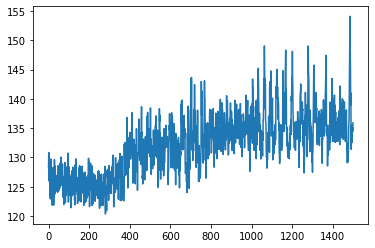

Episode 450, episode return -47.7, last 20 avg -53.4


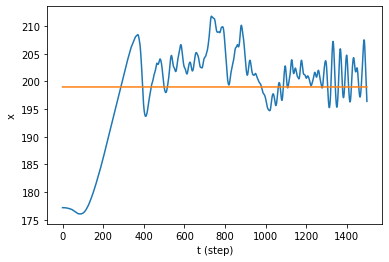

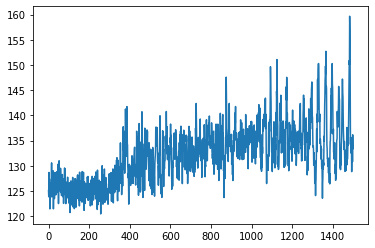

Episode 451, episode return -47.3, last 20 avg -53.2


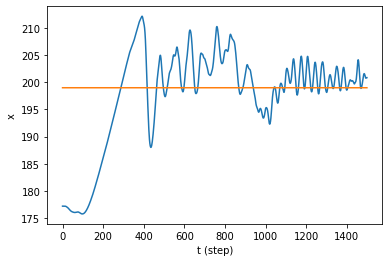

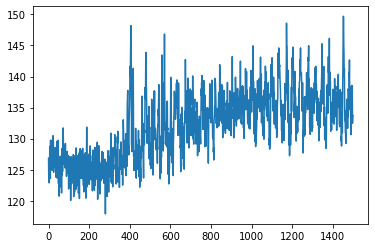

Episode 452, episode return -46.3, last 20 avg -53.1


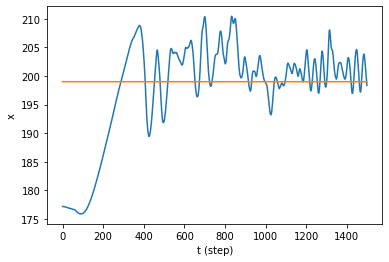

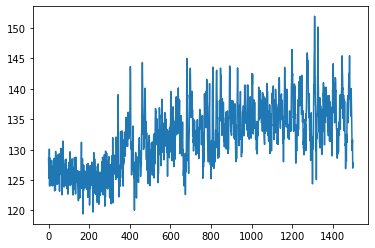

Episode 453, episode return -106.6, last 20 avg -55.7


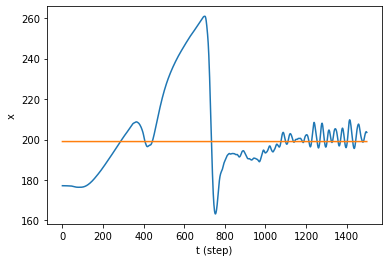

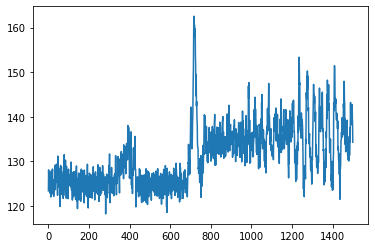

Episode 454, episode return -44.8, last 20 avg -55.6


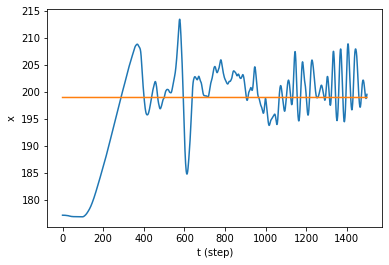

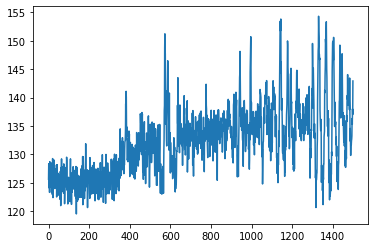

Episode 455, episode return -43.1, last 20 avg -55.4


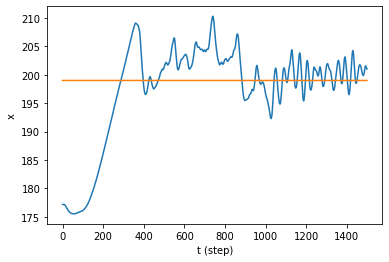

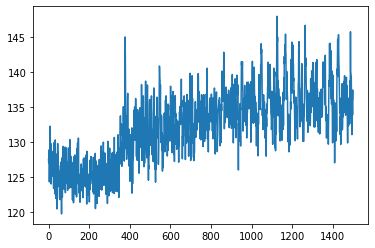

Episode 456, episode return -44.1, last 20 avg -55.0


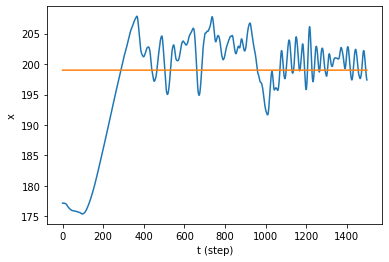

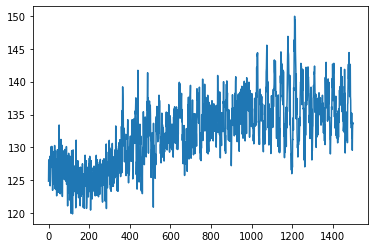

Episode 457, episode return -43.9, last 20 avg -54.8


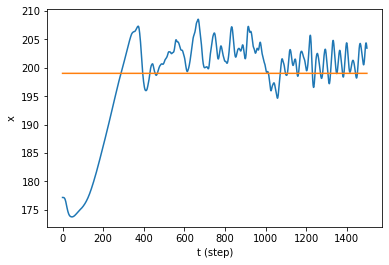

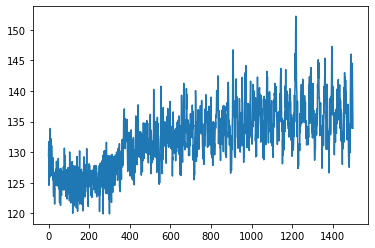

Episode 458, episode return -53.2, last 20 avg -54.9


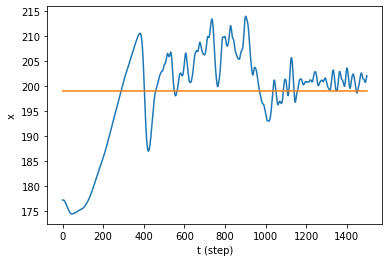

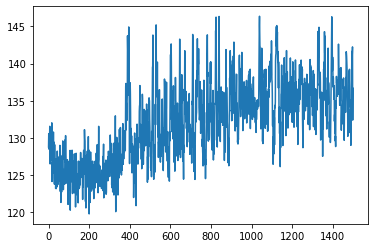

Episode 459, episode return -52.1, last 20 avg -55.3


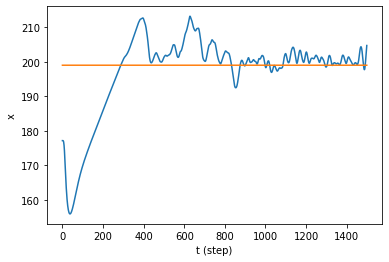

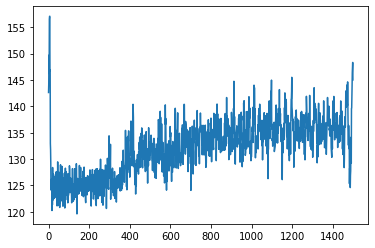

Episode 460, episode return -56.7, last 20 avg -50.0


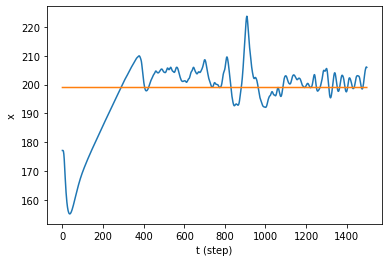

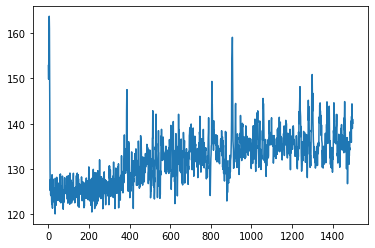

Episode 461, episode return -42.8, last 20 avg -49.7


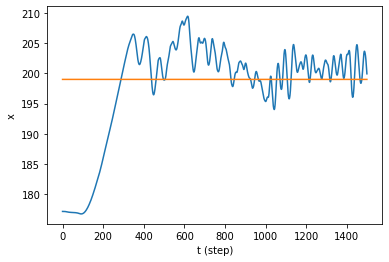

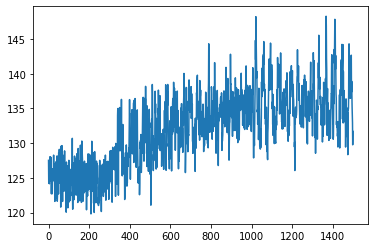

Episode 462, episode return -48.6, last 20 avg -49.9


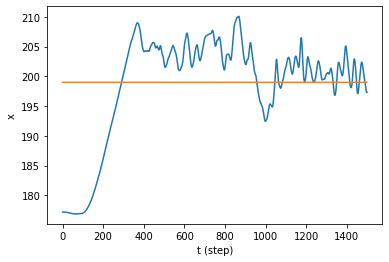

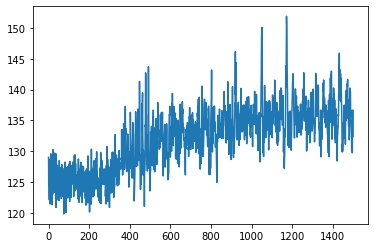

Episode 463, episode return -47.6, last 20 avg -50.2


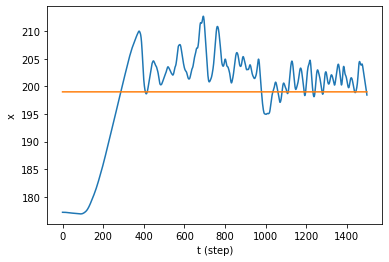

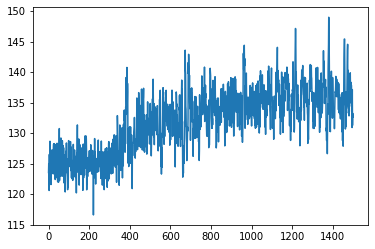

Episode 464, episode return -62.6, last 20 avg -51.1


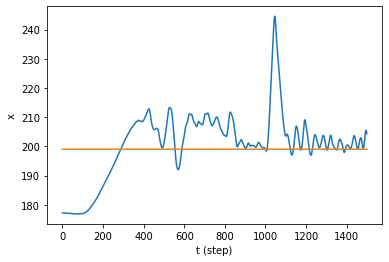

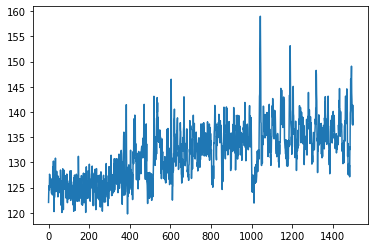

Episode 465, episode return -51.6, last 20 avg -51.3


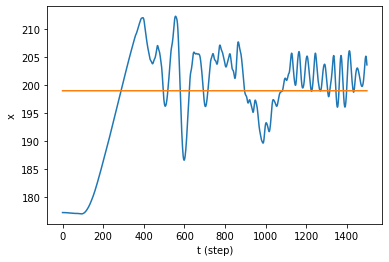

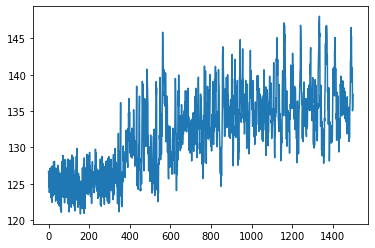

Episode 466, episode return -45.7, last 20 avg -51.3


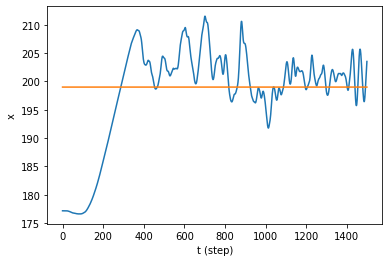

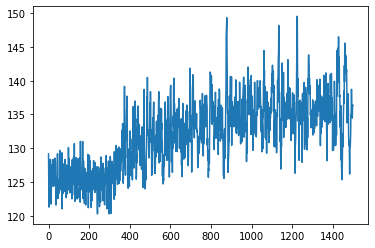

Episode 467, episode return -42.2, last 20 avg -50.9


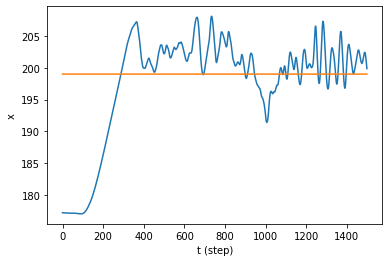

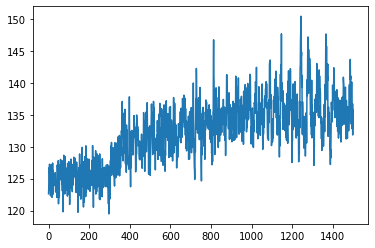

Episode 468, episode return -49.7, last 20 avg -51.2


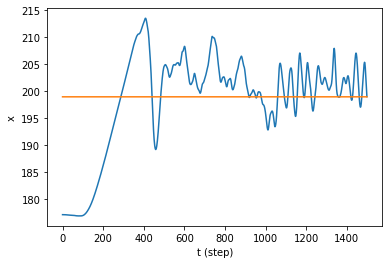

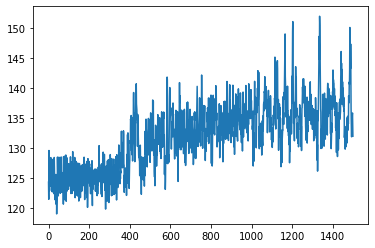

Episode 469, episode return -53.5, last 20 avg -51.5


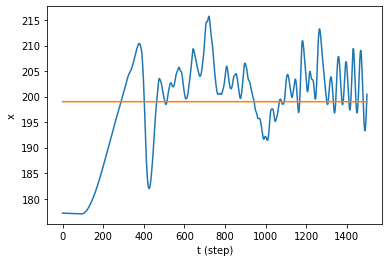

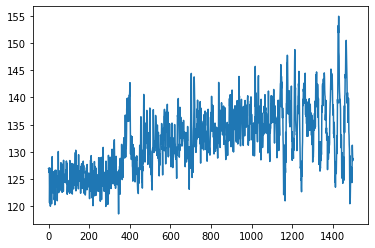

Episode 470, episode return -60.0, last 20 avg -52.1


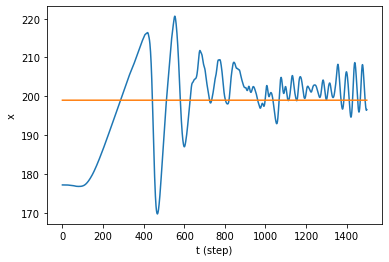

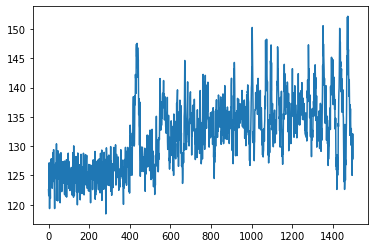

Episode 471, episode return -52.5, last 20 avg -52.4


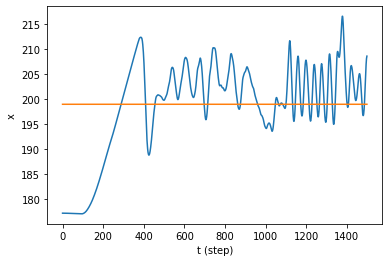

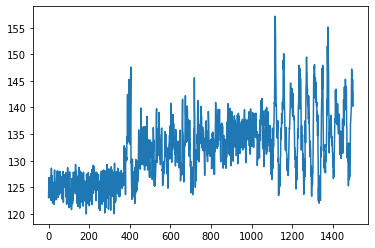

Episode 472, episode return -129.8, last 20 avg -56.5


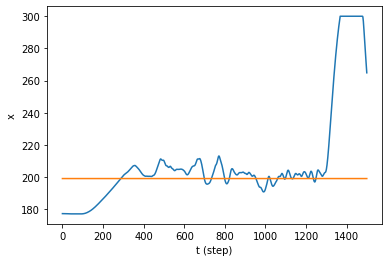

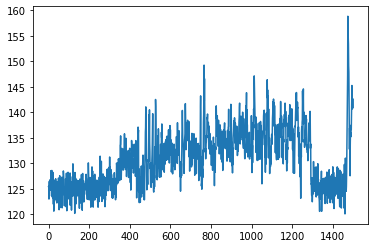

Episode 473, episode return -40.9, last 20 avg -53.3


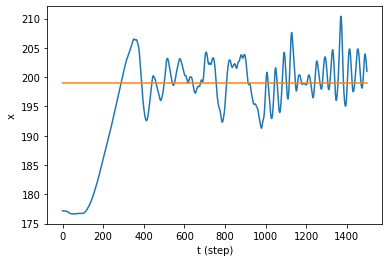

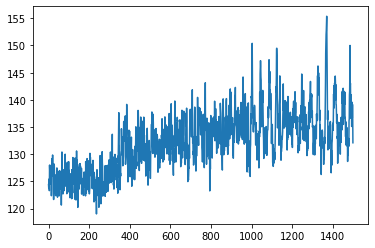

Episode 474, episode return -51.5, last 20 avg -53.6


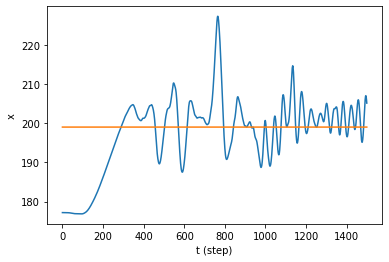

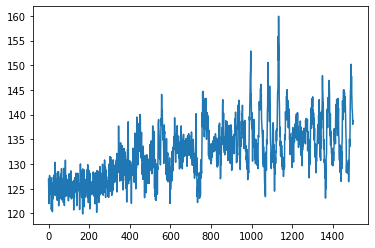

Episode 475, episode return -47.3, last 20 avg -53.8


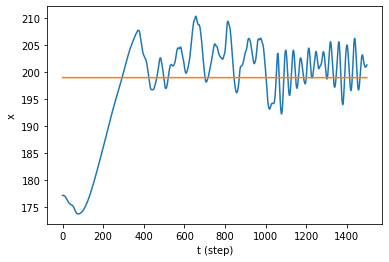

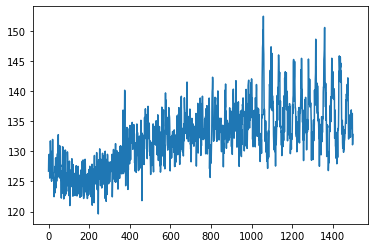

Episode 476, episode return -46.5, last 20 avg -53.9


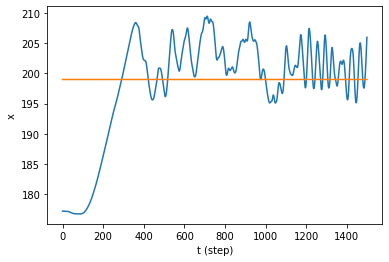

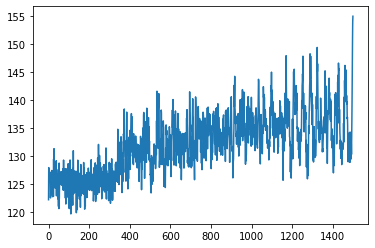

Episode 477, episode return -64.1, last 20 avg -54.9


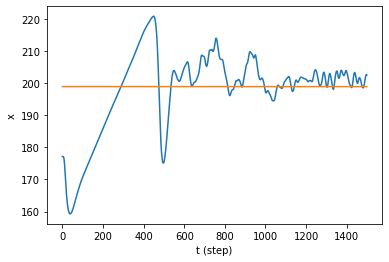

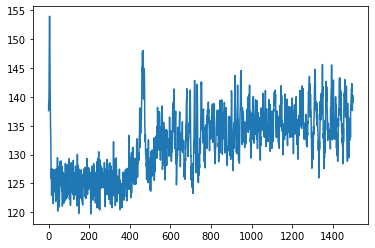

Episode 478, episode return -57.6, last 20 avg -55.2


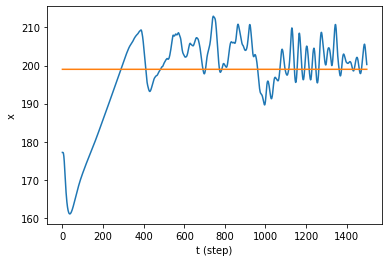

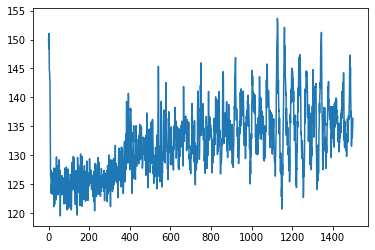

Episode 479, episode return -49.1, last 20 avg -55.0


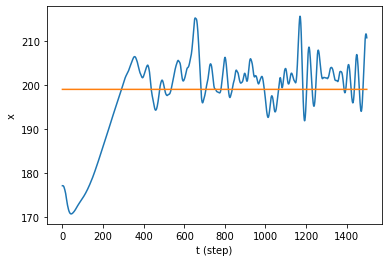

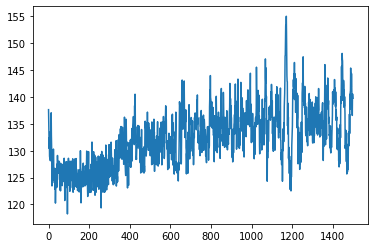

Episode 480, episode return -51.8, last 20 avg -54.8


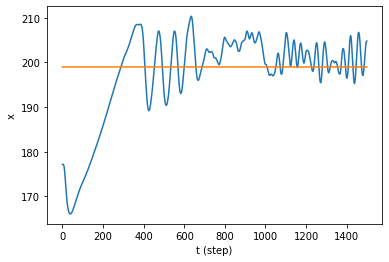

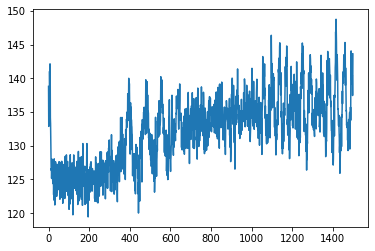

Episode 481, episode return -55.6, last 20 avg -55.4


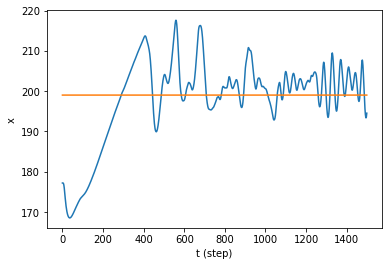

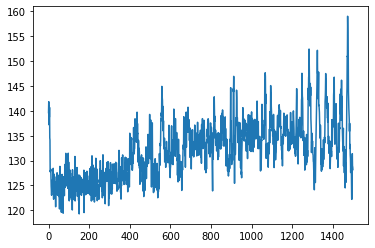

Episode 482, episode return -56.0, last 20 avg -55.8


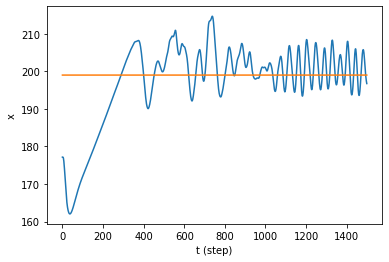

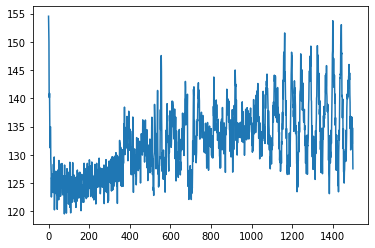

Episode 483, episode return -59.8, last 20 avg -56.4


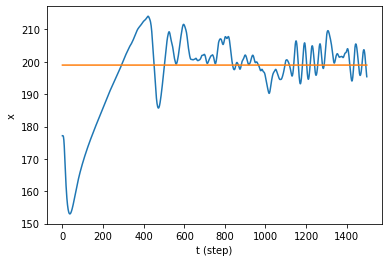

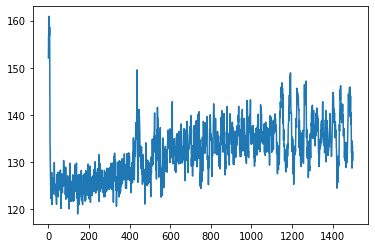

Episode 484, episode return -54.1, last 20 avg -56.0


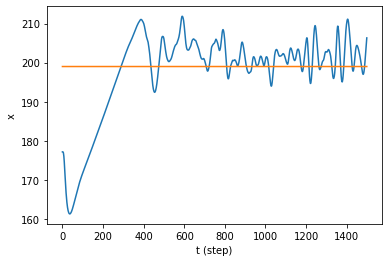

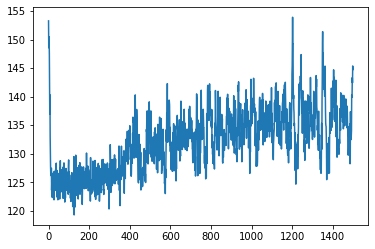

Episode 485, episode return -124.1, last 20 avg -59.6


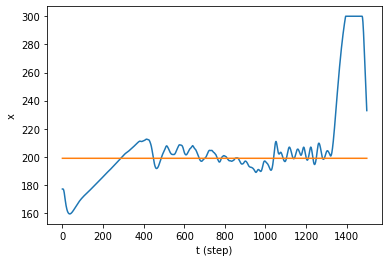

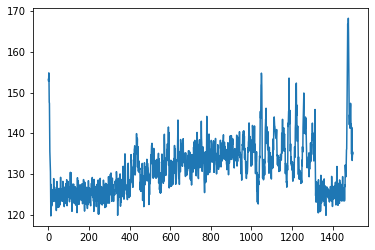

Episode 486, episode return -49.6, last 20 avg -59.8


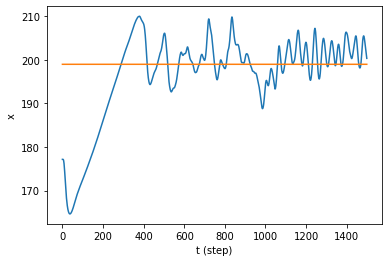

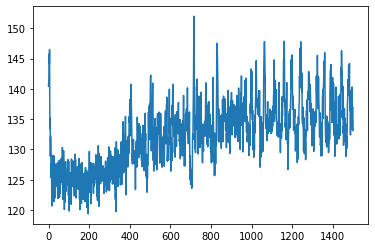

Episode 487, episode return -55.2, last 20 avg -60.4


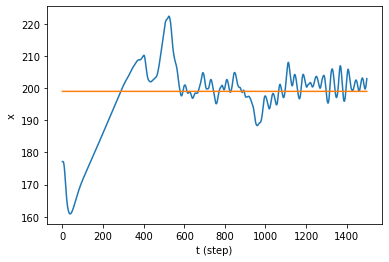

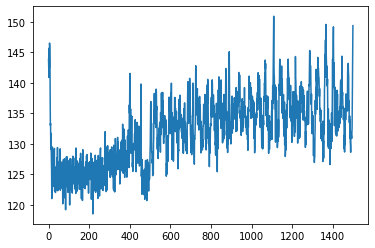

Episode 488, episode return -69.9, last 20 avg -61.4


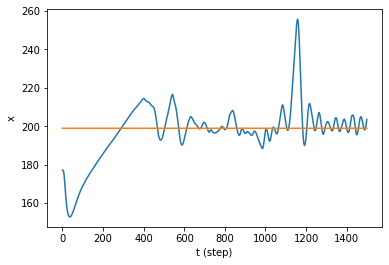

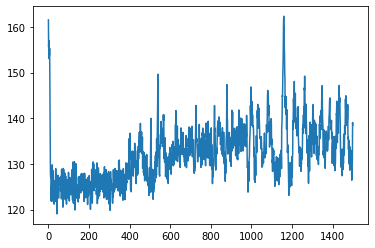

Episode 489, episode return -61.3, last 20 avg -61.8


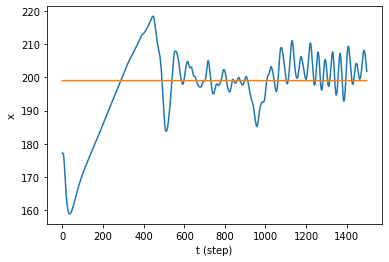

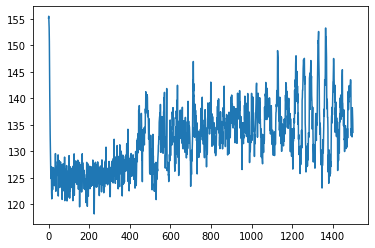

Episode 490, episode return -58.1, last 20 avg -61.7


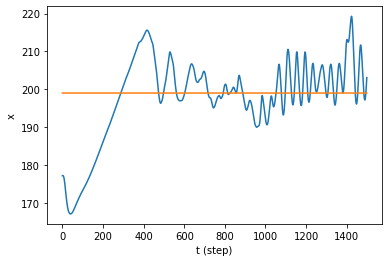

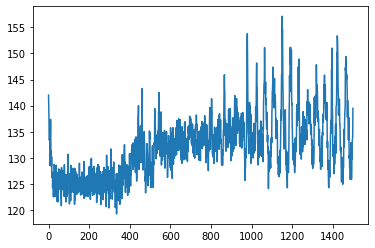

Episode 491, episode return -235.2, last 20 avg -70.9


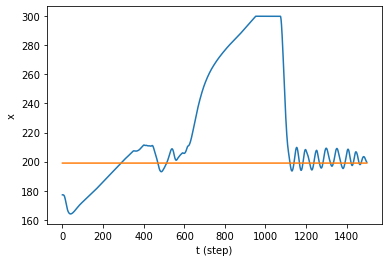

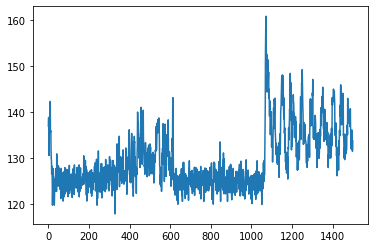

Episode 492, episode return -64.9, last 20 avg -67.6


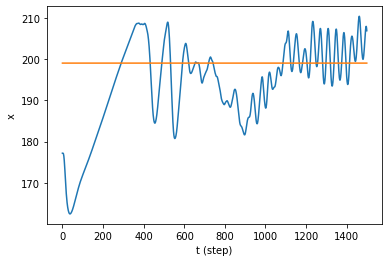

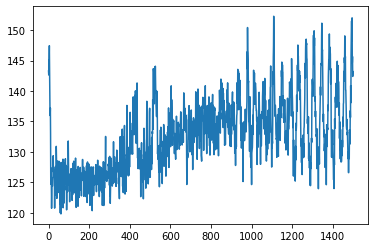

Episode 493, episode return -57.5, last 20 avg -68.5


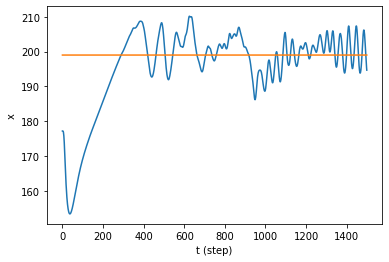

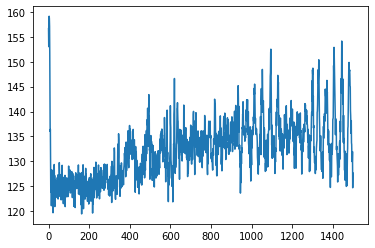

Episode 494, episode return -56.7, last 20 avg -68.7


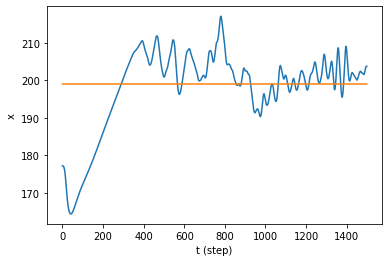

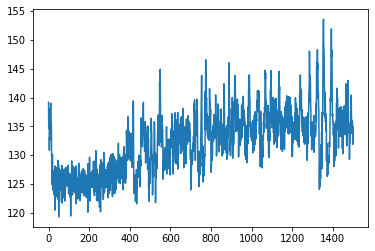

Episode 495, episode return -137.4, last 20 avg -73.2


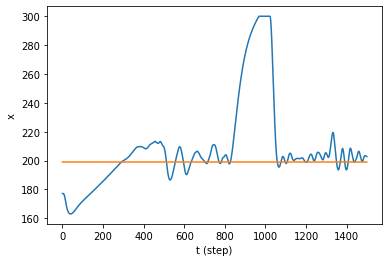

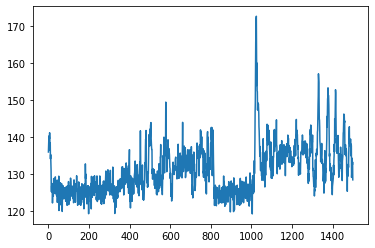

Episode 496, episode return -76.3, last 20 avg -74.7


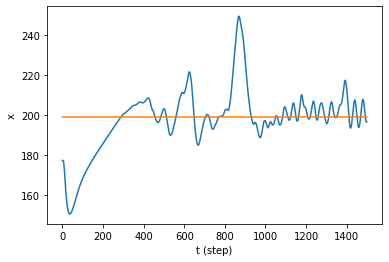

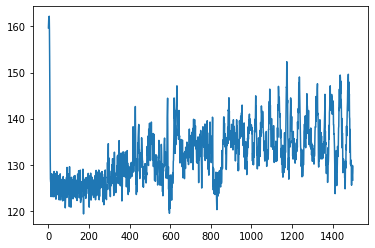

Episode 497, episode return -58.1, last 20 avg -74.4


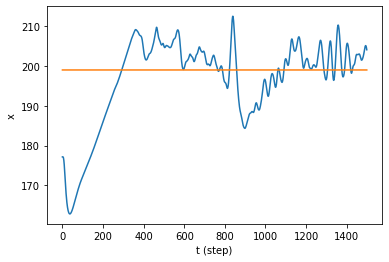

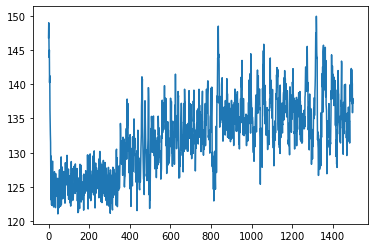

Episode 498, episode return -63.8, last 20 avg -74.7


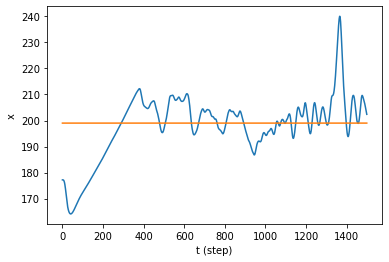

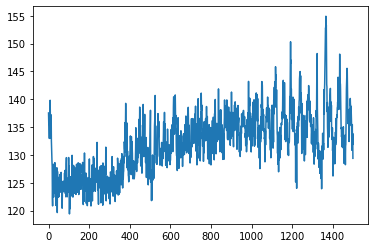

Episode 499, episode return -111.7, last 20 avg -77.8


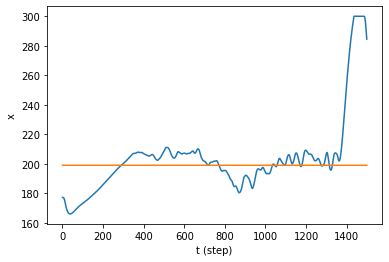

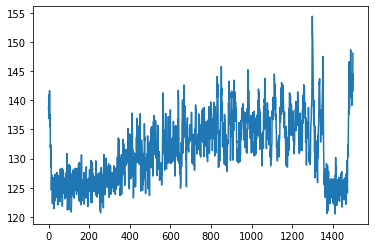

Episode 500, episode return -53.9, last 20 avg -77.9


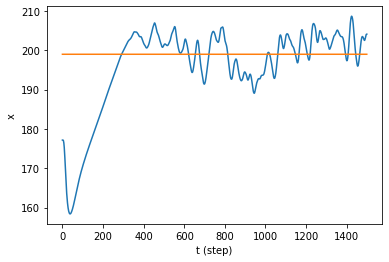

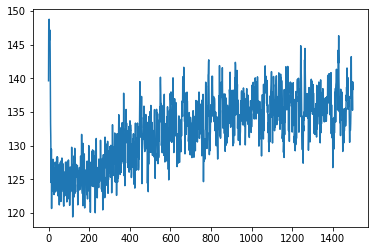

Episode 501, episode return -67.6, last 20 avg -78.5


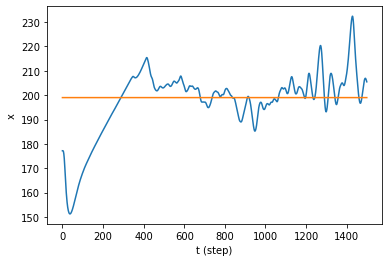

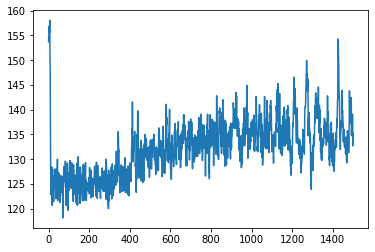

Episode 502, episode return -60.6, last 20 avg -78.8


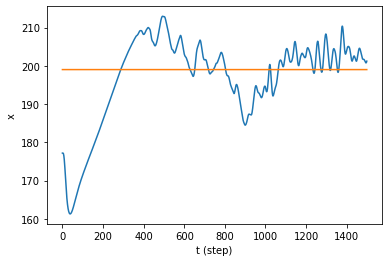

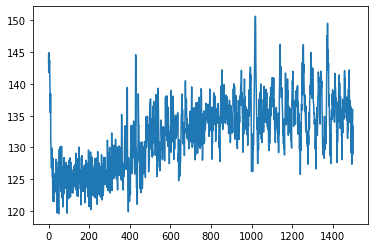

Episode 503, episode return -58.1, last 20 avg -78.7


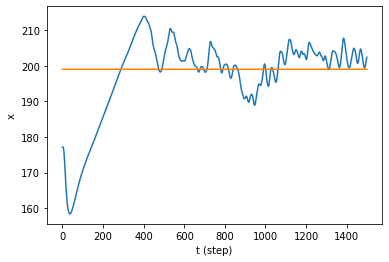

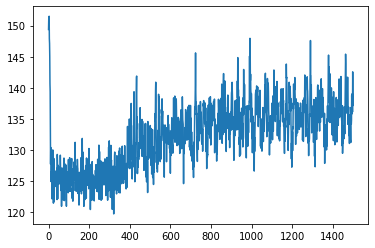

Episode 504, episode return -101.0, last 20 avg -81.0


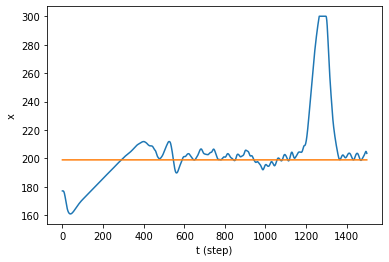

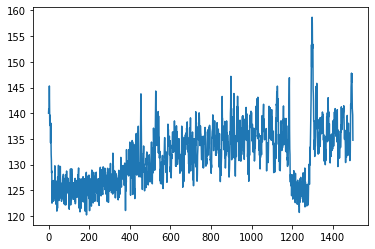

Episode 505, episode return -191.1, last 20 avg -84.4


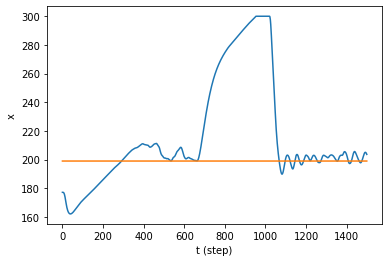

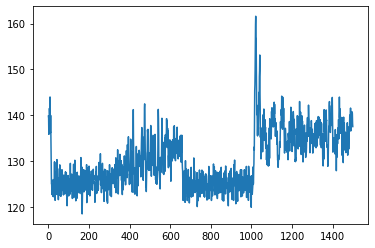

Episode 506, episode return -69.3, last 20 avg -85.4


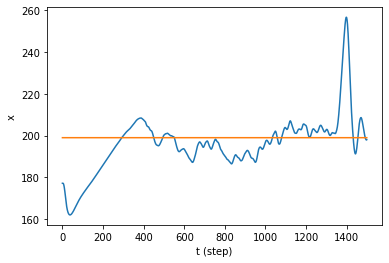

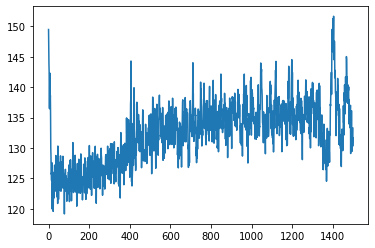

Episode 507, episode return -53.1, last 20 avg -85.3


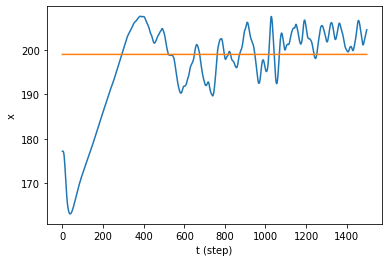

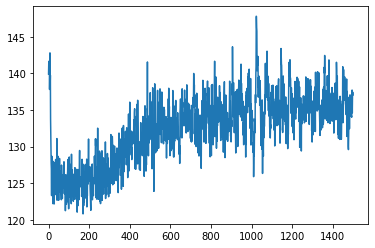

Episode 508, episode return -129.7, last 20 avg -88.3


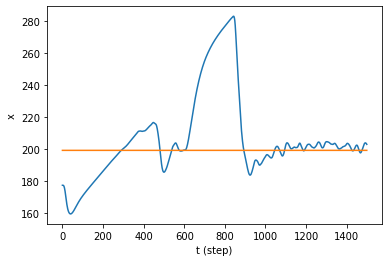

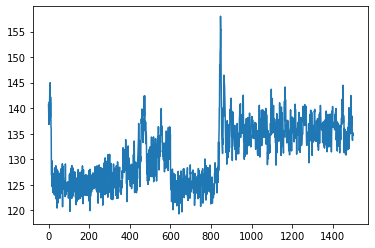

Episode 509, episode return -84.3, last 20 avg -89.4


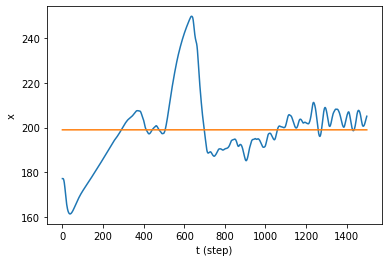

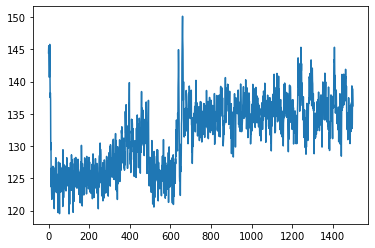

Episode 510, episode return -57.2, last 20 avg -89.4


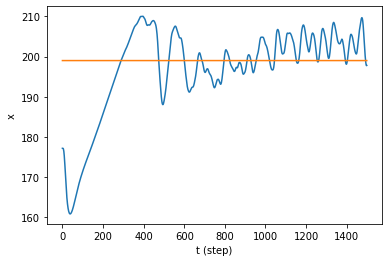

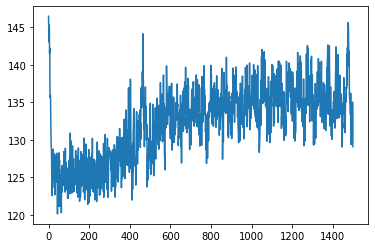

Episode 511, episode return -62.5, last 20 avg -80.7


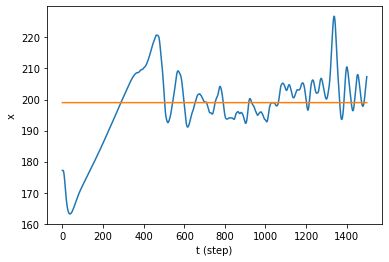

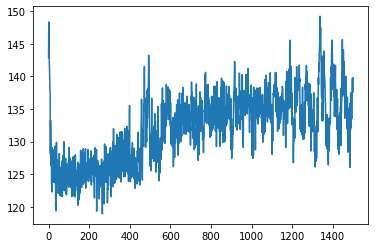

Episode 512, episode return -54.5, last 20 avg -80.2


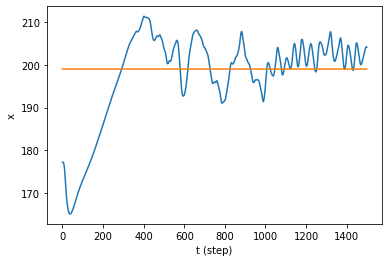

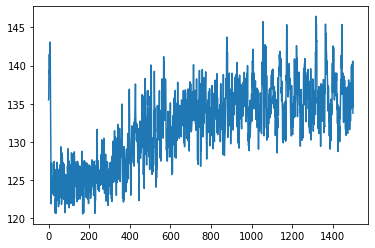

Episode 513, episode return -191.0, last 20 avg -86.9


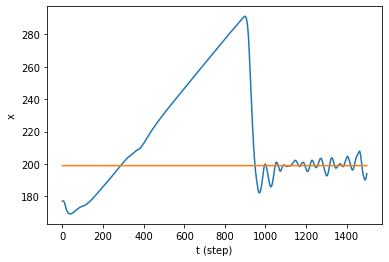

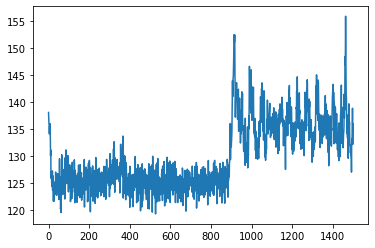

Episode 514, episode return -56.8, last 20 avg -86.9


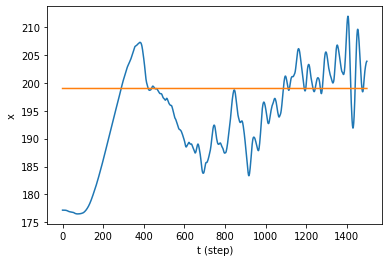

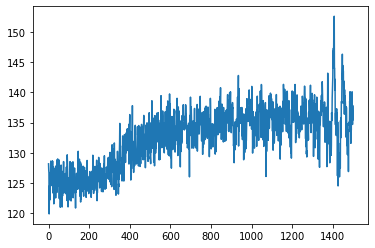

Episode 515, episode return -56.3, last 20 avg -82.8


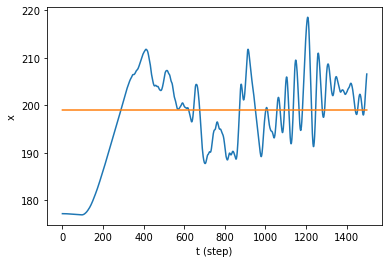

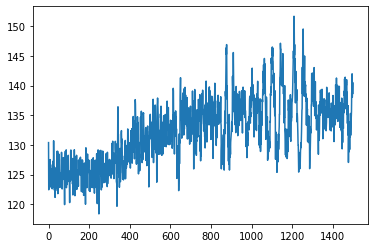

Episode 516, episode return -54.4, last 20 avg -81.7


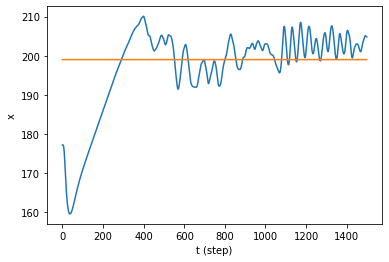

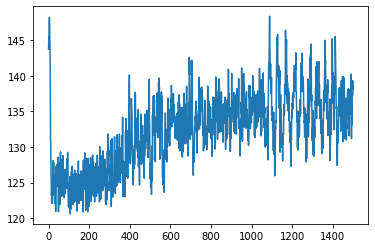

Episode 517, episode return -53.8, last 20 avg -81.5


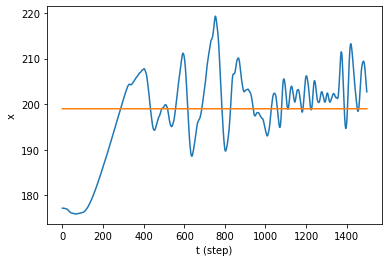

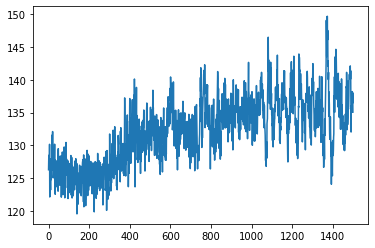

Episode 518, episode return -56.6, last 20 avg -81.2


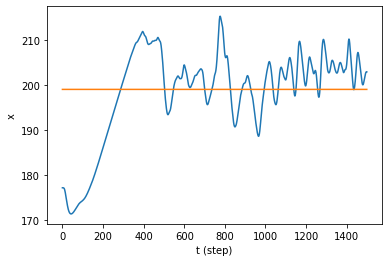

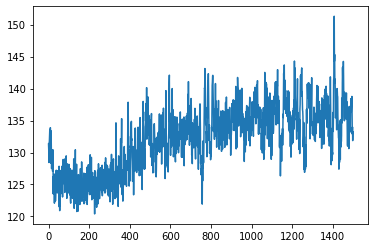

Episode 519, episode return -73.4, last 20 avg -79.3


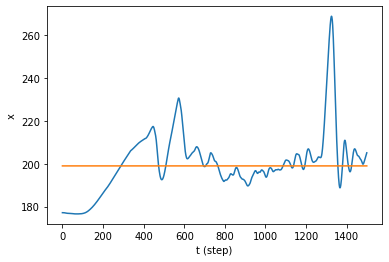

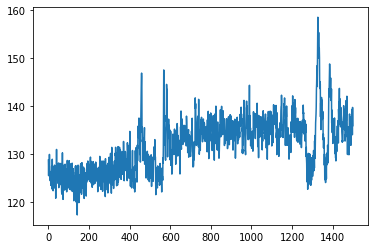

Episode 520, episode return -49.7, last 20 avg -79.1


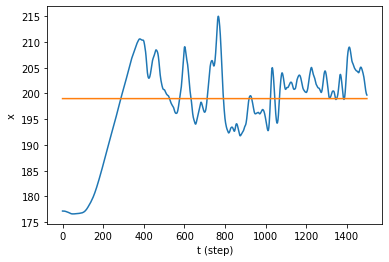

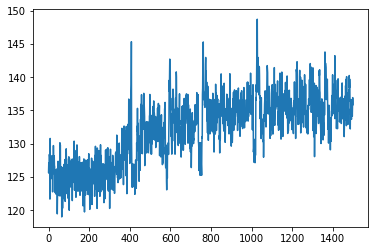

Episode 521, episode return -54.5, last 20 avg -78.4


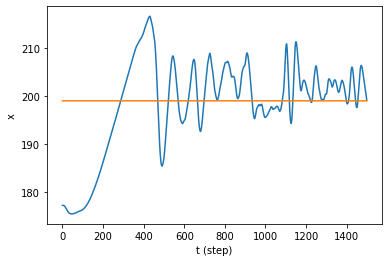

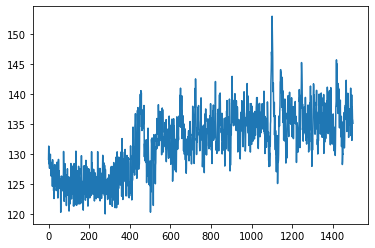

Episode 522, episode return -53.9, last 20 avg -78.1


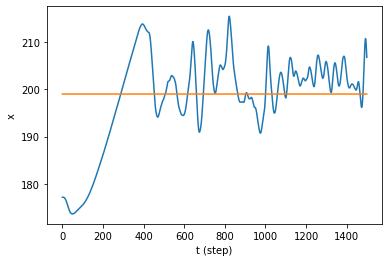

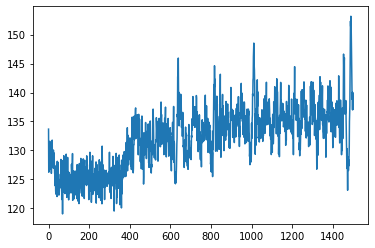

Episode 523, episode return -53.3, last 20 avg -77.8


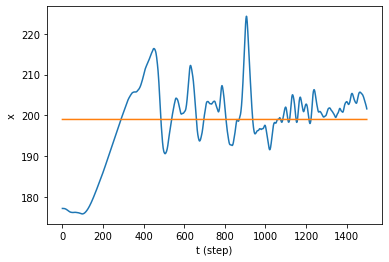

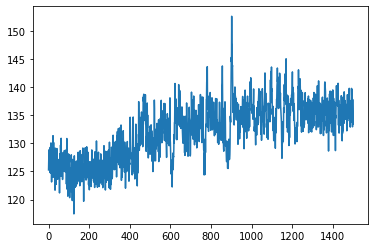

Episode 524, episode return -133.8, last 20 avg -79.5


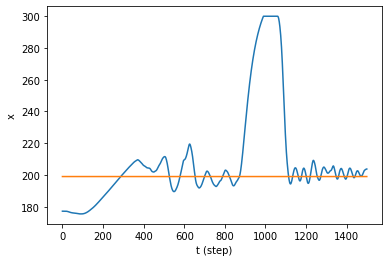

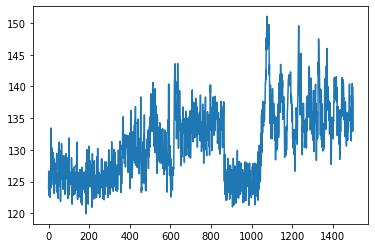

Episode 525, episode return -449.1, last 20 avg -92.4


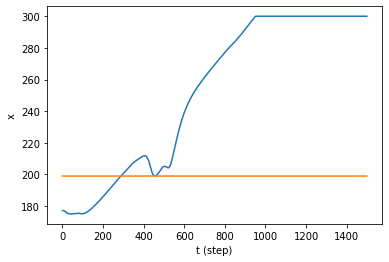

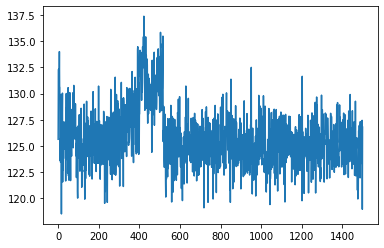

Episode 526, episode return -151.9, last 20 avg -96.5


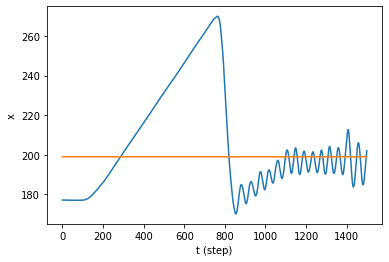

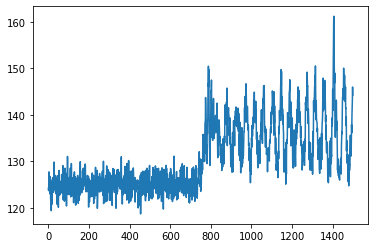

Episode 527, episode return -83.3, last 20 avg -98.0


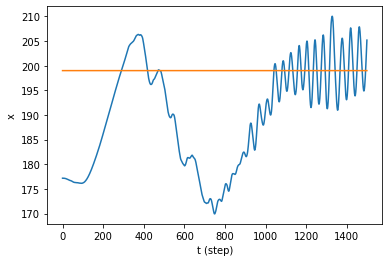

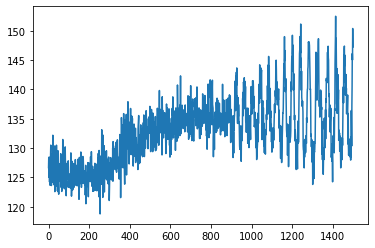

Episode 528, episode return -52.1, last 20 avg -94.1


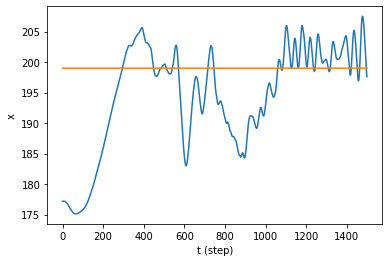

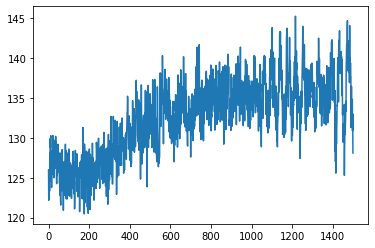

Episode 529, episode return -46.1, last 20 avg -92.2


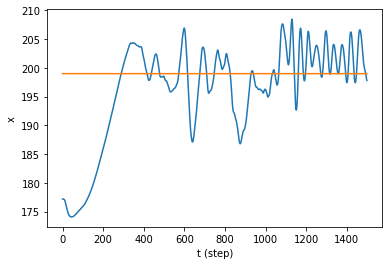

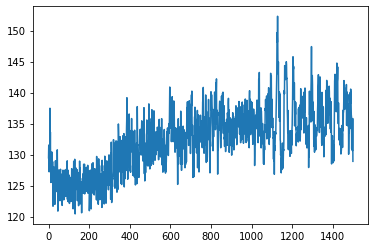

Episode 530, episode return -49.8, last 20 avg -91.8


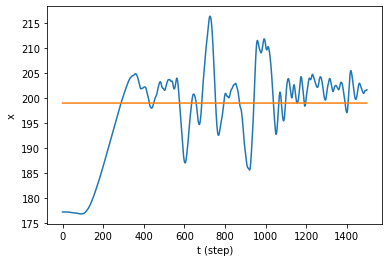

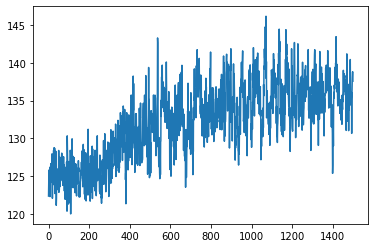

Episode 531, episode return -63.4, last 20 avg -91.9


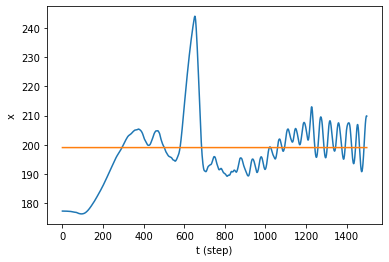

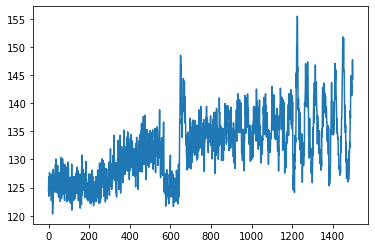

Episode 532, episode return -54.4, last 20 avg -91.9


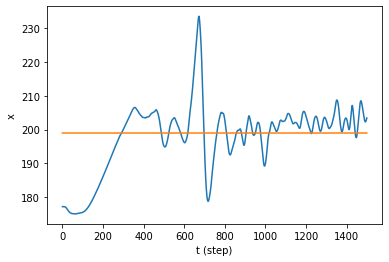

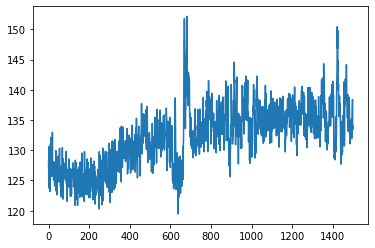

Episode 533, episode return -50.6, last 20 avg -84.9


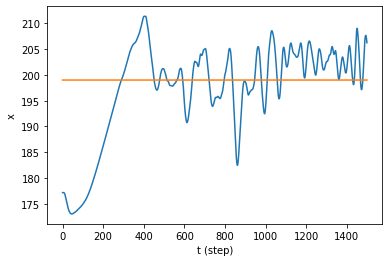

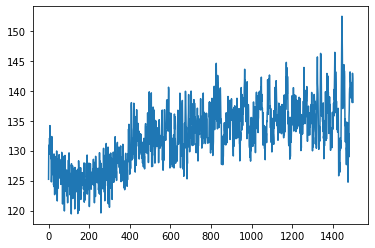

Episode 534, episode return -92.5, last 20 avg -86.7


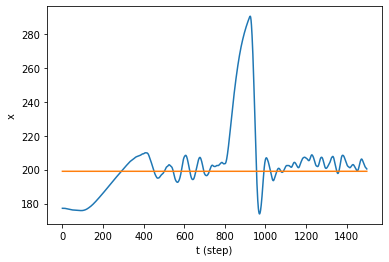

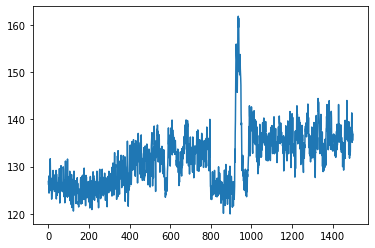

Episode 535, episode return -47.7, last 20 avg -86.2


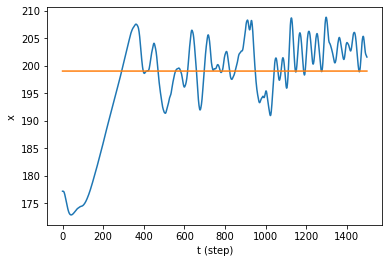

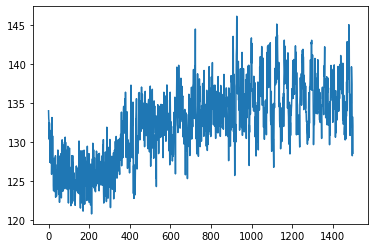

Episode 536, episode return -54.4, last 20 avg -86.2


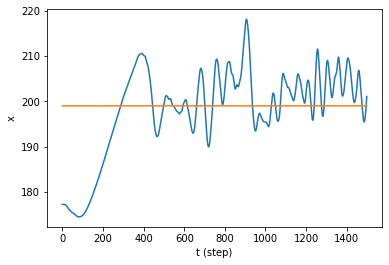

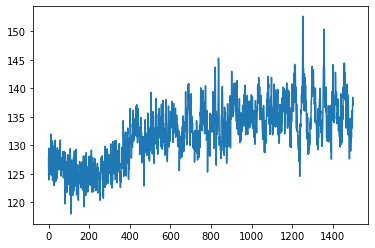

Episode 537, episode return -60.9, last 20 avg -86.6


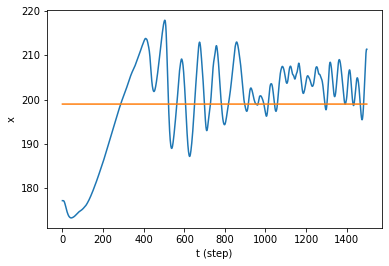

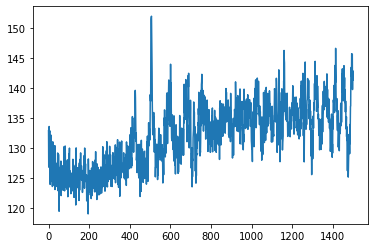

Episode 538, episode return -58.7, last 20 avg -86.7


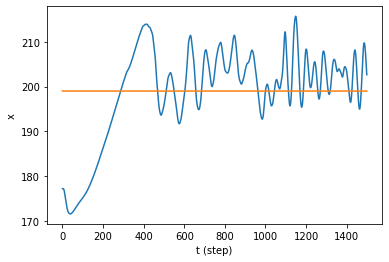

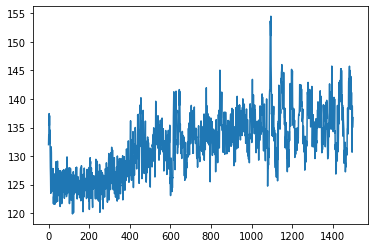

Episode 539, episode return -54.2, last 20 avg -85.7


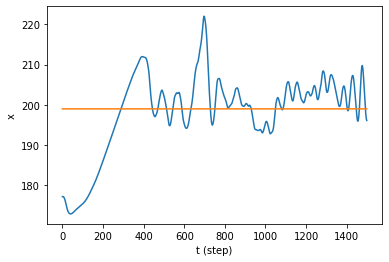

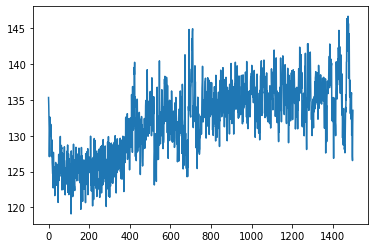

Episode 540, episode return -62.3, last 20 avg -86.4


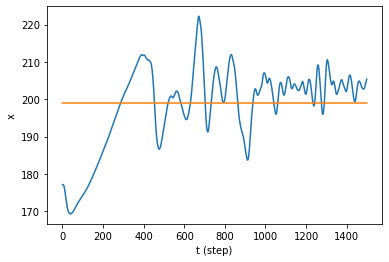

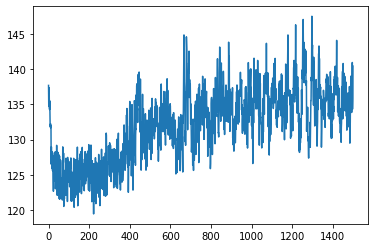

Episode 541, episode return -265.3, last 20 avg -96.9


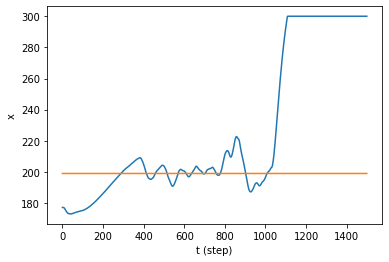

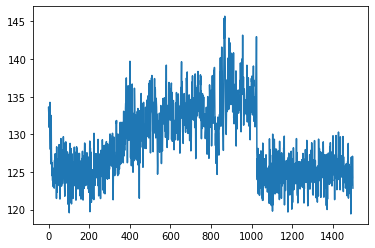

Episode 542, episode return -65.7, last 20 avg -97.5


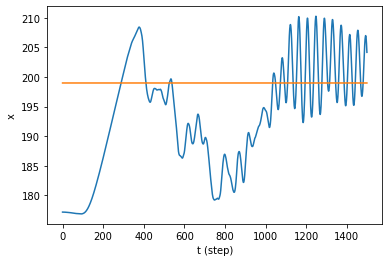

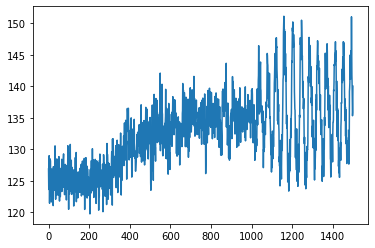

Episode 543, episode return -49.9, last 20 avg -97.3


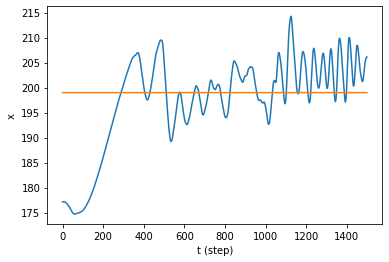

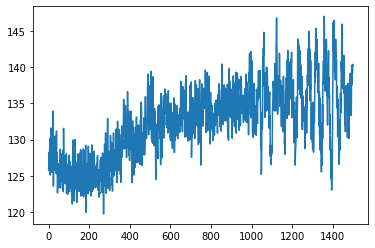

Episode 544, episode return -52.5, last 20 avg -93.2


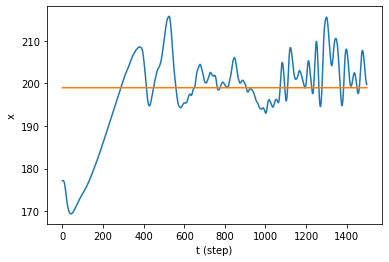

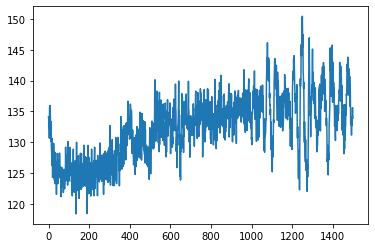

Episode 545, episode return -438.0, last 20 avg -92.7


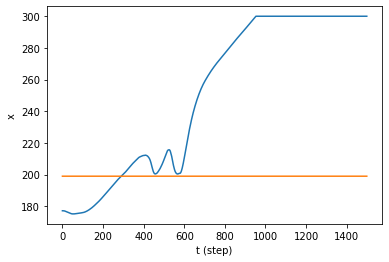

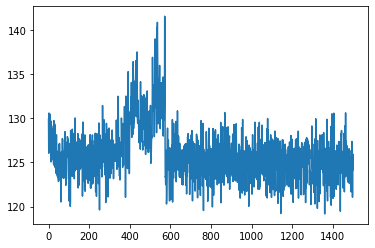

Episode 546, episode return -470.6, last 20 avg -108.6


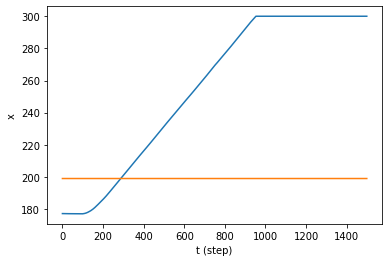

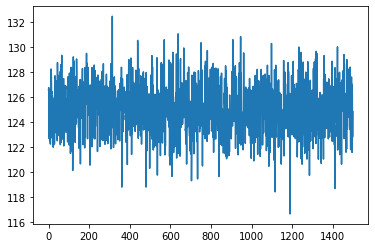

Episode 547, episode return -470.7, last 20 avg -128.0


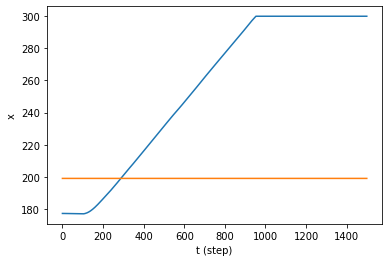

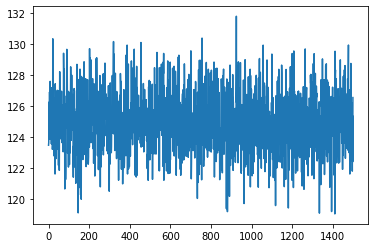

Episode 548, episode return -145.2, last 20 avg -132.7


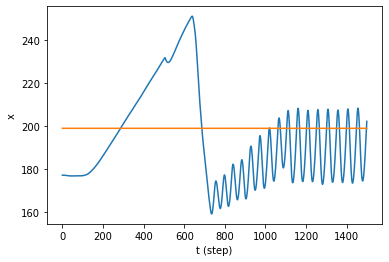

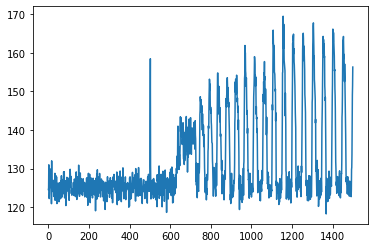

Episode 549, episode return -115.9, last 20 avg -136.1


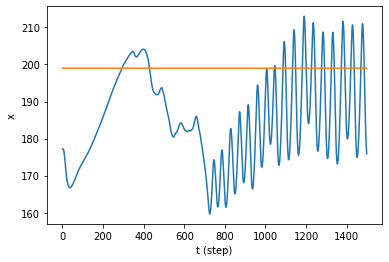

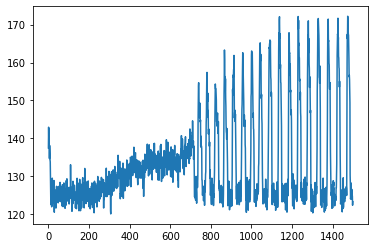

Episode 550, episode return -93.7, last 20 avg -138.3


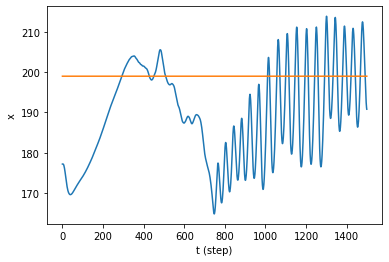

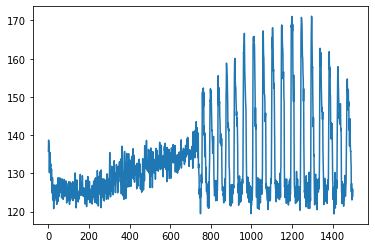

Episode 551, episode return -72.7, last 20 avg -138.8


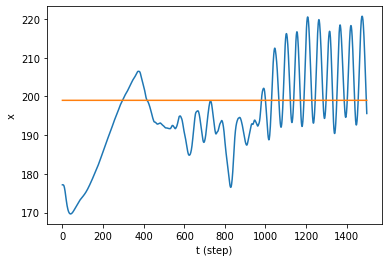

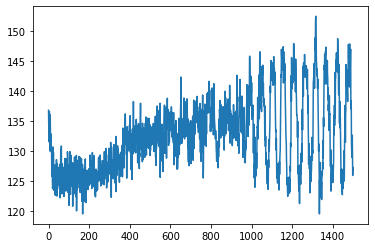

Episode 552, episode return -79.3, last 20 avg -140.0


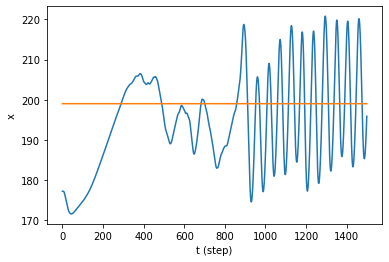

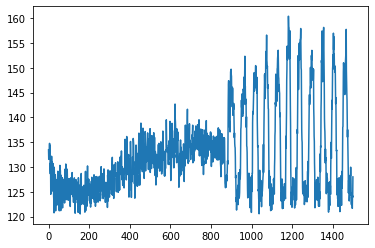

Episode 553, episode return -71.6, last 20 avg -141.1


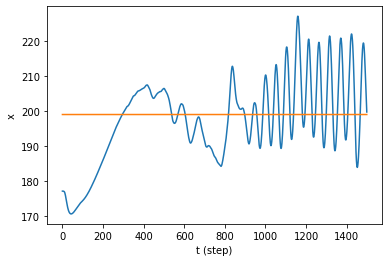

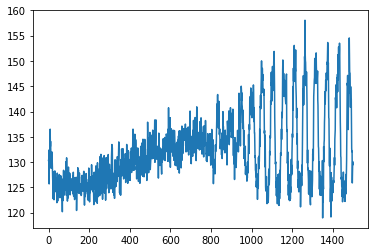

Episode 554, episode return -65.8, last 20 avg -139.8


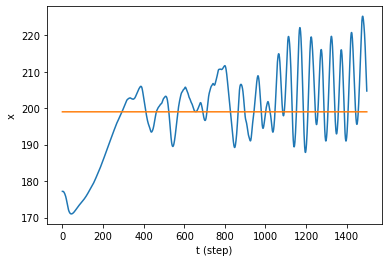

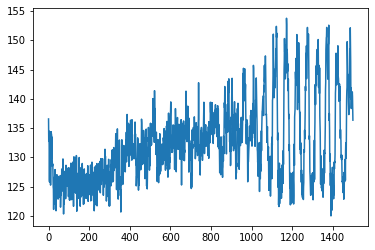

Episode 555, episode return -57.7, last 20 avg -140.3


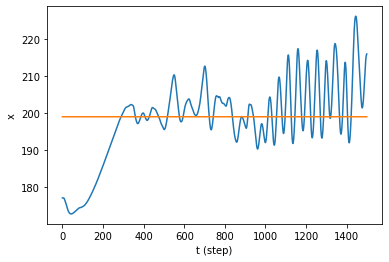

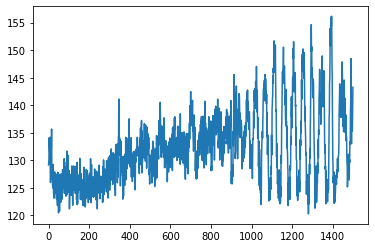

Episode 556, episode return -57.2, last 20 avg -140.4


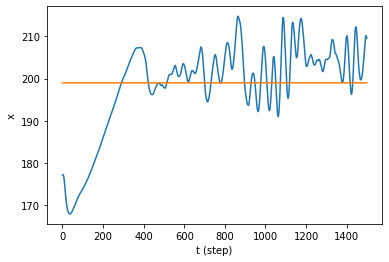

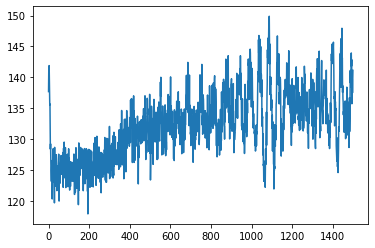

Episode 557, episode return -66.9, last 20 avg -140.7


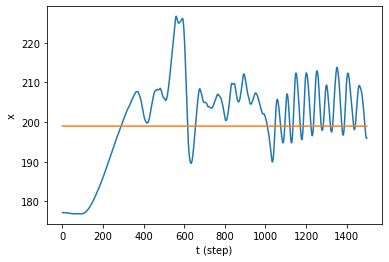

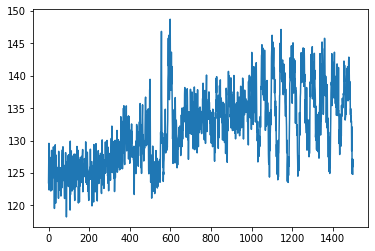

Episode 558, episode return -71.7, last 20 avg -141.3


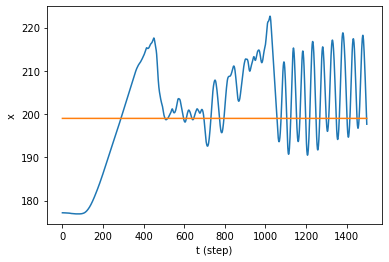

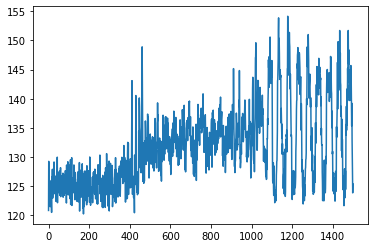

Episode 559, episode return -66.5, last 20 avg -142.0


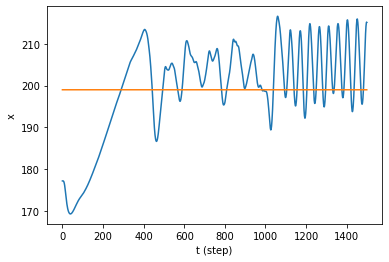

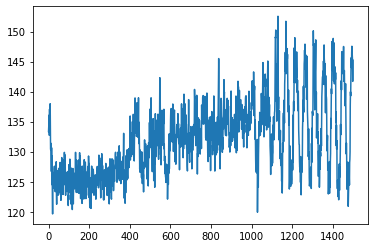

Episode 560, episode return -69.8, last 20 avg -142.3


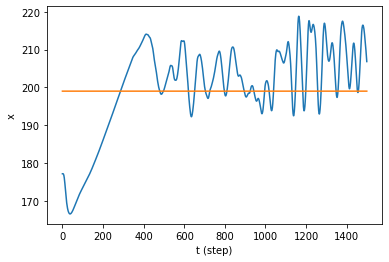

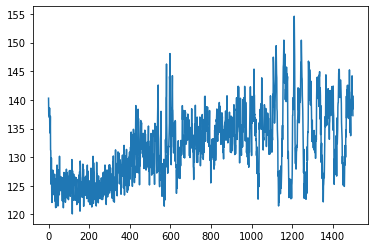

Episode 561, episode return -72.7, last 20 avg -132.7


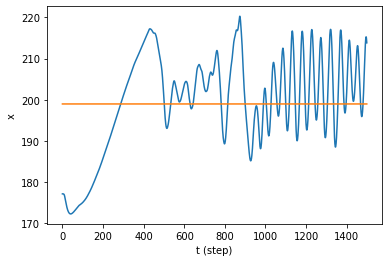

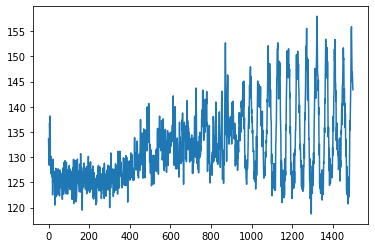

Episode 562, episode return -83.8, last 20 avg -133.6


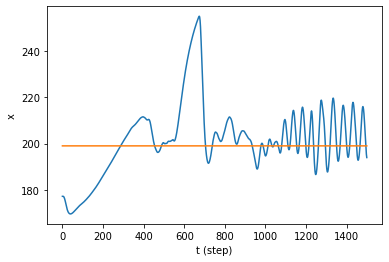

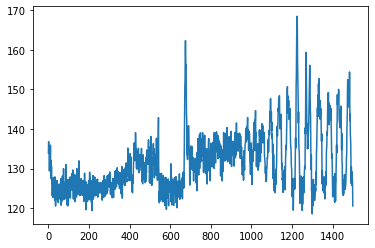

Episode 563, episode return -64.0, last 20 avg -134.3


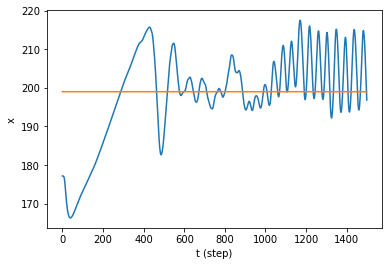

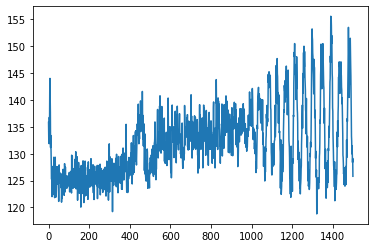

Episode 564, episode return -69.6, last 20 avg -135.2


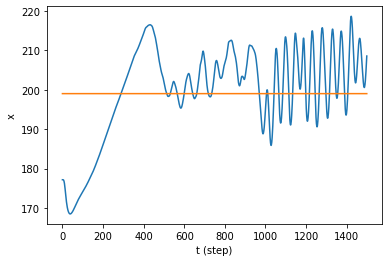

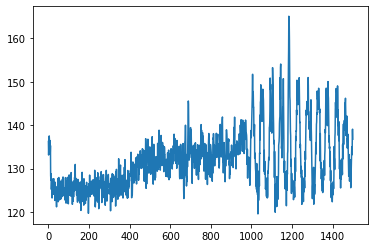

Episode 565, episode return -61.2, last 20 avg -116.3


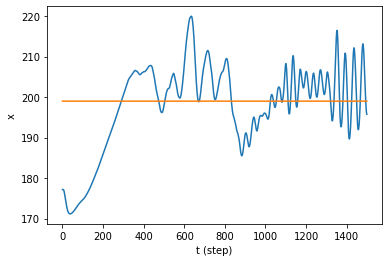

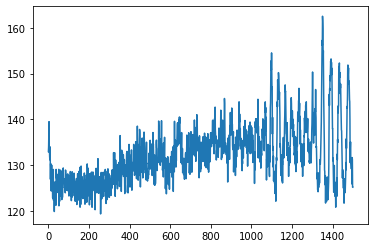

Episode 566, episode return -59.4, last 20 avg -95.8


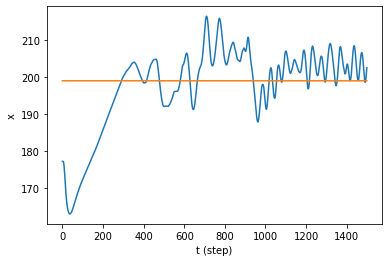

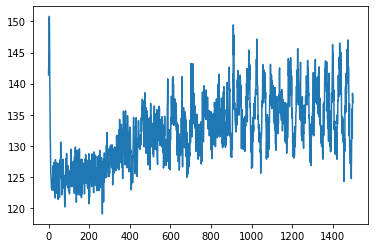

Episode 567, episode return -57.7, last 20 avg -75.1


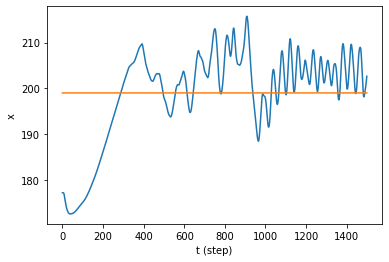

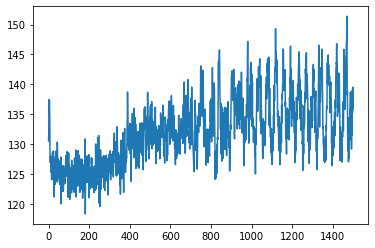

Episode 568, episode return -54.2, last 20 avg -70.6


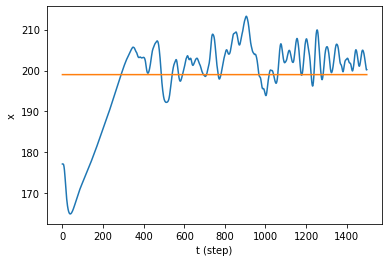

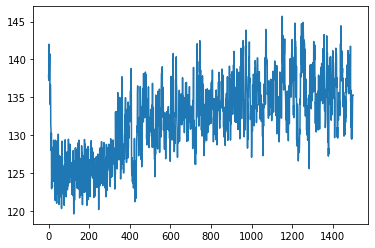

Episode 569, episode return -58.3, last 20 avg -67.7


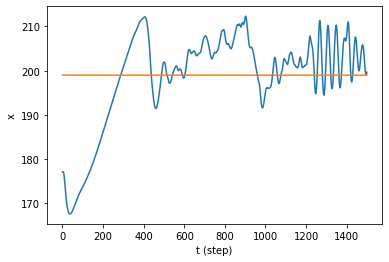

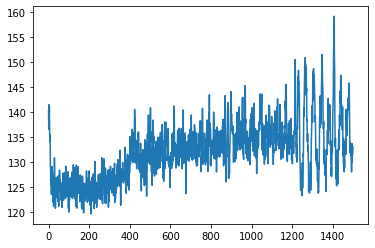

Episode 570, episode return -64.6, last 20 avg -66.2


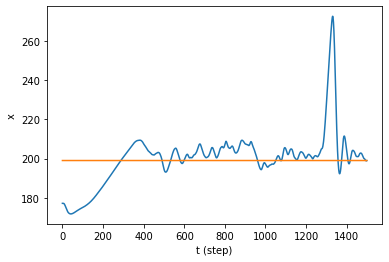

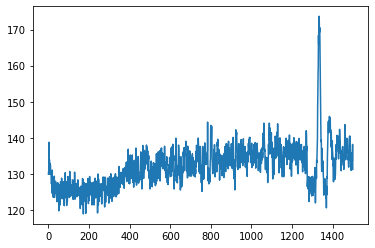

Episode 571, episode return -49.9, last 20 avg -65.1


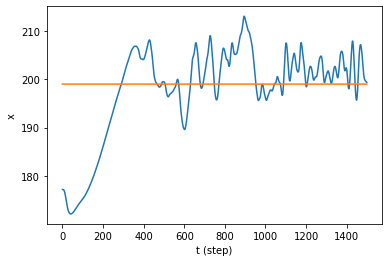

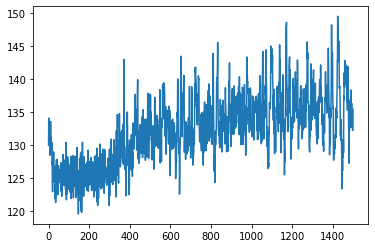

Episode 572, episode return -50.7, last 20 avg -63.7


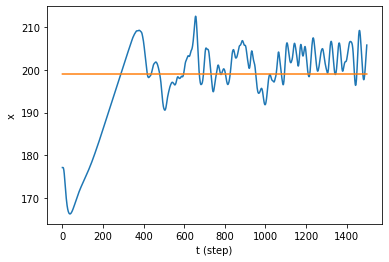

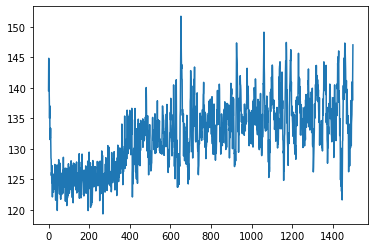

Episode 573, episode return -50.5, last 20 avg -62.6


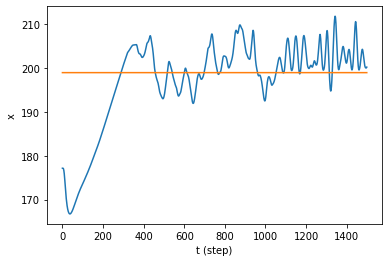

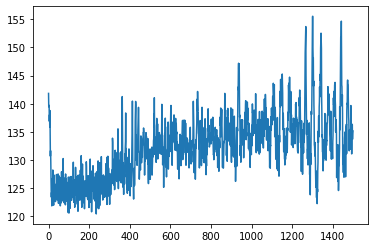

Episode 574, episode return -77.5, last 20 avg -63.2


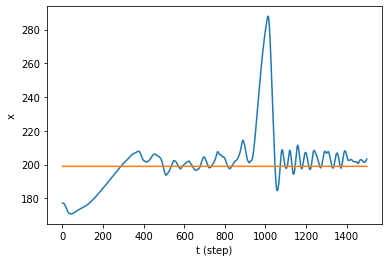

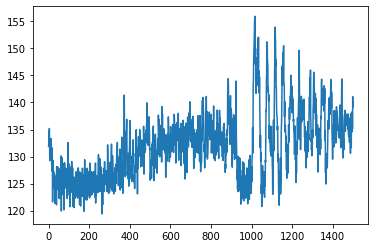

Episode 575, episode return -50.9, last 20 avg -62.9


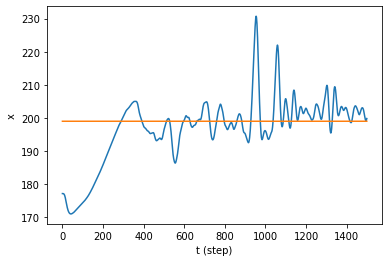

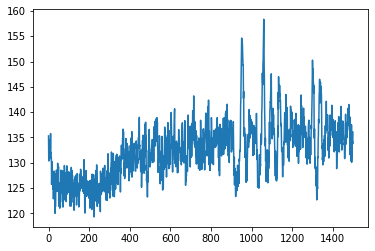

Episode 576, episode return -101.9, last 20 avg -65.1


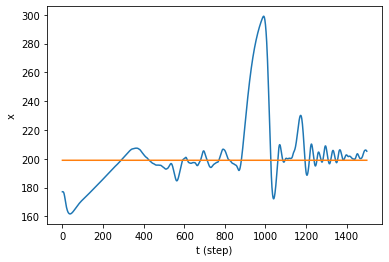

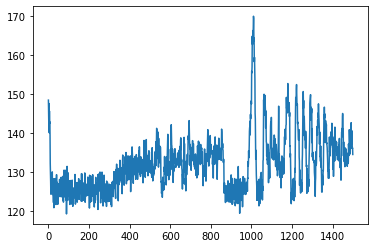

Episode 577, episode return -53.1, last 20 avg -64.4


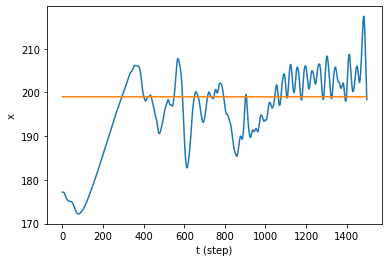

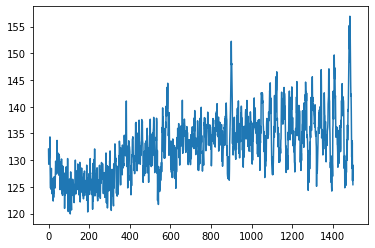

Episode 578, episode return -241.0, last 20 avg -72.9


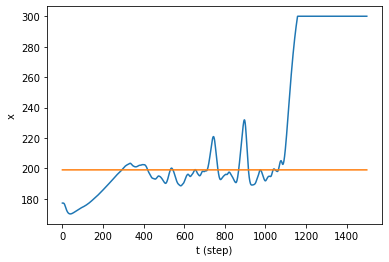

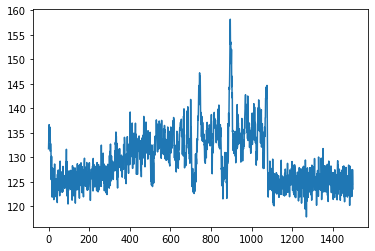

Episode 579, episode return -76.0, last 20 avg -73.3


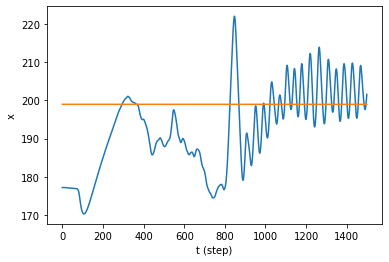

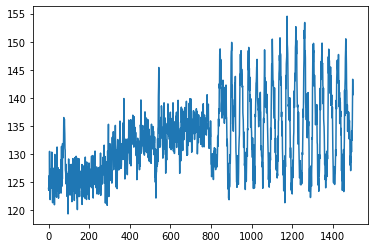

Episode 580, episode return -92.7, last 20 avg -74.5


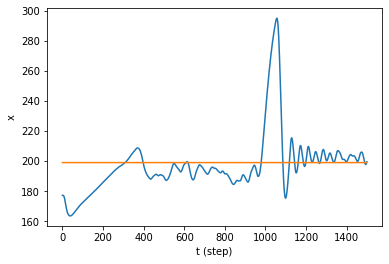

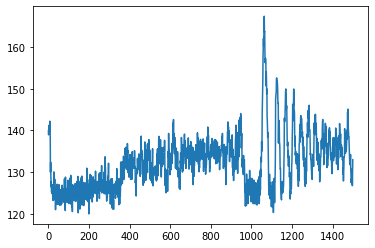

Episode 581, episode return -87.3, last 20 avg -75.2


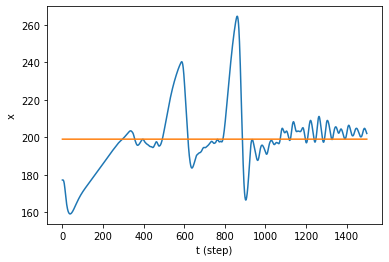

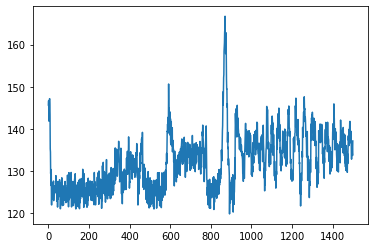

Episode 582, episode return -65.3, last 20 avg -74.3


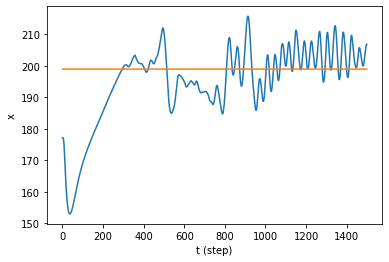

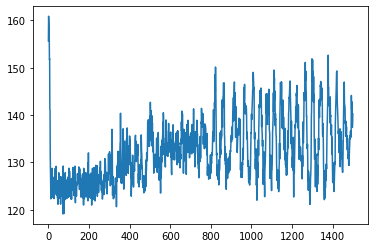

Episode 583, episode return -68.8, last 20 avg -74.5


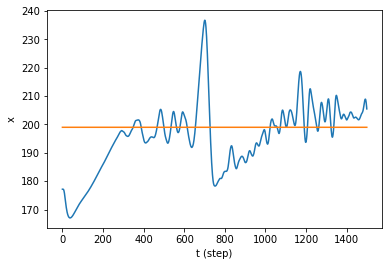

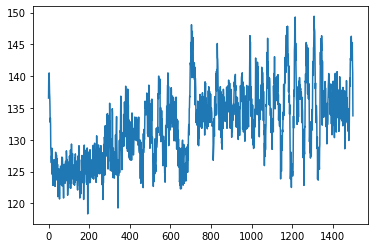

Episode 584, episode return -151.7, last 20 avg -78.6


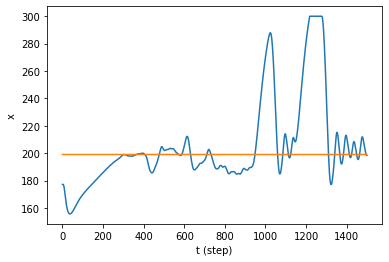

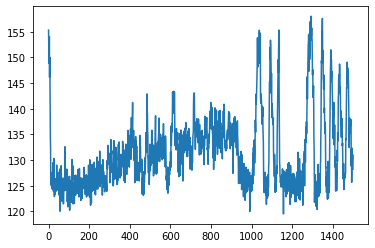

Episode 585, episode return -53.1, last 20 avg -78.2


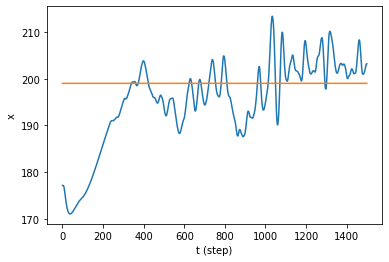

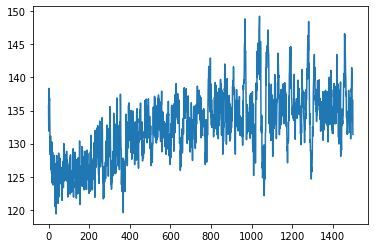

Episode 586, episode return -67.2, last 20 avg -78.6


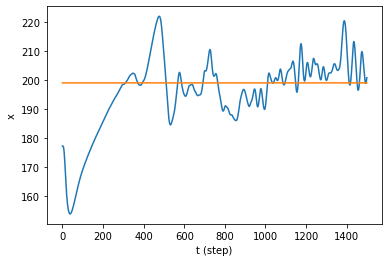

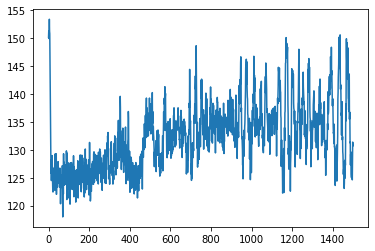

Episode 587, episode return -63.5, last 20 avg -78.9


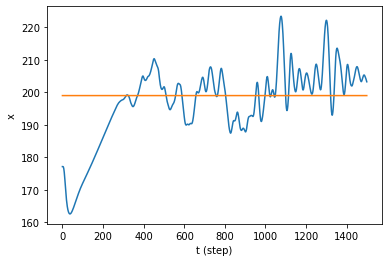

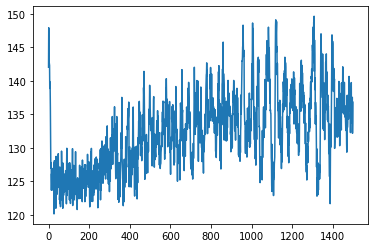

Episode 588, episode return -128.4, last 20 avg -82.6


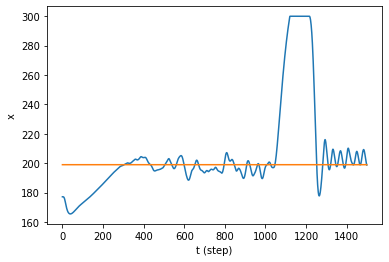

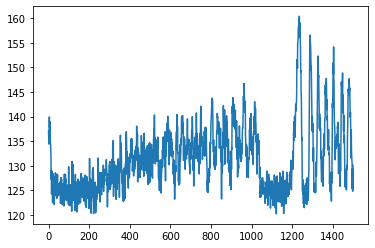

Episode 589, episode return -68.1, last 20 avg -83.1


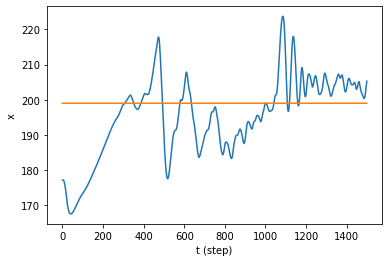

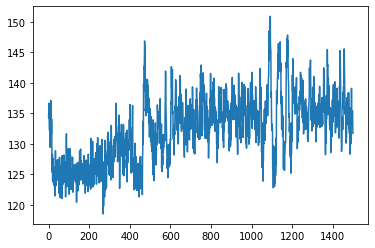

Episode 590, episode return -80.8, last 20 avg -83.9


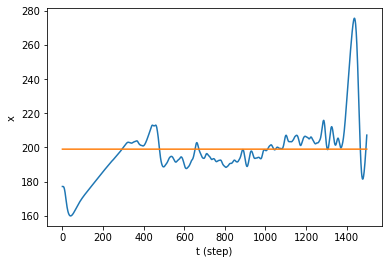

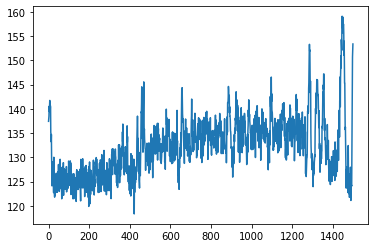

Episode 591, episode return -65.2, last 20 avg -84.7


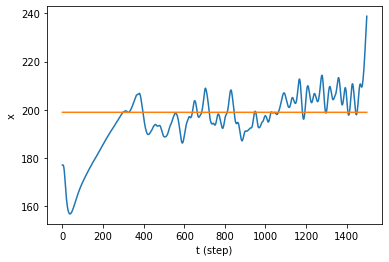

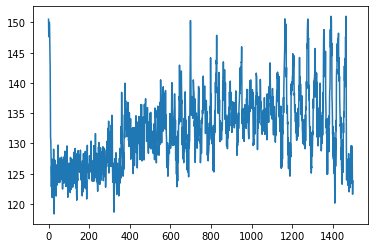

Episode 592, episode return -470.6, last 20 avg -105.7


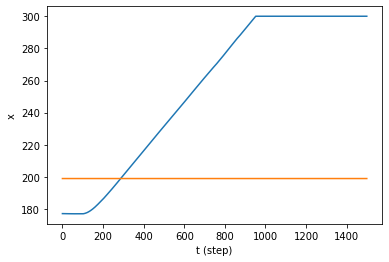

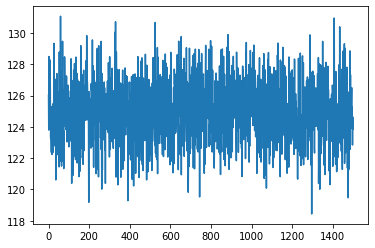

Episode 593, episode return -115.1, last 20 avg -108.9


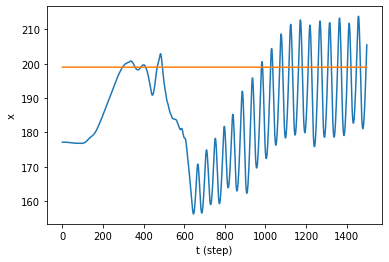

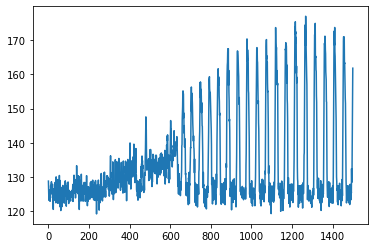

Episode 594, episode return -110.4, last 20 avg -110.6


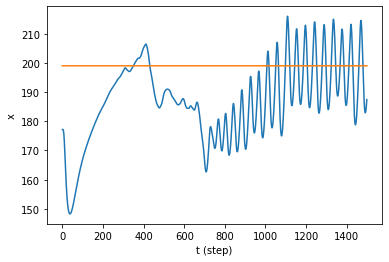

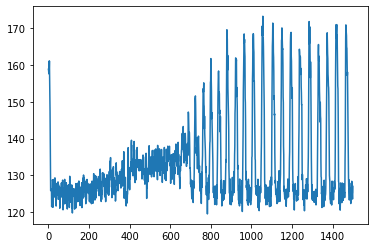

Episode 595, episode return -89.8, last 20 avg -112.5


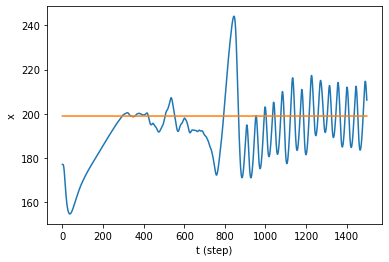

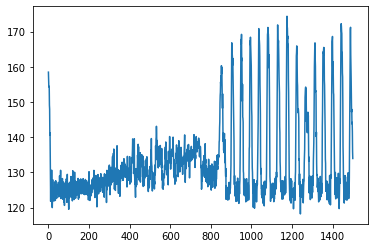

Episode 596, episode return -79.8, last 20 avg -111.4


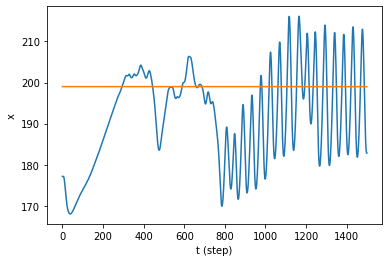

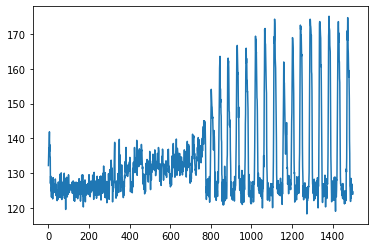

Episode 597, episode return -84.2, last 20 avg -113.0


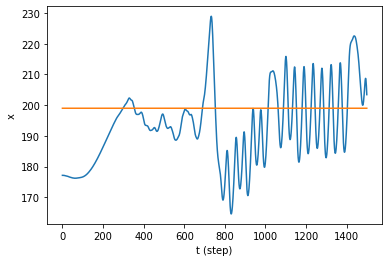

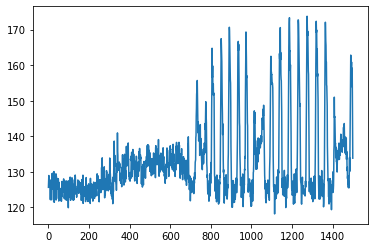

Episode 598, episode return -102.0, last 20 avg -106.0


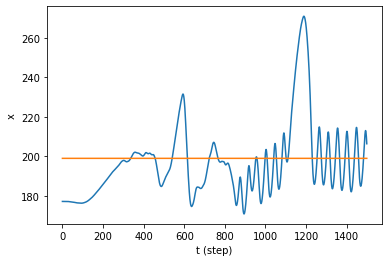

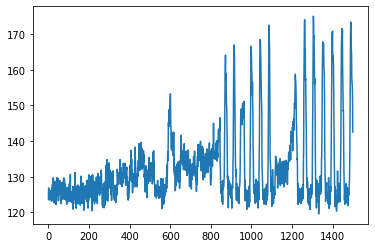

Episode 599, episode return -79.9, last 20 avg -106.2


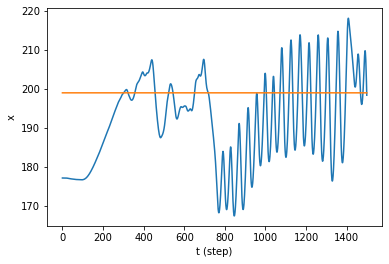

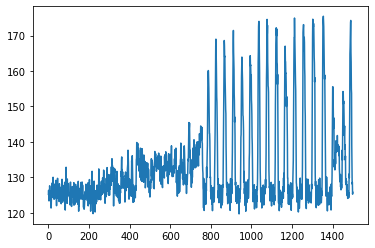

Episode 600, episode return -187.6, last 20 avg -110.9


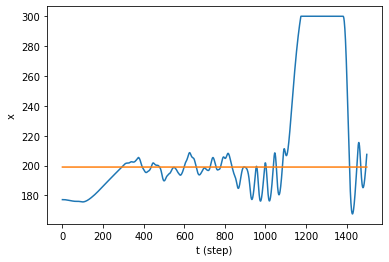

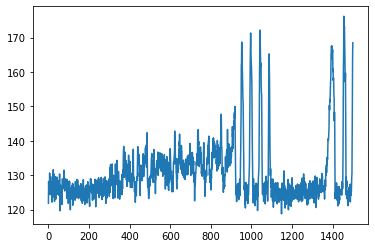

Episode 601, episode return -128.4, last 20 avg -113.0


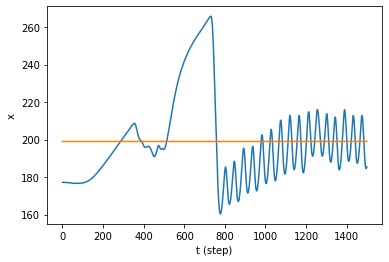

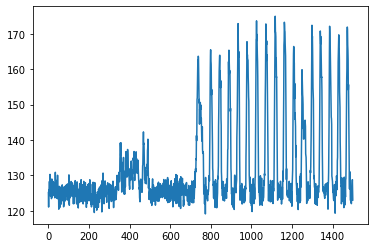

Episode 602, episode return -70.4, last 20 avg -113.3


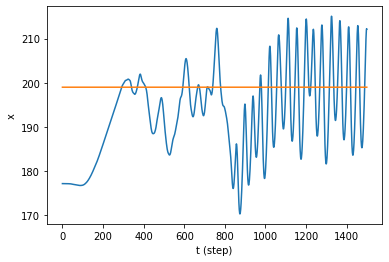

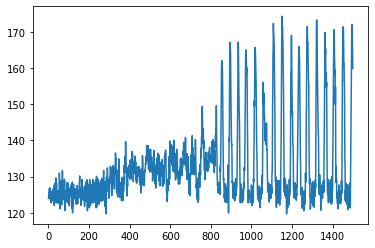

Episode 603, episode return -77.3, last 20 avg -113.7


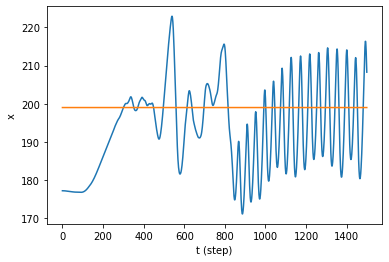

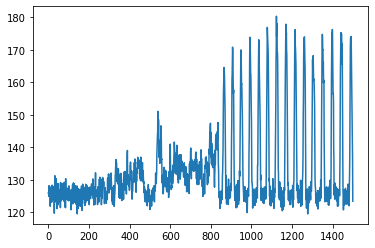

Episode 604, episode return -60.7, last 20 avg -109.1


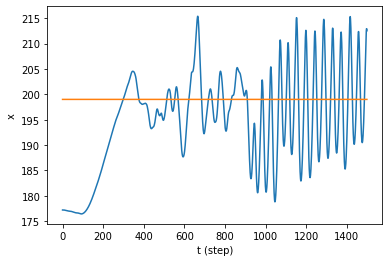

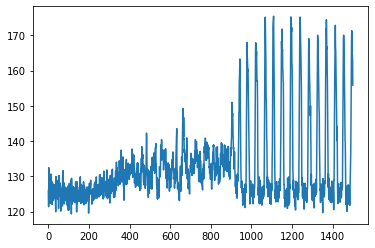

Episode 605, episode return -53.2, last 20 avg -109.1


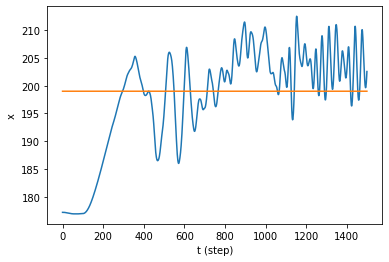

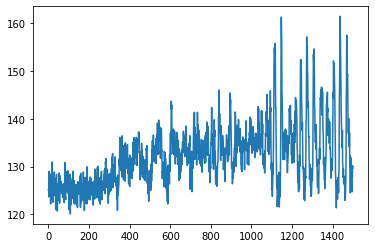

Episode 606, episode return -101.4, last 20 avg -110.8


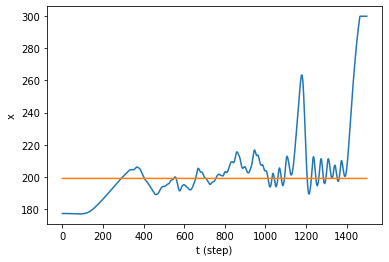

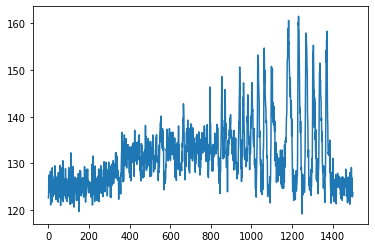

Episode 607, episode return -54.3, last 20 avg -110.4


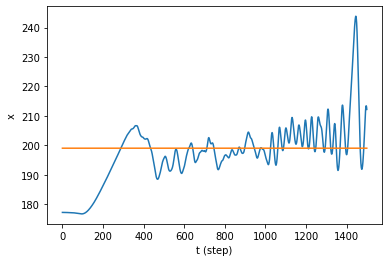

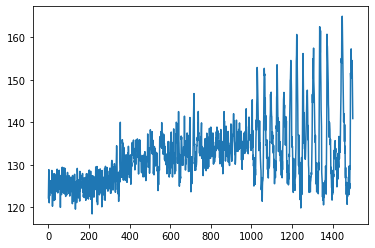

Episode 608, episode return -53.1, last 20 avg -106.6


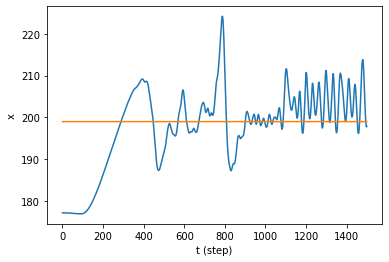

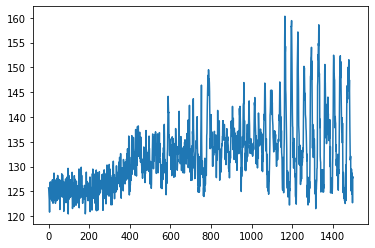

Episode 609, episode return -71.8, last 20 avg -106.8


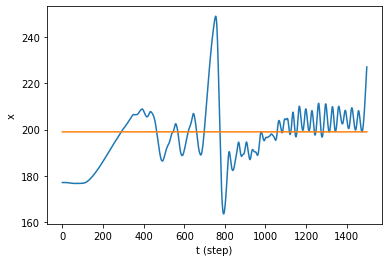

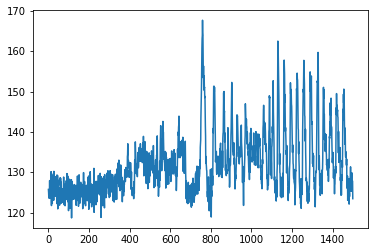

Episode 610, episode return -51.4, last 20 avg -105.3


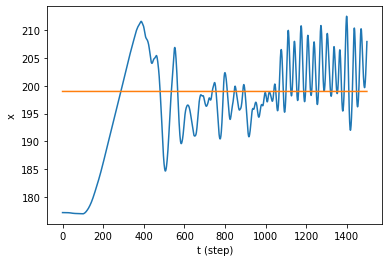

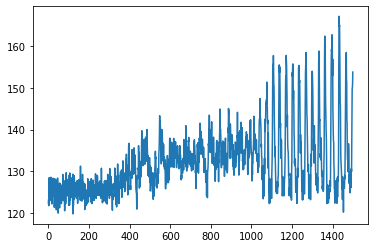

Episode 611, episode return -470.8, last 20 avg -125.6


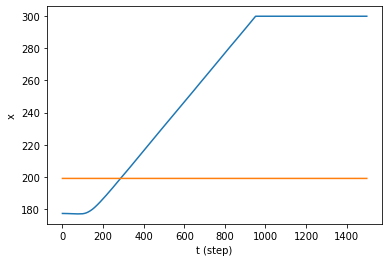

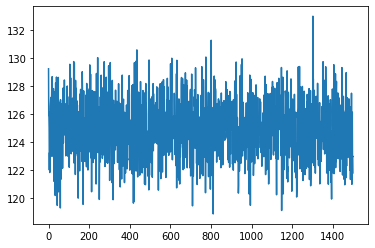

Episode 612, episode return -470.6, last 20 avg -125.6


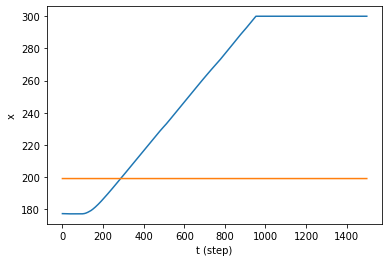

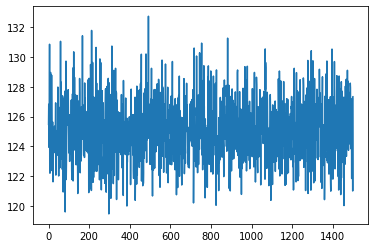

Episode 613, episode return -470.8, last 20 avg -143.4


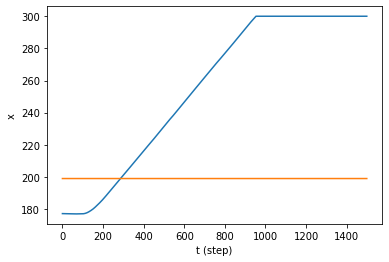

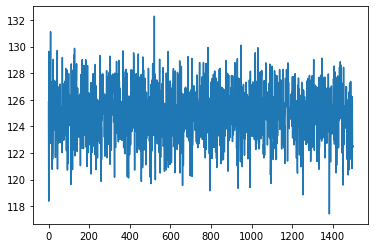

Episode 614, episode return -470.7, last 20 avg -161.4


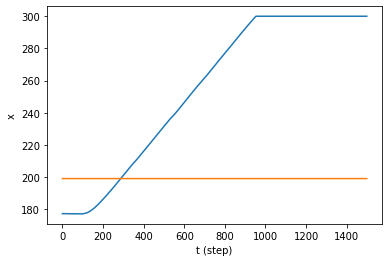

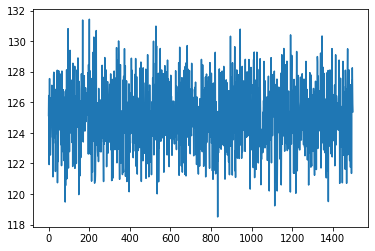

Episode 615, episode return -470.5, last 20 avg -180.4


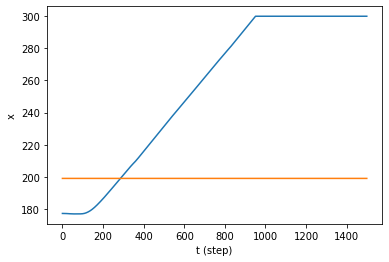

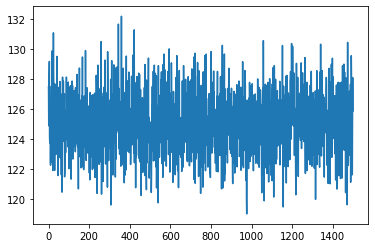

Episode 616, episode return -471.0, last 20 avg -200.0


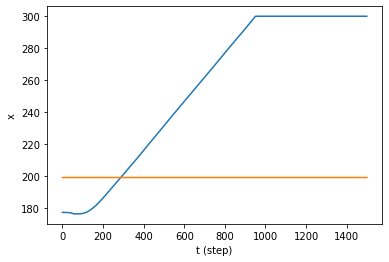

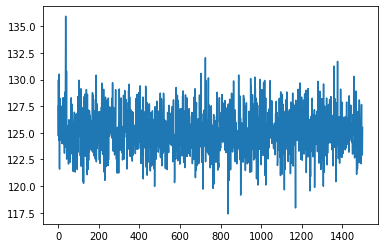

Episode 617, episode return -470.9, last 20 avg -219.3


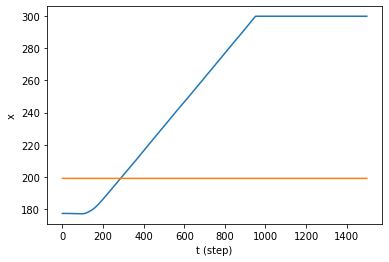

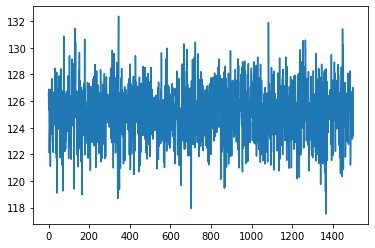

Episode 618, episode return -470.6, last 20 avg -237.8


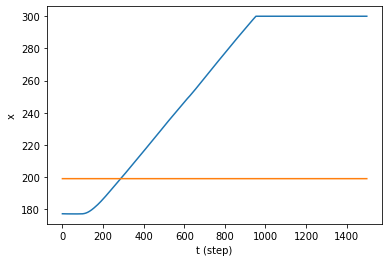

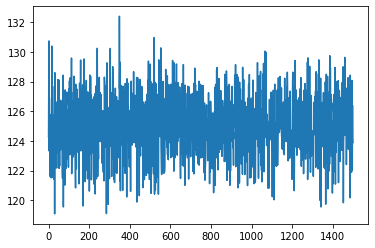

Episode 619, episode return -157.3, last 20 avg -241.6


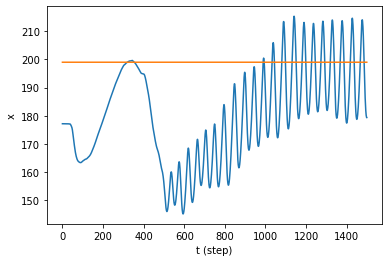

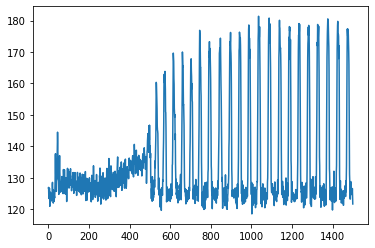

Episode 620, episode return -137.2, last 20 avg -239.1


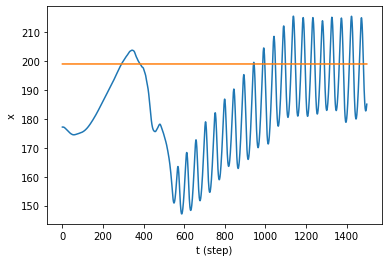

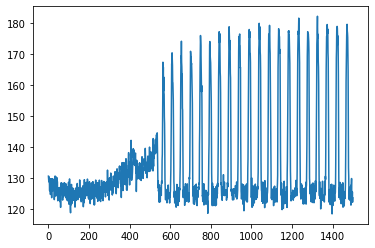

Episode 621, episode return -120.7, last 20 avg -238.7


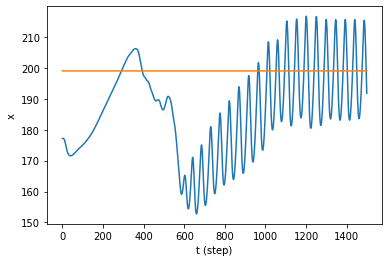

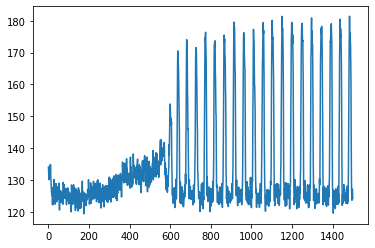

Episode 622, episode return -123.5, last 20 avg -241.4


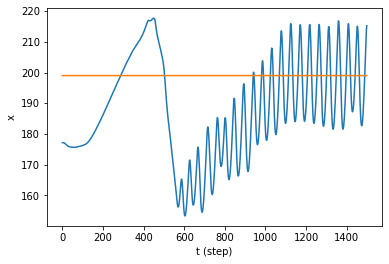

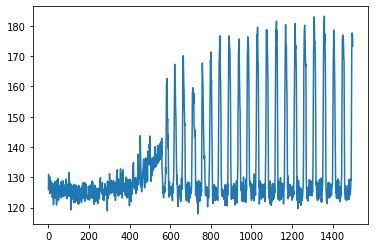

Episode 623, episode return -110.9, last 20 avg -243.1


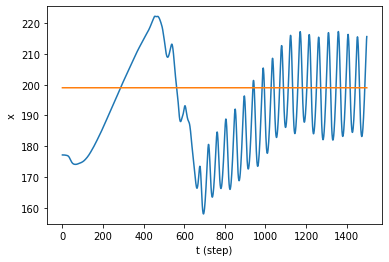

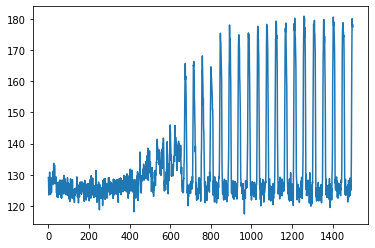

Episode 624, episode return -96.1, last 20 avg -244.8


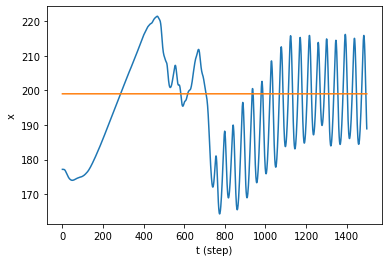

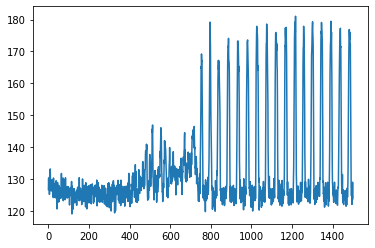

Episode 625, episode return -324.8, last 20 avg -258.4


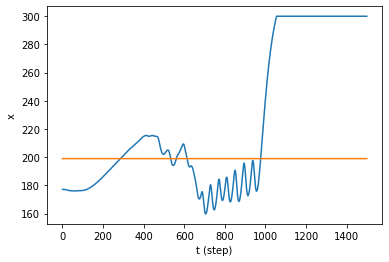

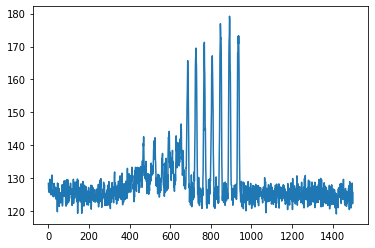

Episode 626, episode return -173.9, last 20 avg -262.0


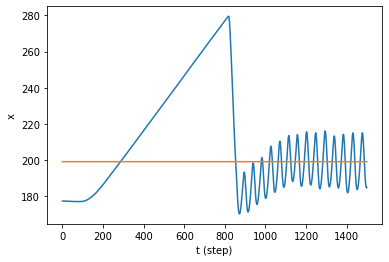

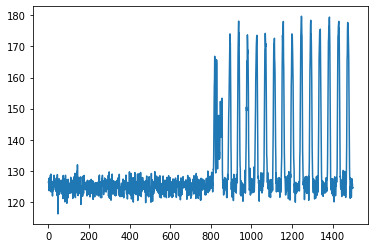

Episode 627, episode return -123.9, last 20 avg -265.5


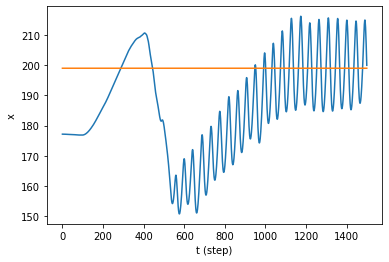

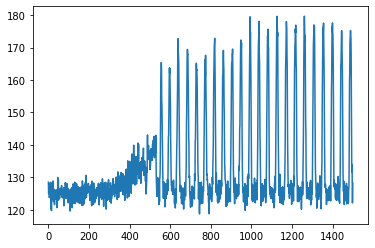

Episode 628, episode return -155.2, last 20 avg -270.6


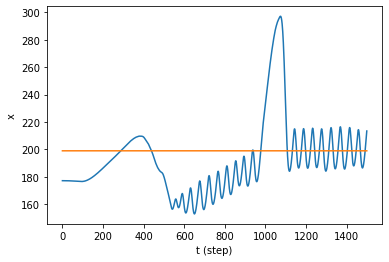

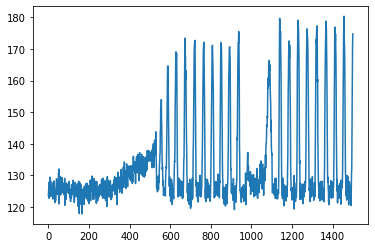

Episode 629, episode return -117.2, last 20 avg -272.9


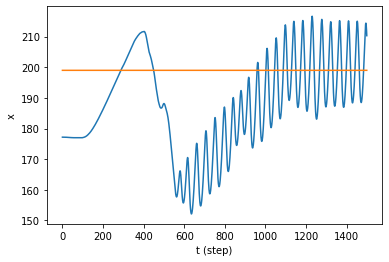

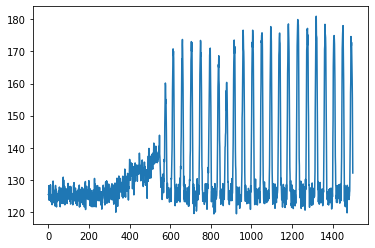

Episode 630, episode return -118.6, last 20 avg -276.2


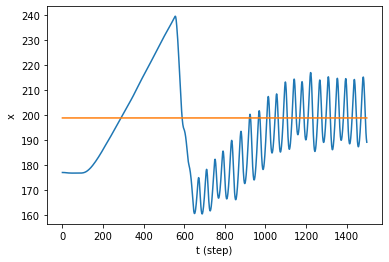

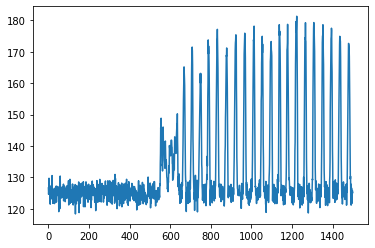

Episode 631, episode return -106.9, last 20 avg -258.1


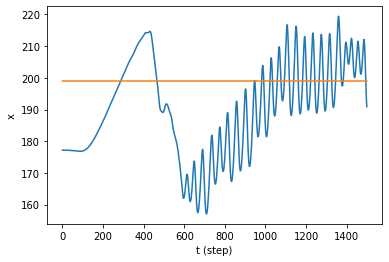

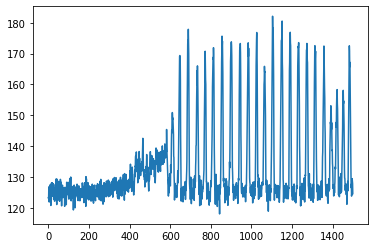

Episode 632, episode return -388.2, last 20 avg -253.9


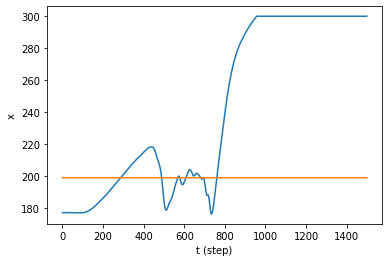

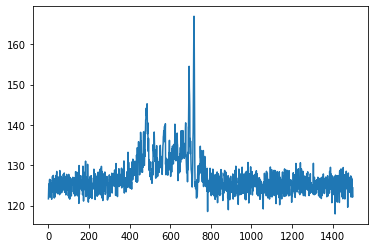

Episode 633, episode return -117.1, last 20 avg -236.2


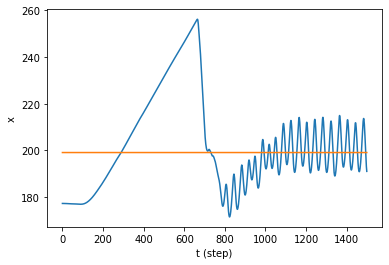

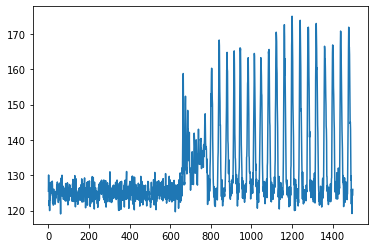

Episode 634, episode return -58.9, last 20 avg -215.7


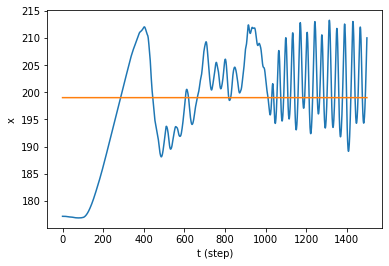

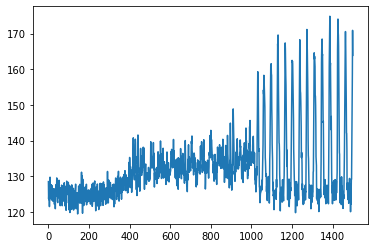

Episode 635, episode return -57.5, last 20 avg -195.0


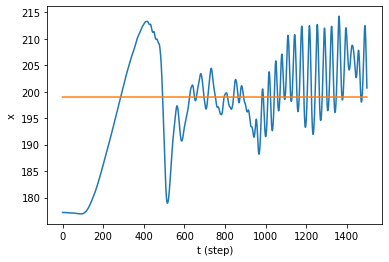

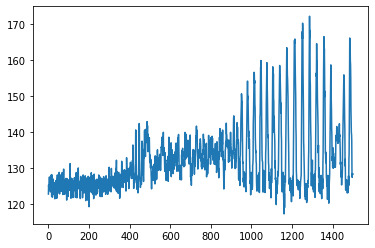

Episode 636, episode return -65.2, last 20 avg -174.7


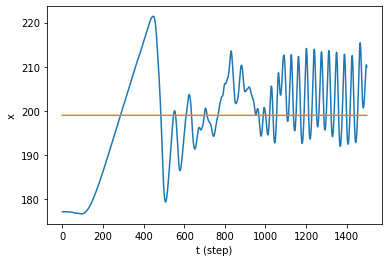

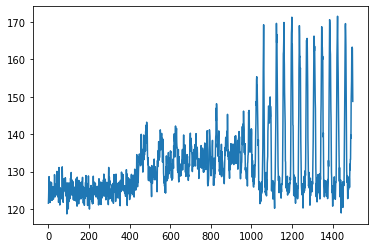

Episode 637, episode return -68.9, last 20 avg -154.6


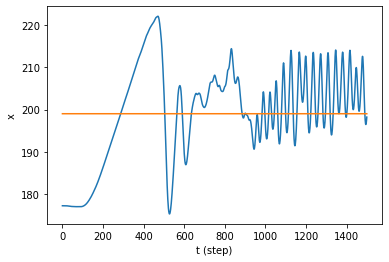

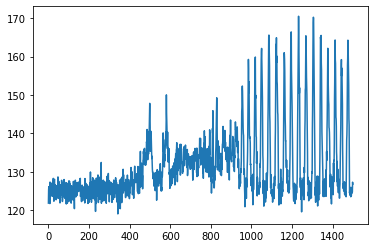

Episode 638, episode return -94.7, last 20 avg -135.8


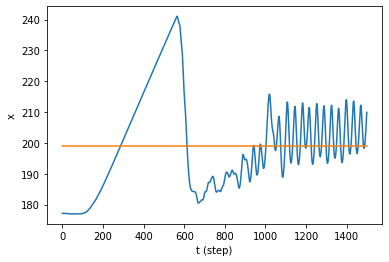

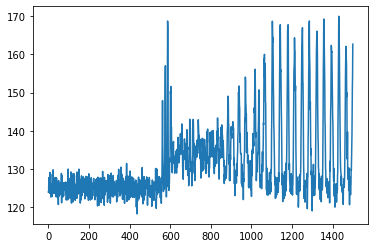

Episode 639, episode return -63.0, last 20 avg -131.1


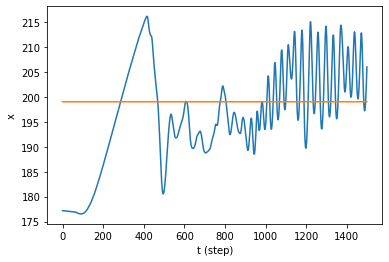

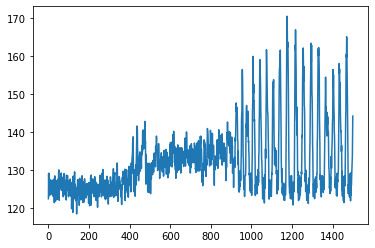

Episode 640, episode return -68.1, last 20 avg -127.7


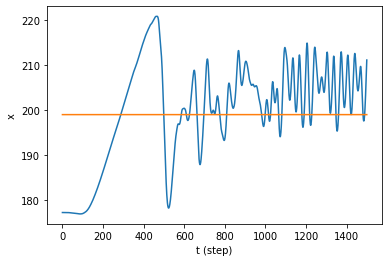

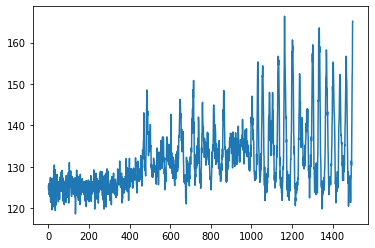

Episode 641, episode return -342.1, last 20 avg -138.7


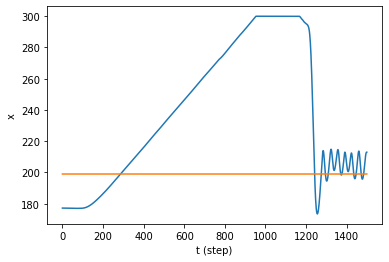

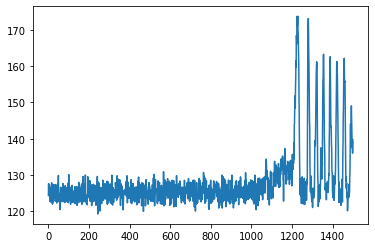

Episode 642, episode return -61.0, last 20 avg -135.6


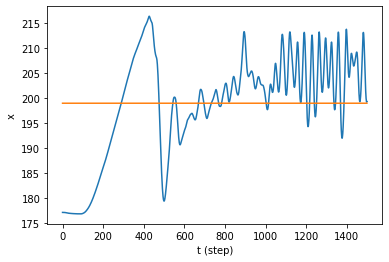

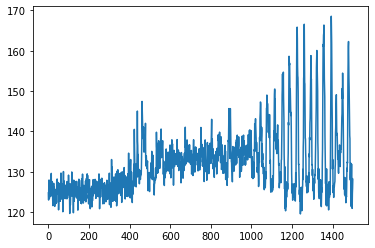

Episode 643, episode return -64.1, last 20 avg -133.3


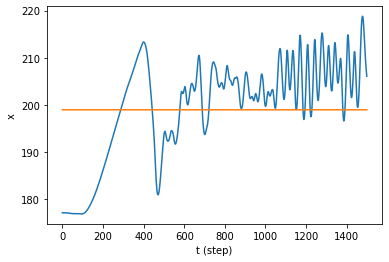

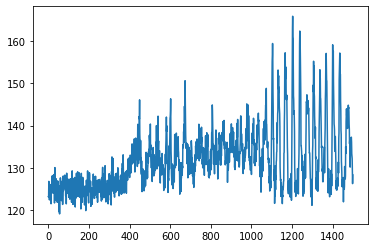

Episode 644, episode return -387.8, last 20 avg -147.8


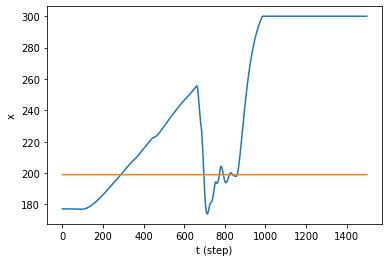

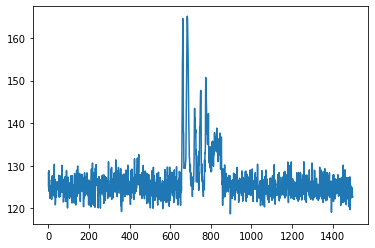

Episode 645, episode return -470.7, last 20 avg -155.1


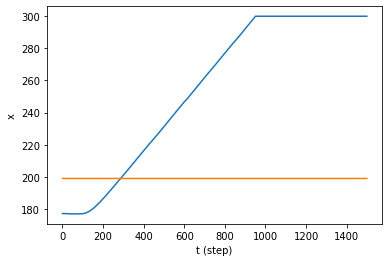

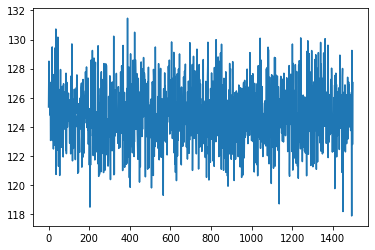

Episode 646, episode return -466.4, last 20 avg -169.8


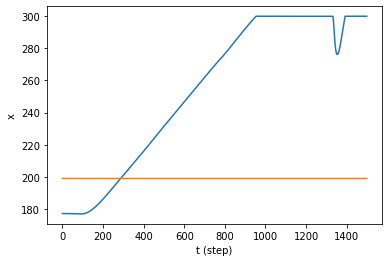

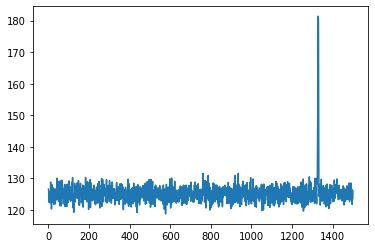

Episode 647, episode return -470.9, last 20 avg -187.1


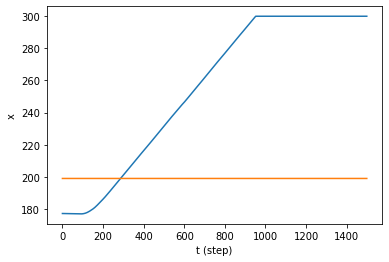

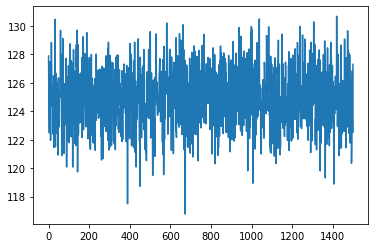

Episode 648, episode return -471.0, last 20 avg -202.9


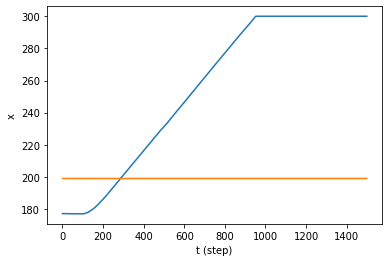

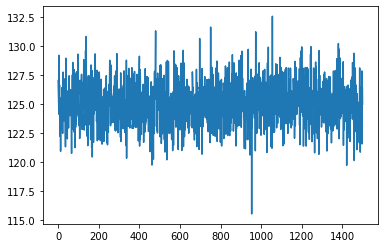

Episode 649, episode return -471.0, last 20 avg -220.6


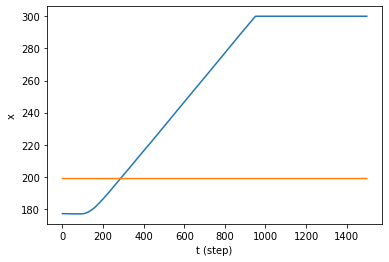

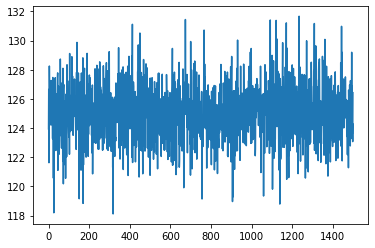

Episode 650, episode return -357.6, last 20 avg -232.5


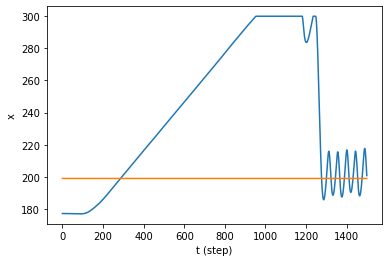

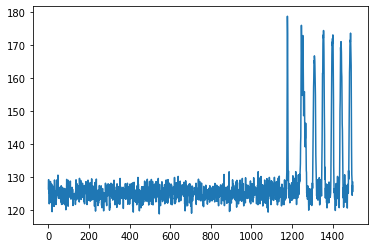

Episode 651, episode return -121.5, last 20 avg -233.3


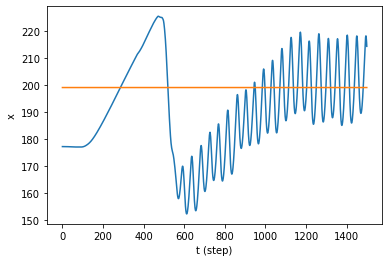

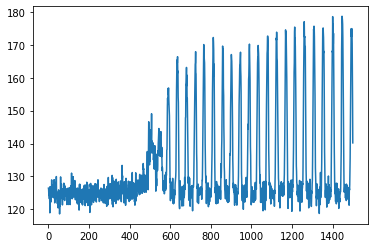

Episode 652, episode return -118.4, last 20 avg -219.8


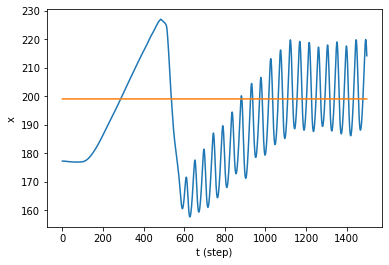

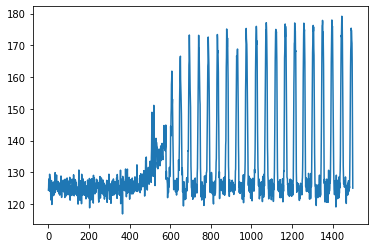

Episode 653, episode return -115.8, last 20 avg -219.7


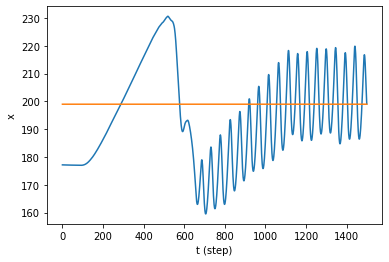

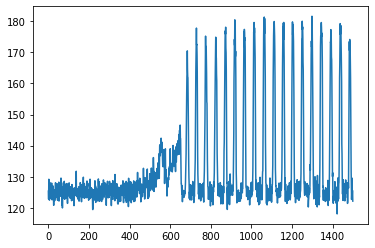

Episode 654, episode return -105.9, last 20 avg -222.1


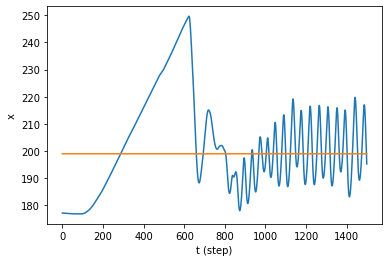

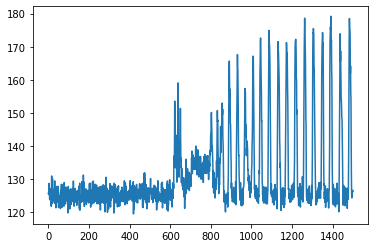

Episode 655, episode return -460.6, last 20 avg -242.2


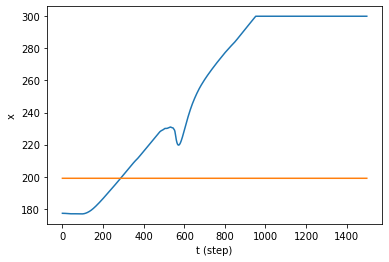

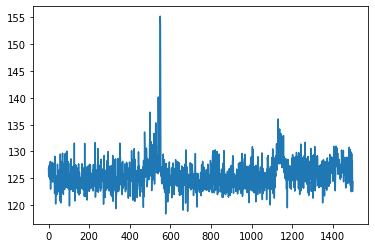

Episode 656, episode return -93.3, last 20 avg -243.6


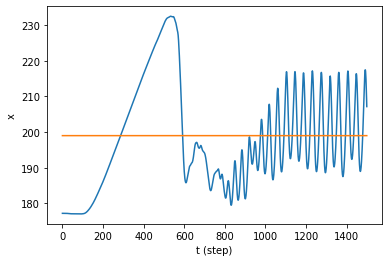

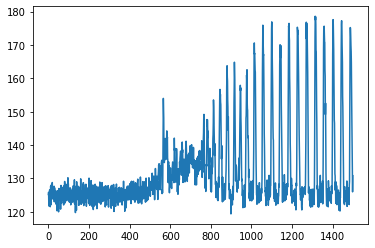

Episode 657, episode return -103.4, last 20 avg -245.4


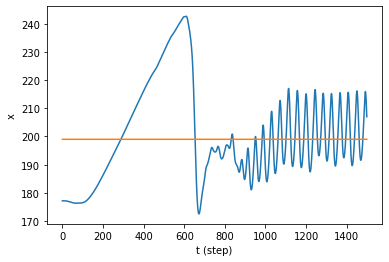

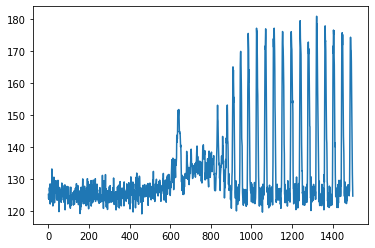

Episode 658, episode return -108.3, last 20 avg -246.0


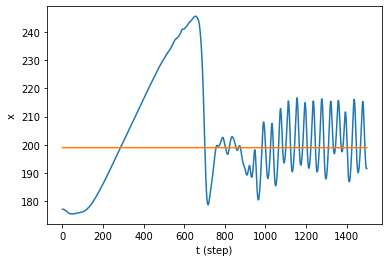

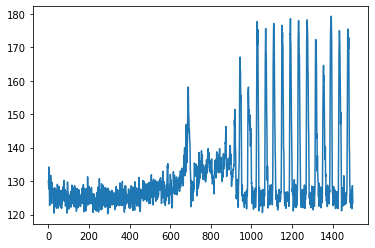

Episode 659, episode return -160.0, last 20 avg -250.9


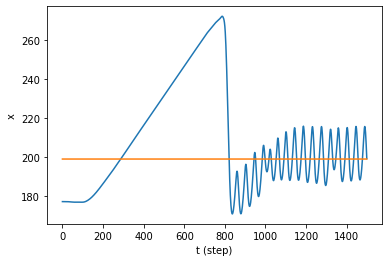

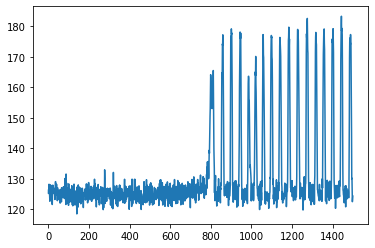

Episode 660, episode return -104.5, last 20 avg -252.7


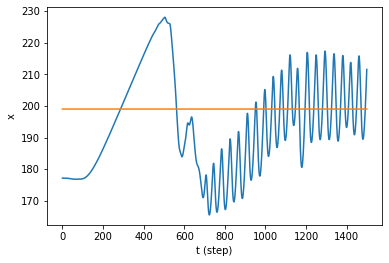

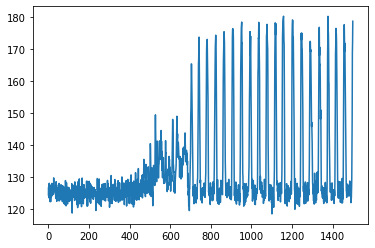

Episode 661, episode return -74.0, last 20 avg -239.3


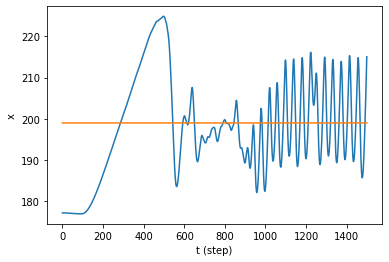

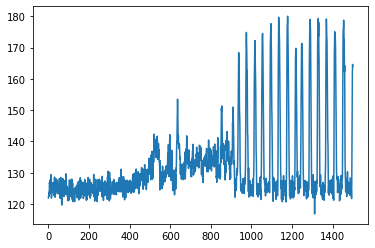

Episode 662, episode return -298.3, last 20 avg -251.2


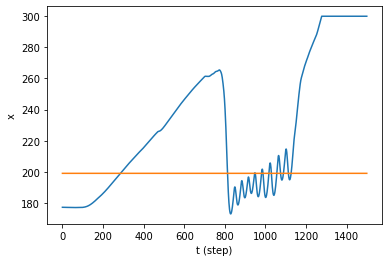

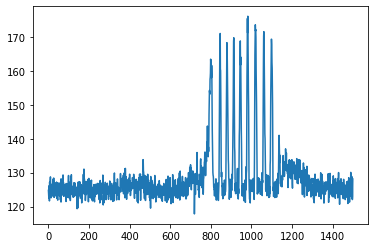

Episode 663, episode return -112.5, last 20 avg -253.6


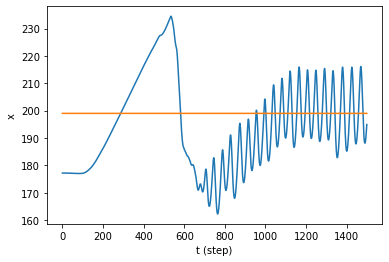

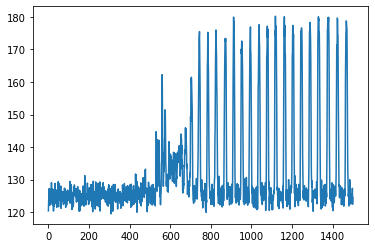

Episode 664, episode return -94.5, last 20 avg -238.9


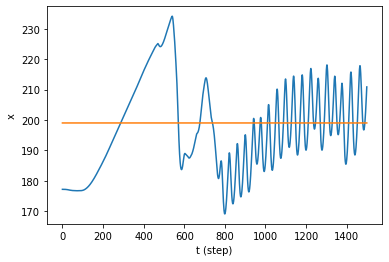

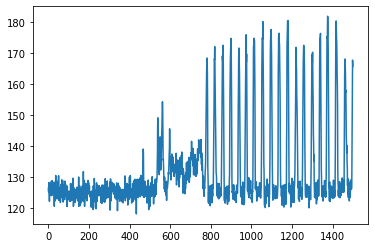

Episode 665, episode return -353.8, last 20 avg -233.1


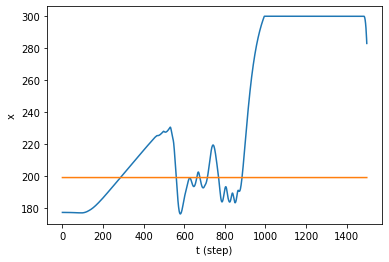

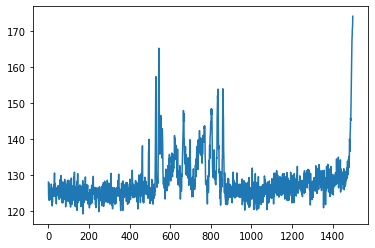

Episode 666, episode return -73.1, last 20 avg -213.4


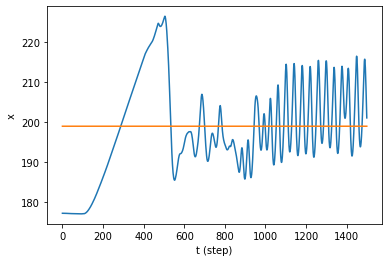

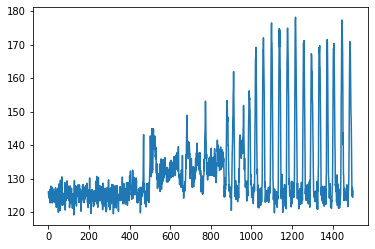

Episode 667, episode return -104.5, last 20 avg -195.1


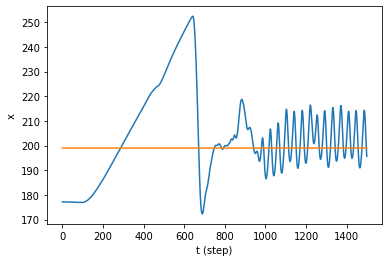

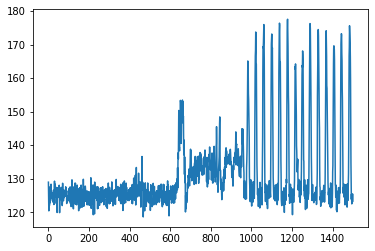

Episode 668, episode return -105.6, last 20 avg -176.8


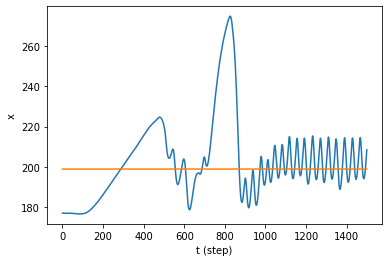

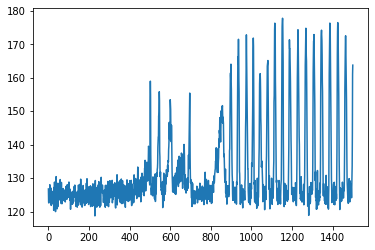

Episode 669, episode return -70.0, last 20 avg -156.8


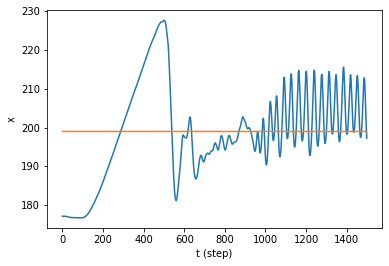

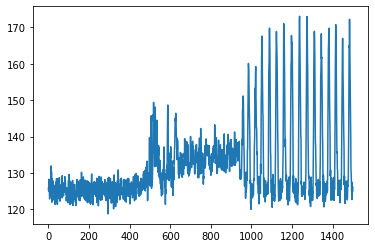

Episode 670, episode return -73.1, last 20 avg -142.6


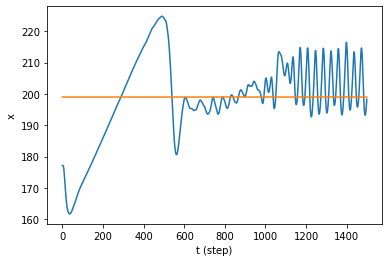

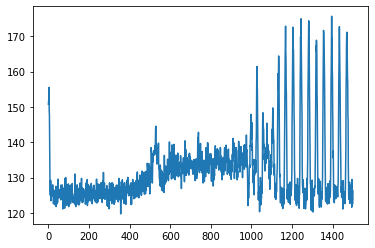

Episode 671, episode return -74.5, last 20 avg -140.2


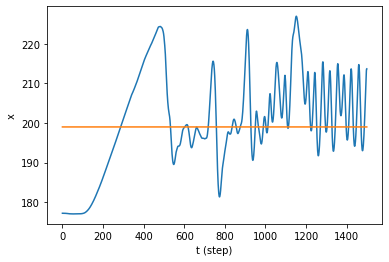

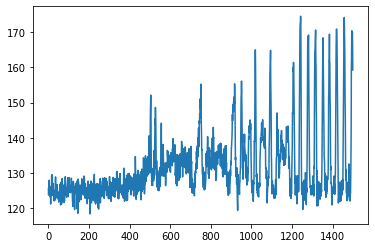

Episode 672, episode return -76.4, last 20 avg -138.1


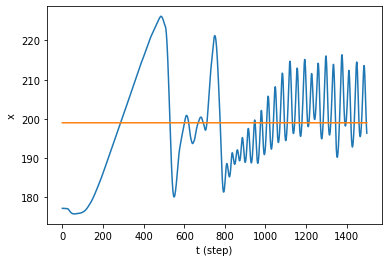

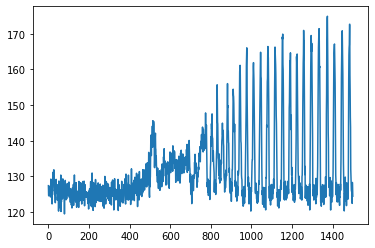

Episode 673, episode return -102.2, last 20 avg -137.4


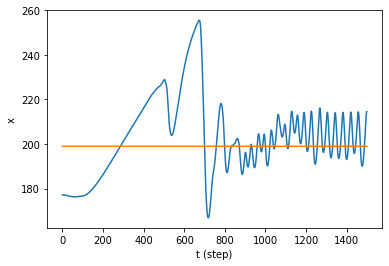

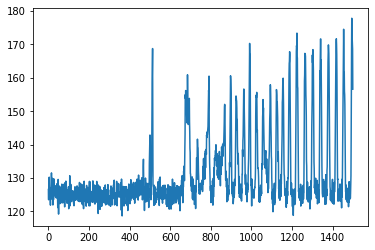

Episode 674, episode return -76.6, last 20 avg -136.0


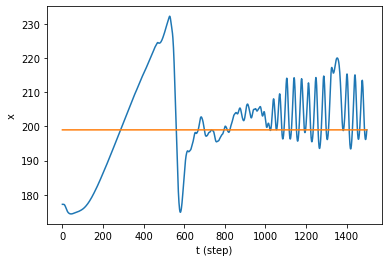

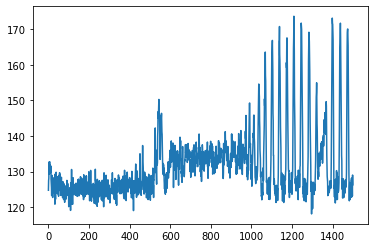

Episode 675, episode return -78.4, last 20 avg -116.9


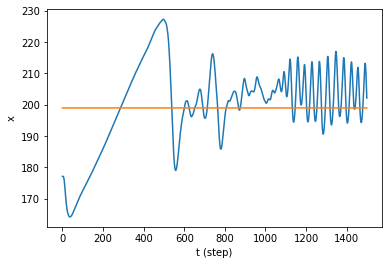

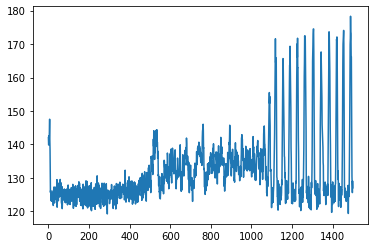

Episode 676, episode return -81.8, last 20 avg -116.3


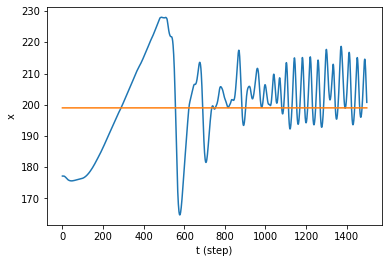

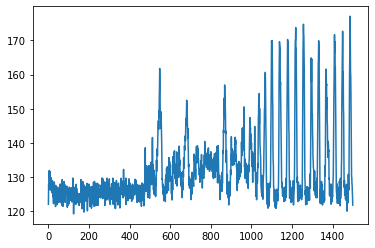

Episode 677, episode return -92.7, last 20 avg -115.7


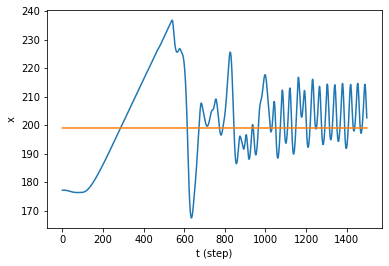

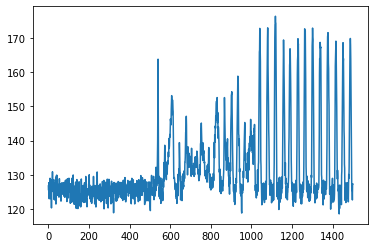

Episode 678, episode return -463.2, last 20 avg -133.5


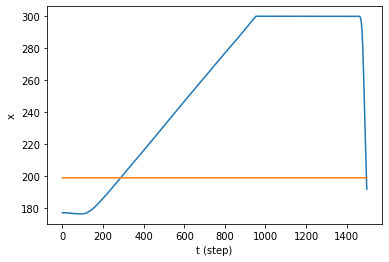

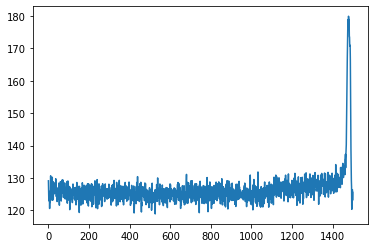

Episode 679, episode return -471.2, last 20 avg -149.0


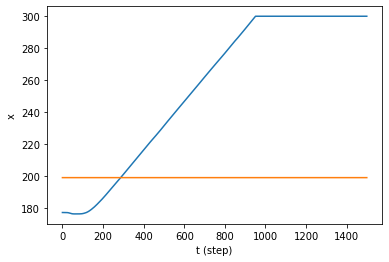

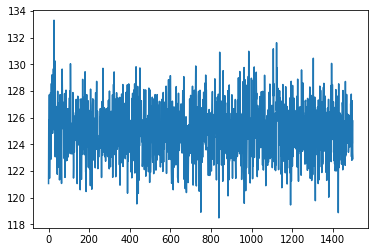

Episode 680, episode return -471.0, last 20 avg -167.4


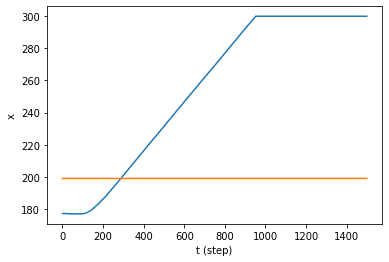

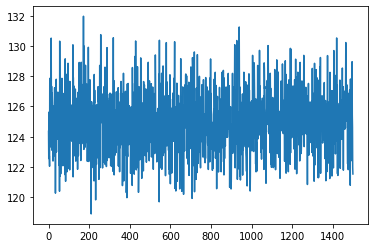

Episode 681, episode return -438.3, last 20 avg -185.6


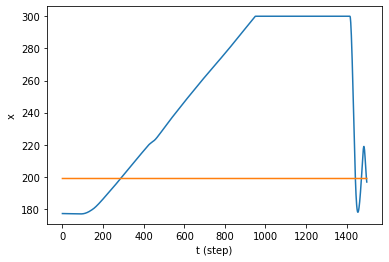

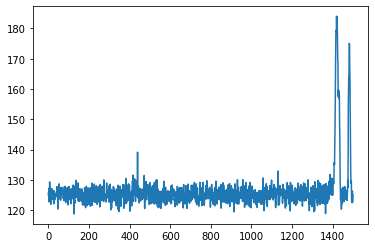

Episode 682, episode return -253.8, last 20 avg -183.4


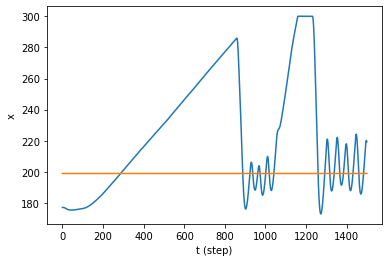

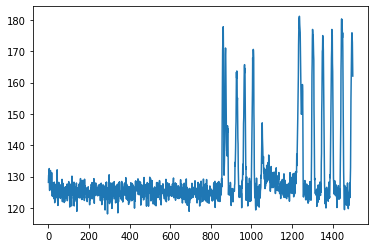

Episode 683, episode return -111.7, last 20 avg -183.3


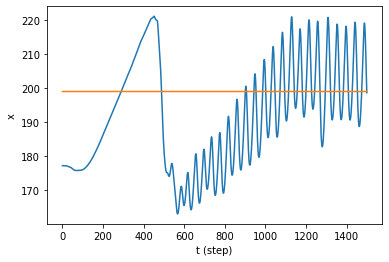

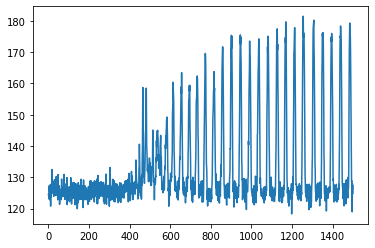

Episode 684, episode return -107.2, last 20 avg -184.0


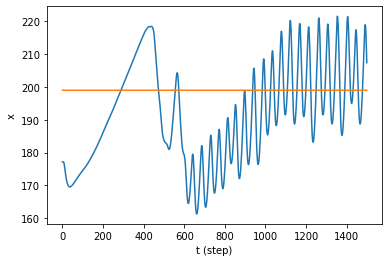

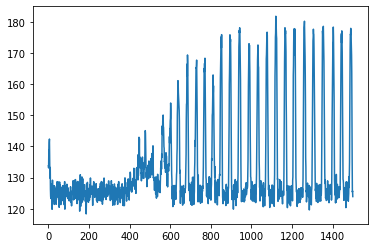

Episode 685, episode return -112.4, last 20 avg -171.9


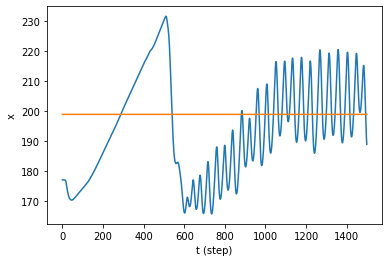

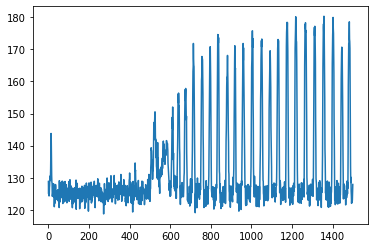

Episode 686, episode return -254.8, last 20 avg -181.0


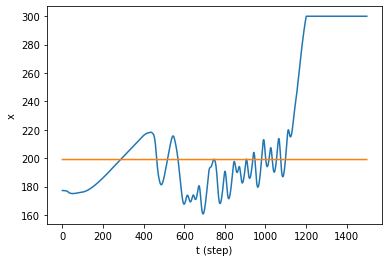

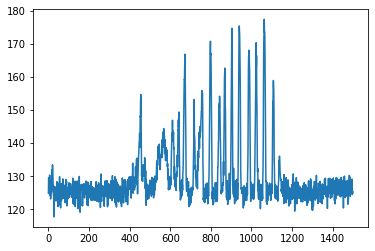

Episode 687, episode return -247.8, last 20 avg -188.1


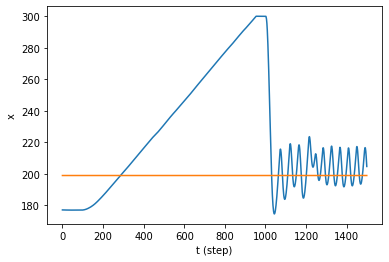

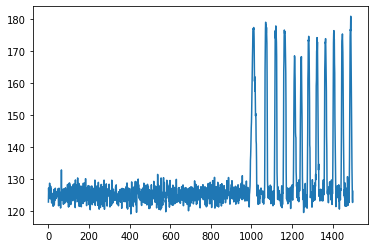

Episode 688, episode return -303.2, last 20 avg -198.0


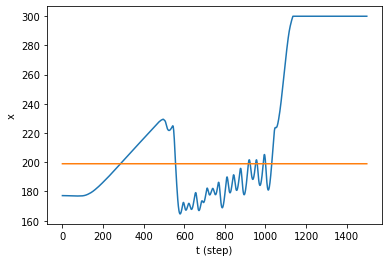

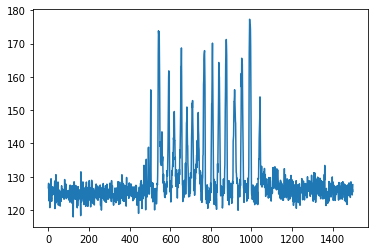

Episode 689, episode return -109.6, last 20 avg -200.0


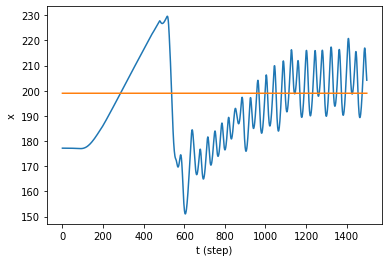

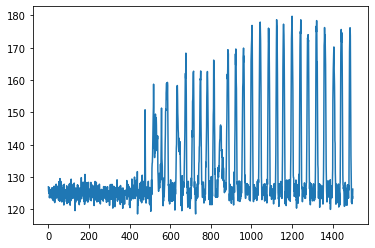

Episode 690, episode return -92.1, last 20 avg -200.9


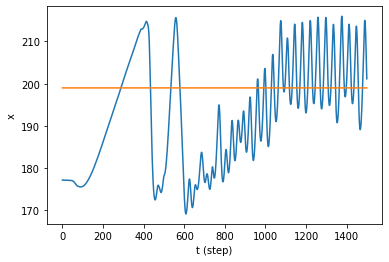

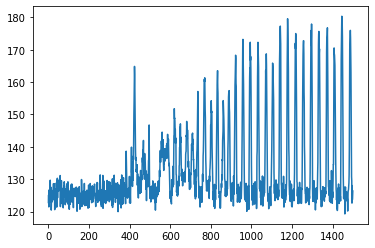

Episode 691, episode return -429.3, last 20 avg -218.7


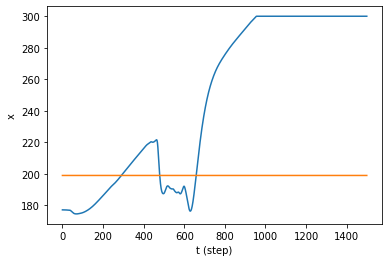

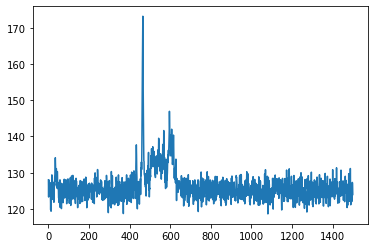

Episode 692, episode return -470.6, last 20 avg -238.4


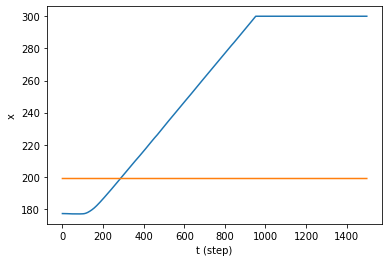

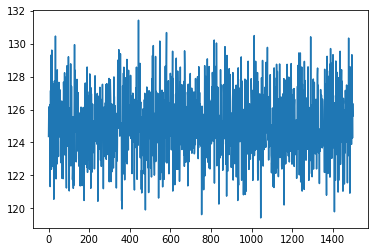

Episode 693, episode return -459.5, last 20 avg -256.3


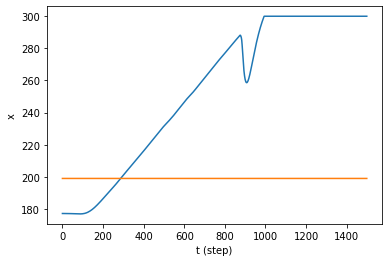

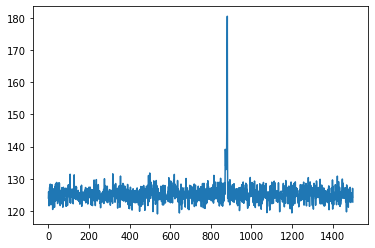

Episode 694, episode return -470.6, last 20 avg -276.0


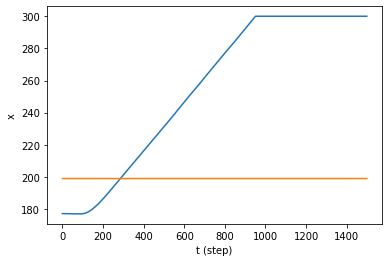

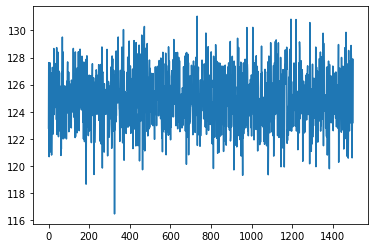

Episode 695, episode return -470.8, last 20 avg -295.6


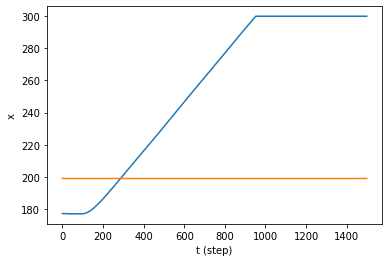

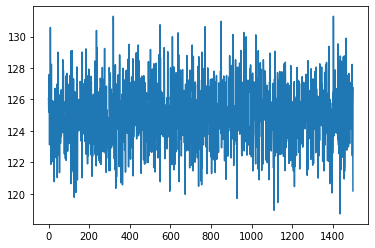

Episode 696, episode return -470.3, last 20 avg -315.0


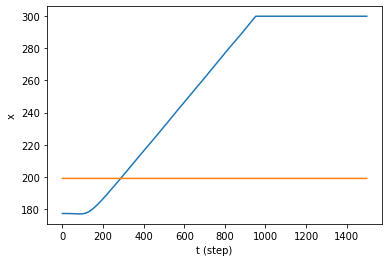

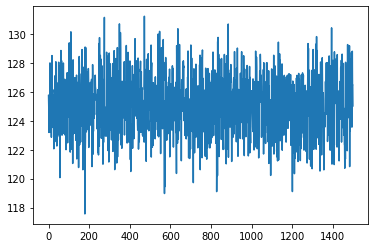

Episode 697, episode return -470.8, last 20 avg -333.9


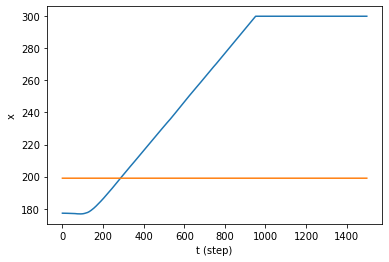

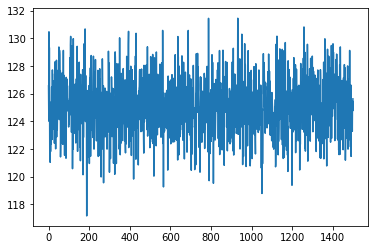

Episode 698, episode return -470.4, last 20 avg -334.3


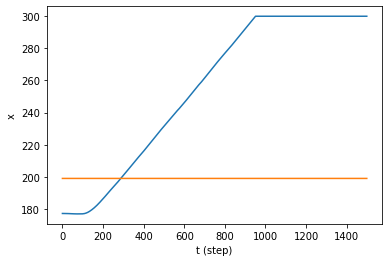

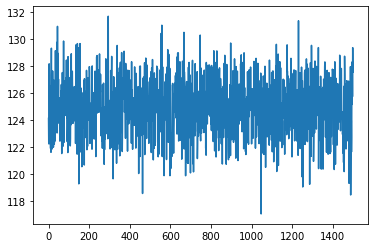

Episode 699, episode return -470.8, last 20 avg -334.3


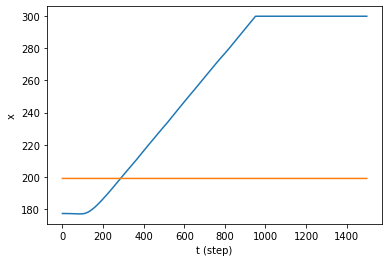

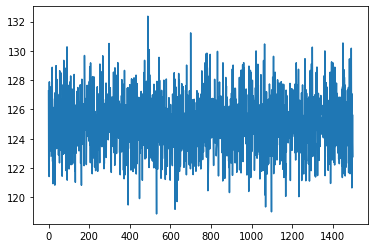

Episode 700, episode return -470.8, last 20 avg -334.2


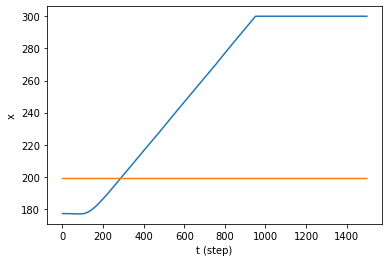

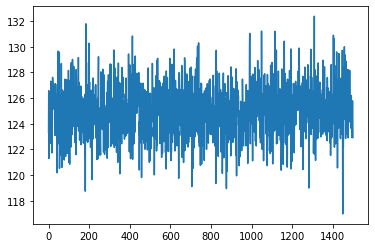

Episode 701, episode return -470.8, last 20 avg -335.9


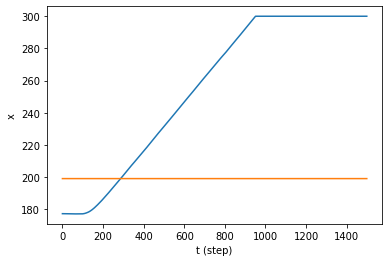

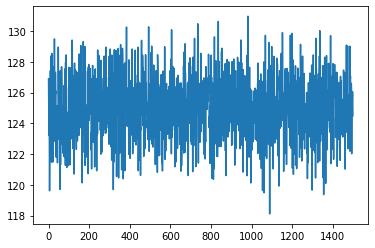

Episode 702, episode return -470.9, last 20 avg -346.7


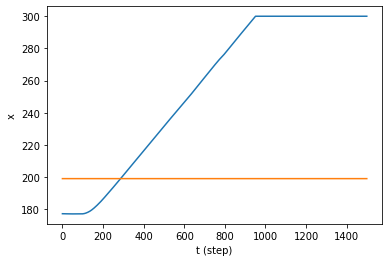

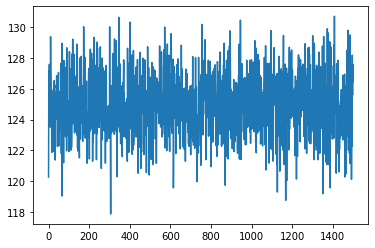

Episode 703, episode return -470.5, last 20 avg -364.7


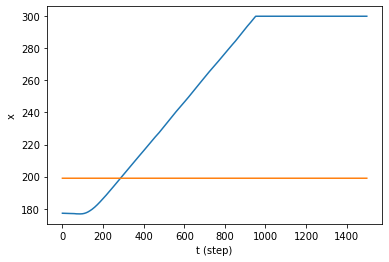

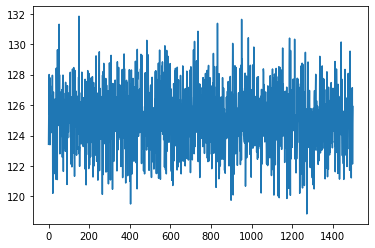

Episode 704, episode return -166.3, last 20 avg -367.6


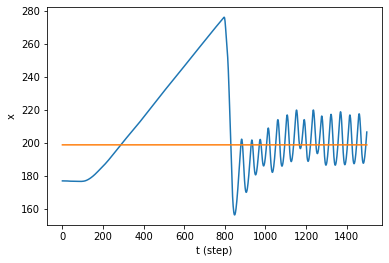

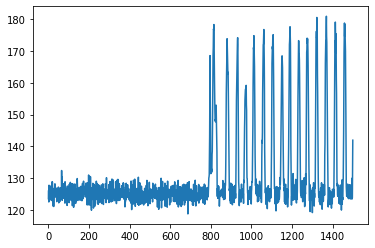

Episode 705, episode return -122.6, last 20 avg -368.1


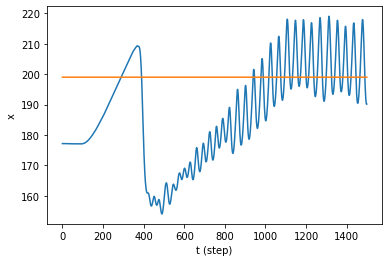

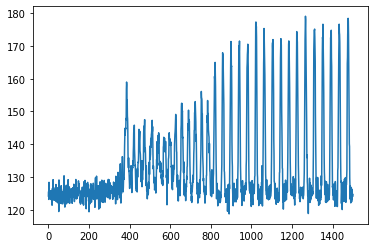

Episode 706, episode return -109.6, last 20 avg -360.9


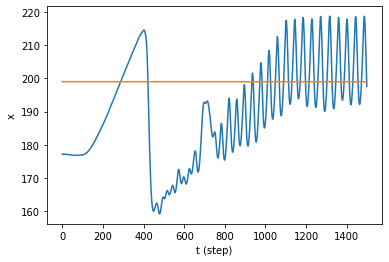

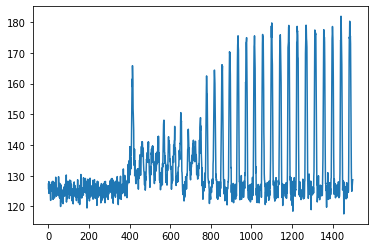

Episode 707, episode return -108.5, last 20 avg -353.9


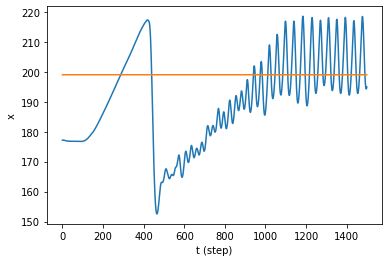

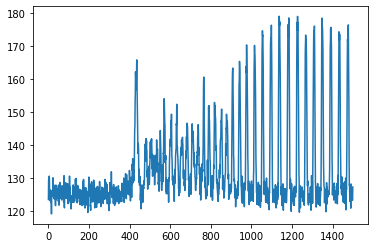

Episode 708, episode return -89.0, last 20 avg -343.2


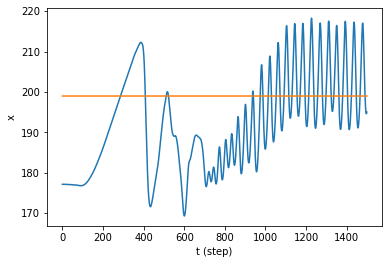

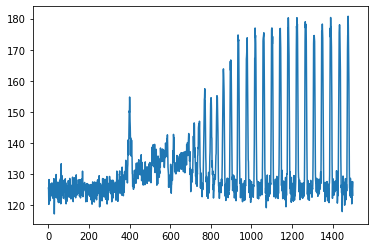

Episode 709, episode return -250.2, last 20 avg -350.2


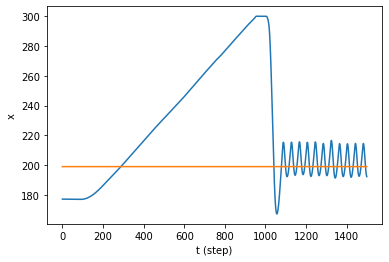

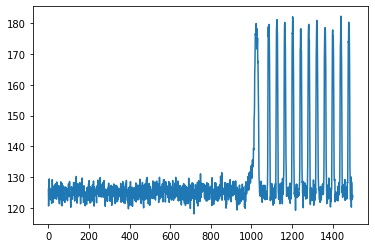

Episode 710, episode return -251.9, last 20 avg -358.2


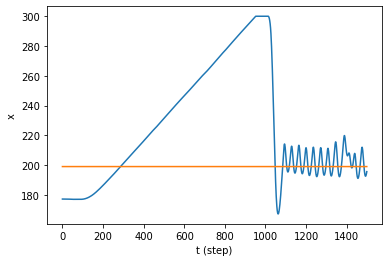

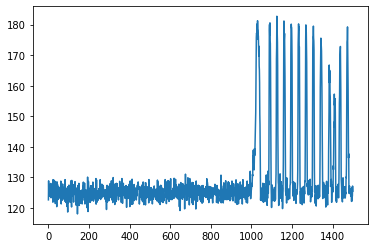

Episode 711, episode return -70.1, last 20 avg -340.2


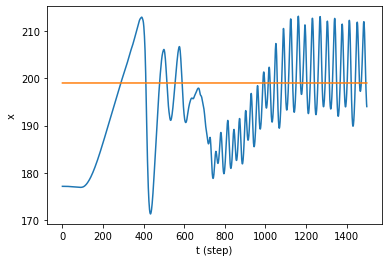

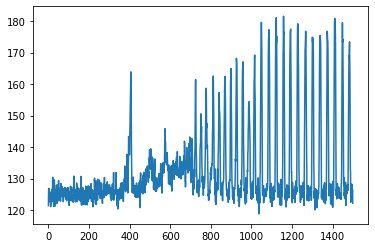

Episode 712, episode return -60.6, last 20 avg -319.7


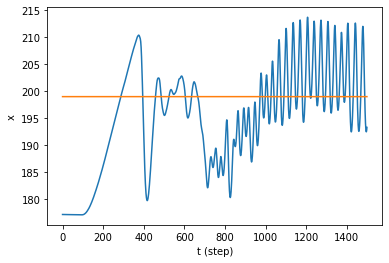

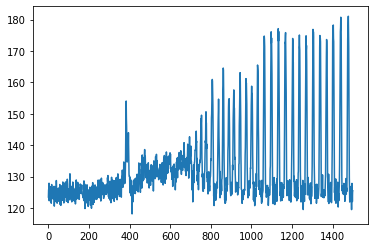

Episode 713, episode return -240.1, last 20 avg -308.8


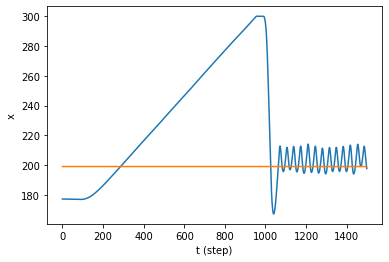

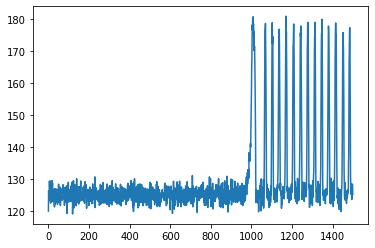

Episode 714, episode return -235.6, last 20 avg -297.0


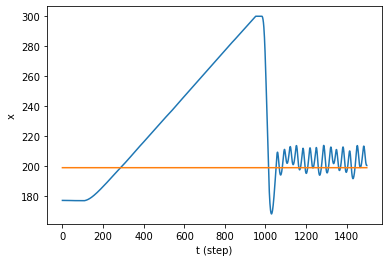

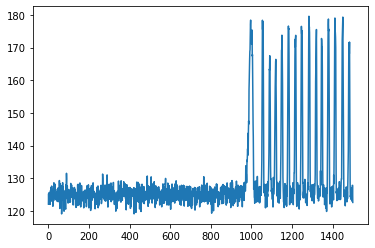

Episode 715, episode return -203.3, last 20 avg -283.6


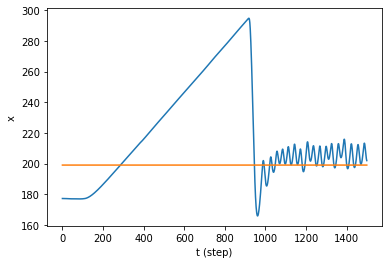

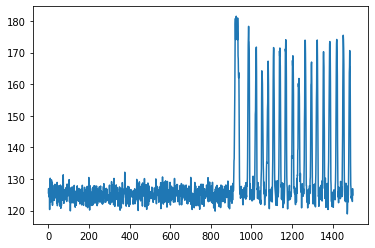

Episode 716, episode return -61.5, last 20 avg -263.2


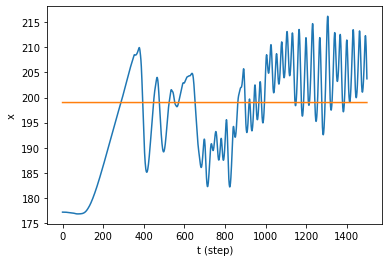

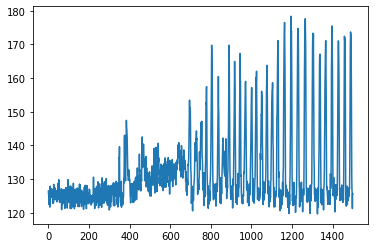

Episode 717, episode return -67.5, last 20 avg -243.0


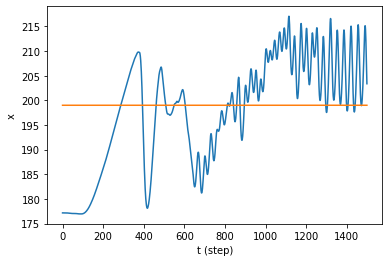

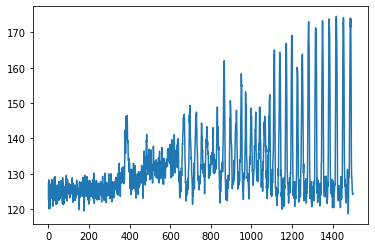

Episode 718, episode return -208.8, last 20 avg -230.0


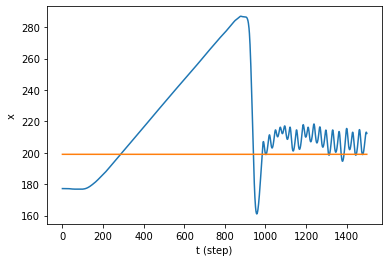

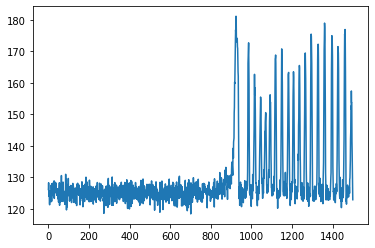

Episode 719, episode return -81.2, last 20 avg -210.5


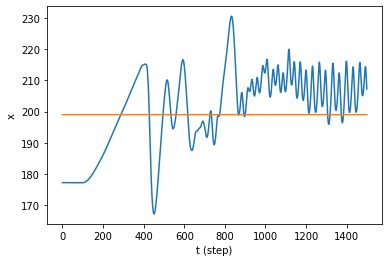

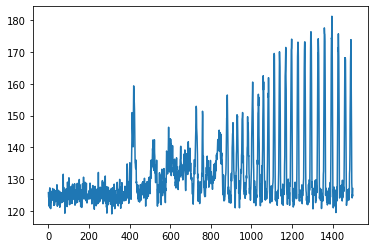

Episode 720, episode return -92.8, last 20 avg -191.6


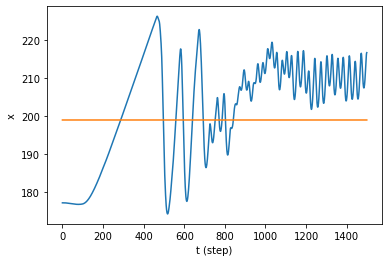

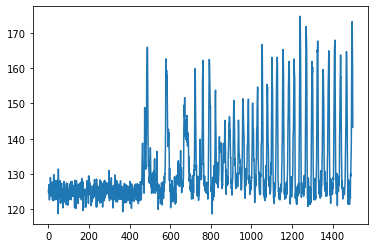

Episode 721, episode return -223.8, last 20 avg -179.2


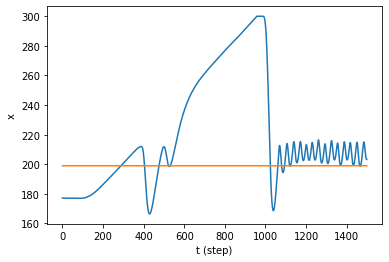

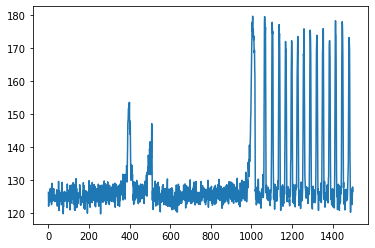

Episode 722, episode return -419.8, last 20 avg -176.7


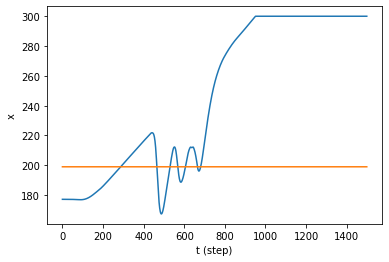

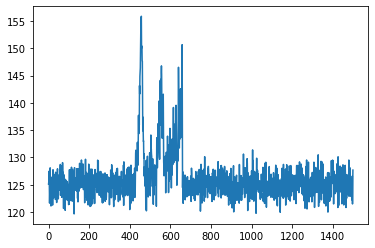

Episode 723, episode return -470.9, last 20 avg -176.7


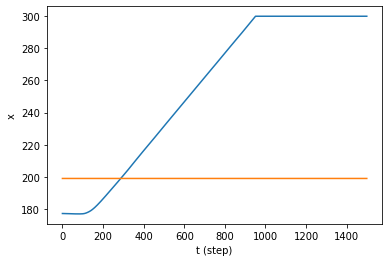

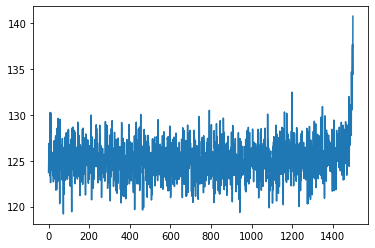

Episode 724, episode return -82.4, last 20 avg -172.5


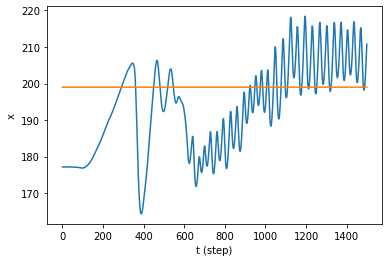

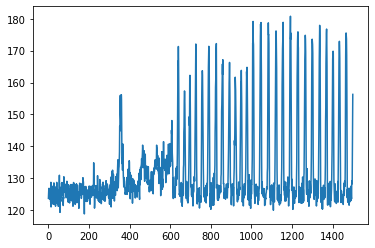

Episode 725, episode return -83.1, last 20 avg -170.5


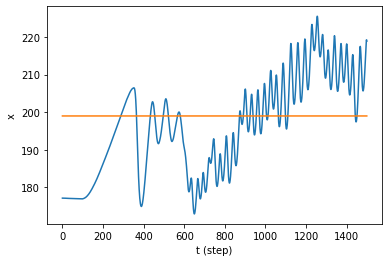

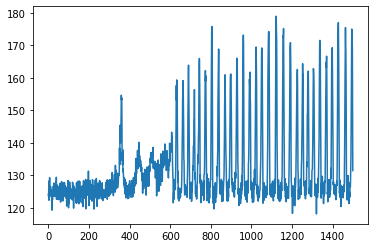

Episode 726, episode return -60.6, last 20 avg -168.1


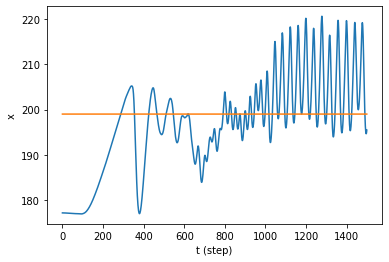

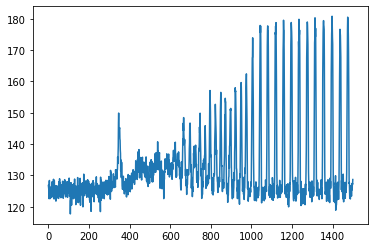

Episode 727, episode return -81.3, last 20 avg -166.7


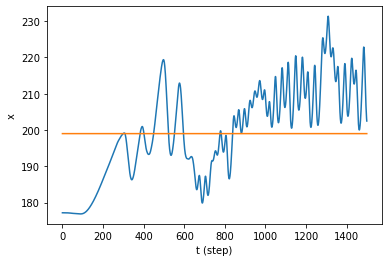

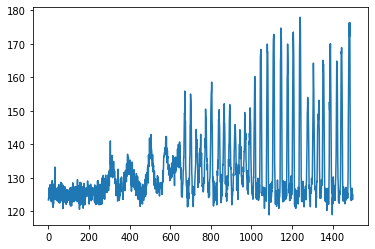

Episode 728, episode return -102.3, last 20 avg -167.4


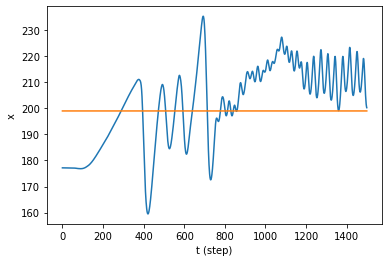

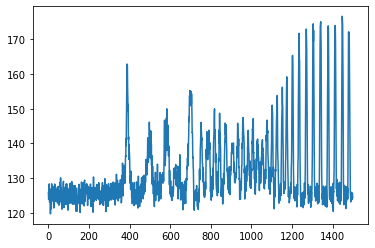

Episode 729, episode return -83.1, last 20 avg -159.0


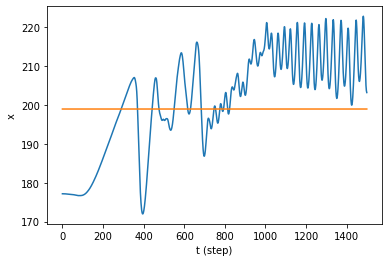

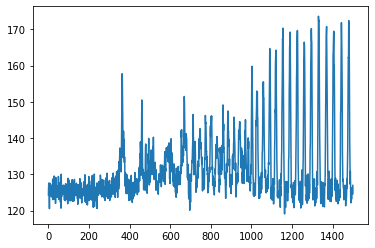

Episode 730, episode return -71.2, last 20 avg -150.0


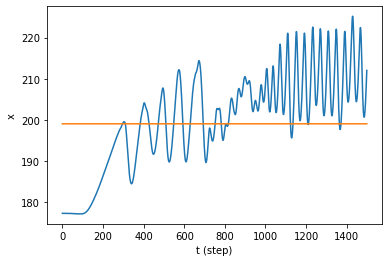

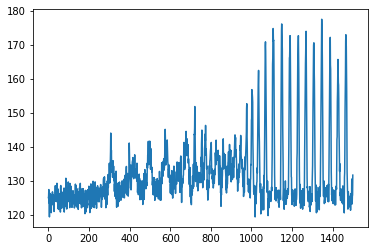

Episode 731, episode return -90.5, last 20 avg -151.0


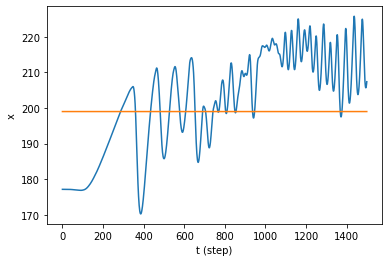

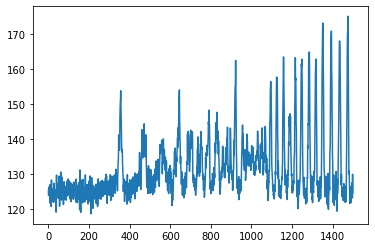

Episode 732, episode return -93.0, last 20 avg -152.6


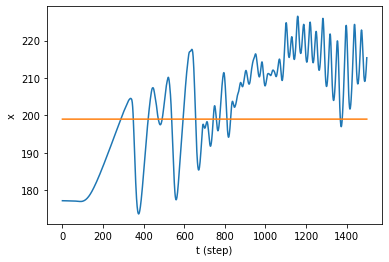

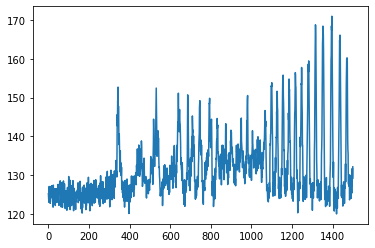

Episode 733, episode return -158.6, last 20 avg -148.6


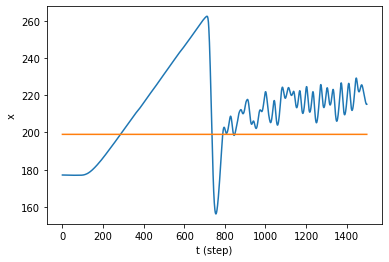

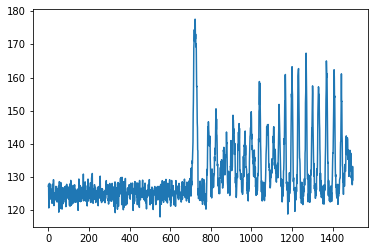

Episode 734, episode return -263.7, last 20 avg -150.0


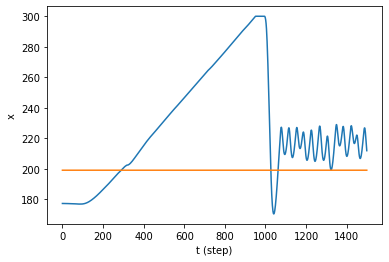

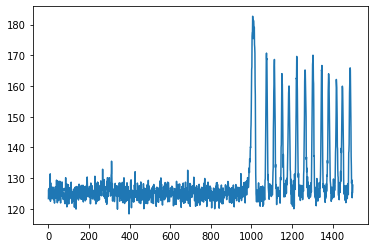

Episode 735, episode return -371.3, last 20 avg -158.4


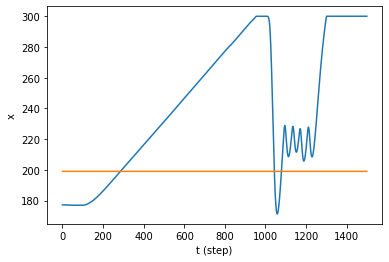

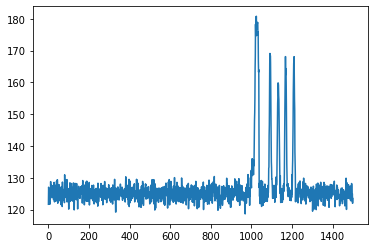

Episode 736, episode return -470.8, last 20 avg -178.8


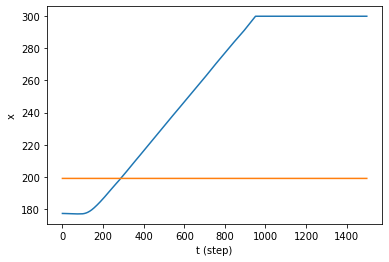

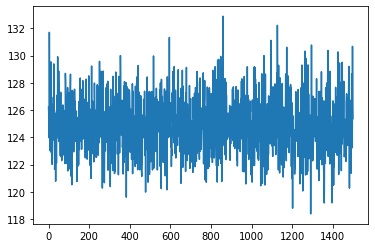

Episode 737, episode return -470.9, last 20 avg -199.0


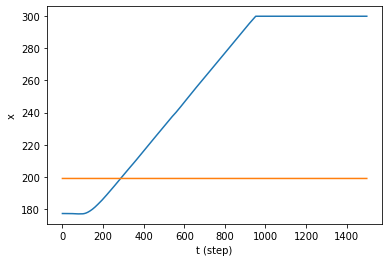

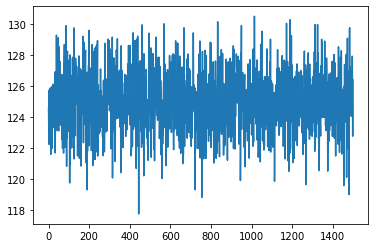

Episode 738, episode return -457.0, last 20 avg -211.4


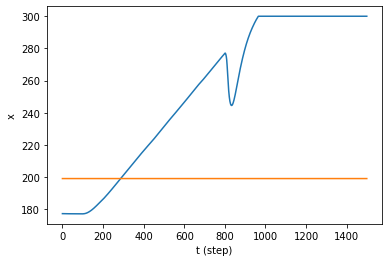

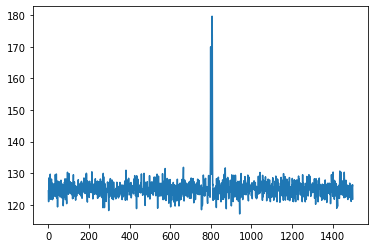

Episode 739, episode return -470.4, last 20 avg -230.9


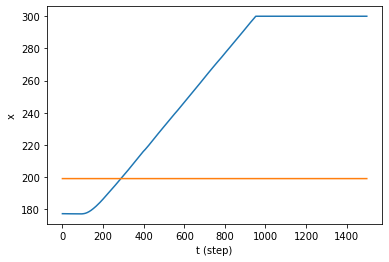

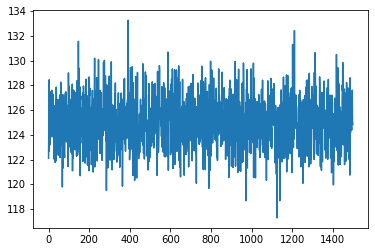

Episode 740, episode return -470.5, last 20 avg -249.8


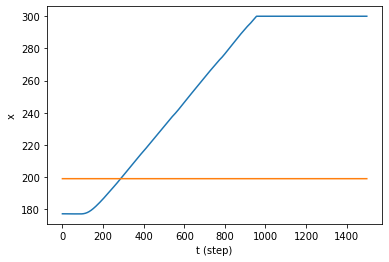

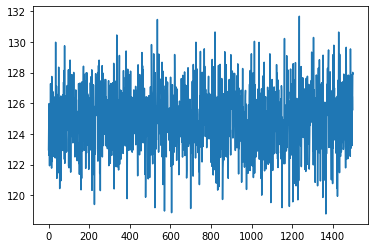

Episode 741, episode return -470.7, last 20 avg -262.1


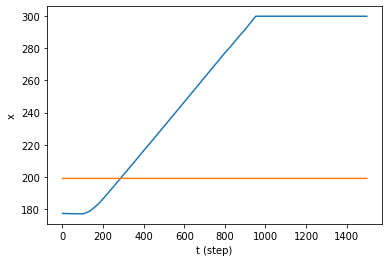

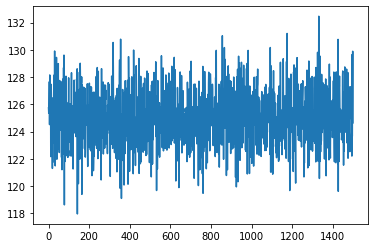

Episode 742, episode return -470.9, last 20 avg -264.7


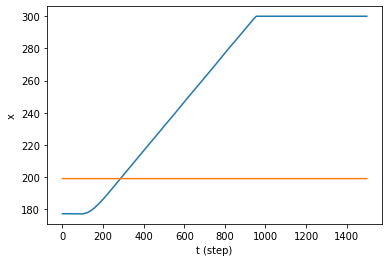

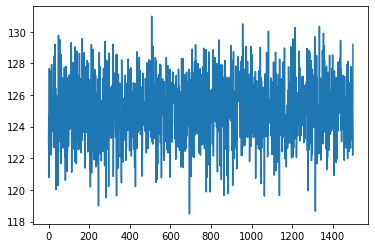

Episode 743, episode return -470.8, last 20 avg -264.7


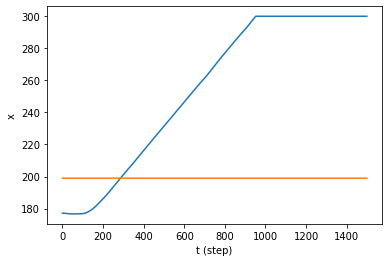

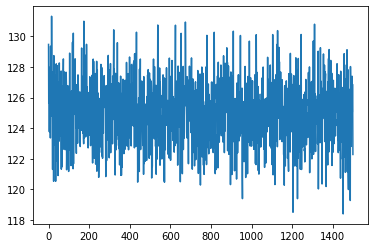

Episode 744, episode return -470.7, last 20 avg -284.1


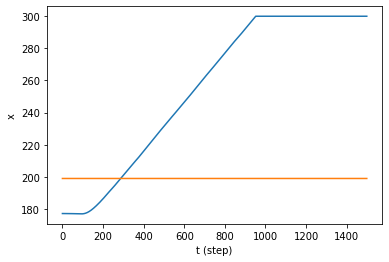

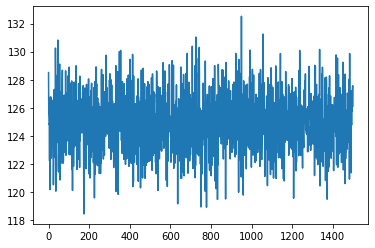

Episode 745, episode return -470.8, last 20 avg -303.5


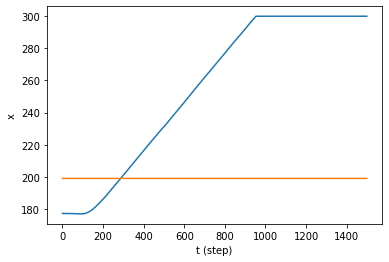

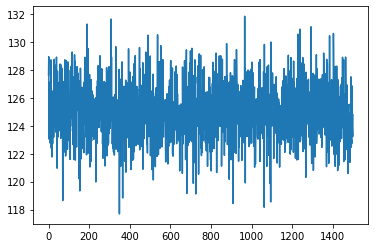

Episode 746, episode return -470.9, last 20 avg -324.0


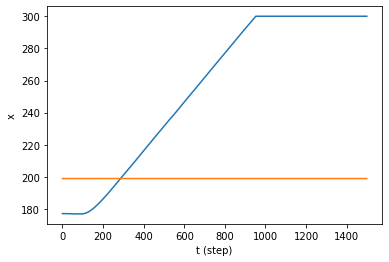

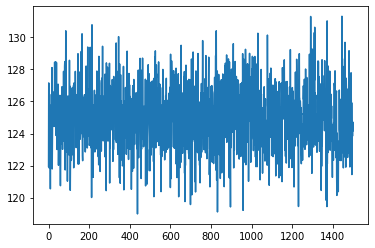

Episode 747, episode return -470.8, last 20 avg -343.4


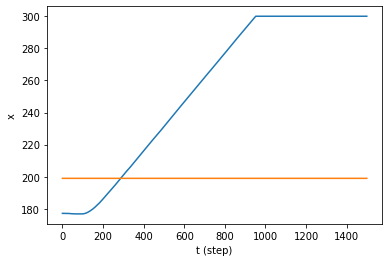

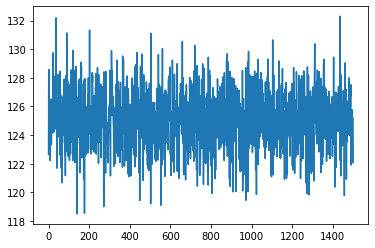

Episode 748, episode return -470.6, last 20 avg -361.9


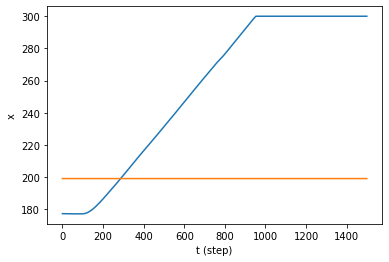

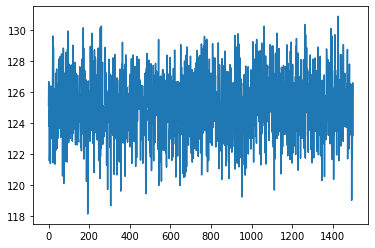

Episode 749, episode return -471.0, last 20 avg -381.3


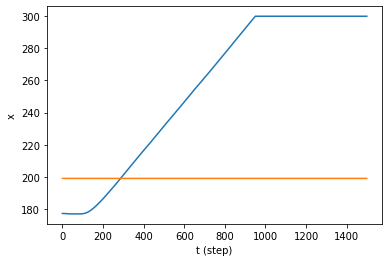

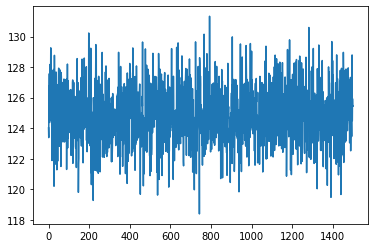

Episode 750, episode return -470.7, last 20 avg -401.2


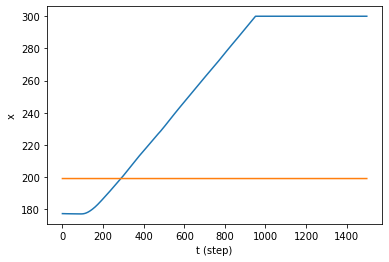

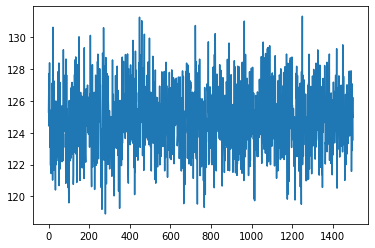

Episode 751, episode return -470.2, last 20 avg -420.2


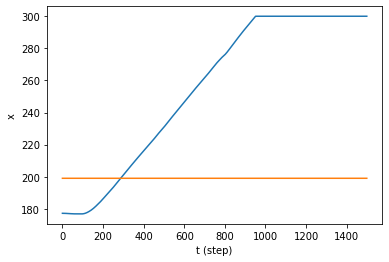

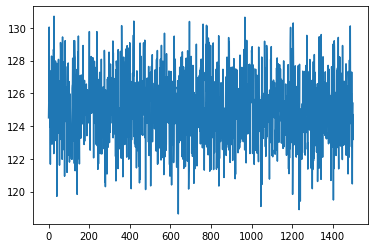

Episode 752, episode return -470.4, last 20 avg -439.1


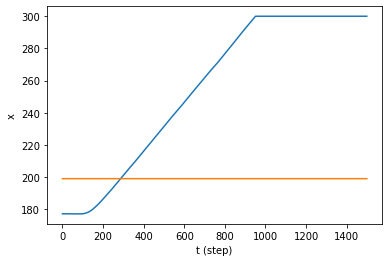

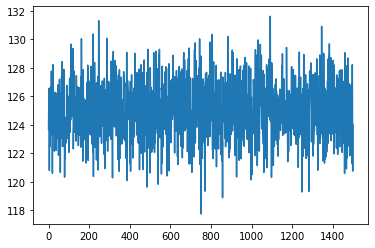

Episode 753, episode return -470.6, last 20 avg -454.7


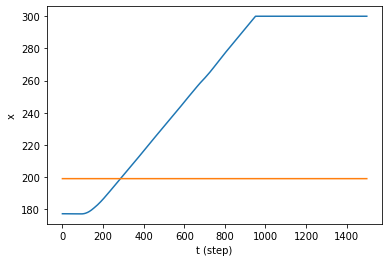

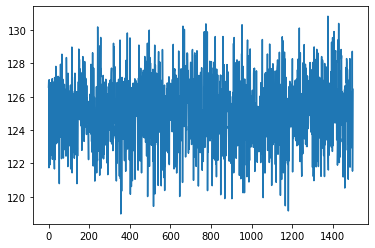

Episode 754, episode return -470.7, last 20 avg -465.0


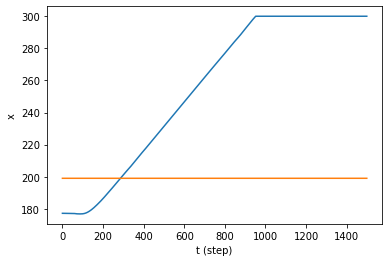

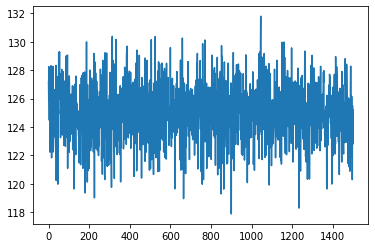

Episode 755, episode return -316.7, last 20 avg -462.3


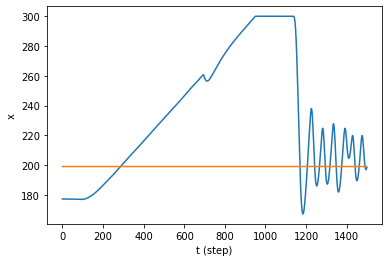

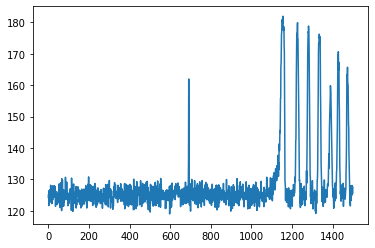

Episode 756, episode return -195.3, last 20 avg -448.5


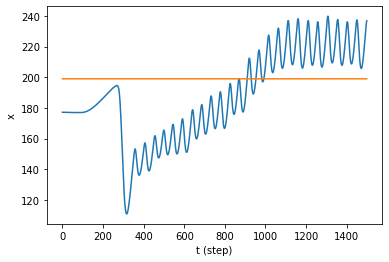

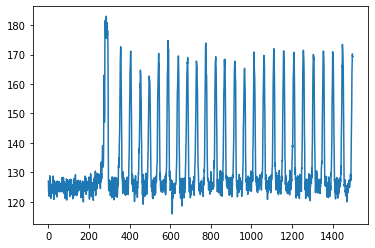

Episode 757, episode return -179.6, last 20 avg -434.0


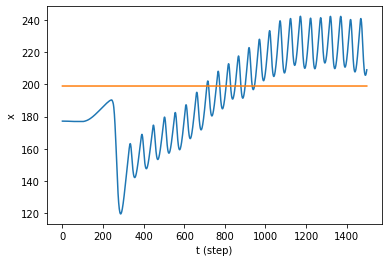

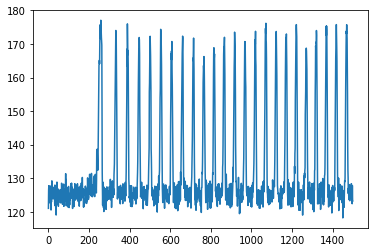

Episode 758, episode return -166.6, last 20 avg -419.4


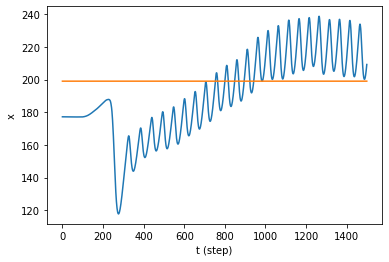

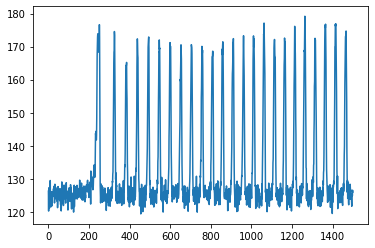

Episode 759, episode return -176.3, last 20 avg -404.7


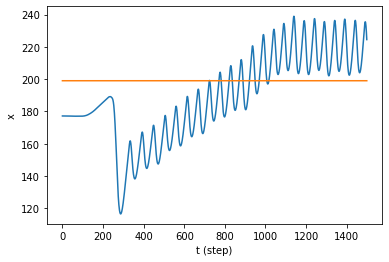

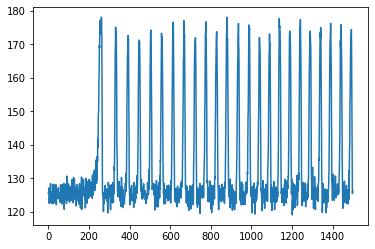

Episode 760, episode return -178.4, last 20 avg -390.1


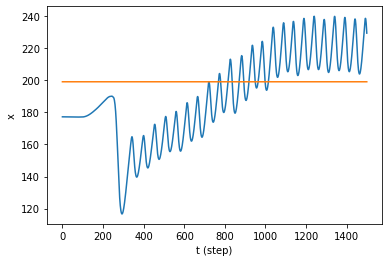

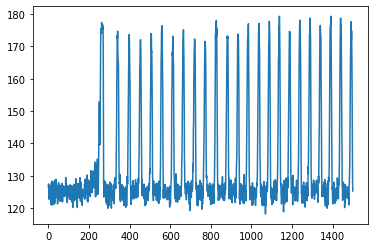

Episode 761, episode return -139.1, last 20 avg -373.6


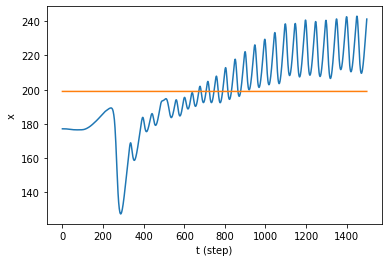

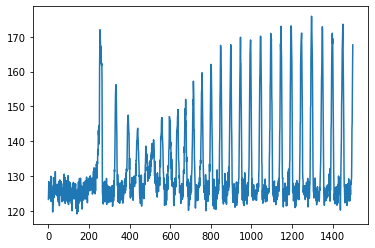

Episode 762, episode return -159.2, last 20 avg -358.0


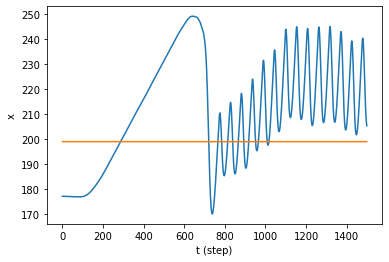

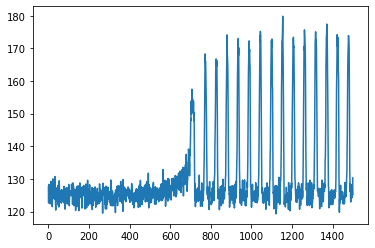

Episode 763, episode return -309.5, last 20 avg -349.9


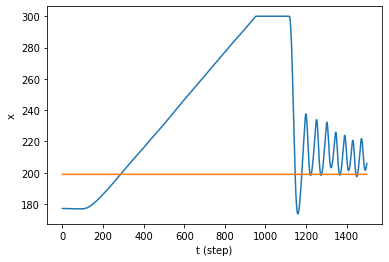

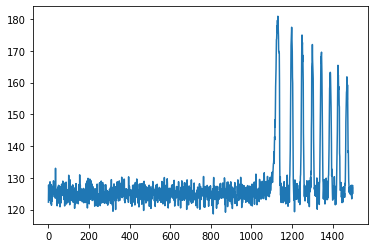

Episode 764, episode return -96.5, last 20 avg -331.2


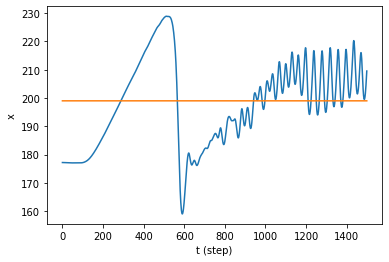

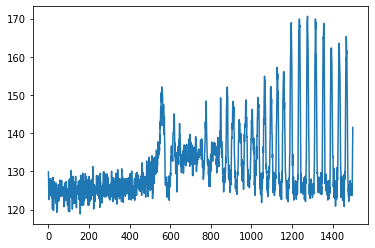

Episode 765, episode return -90.2, last 20 avg -312.2


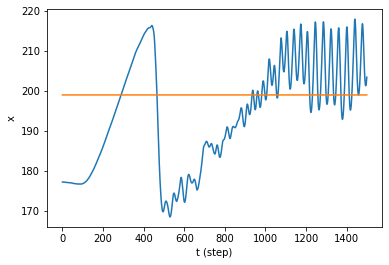

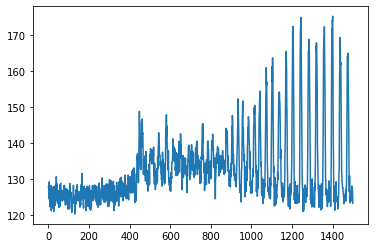

Episode 766, episode return -397.7, last 20 avg -308.5


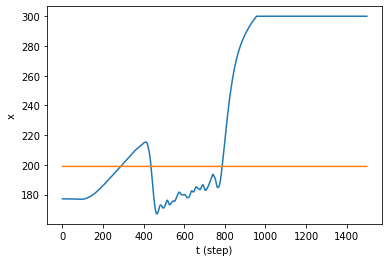

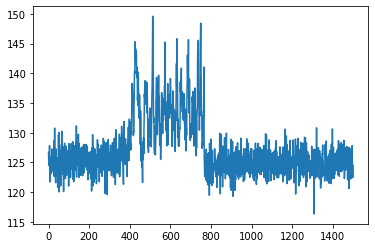

In [ ]:
# %load solutions/RL6_DDPG.py
# If you get stuck, uncomment the line above to load a correction in this cell (then you can execute this code).

### NEW indicate the differences between DQN and DDPG.
class DDPGAgent(Agent):
    def __init__(self, state_space, action_space, device, actor_lr=0.000005, critic_lr=0.00001, tau=0.001, gamma=0.99,
                 max_size=100000, layer1_size=300, layer2_size=200, batch_size=64, noise_std=0.1, name="DDPG"):
        assert isinstance(action_space, gym.spaces.Box)  ### NEW: The action space is now continuous 
        super().__init__(state_space, action_space, device=device, name=name)
        self.gamma = gamma
        self.tau = tau
        self.replay_buffer = ReplayBuffer(max_size, self.device)
        self.batch_size = batch_size

        self.actor = DefaultNNActor(actor_lr, self.state_size, layer1_size, layer2_size, self.nb_actions
                               , self.device)
        self.critic = DefaultNNCritic(critic_lr, self.state_size + self.nb_actions, layer1_size, layer2_size, 1, self.device)

        print(self.actor)

        self.target_actor = copy.deepcopy(self.actor)
        self.target_critic = copy.deepcopy(self.critic)

        self.normal_distribution = torch.distributions.normal.Normal(
            torch.zeros(self.nb_actions), torch.full((self.nb_actions,), noise_std))

    def action(self, observation):
        with torch.no_grad():
            observation = torch.tensor(observation, dtype=torch.float).to(self.device)
            actor_output = self.actor.forward(observation).to(self.device)
            #action=torch.normal(actor_output[0], np.abs(actor_output[1]))
            noise = self.normal_distribution.sample().to(self.device)
            action = actor_output + noise
        return action.cpu().detach().numpy()

    def on_action_stop(self, action, new_state, reward, done):
        self.replay_buffer.append(self.last_state, action, reward, new_state, done)
        self.learn()
        super().on_action_stop(action, new_state, reward, done)

    def learn(self):
        #if len(self.replay_buffer) > self.batch_size:
        if len(self.replay_buffer.data) > self.batch_size:
            states, actions, rewards, new_states, dones = self.replay_buffer.sample(self.batch_size)

            with torch.no_grad():
                target_actions = self.target_actor.forward(new_states)
                critic_value_ = self.target_critic.forward(torch.concat((new_states, target_actions), dim=-1))
            critic_value = self.critic.forward(torch.concat((states, actions), dim=-1))
            target = torch.addcmul(rewards, self.gamma, 1 - dones, critic_value_.squeeze()).view(self.batch_size, 1)
            self.critic.optimizer.zero_grad()
            critic_loss = torch.nn.functional.mse_loss(target, critic_value)
            critic_loss.backward()
            self.critic.optimizer.step()

            self.actor.optimizer.zero_grad()
            actions = self.actor.forward(states)
            actor_loss = - self.critic.forward(torch.concat((states, actions), dim=-1))
            actor_loss = torch.mean(actor_loss)
            actor_loss.backward()
            self.actor.optimizer.step()

            self.target_critic.converge_to(self.critic, tau=self.tau)
            self.target_actor.converge_to(self.actor, tau=self.tau)

# Test our agent on Pendulum-v0
#environment = gym.make('Pendulum-v1')
#environment = CarPend()
step_size_action = 1
step_size_simu = 10**(-2)
CaseTest = A_T01a(step_size_simu)  
environment = PlantEnv(CaseTest,0.0,step_size_action,step_size_simu)
#agent = DDPGAgent(environment.observation_space, environment.action_space, device=DEVICE)
#simulation(environment, agent,nb_episodes=5000)

agent = DDPGAgent(environment.observation_space, environment.action_space, noise_std=2, device=DEVICE)
simulation(environment, agent,nb_episodes=1000)

In [ ]:

torch.save(agent.actor.state_dict(), 'act_checkpoint.pth')
#agent.critic.save('act_checkpoint.pth')
torch.save(agent.critic.state_dict(), 'crit_checkpoint.pth')